# K and Ice band image registration

written by: Sarah Betti - May 2020


In [1]:

import numpy as np
import pandas as pd

import matplotlib.pyplot as plt

from astropy.io import fits
from astropy.stats import sigma_clip
from astropy.modeling import models, fitting
from astropy.convolution import Gaussian2DKernel
from astropy.visualization import ZScaleInterval
interval = ZScaleInterval()


import glob
import datetime
import os

from photutils import make_source_mask
from photutils import source_properties
from photutils import detect_threshold, detect_sources

from regions import CirclePixelRegion, PixCoord 

from scipy.ndimage import gaussian_filter

import warnings
warnings.filterwarnings('ignore', category=UserWarning, append=True)


In [ ]:
from shift_methods import *

%load_ext autoreload
%autoreload 2

# Directories

In [7]:
datadir = '/Volumes/ARCTURUS/LMIRCam_Jan15/'
target= 'AB-Aur'
filt = 'Kshort'
date = '150104'

---------



## Step 1: unstack the cubes into individual frames

In [ ]:
from KLIPmodule import *

%load_ext autoreload
%autoreload 2

# directory to raw data -- needed to save the correct header
rawdir = datadir + '/1raw'

# grab all binned data
fils = np.sort(glob.glob(datadir + f'/5binned2x2/{target}/{filt}/bin*.fits'))
pixscale = 0.022

savedir = datadir + f'/5binned2x2/{target}/{filt}_single'
if not os.path.exists(savedir):
    os.makedirs(savedir)
    
savefilename = f'bin_distcorr_lm_{date}'

unstack(rawdir, date, fils, pixscale, savedir, savefilename)

## Step 2: Cross-correlation.

Can be used with L band 2 eyes, but it is set up nicely in the L band notebook.


In [ ]:
# GET ALL FILES (REF and AB Aur)
fils = np.sort(glob.glob(datadir + f'/5binned2x2/*/{filt}_single/bin_dist*.fits'))

# GET REFERENCE STAR and MANUALLY CENTER IT 
ref_fil = np.sort(glob.glob(datadir + f'/5binned2x2/AB-Aur/{filt}_single/bin_dist*03370.fits'))
ref = fits.getdata(ref_fil[0])[325-125:325+125, 193-125:193+125]

plt.figure()
plt.imshow(ref)
plt.xlim(120,130)
plt.ylim(120,130)
plt.show()

bin_distcorr_lm_150104_03364.fits
8125.526053254757
STARTING  O
X: 192  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03364.fits: -1.0053028303082456, -0.7545873292351573


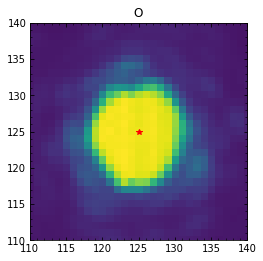

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03364.fits
bin_distcorr_lm_150104_03365.fits
8116.576564249666
STARTING  O
X: 192  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03365.fits: -1.0462003567764953, -0.8215737364994808


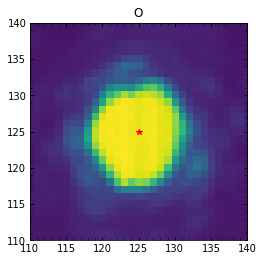

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03365.fits
bin_distcorr_lm_150104_03366.fits
8086.105840345953
STARTING  O
X: 193  Y: 325  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03366.fits: -0.07329212048153977, 0.12432241456783544


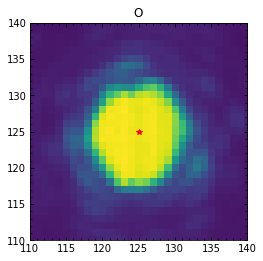

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03366.fits
bin_distcorr_lm_150104_03367.fits
8080.364283619381
STARTING  O
X: 193  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03367.fits: -1.0290800687849284, 0.10455642314476421


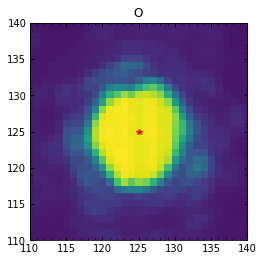

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03367.fits
bin_distcorr_lm_150104_03368.fits
8105.746240484403
STARTING  O
X: 193  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03368.fits: -1.0230957360859563, 0.06304749733800463


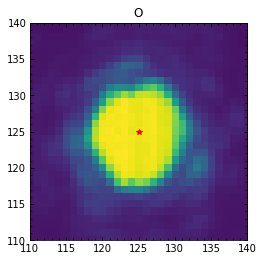

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03368.fits
bin_distcorr_lm_150104_03369.fits
8108.387348606032
STARTING  O
X: 193  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03369.fits: -1.0038642093020655, 0.021426998373605954


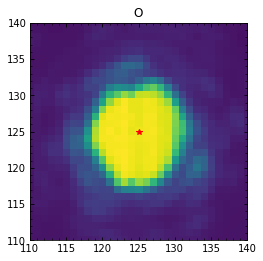

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03369.fits
bin_distcorr_lm_150104_03370.fits
8096.268937669153
STARTING  O
X: 193  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03370.fits: -0.9942954089671119, -1.185304796536002e-06


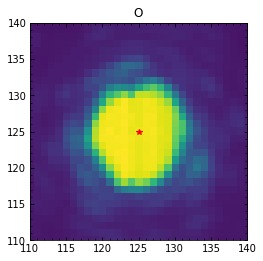

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03370.fits
bin_distcorr_lm_150104_03371.fits
8118.573742508535
STARTING  O
X: 193  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03371.fits: -0.9924959032548202, -0.022849771411827646


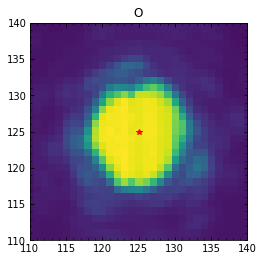

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03371.fits
bin_distcorr_lm_150104_03372.fits
8134.962574527963
STARTING  O
X: 193  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03372.fits: -1.0128273045848317, -0.03499266118719646


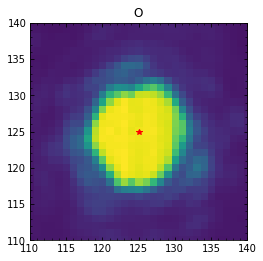

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03372.fits
bin_distcorr_lm_150104_03373.fits
8098.777483024214
STARTING  O
X: 193  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03373.fits: -0.9954479633528308, -0.050150807912608286


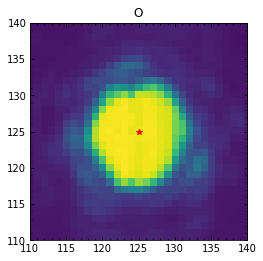

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03373.fits
bin_distcorr_lm_150104_03374.fits
8102.889912941927
STARTING  O
X: 193  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03374.fits: -0.9943810689318582, -0.08104553164127282


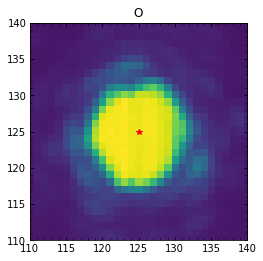

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03374.fits
bin_distcorr_lm_150104_03375.fits
8135.634359261451
STARTING  O
X: 193  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03375.fits: -0.9951124464672034, -0.09303133831633659


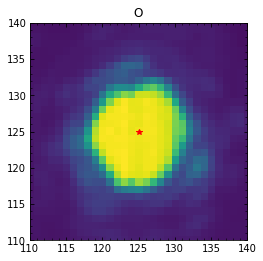

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03375.fits
bin_distcorr_lm_150104_03376.fits
8144.086716908985
STARTING  O
X: 193  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03376.fits: -1.0012656691543, -0.10530838551549948


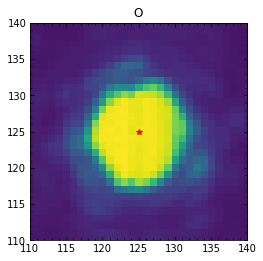

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03376.fits
bin_distcorr_lm_150104_03377.fits
8089.8177287281105
STARTING  O
X: 193  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03377.fits: -1.0182549754401364, -0.15097256758001265


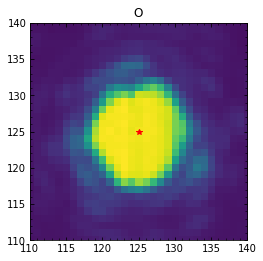

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03377.fits
bin_distcorr_lm_150104_03378.fits
8114.174507889815
STARTING  O
X: 193  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03378.fits: -1.0051492672138949, -0.15482607565183315


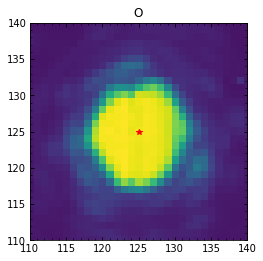

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03378.fits
bin_distcorr_lm_150104_03379.fits
8126.181720885327
STARTING  O
X: 193  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03379.fits: -1.0053502818196876, -0.18791577945612659


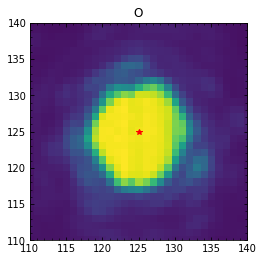

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03379.fits
bin_distcorr_lm_150104_03380.fits
8132.637373935004
STARTING  O
X: 193  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03380.fits: -1.0250032760868848, -0.19931474870528376


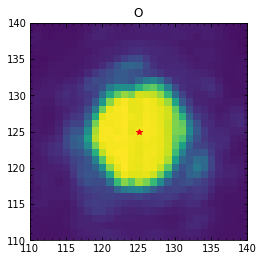

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03380.fits
bin_distcorr_lm_150104_03381.fits
8119.43072351545
STARTING  O
X: 193  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03381.fits: -1.0247014292629402, -0.21374630217505342


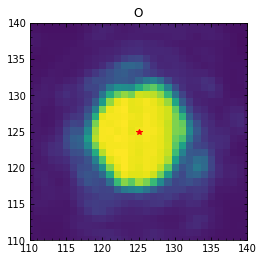

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03381.fits
bin_distcorr_lm_150104_03382.fits
8118.7548298310485
STARTING  O
X: 193  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03382.fits: -1.0080635177259083, -0.2356783723683762


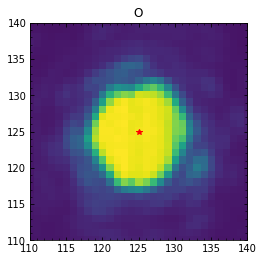

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03382.fits
bin_distcorr_lm_150104_03383.fits
8117.568627984891
STARTING  O
X: 193  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03383.fits: -0.9929477340519313, -0.23326804084855013


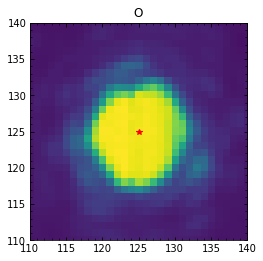

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03383.fits
bin_distcorr_lm_150104_03384.fits
8109.350369690042
STARTING  O
X: 193  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03384.fits: -1.022038267769787, -0.24768158980577226


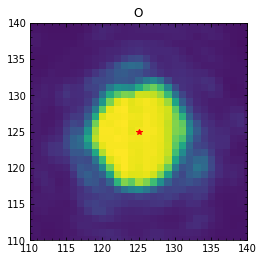

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03384.fits
bin_distcorr_lm_150104_03385.fits
8111.132055294705
STARTING  O
X: 193  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03385.fits: -1.0092019814029385, -0.293261089899417


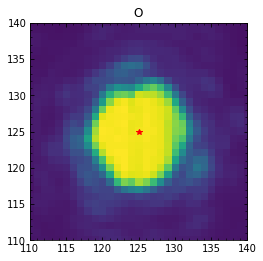

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03385.fits
bin_distcorr_lm_150104_03386.fits
8119.559334503381
STARTING  O
X: 193  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03386.fits: -1.0129909795000813, -0.2983597009861185


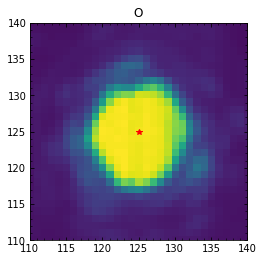

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03386.fits
bin_distcorr_lm_150104_03387.fits
8099.092538926794
STARTING  O
X: 193  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03387.fits: -1.0019953080018666, -0.32129999688630306


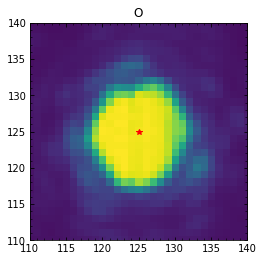

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03387.fits
bin_distcorr_lm_150104_03388.fits
8085.4773222182885
STARTING  O
X: 193  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03388.fits: -0.9932142764358503, -0.33548829597728513


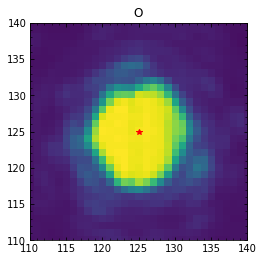

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03388.fits
bin_distcorr_lm_150104_03389.fits
8098.818208284076
STARTING  O
X: 193  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03389.fits: -0.9865640926050148, -0.32576357229564223


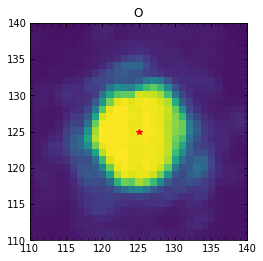

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03389.fits
bin_distcorr_lm_150104_03390.fits
8120.604072248281
STARTING  O
X: 193  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03390.fits: -0.9910221972385926, -0.35701350142557686


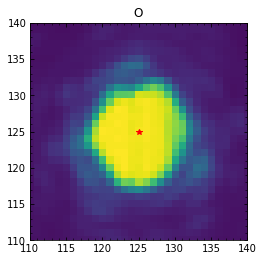

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03390.fits
bin_distcorr_lm_150104_03391.fits
8090.5206548067
STARTING  O
X: 193  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03391.fits: -1.0047512044485174, -0.36859683384199116


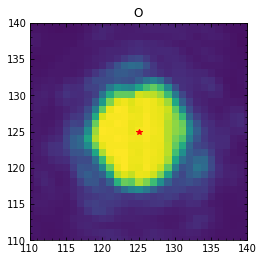

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03391.fits
bin_distcorr_lm_150104_03392.fits
8079.544676475308
STARTING  O
X: 193  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03392.fits: -1.0128786190874806, -0.39262771897613646


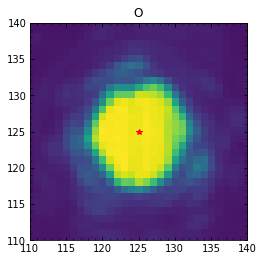

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03392.fits
bin_distcorr_lm_150104_03393.fits
8061.750556128243
STARTING  O
X: 193  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03393.fits: -0.9933703098160294, -0.39734894268909926


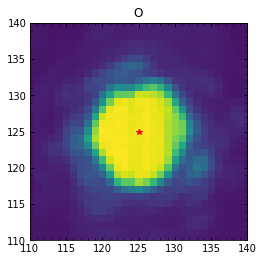

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03393.fits
bin_distcorr_lm_150104_03394.fits
8074.259526956009
STARTING  O
X: 193  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03394.fits: -1.019667658433825, -0.6535156027396312


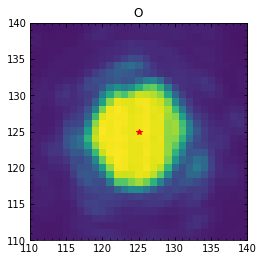

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03394.fits
bin_distcorr_lm_150104_03395.fits
8067.205848112836
STARTING  O
X: 193  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03395.fits: -0.9972640687101446, -0.6722192960954203


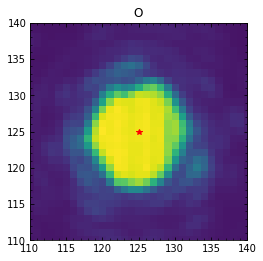

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03395.fits
bin_distcorr_lm_150104_03396.fits
8101.398522526259
STARTING  O
X: 193  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03396.fits: -1.011967894741936, -0.6884632740807319


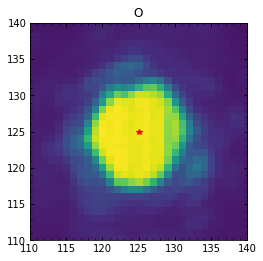

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03396.fits
bin_distcorr_lm_150104_03397.fits
8097.392605240415
STARTING  O
X: 193  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03397.fits: -1.008796581564141, -0.6899264913682259


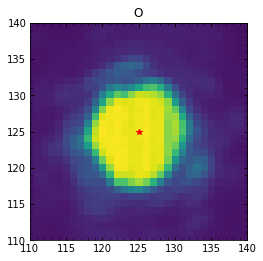

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03397.fits
bin_distcorr_lm_150104_03398.fits
8055.372290911145
STARTING  O
X: 193  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03398.fits: -0.9878886286855462, -0.7137752436460971


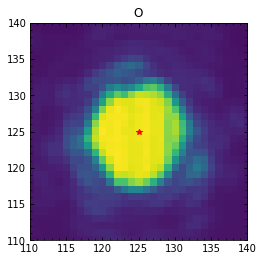

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03398.fits
bin_distcorr_lm_150104_03399.fits
8043.764099648433
STARTING  O
X: 193  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03399.fits: -1.01627379697063, -0.7345306503330917


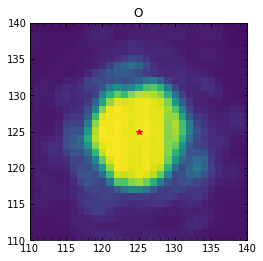

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03399.fits
bin_distcorr_lm_150104_03400.fits
8077.348184360384
STARTING  O
X: 193  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03400.fits: -0.9883544113765339, -0.723913526082228


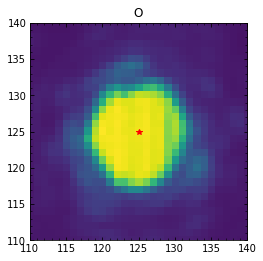

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03400.fits
bin_distcorr_lm_150104_03401.fits
8050.0552684250615
STARTING  O
X: 193  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03401.fits: -0.9937099491278829, -0.7465720997543812


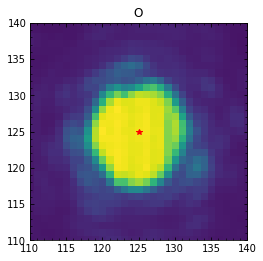

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03401.fits
bin_distcorr_lm_150104_03402.fits
8024.050689439082
STARTING  O
X: 193  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03402.fits: -1.0134837535143646, -0.7713056665239293


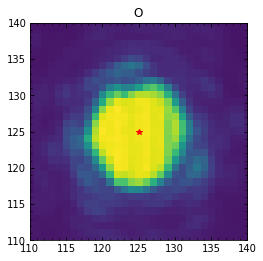

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03402.fits
bin_distcorr_lm_150104_03403.fits
8046.07723762179
STARTING  O
X: 193  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03403.fits: -1.0039533800547318, -0.7892288239672851


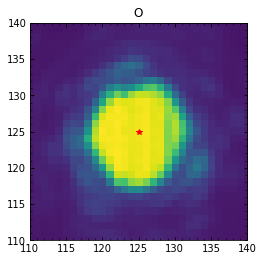

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03403.fits
bin_distcorr_lm_150104_03404.fits
8045.457575147635
STARTING  O
X: 193  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03404.fits: -1.012693074389361, -0.7962435606931209


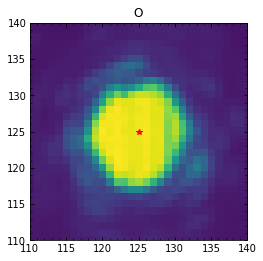

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03404.fits
bin_distcorr_lm_150104_03405.fits
8073.333329036891
STARTING  O
X: 193  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03405.fits: -1.0035687325595504, -0.7917029052409177


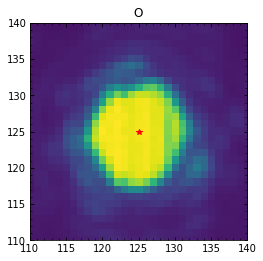

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03405.fits
bin_distcorr_lm_150104_03406.fits
8026.7632731936055
STARTING  O
X: 193  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03406.fits: -1.0371662480611548, -0.8056437857646088


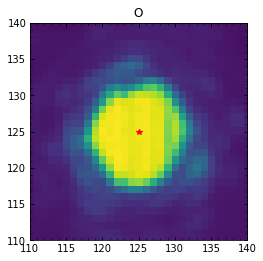

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03406.fits
bin_distcorr_lm_150104_03407.fits
8053.616643042624
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03407.fits: -1.004001999542922, 0.15674383543168346


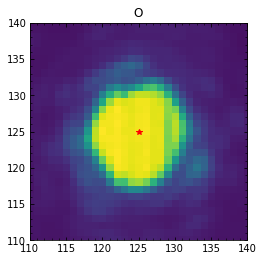

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03407.fits
bin_distcorr_lm_150104_03408.fits
8030.87504549689
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03408.fits: -1.0052676344193188, 0.15085761194706038


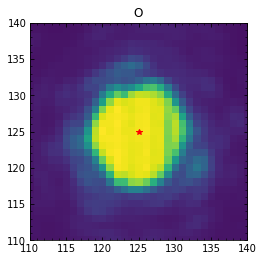

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03408.fits
bin_distcorr_lm_150104_03409.fits
8018.161765779593
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03409.fits: -1.011396624426176, 0.13224911468219602


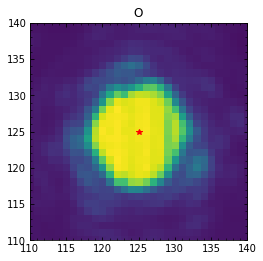

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03409.fits
bin_distcorr_lm_150104_03410.fits
8048.90171637178
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03410.fits: -0.9731004496163891, 0.12982912368533306


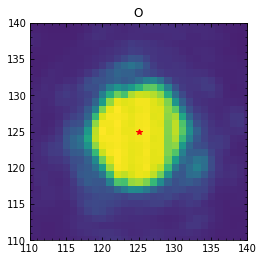

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03410.fits
bin_distcorr_lm_150104_03411.fits
8062.082140308659
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03411.fits: -0.9841718005021107, 0.12750456811052402


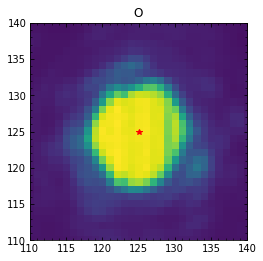

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03411.fits
bin_distcorr_lm_150104_03412.fits
8041.565937626961
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03412.fits: -1.0063055696199186, 0.09821934218323491


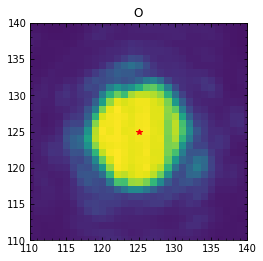

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03412.fits
bin_distcorr_lm_150104_03413.fits
8049.138304044236
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03413.fits: -0.952933791540012, 0.10577839244019316


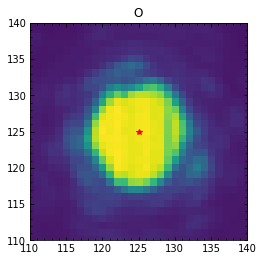

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03413.fits
bin_distcorr_lm_150104_03414.fits
8051.5951292450145
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03414.fits: -0.9837600032917635, 0.0973775740719347


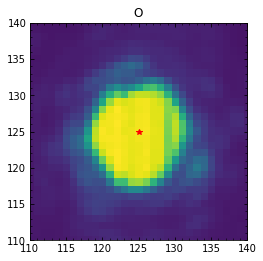

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03414.fits
bin_distcorr_lm_150104_03415.fits
8069.595332483989
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03415.fits: -1.0057817178512494, 0.08029814996422147


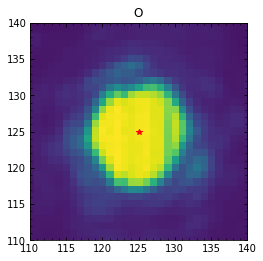

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03415.fits
bin_distcorr_lm_150104_03416.fits
8088.096359700465
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03416.fits: -0.9745677679021512, 0.08859852136500734


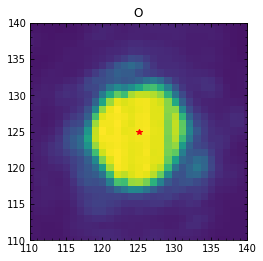

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03416.fits
bin_distcorr_lm_150104_03417.fits
8057.062719212089
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03417.fits: -1.002468788418092, 0.07777074571909992


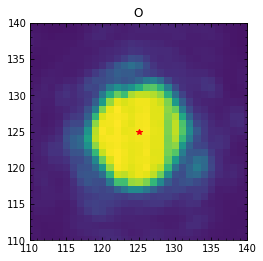

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03417.fits
bin_distcorr_lm_150104_03418.fits
8059.4112536684015
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03418.fits: -0.990931528316878, 0.064457574092458


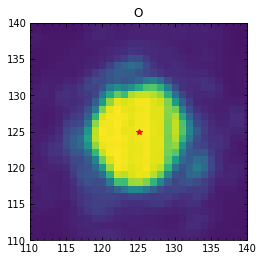

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03418.fits
bin_distcorr_lm_150104_03419.fits
8055.1962369543635
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03419.fits: -0.9897125535991691, 0.03593296301855986


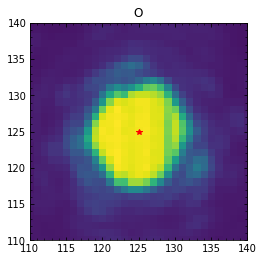

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03419.fits
bin_distcorr_lm_150104_03420.fits
8047.378198408381
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03420.fits: -0.9880439699924821, 0.02798336844795557


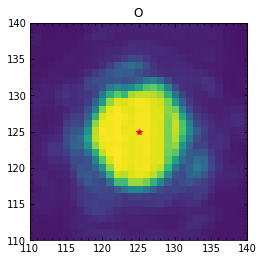

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03420.fits
bin_distcorr_lm_150104_03421.fits
8056.444480298805
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03421.fits: -1.0083590691926005, 0.01583908743351259


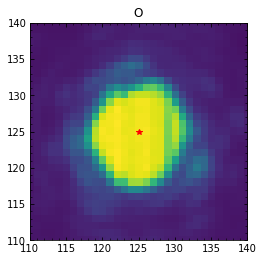

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03421.fits
bin_distcorr_lm_150104_03422.fits
8062.988291287183
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03422.fits: -0.9978165539262704, 0.009867236687057357


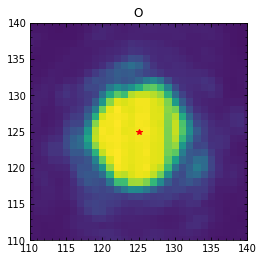

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03422.fits
bin_distcorr_lm_150104_03423.fits
8026.106219162449
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03423.fits: -0.9891786519234245, -0.01984892404422567


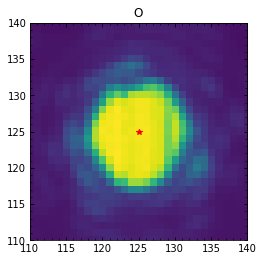

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03423.fits
bin_distcorr_lm_150104_03424.fits
8037.298732772306
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03424.fits: -0.9933456699857359, -0.01769749067489812


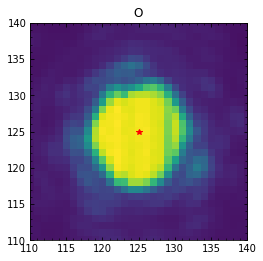

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03424.fits
bin_distcorr_lm_150104_03425.fits
8067.1253964025345
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03425.fits: -0.9639460171322298, -0.041601670364087795


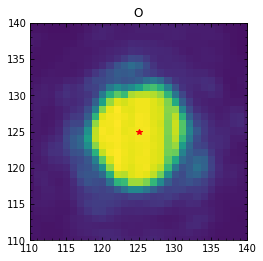

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03425.fits
bin_distcorr_lm_150104_03426.fits
8044.2216879659645
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03426.fits: -0.9874251482091907, -0.02999025107130393


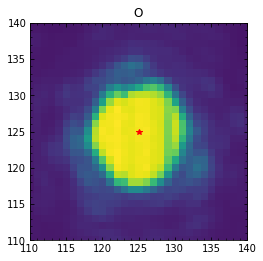

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03426.fits
bin_distcorr_lm_150104_03427.fits
8037.347481668298
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03427.fits: -1.007873238324322, -0.05378531985959967


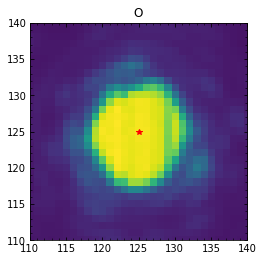

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03427.fits
bin_distcorr_lm_150104_03428.fits
8043.98319388018
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03428.fits: -0.998295669136553, -0.03244407215676404


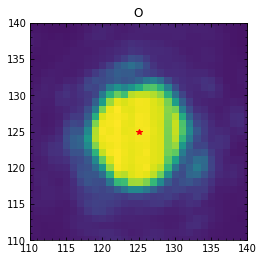

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03428.fits
bin_distcorr_lm_150104_03429.fits
8056.525451574196
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03429.fits: -1.0034577410920775, -0.057846334559933155


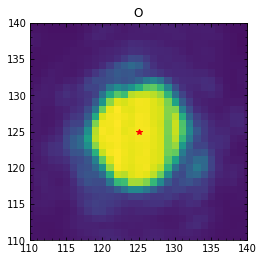

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03429.fits
bin_distcorr_lm_150104_03430.fits
8022.957338175037
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03430.fits: -1.013715117301814, -0.06069055458916495


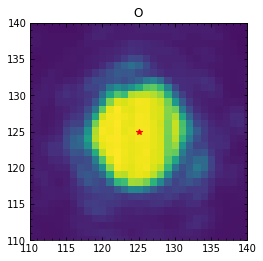

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03430.fits
bin_distcorr_lm_150104_03431.fits
8033.596483605013
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03431.fits: -0.9973701082276563, -0.0533061898435534


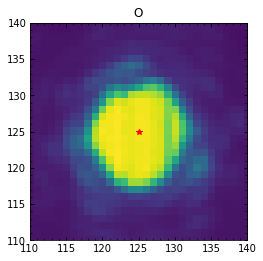

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03431.fits
bin_distcorr_lm_150104_03432.fits
8043.124871705725
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03432.fits: -0.9807681267275967, -0.09372152895598163


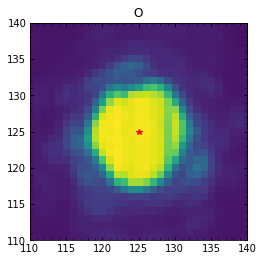

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03432.fits
bin_distcorr_lm_150104_03433.fits
8039.916640517556
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03433.fits: -0.9859785135695915, -0.08500035695033858


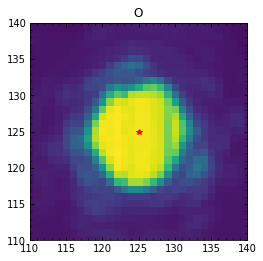

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03433.fits
bin_distcorr_lm_150104_03434.fits
8017.212055620348
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03434.fits: -0.9768171540463442, -0.07706815058015337


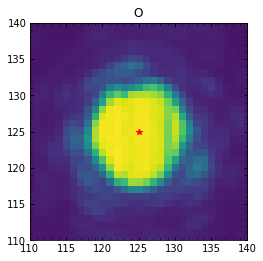

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03434.fits
bin_distcorr_lm_150104_03435.fits
8048.8498241103325
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03435.fits: -0.9784966916704079, -0.09618524606766954


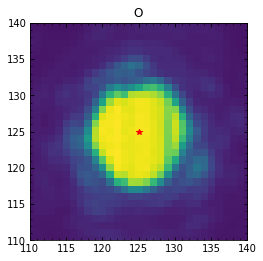

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03435.fits
bin_distcorr_lm_150104_03436.fits
8070.9420295326445
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03436.fits: -0.9982507398918798, -0.10203906876867563


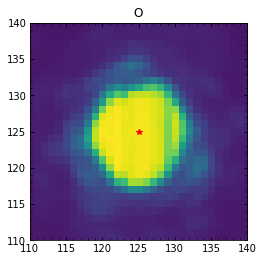

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03436.fits
bin_distcorr_lm_150104_03437.fits
8035.220817361214
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03437.fits: -0.9986874114168103, -0.0889971626217374


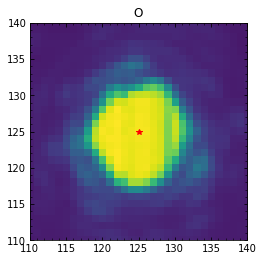

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03437.fits
bin_distcorr_lm_150104_03438.fits
8035.998940823913
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03438.fits: -1.0194403600268913, -0.09669266504103291


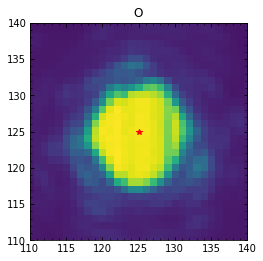

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03438.fits
bin_distcorr_lm_150104_03439.fits
8050.390212682025
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03439.fits: -1.0025230824295477, -0.12154322098464831


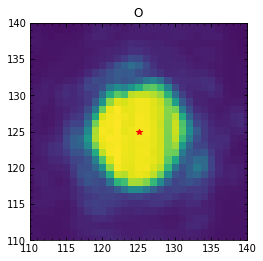

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03439.fits
bin_distcorr_lm_150104_03440.fits
8053.818927764218
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03440.fits: -0.9768227530581157, -0.14175237830058762


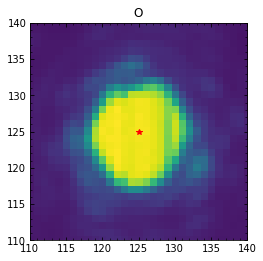

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03440.fits
bin_distcorr_lm_150104_03441.fits
8033.3969981530945
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03441.fits: -1.012150979046119, -0.13289516494948828


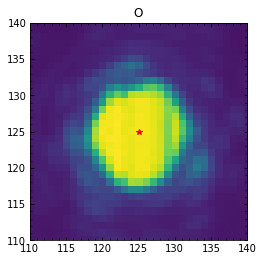

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03441.fits
bin_distcorr_lm_150104_03442.fits
8049.319351896519
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03442.fits: -0.9790272256238666, -0.15337090096226547


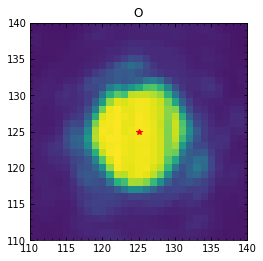

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03442.fits
bin_distcorr_lm_150104_03443.fits
8040.551229481056
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03443.fits: -0.953499069846302, -0.1521775363795399


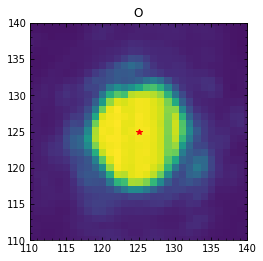

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03443.fits
bin_distcorr_lm_150104_03444.fits
7997.387142110945
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03444.fits: -0.9332091137590766, -0.18400874424786906


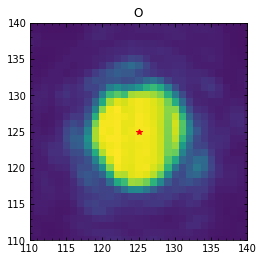

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03444.fits
bin_distcorr_lm_150104_03445.fits
8002.275960992107
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03445.fits: -0.9244461313010603, -0.18169082015708682


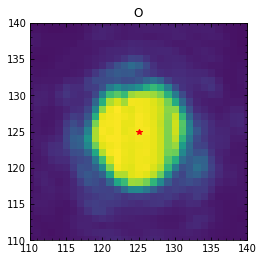

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03445.fits
bin_distcorr_lm_150104_03446.fits
8020.1453178519105
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03446.fits: -0.9299249787737338, -0.17782860107386966


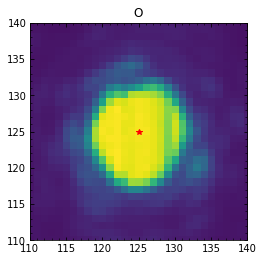

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03446.fits
bin_distcorr_lm_150104_03447.fits
8033.250388847479
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03447.fits: -0.9845069765827361, -0.20543735466345936


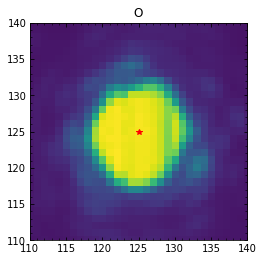

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03447.fits
bin_distcorr_lm_150104_03448.fits
8005.163693668434
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03448.fits: -0.9985532873022365, -0.21619076661441738


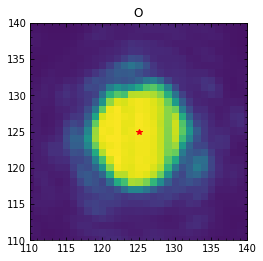

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03448.fits
bin_distcorr_lm_150104_03449.fits
8025.720325407714
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03449.fits: -1.0043581290548644, -0.22970498567816833


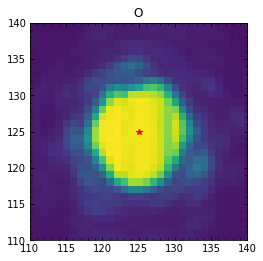

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03449.fits
bin_distcorr_lm_150104_03450.fits
8036.343259614538
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03450.fits: -0.9671027472677238, -0.22975349396346445


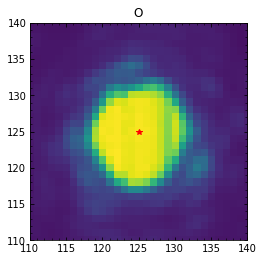

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03450.fits
bin_distcorr_lm_150104_03451.fits
8019.535439615313
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03451.fits: -0.9677593620407876, -0.2140050127915032


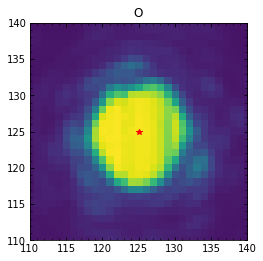

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03451.fits
bin_distcorr_lm_150104_03452.fits
8021.405498305488
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03452.fits: -0.9968791955645528, -0.2536905699729459


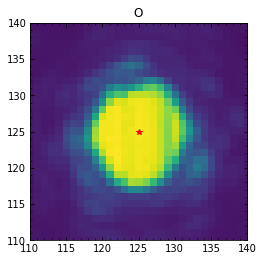

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03452.fits
bin_distcorr_lm_150104_03453.fits
8028.743284985045
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03453.fits: -0.9809086318157867, -0.25718435725696764


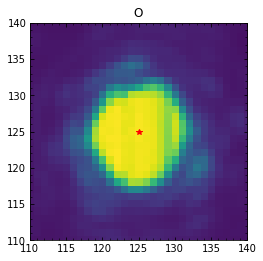

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03453.fits
bin_distcorr_lm_150104_03454.fits
8019.6569069718025
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03454.fits: -0.9500087694447004, -0.24010595765481213


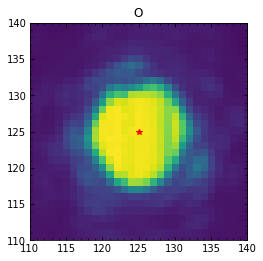

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03454.fits
bin_distcorr_lm_150104_03455.fits
7976.069217582841
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03455.fits: -0.9825421242793766, -0.26561478956678997


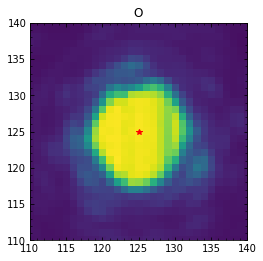

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03455.fits
bin_distcorr_lm_150104_03456.fits
8018.6224936664385
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03456.fits: -0.9747444522585909, -0.2571352028625711


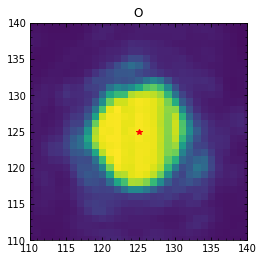

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03456.fits
bin_distcorr_lm_150104_03457.fits
8035.229671111198
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03457.fits: -0.9696643001534966, -0.28142474032969744


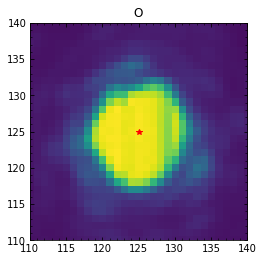

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03457.fits
bin_distcorr_lm_150104_03458.fits
8033.211256119069
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03458.fits: -0.9631777060049487, -0.2968286275128378


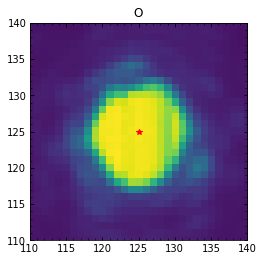

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03458.fits
bin_distcorr_lm_150104_03459.fits
8040.25896946536
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03459.fits: -0.9619140607797334, -0.2771975891931362


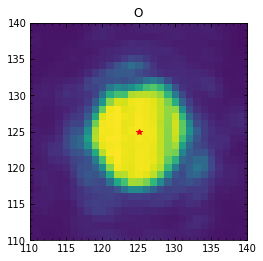

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03459.fits
bin_distcorr_lm_150104_03460.fits
8072.706668367644
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03460.fits: -0.9666396838968865, -0.2837450807642412


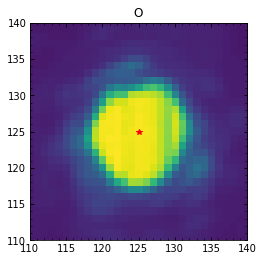

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03460.fits
bin_distcorr_lm_150104_03461.fits
8068.587046190094
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03461.fits: -0.9724620549834952, -0.2909302794853801


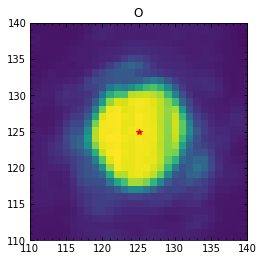

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03461.fits
bin_distcorr_lm_150104_03462.fits
8021.039580861014
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03462.fits: -1.0004598417274977, -0.29410559417546267


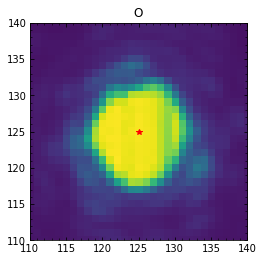

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03462.fits
bin_distcorr_lm_150104_03463.fits
8039.621502696504
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03463.fits: -0.9769932438965725, -0.3144535756393054


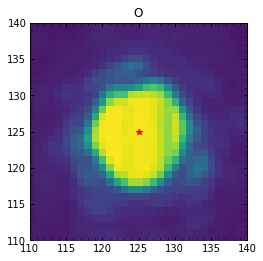

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03463.fits
bin_distcorr_lm_150104_03464.fits
7998.060060711383
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03464.fits: -0.9538788040393555, -0.3045664657567926


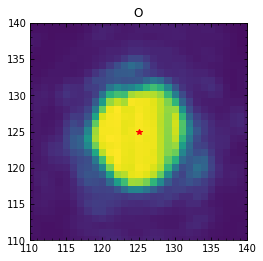

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03464.fits
bin_distcorr_lm_150104_03465.fits
7990.248577561094
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03465.fits: -0.9657353756204046, -0.3216244102425634


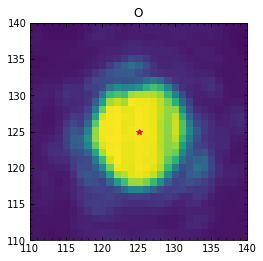

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03465.fits
bin_distcorr_lm_150104_03466.fits
7994.102828044067
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03466.fits: -0.9658474200596743, -0.3199338345120495


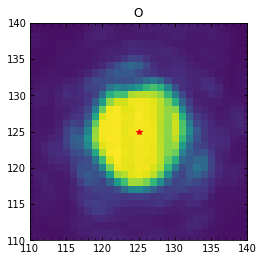

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03466.fits
bin_distcorr_lm_150104_03467.fits
8018.160820016687
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03467.fits: -0.9762369440449774, -0.3307821065957057


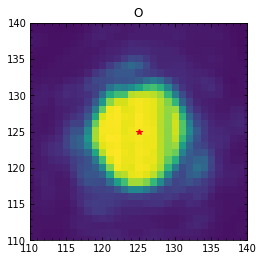

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03467.fits
bin_distcorr_lm_150104_03468.fits
7985.687672643038
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03468.fits: -0.9623580195670627, -0.3291334138953843


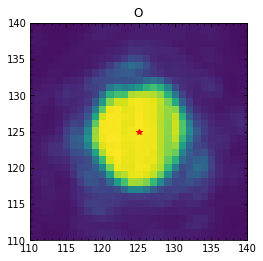

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03468.fits
bin_distcorr_lm_150104_03469.fits
7967.939246073092
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03469.fits: -0.9886386605291264, -0.3225863879068527


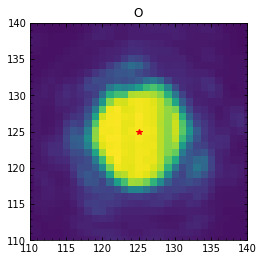

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03469.fits
bin_distcorr_lm_150104_03470.fits
7973.429719268059
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03470.fits: -0.9773216439066417, -0.3314769456234785


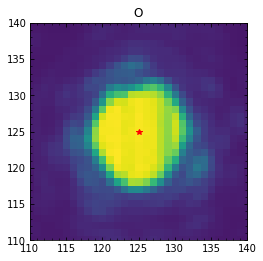

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03470.fits
bin_distcorr_lm_150104_03471.fits
7991.569031385184
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03471.fits: -0.9787986648949598, -0.3582063152410484


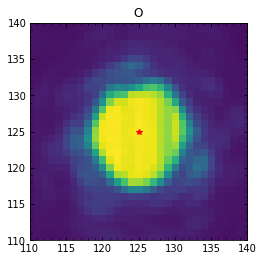

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03471.fits
bin_distcorr_lm_150104_03472.fits
7955.285324102575
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03472.fits: -0.9747572609357746, -0.5974707827583714


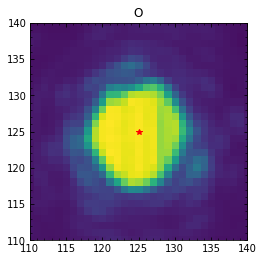

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03472.fits
bin_distcorr_lm_150104_03473.fits
7971.932645406317
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03473.fits: -0.9828326302800505, -0.6073571821498476


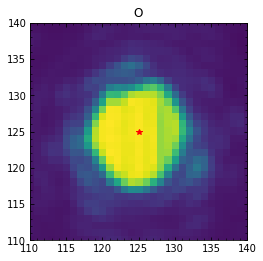

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03473.fits
bin_distcorr_lm_150104_03474.fits
8005.013796149764
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03474.fits: -0.9906282745331083, -0.6079335589116539


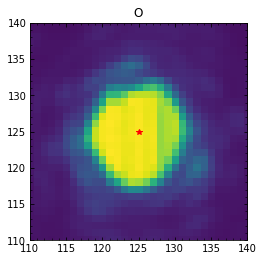

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03474.fits
bin_distcorr_lm_150104_03475.fits
8007.946464455724
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03475.fits: -1.0221981991882672, -0.611863590413904


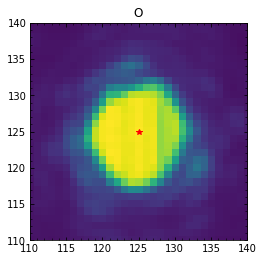

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03475.fits
bin_distcorr_lm_150104_03476.fits
7991.88393196828
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03476.fits: -0.9986483485443358, -0.6370824452633101


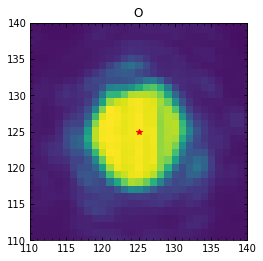

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03476.fits
bin_distcorr_lm_150104_03477.fits
8011.132266891974
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03477.fits: -0.9896896528340662, -0.6216424515393157


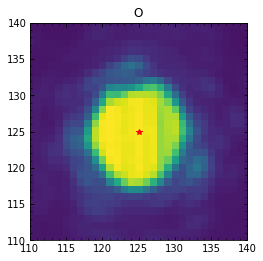

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03477.fits
bin_distcorr_lm_150104_03478.fits
8018.722971736571
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03478.fits: -0.9840971553508879, -0.6304888860121167


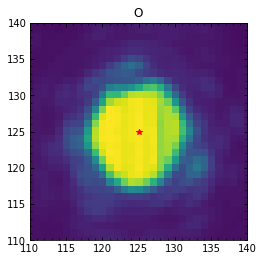

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03478.fits
bin_distcorr_lm_150104_03479.fits
8010.269824302869
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03479.fits: -0.9974881464364174, -0.6418761084343245


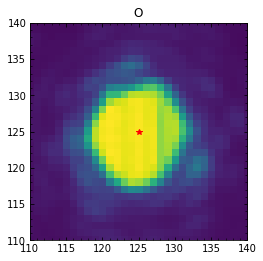

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03479.fits
bin_distcorr_lm_150104_03480.fits
8005.557019456125
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03480.fits: -1.0263998915562311, -0.6257836156464336


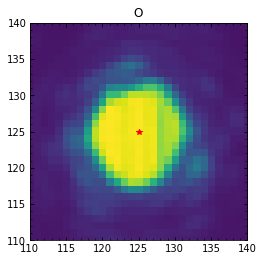

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03480.fits
bin_distcorr_lm_150104_03481.fits
8003.565417214592
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03481.fits: -1.0219262632083286, -0.62741806470477


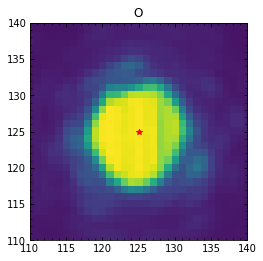

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03481.fits
bin_distcorr_lm_150104_03482.fits
7978.676863404175
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03482.fits: -1.0157663208433334, -0.6604590984158776


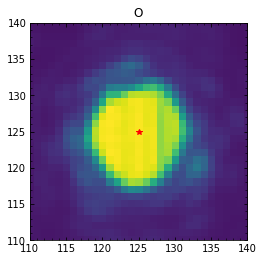

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03482.fits
bin_distcorr_lm_150104_03483.fits
7968.744129054512
STARTING  O
X: 194  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03483.fits: -0.9920203990432981, -0.6717454638682128


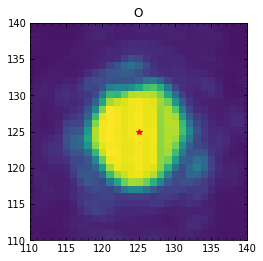

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03483.fits
bin_distcorr_lm_150104_03484.fits
7822.532798500957
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03484.fits: -0.28533801711824935, 0.13961016055792186


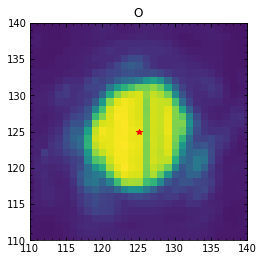

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03484.fits
bin_distcorr_lm_150104_03485.fits
7791.090832465243
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03485.fits: -0.28111563605339285, 0.14756839059175064


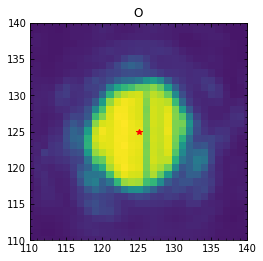

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03485.fits
bin_distcorr_lm_150104_03486.fits
7807.366228046311
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03486.fits: -0.27556298422748426, 0.139619822268493


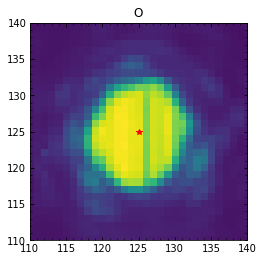

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03486.fits
bin_distcorr_lm_150104_03487.fits
7822.126513335375
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03487.fits: -0.2963362739241333, 0.12365286119121066


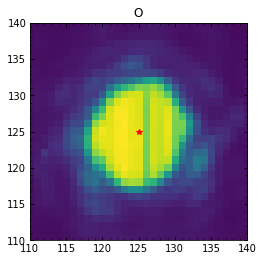

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03487.fits
bin_distcorr_lm_150104_03488.fits
7820.500832032539
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03488.fits: -0.2706921657783852, 0.11604803768804572


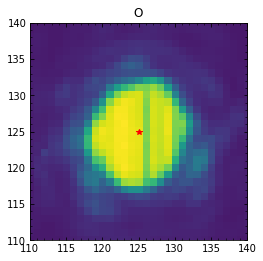

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03488.fits
bin_distcorr_lm_150104_03489.fits
7800.3883773101525
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03489.fits: -0.29951992585306186, 0.0866172382203132


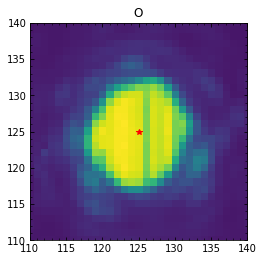

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03489.fits
bin_distcorr_lm_150104_03490.fits
7815.793914073171
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03490.fits: -0.30645382038831315, 0.08351676058668289


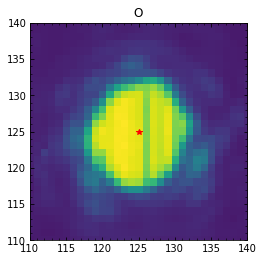

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03490.fits
bin_distcorr_lm_150104_03491.fits
7803.864661088387
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03491.fits: -0.26627552540799115, 0.06327269460952323


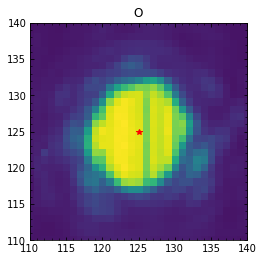

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03491.fits
bin_distcorr_lm_150104_03492.fits
7782.501385595102
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03492.fits: -0.3116460617546224, 0.08559010258768751


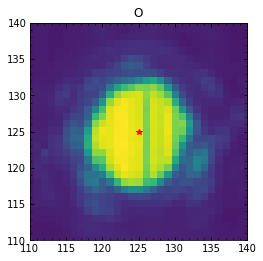

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03492.fits
bin_distcorr_lm_150104_03493.fits
7796.8250610377745
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03493.fits: -0.2917215412460763, 0.04549496513426021


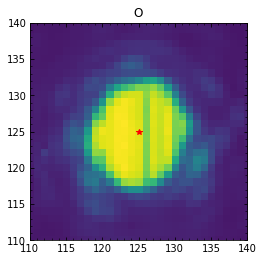

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03493.fits
bin_distcorr_lm_150104_03494.fits
7802.909090751937
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03494.fits: -0.31778535002009534, 0.09357839324749051


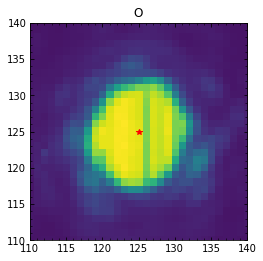

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03494.fits
bin_distcorr_lm_150104_03495.fits
7783.093397371163
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03495.fits: -0.29030780432722736, 0.09148850339444436


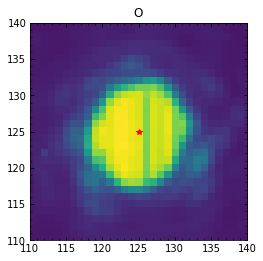

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03495.fits
bin_distcorr_lm_150104_03496.fits
7755.093495932044
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03496.fits: -0.3164671303987916, 0.05229601042090337


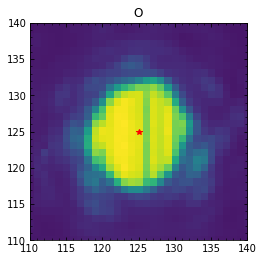

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03496.fits
bin_distcorr_lm_150104_03497.fits
7759.668430777175
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03497.fits: -0.28895533591762756, 0.020916798826114302


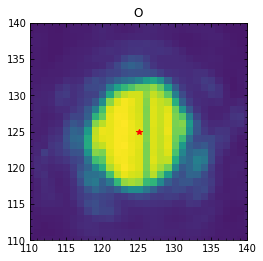

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03497.fits
bin_distcorr_lm_150104_03498.fits
7778.4994900171405
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03498.fits: -0.27595809101485, 0.06018667211620965


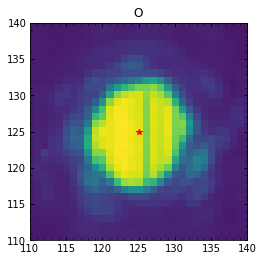

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03498.fits
bin_distcorr_lm_150104_03499.fits
7762.634346126339
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03499.fits: -0.301823428768067, 0.09172689556873337


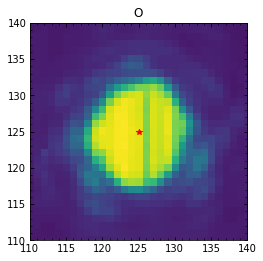

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03499.fits
bin_distcorr_lm_150104_03500.fits
7732.683044445475
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03500.fits: -0.32422951461403926, 0.02016874298347915


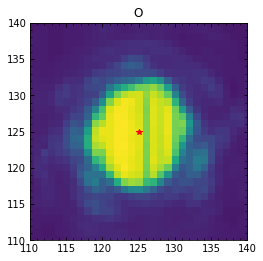

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03500.fits
bin_distcorr_lm_150104_03501.fits
7745.861740263585
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03501.fits: -0.2828897269761086, 0.01825675523141257


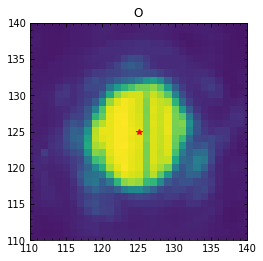

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03501.fits
bin_distcorr_lm_150104_03502.fits
7744.478160682518
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03502.fits: -0.3173367759165373, 0.00735310945486134


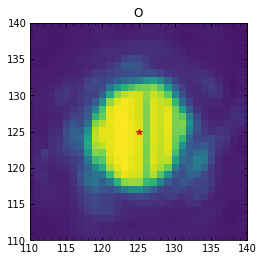

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03502.fits
bin_distcorr_lm_150104_03503.fits
7738.341486022967
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03503.fits: -0.3301552073474241, 0.002706095551332055


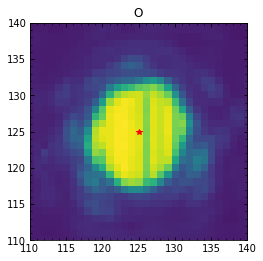

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03503.fits
bin_distcorr_lm_150104_03504.fits
7743.983777351343
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03504.fits: -0.3328476545034391, -0.0018220877291597048


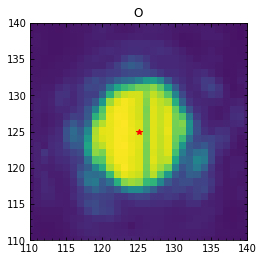

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03504.fits
bin_distcorr_lm_150104_03505.fits
7773.696605909553
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03505.fits: -0.2816533511245467, 0.004756789382589943


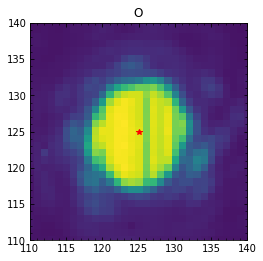

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03505.fits
bin_distcorr_lm_150104_03506.fits
7765.97578936272
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03506.fits: -0.2927336079098737, 0.003448641216451165


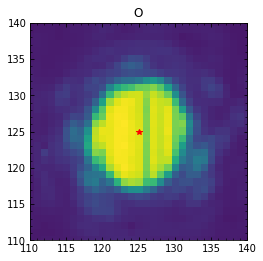

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03506.fits
bin_distcorr_lm_150104_03507.fits
7766.456469531769
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03507.fits: -0.2923371300565023, -0.028203018719786144


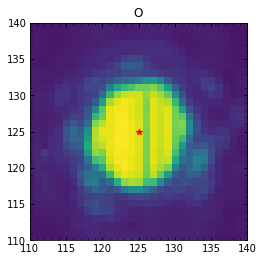

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03507.fits
bin_distcorr_lm_150104_03508.fits
7763.694780344473
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03508.fits: -0.3133885341788556, -0.013009332268879348


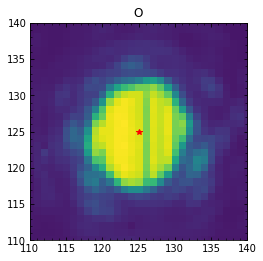

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03508.fits
bin_distcorr_lm_150104_03509.fits
7818.104217509345
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03509.fits: -0.3043905483214644, -0.0014446575474593715


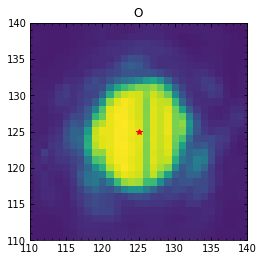

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03509.fits
bin_distcorr_lm_150104_03510.fits
7795.588419054927
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03510.fits: -0.31705103969799353, 0.004577033886207005


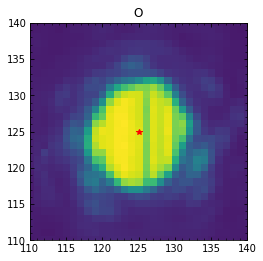

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03510.fits
bin_distcorr_lm_150104_03511.fits
7786.99210565344
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03511.fits: -0.32344862184430667, 0.007056027156316702


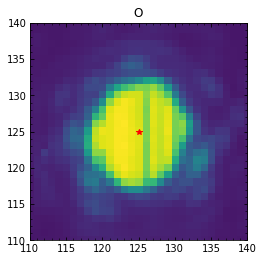

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03511.fits
bin_distcorr_lm_150104_03512.fits
7829.748789811501
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03512.fits: -0.328002475123121, -0.01935468277814323


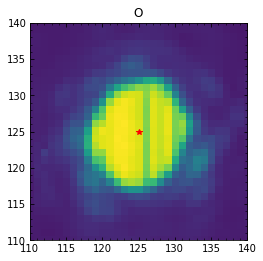

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03512.fits
bin_distcorr_lm_150104_03513.fits
7814.844000021733
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03513.fits: -0.3083588965733668, -0.02757834925355951


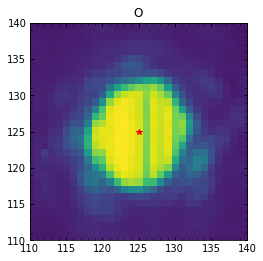

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03513.fits
bin_distcorr_lm_150104_03514.fits
7778.205355017154
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03514.fits: -0.3108031375983842, -0.05291590258921275


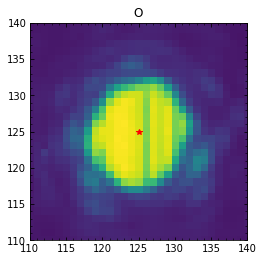

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03514.fits
bin_distcorr_lm_150104_03515.fits
7785.089394099033
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03515.fits: -0.30713795495945106, -0.02633636607209411


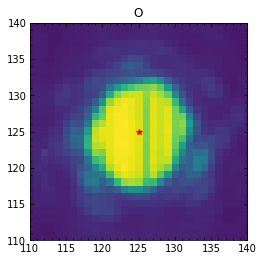

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03515.fits
bin_distcorr_lm_150104_03516.fits
7794.983152820674
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03516.fits: -0.2819599208996806, -0.053286743189126184


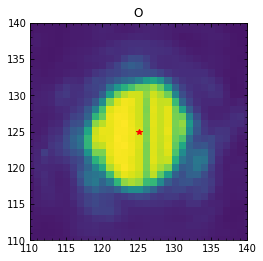

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03516.fits
bin_distcorr_lm_150104_03517.fits
7789.964455474783
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03517.fits: -0.2887197919369271, -0.04879362871887594


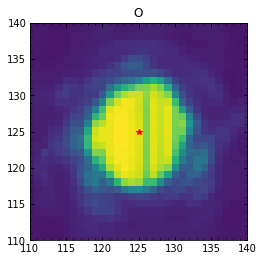

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03517.fits
bin_distcorr_lm_150104_03518.fits
7790.634028601307
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03518.fits: -0.3058345244088585, -0.05766364235017818


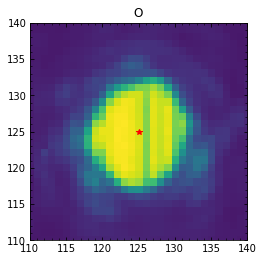

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03518.fits
bin_distcorr_lm_150104_03519.fits
7812.823837705021
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03519.fits: -0.32887012718633457, -0.08023278659509714


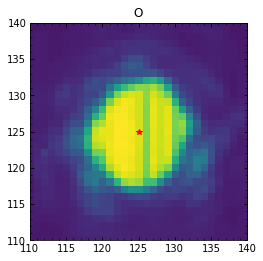

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03519.fits
bin_distcorr_lm_150104_03520.fits
7810.184947330319
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03520.fits: -0.31396208947288784, -0.0787031775007705


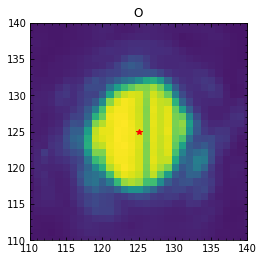

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03520.fits
bin_distcorr_lm_150104_03521.fits
7789.969864895335
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03521.fits: -0.32161185823291305, -0.13983178924343775


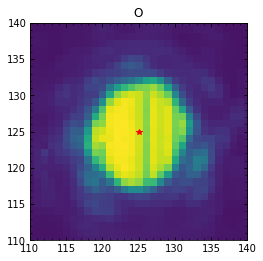

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03521.fits
bin_distcorr_lm_150104_03522.fits
7804.7787405194995
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03522.fits: -0.3726179949261308, -0.11351976180549883


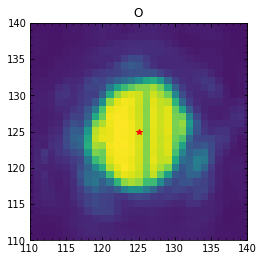

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03522.fits
bin_distcorr_lm_150104_03523.fits
7826.980123827448
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03523.fits: -0.354084657587471, -0.11484018684577535


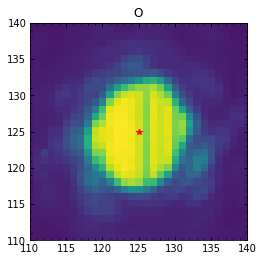

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03523.fits
bin_distcorr_lm_150104_03524.fits
7796.035263284559
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03524.fits: -0.35934958689276897, -0.12161314199247641


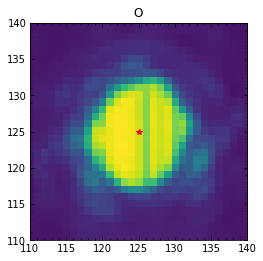

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03524.fits
bin_distcorr_lm_150104_03525.fits
7779.02055298945
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03525.fits: -0.3364746375797125, -0.10396368512633813


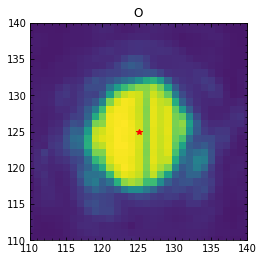

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03525.fits
bin_distcorr_lm_150104_03526.fits
7772.916435095668
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03526.fits: -0.3165080394564015, -0.108927570611705


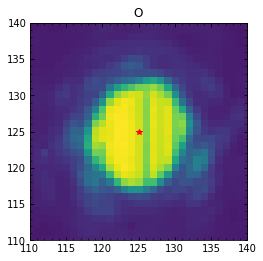

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03526.fits
bin_distcorr_lm_150104_03527.fits
7778.715773204145
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03527.fits: -0.31584702472106585, -0.10374670495690452


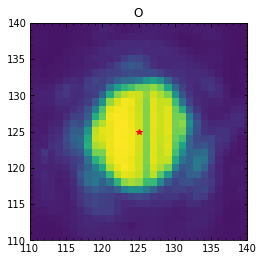

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03527.fits
bin_distcorr_lm_150104_03528.fits
7724.727201292341
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03528.fits: -0.297055779182557, -0.1017592027176164


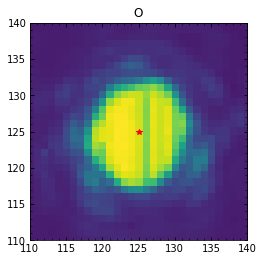

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03528.fits
bin_distcorr_lm_150104_03529.fits
7736.171797488794
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03529.fits: -0.31620214370529, -0.1252909348552862


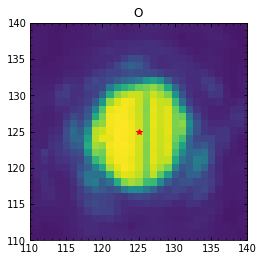

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03529.fits
bin_distcorr_lm_150104_03530.fits
7772.6912572994825
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03530.fits: -0.31792321490107156, -0.10359025801383837


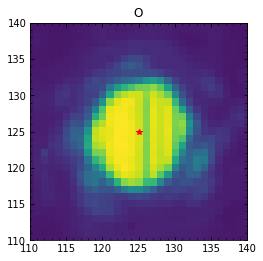

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03530.fits
bin_distcorr_lm_150104_03531.fits
7772.50774442244
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03531.fits: -0.3581458162676725, -0.15777203152295272


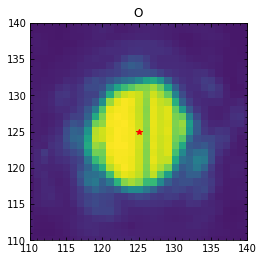

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03531.fits
bin_distcorr_lm_150104_03532.fits
7763.218886781502
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03532.fits: -0.33059908580076325, -0.1409961864684135


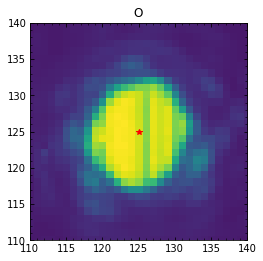

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03532.fits
bin_distcorr_lm_150104_03533.fits
7750.137862492915
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03533.fits: -0.3105616254902088, -0.14339501934453125


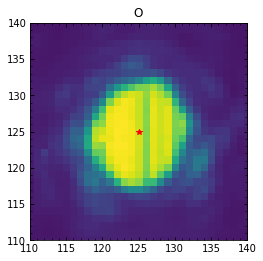

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03533.fits
bin_distcorr_lm_150104_03534.fits
7791.070299009914
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03534.fits: -0.3695958609985297, -0.1554451973240134


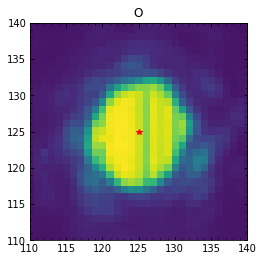

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03534.fits
bin_distcorr_lm_150104_03535.fits
7766.201148513686
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03535.fits: -0.3362136726748375, -0.16801757026273378


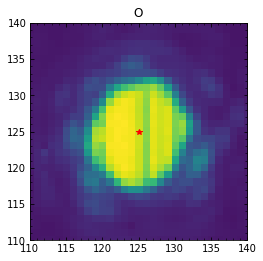

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03535.fits
bin_distcorr_lm_150104_03536.fits
7778.121685936223
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03536.fits: -0.3422298662746712, -0.15973044199809294


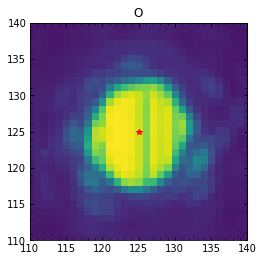

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03536.fits
bin_distcorr_lm_150104_03537.fits
7805.192003751399
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03537.fits: -0.34642850186855867, -0.1528990159256267


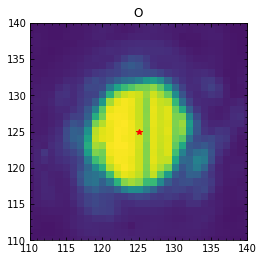

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03537.fits
bin_distcorr_lm_150104_03538.fits
7788.881009889768
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03538.fits: -0.3310561600461881, -0.16505839021898083


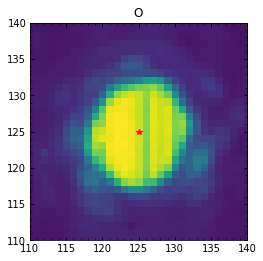

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03538.fits
bin_distcorr_lm_150104_03539.fits
7777.492282622919
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03539.fits: -0.34424098717816776, -0.16497820807100538


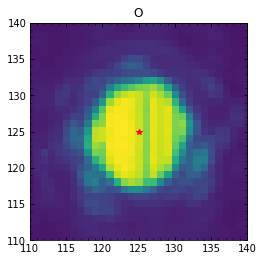

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03539.fits
bin_distcorr_lm_150104_03540.fits
7812.008925891453
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03540.fits: -0.3239053157758107, -0.16388133454665166


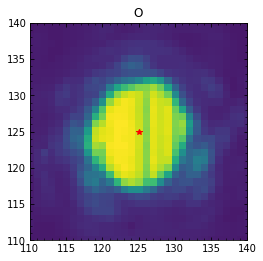

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03540.fits
bin_distcorr_lm_150104_03541.fits
7805.301349469058
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03541.fits: -0.36065024584736705, -0.1617654355228737


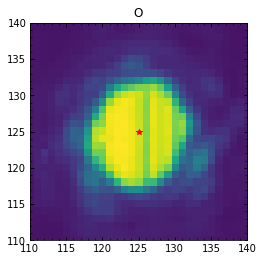

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03541.fits
bin_distcorr_lm_150104_03542.fits
7779.983524254119
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03542.fits: -0.37527323472378527, -0.20422569267027058


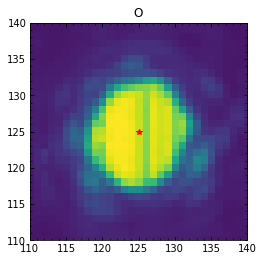

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03542.fits
bin_distcorr_lm_150104_03543.fits
7770.837738003782
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03543.fits: -0.3664690243327442, -0.22319315334573986


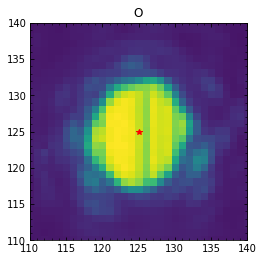

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03543.fits
bin_distcorr_lm_150104_03544.fits
7802.162084674214
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03544.fits: -0.35979069726164425, -0.2146167228046849


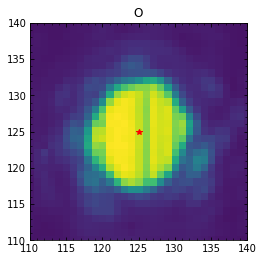

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03544.fits
bin_distcorr_lm_150104_03545.fits
7796.921016935321
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03545.fits: -0.34131564682640914, -0.22291255177053415


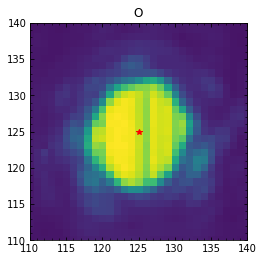

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03545.fits
bin_distcorr_lm_150104_03546.fits
7770.6394854814
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03546.fits: -0.35027380808947584, -0.22582937025142513


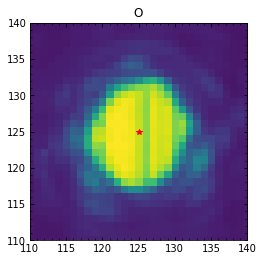

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03546.fits
bin_distcorr_lm_150104_03547.fits
7780.333530592545
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03547.fits: -0.3473761257255461, -0.2331690089062164


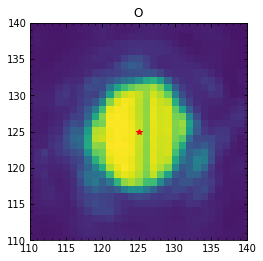

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03547.fits
bin_distcorr_lm_150104_03548.fits
7780.699554706926
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03548.fits: -0.3611153408935408, -0.22498569458956297


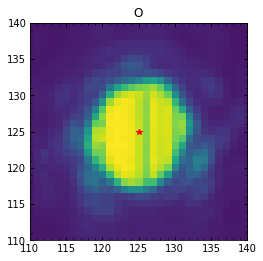

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03548.fits
bin_distcorr_lm_150104_03549.fits
7744.987690809416
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03549.fits: -0.33339437789732074, -0.23446163479405158


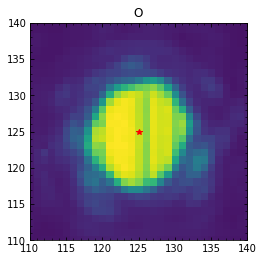

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03549.fits
bin_distcorr_lm_150104_03550.fits
7741.348445351005
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03550.fits: -0.30557737192283696, -0.2315108610828318


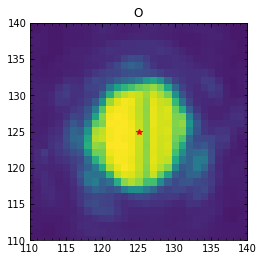

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03550.fits
bin_distcorr_lm_150104_03551.fits
7772.553306608659
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03551.fits: -0.3297140791988653, -0.22401923625174192


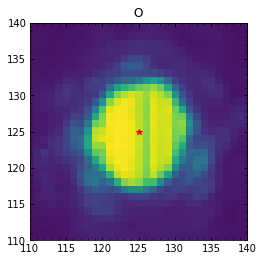

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03551.fits
bin_distcorr_lm_150104_03552.fits
7778.117054245053
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03552.fits: -0.3097377004010795, -0.23437229719383623


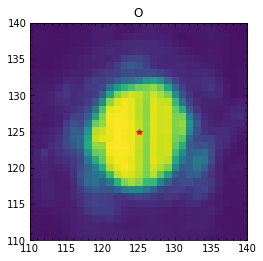

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03552.fits
bin_distcorr_lm_150104_03553.fits
7763.1592339072995
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03553.fits: -0.3218370664322663, -0.23655244373560436


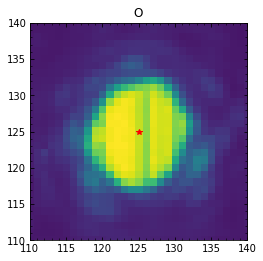

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03553.fits
bin_distcorr_lm_150104_03554.fits
7754.930656931603
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03554.fits: -0.35974201640061665, -0.22634930975319634


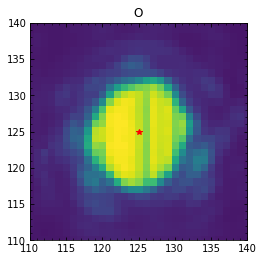

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03554.fits
bin_distcorr_lm_150104_03555.fits
7783.667972229561
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03555.fits: -0.33124544347560203, -0.22856645848073498


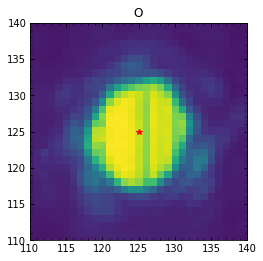

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03555.fits
bin_distcorr_lm_150104_03556.fits
7783.914202405184
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03556.fits: -0.34201941480175435, -0.23785135871452923


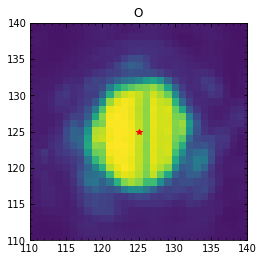

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03556.fits
bin_distcorr_lm_150104_03557.fits
7752.185857669728
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03557.fits: -0.3389554547369471, -0.27144358590089723


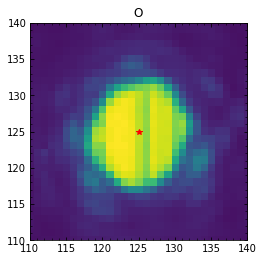

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03557.fits
bin_distcorr_lm_150104_03558.fits
7776.132588922536
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03558.fits: -0.35473924919581634, -0.27399082046517975


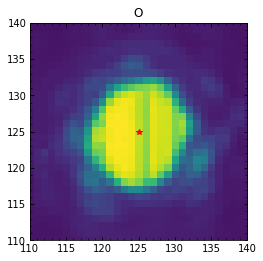

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03558.fits
bin_distcorr_lm_150104_03559.fits
7776.4847788593615
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03559.fits: -0.3355472183450985, -0.2732863384417783


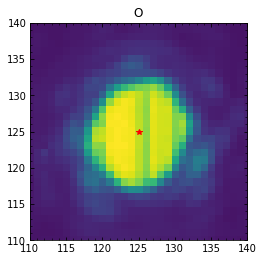

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03559.fits
bin_distcorr_lm_150104_03560.fits
7777.202205461529
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03560.fits: -0.3333651836888265, -0.291468185181607


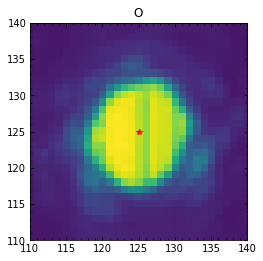

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03560.fits
bin_distcorr_lm_150104_03561.fits
7748.84133360916
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03561.fits: -0.3879613304405467, -0.2662355067173934


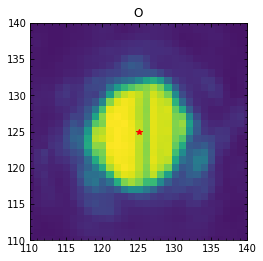

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03561.fits
bin_distcorr_lm_150104_03562.fits
7789.18577579699
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03562.fits: -0.35153170220663554, -0.2890382263418019


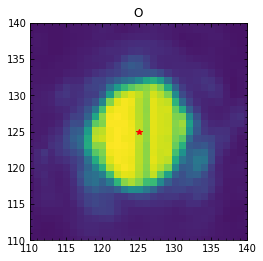

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03562.fits
bin_distcorr_lm_150104_03563.fits
7789.043610319218
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03563.fits: -0.3493270450707584, -0.2875900530501099


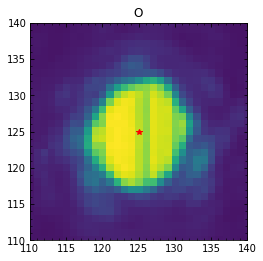

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03563.fits
bin_distcorr_lm_150104_03564.fits
7760.199367221031
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03564.fits: -0.3228002800520784, -0.2980302811433191


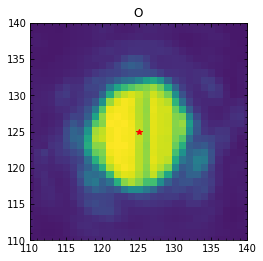

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03564.fits
bin_distcorr_lm_150104_03565.fits
7787.262077256769
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03565.fits: -0.32336955158282876, -0.31314793011826936


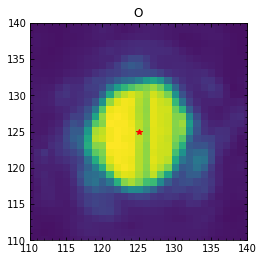

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03565.fits
bin_distcorr_lm_150104_03566.fits
7799.7426168176835
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03566.fits: -0.3338480306601923, -0.3230100935983131


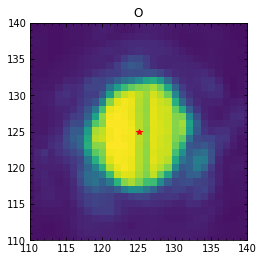

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03566.fits
bin_distcorr_lm_150104_03567.fits
7773.490606204655
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03567.fits: -0.35437958742854647, -0.303461026949968


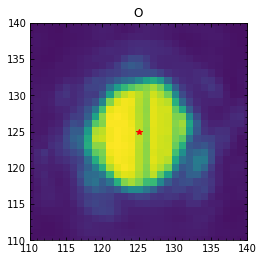

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03567.fits
bin_distcorr_lm_150104_03568.fits
7766.609172086182
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03568.fits: -0.369753395453408, -0.31721832752311485


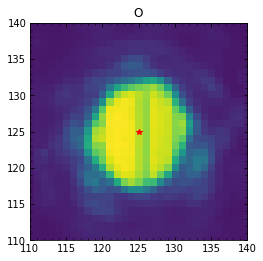

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03568.fits
bin_distcorr_lm_150104_03569.fits
7780.3797997168385
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03569.fits: -0.36453105359284166, -0.32930954831480364


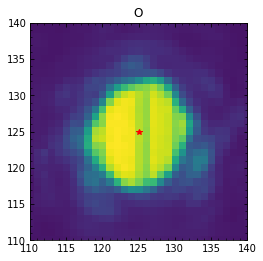

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03569.fits
bin_distcorr_lm_150104_03570.fits
7761.50431018301
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03570.fits: -0.35777031794579983, -0.3198389054014896


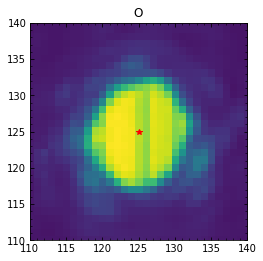

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03570.fits
bin_distcorr_lm_150104_03571.fits
7759.516473555535
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03571.fits: -0.3299194626979869, -0.3145877026408641


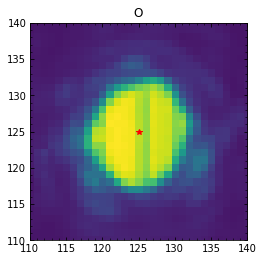

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03571.fits
bin_distcorr_lm_150104_03572.fits
7775.719118647056
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03572.fits: -0.3640365166288859, -0.32918383327095313


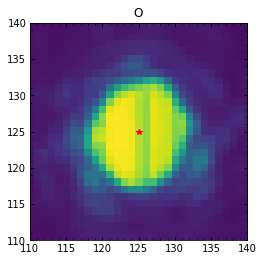

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03572.fits
bin_distcorr_lm_150104_03573.fits
7779.21653628553
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03573.fits: -0.36657900984613434, -0.3106432027977135


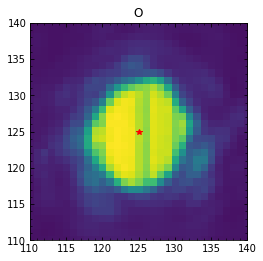

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03573.fits
bin_distcorr_lm_150104_03574.fits
7725.098797569306
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03574.fits: -0.3219169959661059, -0.34914369659805544


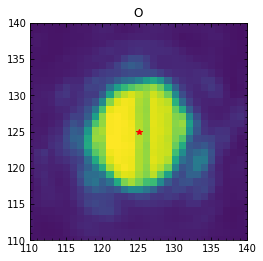

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03574.fits
bin_distcorr_lm_150104_03575.fits
7741.492641893763
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03575.fits: -0.3383604210929221, -0.3487571281717976


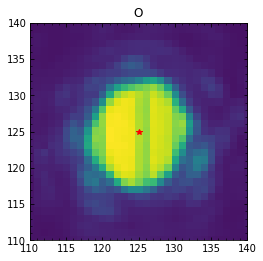

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03575.fits
bin_distcorr_lm_150104_03576.fits
7752.462136792741
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03576.fits: -0.3418949855827904, -0.3628672460794746


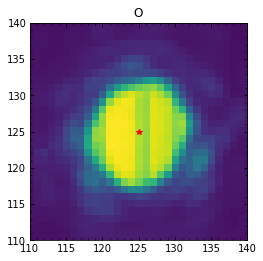

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03576.fits
bin_distcorr_lm_150104_03577.fits
7749.112006350026
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03577.fits: -0.6326626359932206, -0.6099939298519743


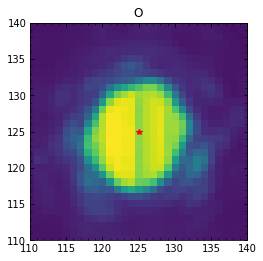

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03577.fits
bin_distcorr_lm_150104_03578.fits
7746.135399113507
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03578.fits: -0.35857432881041973, -0.36404409338987875


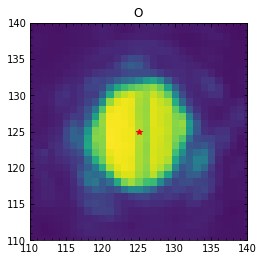

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03578.fits
bin_distcorr_lm_150104_03579.fits
7713.522205434767
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03579.fits: -0.3403143465052736, -0.3682623850382001


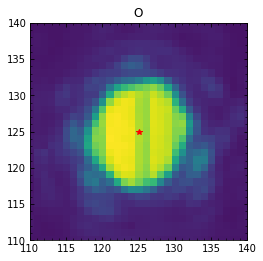

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03579.fits
bin_distcorr_lm_150104_03580.fits
7742.38753600576
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03580.fits: -0.5974313081168319, -0.6322003167266956


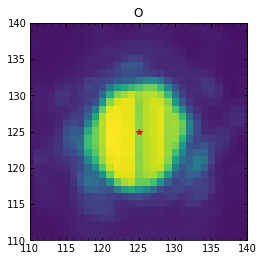

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03580.fits
bin_distcorr_lm_150104_03581.fits
7758.428331626793
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03581.fits: -0.36246247335070336, -0.37425934359621493


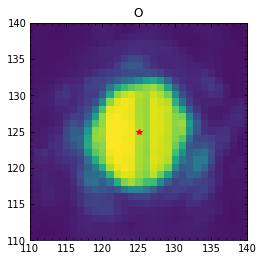

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03581.fits
bin_distcorr_lm_150104_03582.fits
7731.902900207495
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03582.fits: -0.5968210920937622, -0.6416122618706694


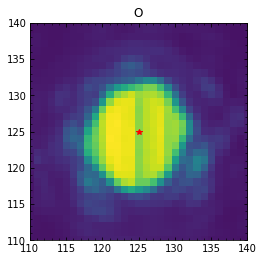

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03582.fits
bin_distcorr_lm_150104_03583.fits
7765.073671969241
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03583.fits: -0.343497706158324, -0.38566969005689344


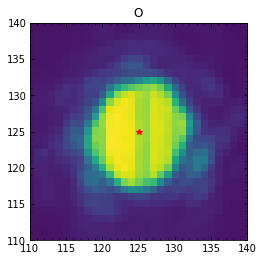

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03583.fits
bin_distcorr_lm_150104_03584.fits
7770.5984258565895
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03584.fits: -0.6116004866036207, -0.627607722278519


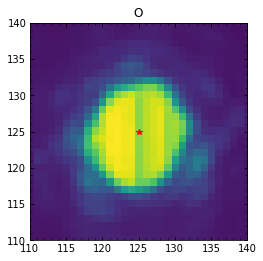

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03584.fits
bin_distcorr_lm_150104_03585.fits
7729.122251050181
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03585.fits: -0.60937827214196, -0.6504919069964501


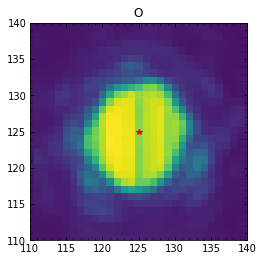

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03585.fits
bin_distcorr_lm_150104_03586.fits
7748.134064963828
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03586.fits: -0.6304919938144948, -0.6585553359616299


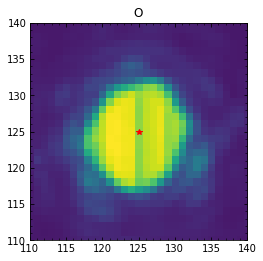

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03586.fits
bin_distcorr_lm_150104_03587.fits
7772.326370447379
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03587.fits: -0.6363058155885355, -0.6402270418587506


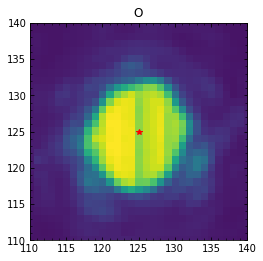

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03587.fits
bin_distcorr_lm_150104_03588.fits
7748.14718120164
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03588.fits: -0.6328413536640909, -0.674812331280549


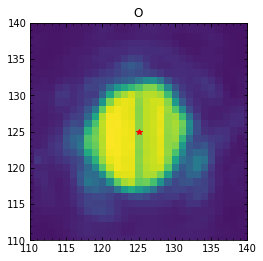

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03588.fits
bin_distcorr_lm_150104_03589.fits
7751.914026881418
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03589.fits: -0.6506635851965683, -0.6638792925424966


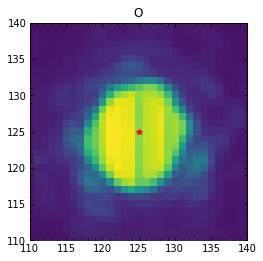

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03589.fits
bin_distcorr_lm_150104_03590.fits
7748.401972865071
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03590.fits: -0.6338205909134516, -0.6874054727031833


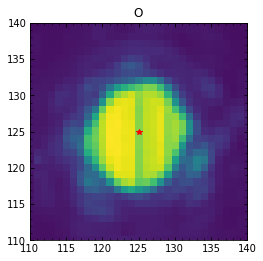

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03590.fits
bin_distcorr_lm_150104_03591.fits
7794.681291057857
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03591.fits: -0.6587560954628842, -0.674807446699127


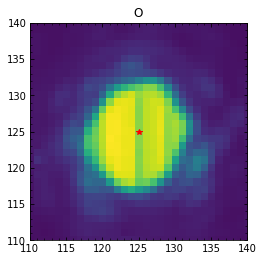

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03591.fits
bin_distcorr_lm_150104_03592.fits
7755.1220285045965
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03592.fits: -0.6536889744878494, -0.676334419707679


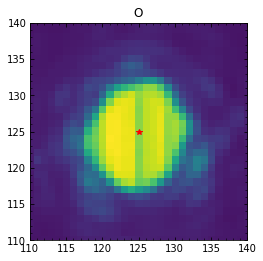

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03592.fits
bin_distcorr_lm_150104_03593.fits
7741.4309297970085
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03593.fits: -0.6277384474709748, -0.6878021471763702


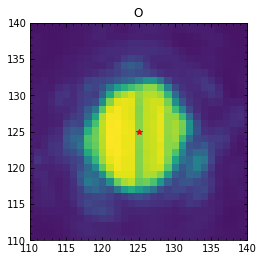

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03593.fits
bin_distcorr_lm_150104_03594.fits
7738.798638259306
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03594.fits: -0.6344749629477988, -0.695029188555047


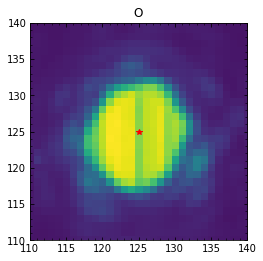

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03594.fits
bin_distcorr_lm_150104_03595.fits
7742.007348929174
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03595.fits: -0.6086153890081647, -0.6810622286746977


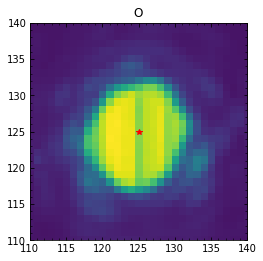

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03595.fits
bin_distcorr_lm_150104_03596.fits
7735.660514653027
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03596.fits: -0.6019356654504833, -0.6909646641613634


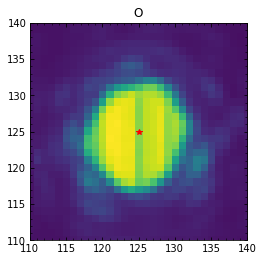

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03596.fits
bin_distcorr_lm_150104_03597.fits
7751.146160060545
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03597.fits: -0.6331018120862524, -0.6821910586307212


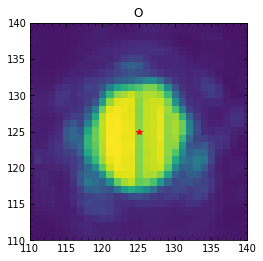

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03597.fits
bin_distcorr_lm_150104_03598.fits
7739.647000021096
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03598.fits: -0.6203982048687777, -0.6973066878392444


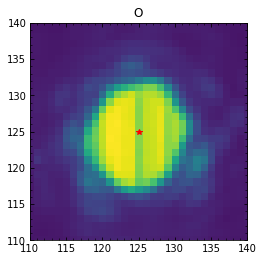

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03598.fits
bin_distcorr_lm_150104_03599.fits
7749.4980129173555
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03599.fits: -0.6392544324212608, -0.6990214906286241


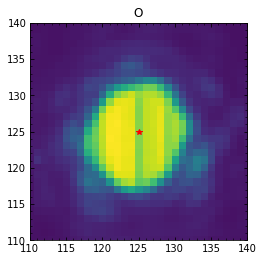

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03599.fits
bin_distcorr_lm_150104_03600.fits
7719.543536274958
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03600.fits: -0.632506278367778, -0.7053394889948237


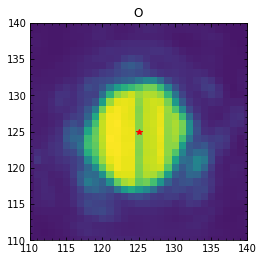

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03600.fits
bin_distcorr_lm_150104_03601.fits
7735.797475088706
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03601.fits: -0.7018890548325061, -0.7010531676257159


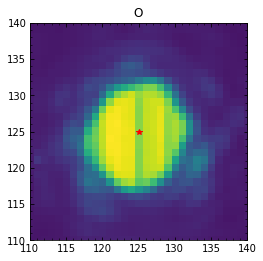

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03601.fits
bin_distcorr_lm_150104_03602.fits
7725.0989991482875
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03602.fits: -0.6966254768469966, -0.7084985937127541


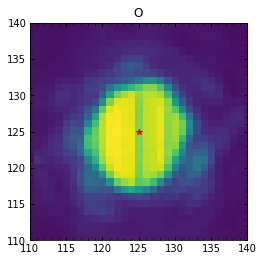

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03602.fits
bin_distcorr_lm_150104_03603.fits
7707.102203589702
STARTING  O
X: 199  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03603.fits: -0.65030544667745, -0.7398101809314568


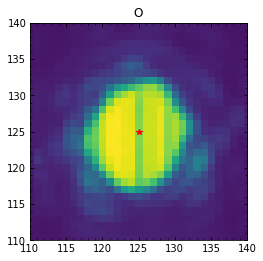

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03603.fits
bin_distcorr_lm_150104_03604.fits
7932.973795405794
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03604.fits: -0.741939357655788, -0.33277564637651835


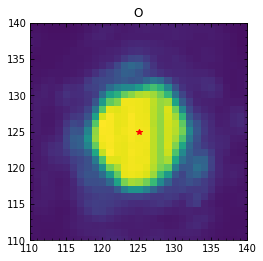

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03604.fits
bin_distcorr_lm_150104_03605.fits
7872.406292462219
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03605.fits: -0.779676155679013, -0.3110973573658242


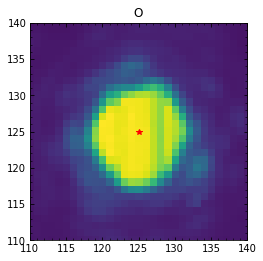

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03605.fits
bin_distcorr_lm_150104_03606.fits
7886.127300076794
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03606.fits: -0.7593369527865761, -0.3494339549154617


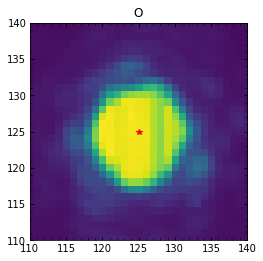

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03606.fits
bin_distcorr_lm_150104_03607.fits
7905.9956362310895
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03607.fits: -0.804847657121428, -0.3551343207432325


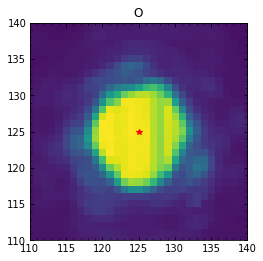

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03607.fits
bin_distcorr_lm_150104_03608.fits
7894.090021589212
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03608.fits: -0.808160762399261, -0.6091051375661678


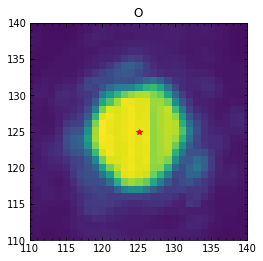

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03608.fits
bin_distcorr_lm_150104_03609.fits
7908.733960172371
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03609.fits: -0.8388869734187381, -0.6206477003895614


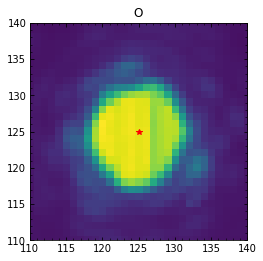

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03609.fits
bin_distcorr_lm_150104_03610.fits
7914.545988177983
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03610.fits: -0.8027912492923193, -0.3662593134641199


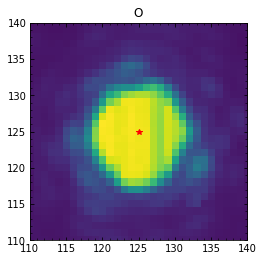

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03610.fits
bin_distcorr_lm_150104_03611.fits
7926.780579899831
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03611.fits: -0.7690004744910581, -0.3472339132446436


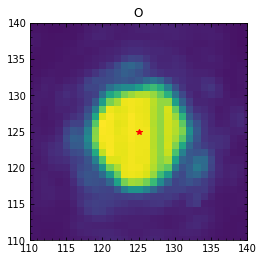

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03611.fits
bin_distcorr_lm_150104_03612.fits
7908.190638827733
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03612.fits: -0.8082476588313128, -0.36198958480858323


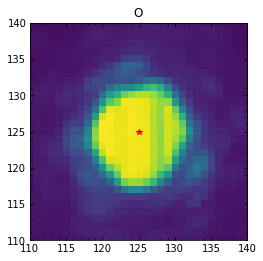

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03612.fits
bin_distcorr_lm_150104_03613.fits
7903.806692162807
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03613.fits: -0.8170828304576645, -0.3407182301155629


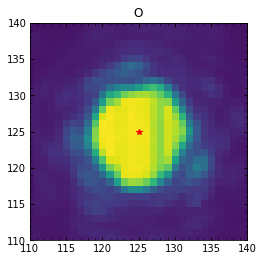

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03613.fits
bin_distcorr_lm_150104_03614.fits
7900.910617298745
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03614.fits: -0.8080124342749073, -0.34734629484615454


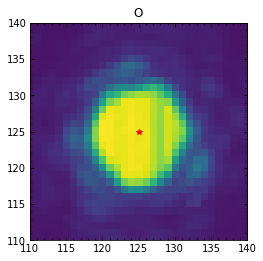

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03614.fits
bin_distcorr_lm_150104_03615.fits
7937.8233184783
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03615.fits: -0.7928571552740706, -0.3581784854836769


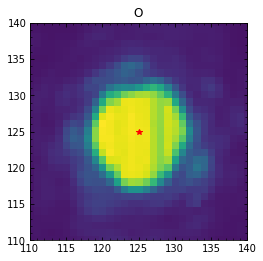

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03615.fits
bin_distcorr_lm_150104_03616.fits
7918.978781648001
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03616.fits: -0.7817886098090767, -0.3692875738280179


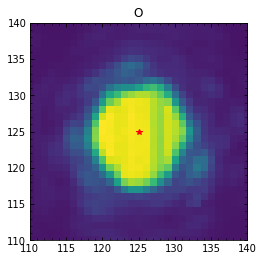

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03616.fits
bin_distcorr_lm_150104_03617.fits
7917.302504925646
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03617.fits: -0.7871548691237606, -0.3593452196270235


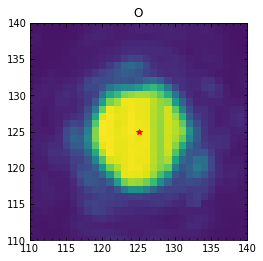

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03617.fits
bin_distcorr_lm_150104_03618.fits
7929.873974648837
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03618.fits: -0.8065569912410453, -0.3849760905799613


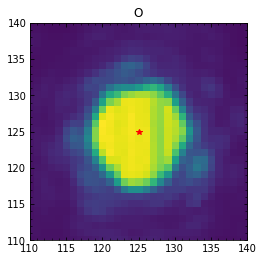

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03618.fits
bin_distcorr_lm_150104_03619.fits
7946.263466763847
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03619.fits: -0.8539229375425492, -0.37627426636373684


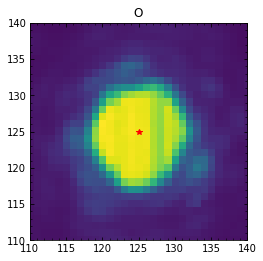

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03619.fits
bin_distcorr_lm_150104_03620.fits
7935.187150276621
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03620.fits: -0.8548273688843295, -0.37263877904355525


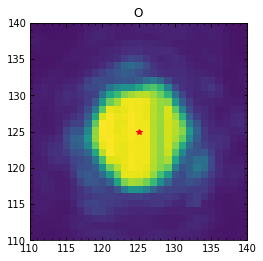

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03620.fits
bin_distcorr_lm_150104_03621.fits
7910.369909792482
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03621.fits: -0.8682701164368325, -0.6053079409194311


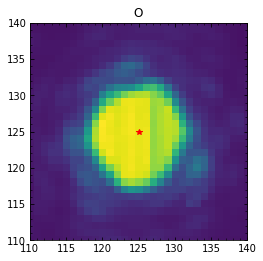

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03621.fits
bin_distcorr_lm_150104_03622.fits
7928.832751673461
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03622.fits: -0.8159594539626482, -0.6075440484253605


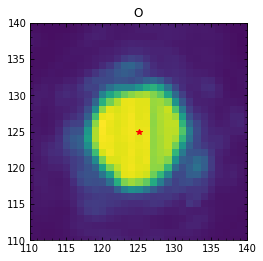

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03622.fits
bin_distcorr_lm_150104_03623.fits
7891.303756773053
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03623.fits: -0.8200817268531608, -0.6079721198340877


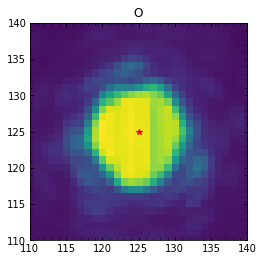

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03623.fits
bin_distcorr_lm_150104_03624.fits
7868.393729737338
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03624.fits: -0.8159304015373294, -0.5980471737026747


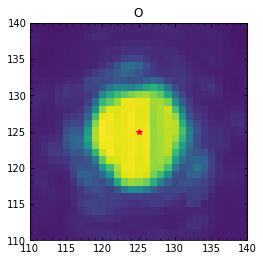

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03624.fits
bin_distcorr_lm_150104_03625.fits
7913.154199505476
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03625.fits: -0.801153752666913, -0.6202480734353273


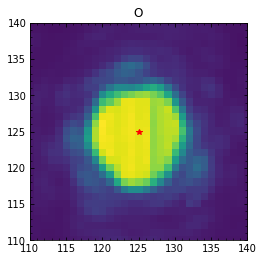

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03625.fits
bin_distcorr_lm_150104_03626.fits
7904.088545531409
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03626.fits: -0.8245581580311026, -0.618636048483836


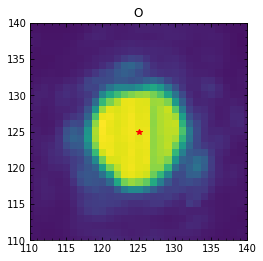

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03626.fits
bin_distcorr_lm_150104_03627.fits
7883.297534203925
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03627.fits: -0.8607675828136507, -0.6253418278809093


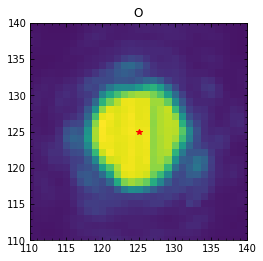

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03627.fits
bin_distcorr_lm_150104_03628.fits
7909.856611991128
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03628.fits: -0.8644157143759728, -0.6642316892664013


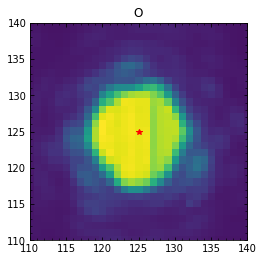

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03628.fits
bin_distcorr_lm_150104_03629.fits
7948.970030242184
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03629.fits: -0.83607327090985, -0.634969440034375


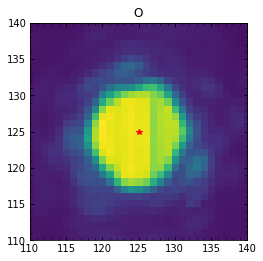

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03629.fits
bin_distcorr_lm_150104_03630.fits
7940.028378894607
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03630.fits: -0.848077869892272, -0.6420547692642202


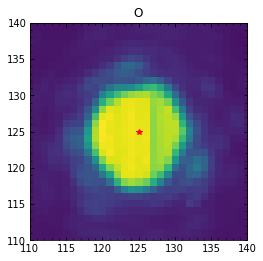

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03630.fits
bin_distcorr_lm_150104_03631.fits
7927.816027218435
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03631.fits: -0.8448791654399344, -0.6416145156155579


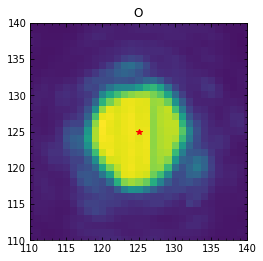

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03631.fits
bin_distcorr_lm_150104_03632.fits
7934.4987143991575
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03632.fits: -0.8469297897979757, -0.6351634775618393


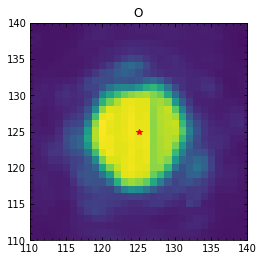

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03632.fits
bin_distcorr_lm_150104_03633.fits
7942.401486061159
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03633.fits: -0.8694851685002902, -0.6463326310499653


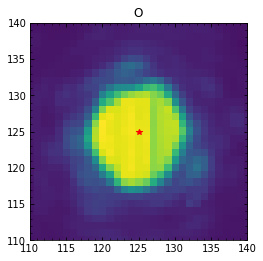

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03633.fits
bin_distcorr_lm_150104_03634.fits
7919.290483749873
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03634.fits: -0.8596388750488941, -0.6645241448821082


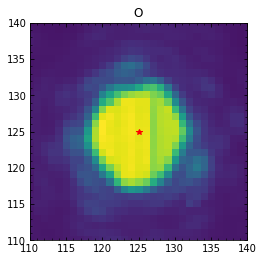

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03634.fits
bin_distcorr_lm_150104_03635.fits
7949.562068830657
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03635.fits: -0.8730754706072403, -0.6584260096021168


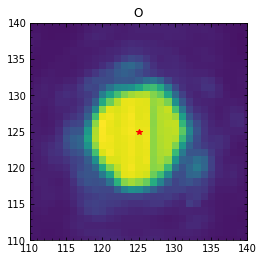

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03635.fits
bin_distcorr_lm_150104_03636.fits
7954.567552131023
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03636.fits: -0.8438406103343539, -0.6203641012289225


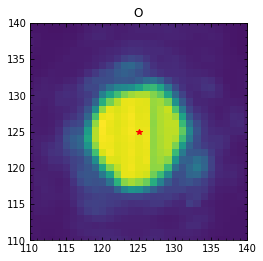

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03636.fits
bin_distcorr_lm_150104_03637.fits
7903.739396447912
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03637.fits: -0.8453878401143982, -0.6537741236600993


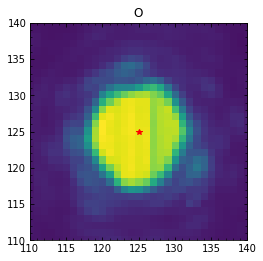

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03637.fits
bin_distcorr_lm_150104_03638.fits
7903.822020536878
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03638.fits: -0.8199945890597888, -0.6617139233863298


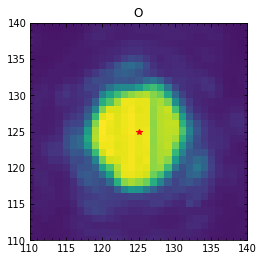

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03638.fits
bin_distcorr_lm_150104_03639.fits
7908.871430422379
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03639.fits: -0.7934016345971742, -0.6531944964615093


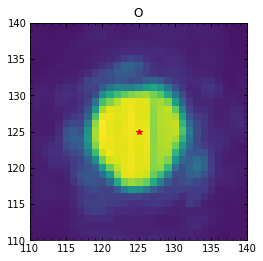

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03639.fits
bin_distcorr_lm_150104_03640.fits
7906.872225298712
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03640.fits: -0.801986436105139, -0.6486813259774635


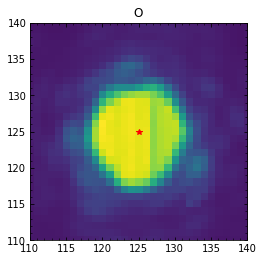

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03640.fits
bin_distcorr_lm_150104_03641.fits
7886.229035746421
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03641.fits: -0.8007345971028101, -0.6576990246553791


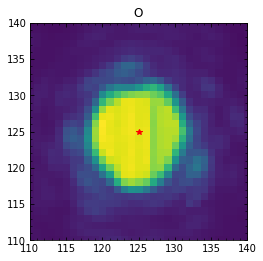

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03641.fits
bin_distcorr_lm_150104_03642.fits
7926.194269035153
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03642.fits: -0.8180466294614845, -0.6665916774933223


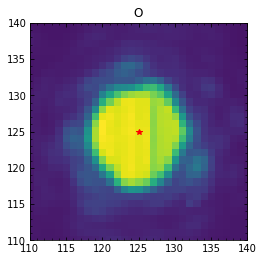

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03642.fits
bin_distcorr_lm_150104_03643.fits
7921.355347181428
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03643.fits: -0.8060918114317843, -0.6796720072526767


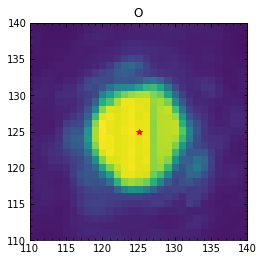

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03643.fits
bin_distcorr_lm_150104_03644.fits
7922.605088081125
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03644.fits: -0.8414483849737806, -0.673751934194506


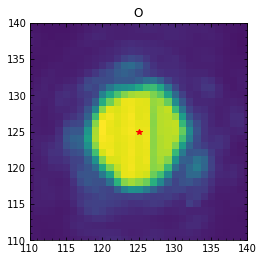

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03644.fits
bin_distcorr_lm_150104_03645.fits
7907.208297968457
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03645.fits: -0.8276658615537542, -0.6951900024351119


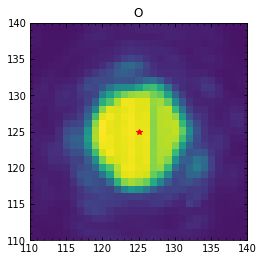

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03645.fits
bin_distcorr_lm_150104_03646.fits
7939.821548949054
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03646.fits: -0.8310454418577322, -0.700628186189654


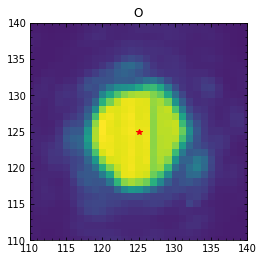

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03646.fits
bin_distcorr_lm_150104_03647.fits
7949.63790895087
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03647.fits: -0.8516789181942741, -0.702024077573256


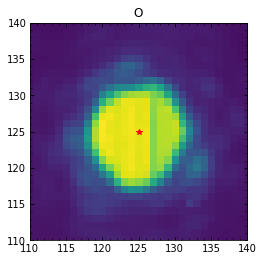

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03647.fits
bin_distcorr_lm_150104_03648.fits
7900.497899117772
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03648.fits: -0.8673546927226781, -0.6934681968624972


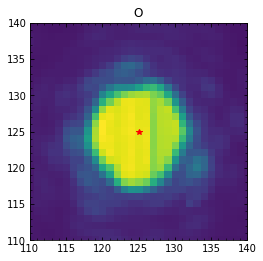

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03648.fits
bin_distcorr_lm_150104_03649.fits
7906.311665370534
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03649.fits: -0.8846283208827543, -0.7150529304033455


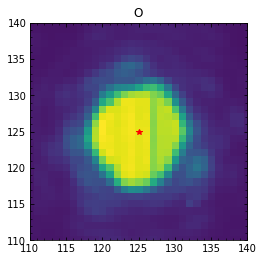

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03649.fits
bin_distcorr_lm_150104_03650.fits
7920.904789426728
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03650.fits: -0.8564539737427026, -0.740478873321571


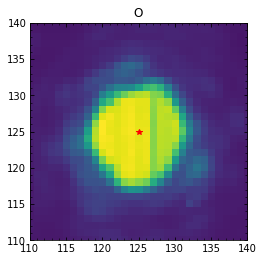

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03650.fits
bin_distcorr_lm_150104_03651.fits
7904.685543619982
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03651.fits: -0.8320316876887262, -0.7047955088588367


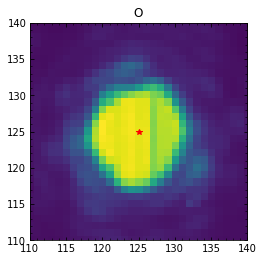

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03651.fits
bin_distcorr_lm_150104_03652.fits
7881.802526624176
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03652.fits: -0.8768968687385339, -0.7163456595200159


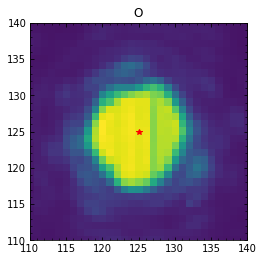

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03652.fits
bin_distcorr_lm_150104_03653.fits
7892.831961470849
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03653.fits: -0.8634627185734445, -0.7189446124014722


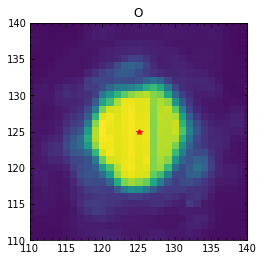

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03653.fits
bin_distcorr_lm_150104_03654.fits
7892.165077191681
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03654.fits: -0.8790046442107169, -0.7278347602558384


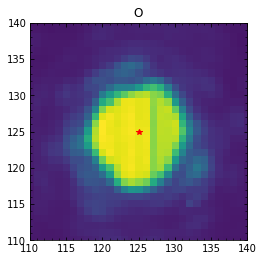

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03654.fits
bin_distcorr_lm_150104_03655.fits
7863.227308382042
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03655.fits: -0.8684478210695872, -0.7564121047469072


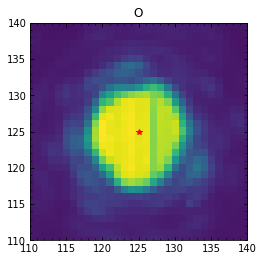

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03655.fits
bin_distcorr_lm_150104_03656.fits
7899.737812394684
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03656.fits: -0.8413493164063865, -0.7479691811285463


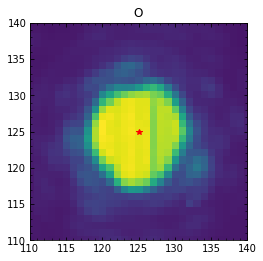

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03656.fits
bin_distcorr_lm_150104_03657.fits
7906.281191401096
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03657.fits: -0.867751502932741, -0.743131222400109


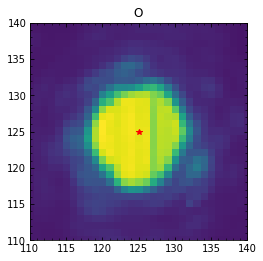

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03657.fits
bin_distcorr_lm_150104_03658.fits
7891.702266803397
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03658.fits: -0.8455976809714798, -0.7592576984739736


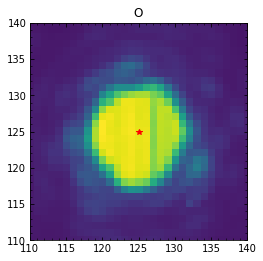

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03658.fits
bin_distcorr_lm_150104_03659.fits
7883.361423081953
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03659.fits: -0.8723486349314058, -0.7655742028552694


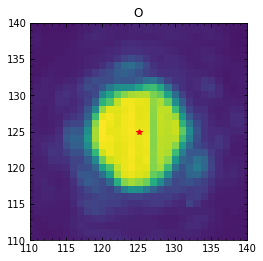

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03659.fits
bin_distcorr_lm_150104_03660.fits
7895.000052088973
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03660.fits: -0.8734298746432003, -0.7576326420848716


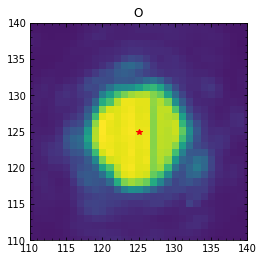

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03660.fits
bin_distcorr_lm_150104_03661.fits
7906.296419696621
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03661.fits: -0.8960697320168194, -0.7399104419905314


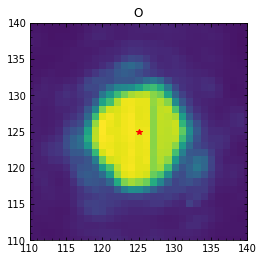

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03661.fits
bin_distcorr_lm_150104_03662.fits
7885.746947372816
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03662.fits: -0.8912554179531256, -0.7331033782116236


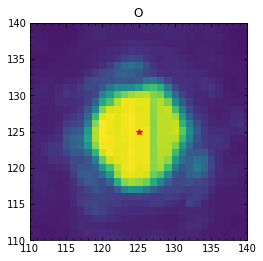

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03662.fits
bin_distcorr_lm_150104_03663.fits
7892.225736918623
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03663.fits: -0.8930145190809853, -0.7615928171500101


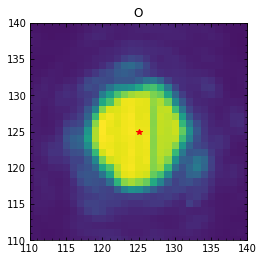

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03663.fits
bin_distcorr_lm_150104_03664.fits
7927.674781730481
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03664.fits: -0.8742326679441987, -0.7453503778798805


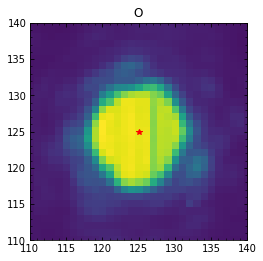

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03664.fits
bin_distcorr_lm_150104_03665.fits
7908.268937378723
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03665.fits: -0.8966499755290442, -0.7439197321728557


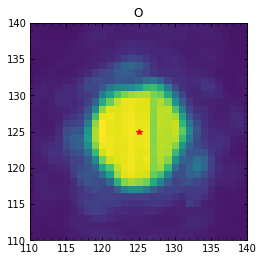

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03665.fits
bin_distcorr_lm_150104_03666.fits
7907.034645005711
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03666.fits: -0.9023181303257672, -0.7746781015671402


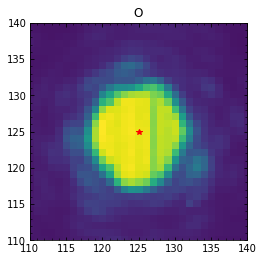

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03666.fits
bin_distcorr_lm_150104_03667.fits
7896.869417751778
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03667.fits: -0.8979281323384498, -0.7763383628670439


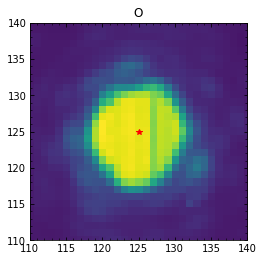

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03667.fits
bin_distcorr_lm_150104_03668.fits
7914.011284834639
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03668.fits: -0.9112251897043251, -0.7698401256575025


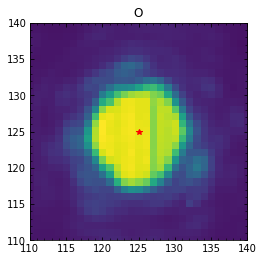

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03668.fits
bin_distcorr_lm_150104_03669.fits
7889.824660035769
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03669.fits: -0.9193000501456794, -0.7753638682811967


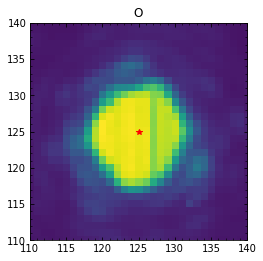

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03669.fits
bin_distcorr_lm_150104_03670.fits
7913.427568493039
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03670.fits: -0.8949696499194815, -0.7657292397112059


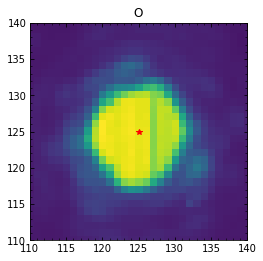

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03670.fits
bin_distcorr_lm_150104_03671.fits
7938.093280348875
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03671.fits: -0.9046369430939976, -0.7680658721308831


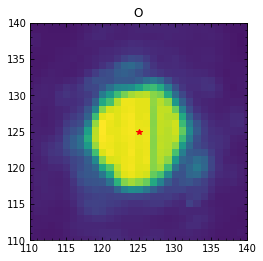

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03671.fits
bin_distcorr_lm_150104_03672.fits
7878.423410256435
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03672.fits: -0.8935804242476308, -0.7788788890733969


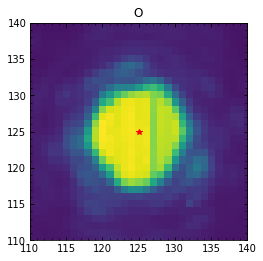

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03672.fits
bin_distcorr_lm_150104_03673.fits
7887.590154149293
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03673.fits: -0.8966637134665945, -0.7710413103288829


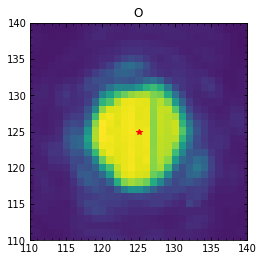

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03673.fits
bin_distcorr_lm_150104_03674.fits
7893.802214817601
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03674.fits: -0.9120183961153785, -0.7606515302960659


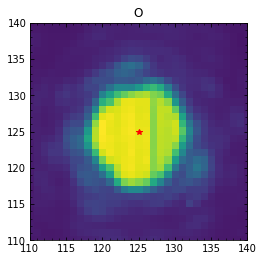

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03674.fits
bin_distcorr_lm_150104_03675.fits
7882.8764427575825
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03675.fits: -0.9403151905536049, -0.7699503224420212


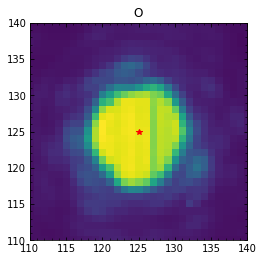

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03675.fits
bin_distcorr_lm_150104_03676.fits
7858.589400721986
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03676.fits: -0.95800037838778, -0.7961964439711835


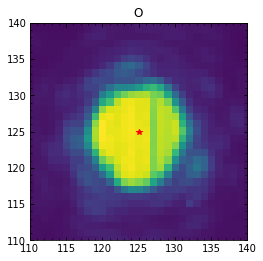

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03676.fits
bin_distcorr_lm_150104_03677.fits
7899.852332309479
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03677.fits: -0.9298973204951295, -0.8286657913950535


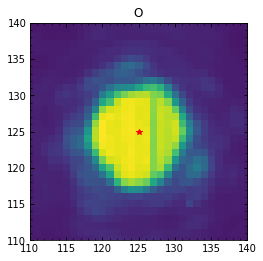

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03677.fits
bin_distcorr_lm_150104_03678.fits
7901.047337891376
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03678.fits: -0.9278149345896196, -0.8013952548101244


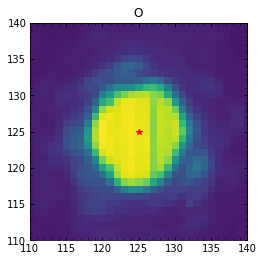

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03678.fits
bin_distcorr_lm_150104_03679.fits
7884.642386556107
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03679.fits: -0.9283579963491206, -0.824940219362233


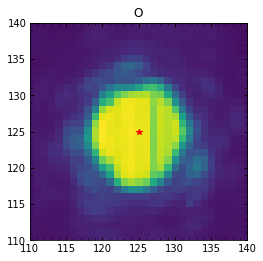

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03679.fits
bin_distcorr_lm_150104_03680.fits
7890.809440730333
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03680.fits: -0.9217043926020239, -0.82119141447847


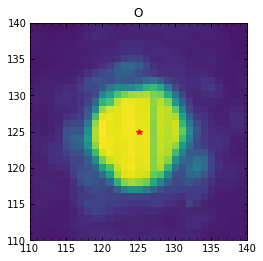

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03680.fits
bin_distcorr_lm_150104_03681.fits
7885.781377590577
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03681.fits: -0.9716809566295979, -0.8038724347616082


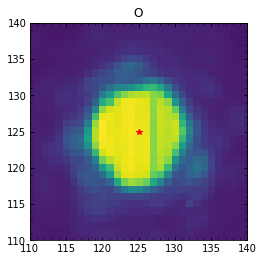

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03681.fits
bin_distcorr_lm_150104_03682.fits
7889.988683193725
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03682.fits: -0.943493967590662, -0.8110759340386196


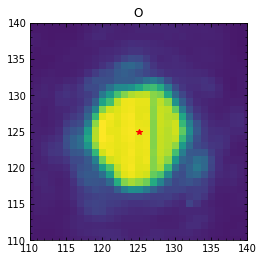

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03682.fits
bin_distcorr_lm_150104_03683.fits
7819.988667642541
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03683.fits: -0.9631244605494302, -0.7970460833847213


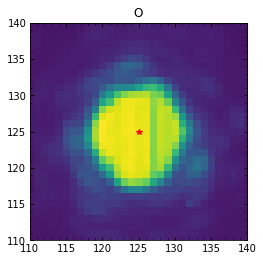

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03683.fits
bin_distcorr_lm_150104_03684.fits
7818.944486043249
STARTING  O
X: 195  Y: 325  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03684.fits: -0.06816058344730891, -0.7580028131695045


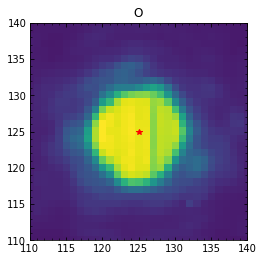

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03684.fits
bin_distcorr_lm_150104_03685.fits
7890.259599840684
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03685.fits: -0.9755925381326804, -0.696785995346417


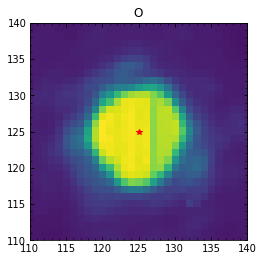

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03685.fits
bin_distcorr_lm_150104_03686.fits
7863.078094321987
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03686.fits: -0.9931301215469546, -0.7058064119413743


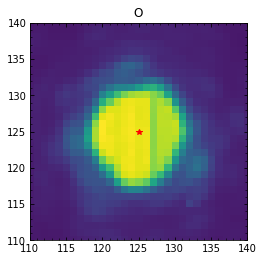

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03686.fits
bin_distcorr_lm_150104_03687.fits
7853.262331366378
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03687.fits: -0.9558817523567029, -0.8065788713070745


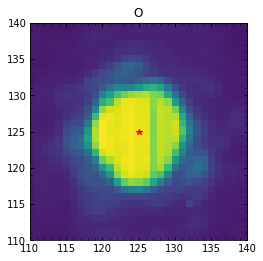

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03687.fits
bin_distcorr_lm_150104_03688.fits
7842.217877201065
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03688.fits: -0.9147569085525902, -0.7702085109154666


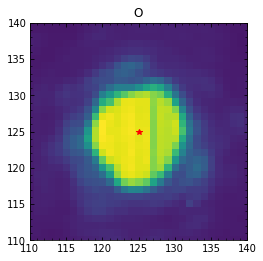

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03688.fits
bin_distcorr_lm_150104_03689.fits
7885.336600624161
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03689.fits: -0.9788881600300101, -0.7940709293691199


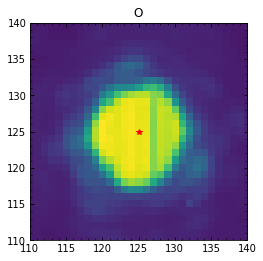

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03689.fits
bin_distcorr_lm_150104_03690.fits
7864.54068187524
STARTING  O
X: 196  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03690.fits: -0.9348014559478344, 0.15100792045979006


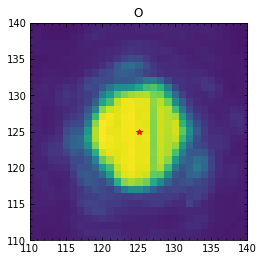

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03690.fits
bin_distcorr_lm_150104_03691.fits
7895.233196301101
STARTING  O
X: 196  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03691.fits: -0.9339944569543732, 0.1362277902364042


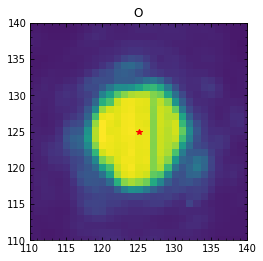

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03691.fits
bin_distcorr_lm_150104_03692.fits
7880.5828509803
STARTING  O
X: 196  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03692.fits: -0.9213547797351183, 0.14189990963171795


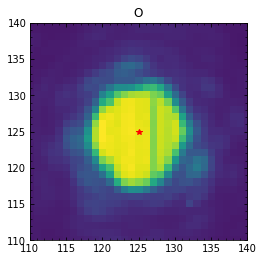

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03692.fits
bin_distcorr_lm_150104_03693.fits
7848.97879348598
STARTING  O
X: 196  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03693.fits: -0.9547121854291802, 0.12437847304368432


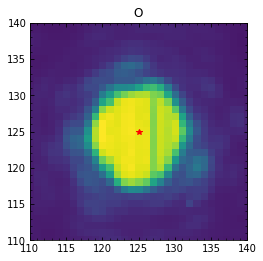

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03693.fits
bin_distcorr_lm_150104_03694.fits
7853.368527395918
STARTING  O
X: 196  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03694.fits: -0.9542485506118226, 0.14112313930371556


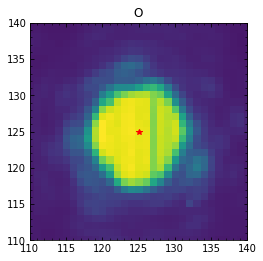

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03694.fits
bin_distcorr_lm_150104_03695.fits
7892.165894819302
STARTING  O
X: 196  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03695.fits: -0.9730296923092538, 0.12050604068870996


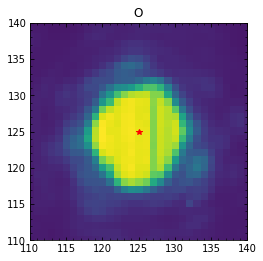

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03695.fits
bin_distcorr_lm_150104_03696.fits
7795.208928203149
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03696.fits: -1.0256386120448084, -0.8297475295372223


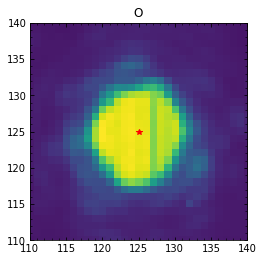

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03696.fits
bin_distcorr_lm_150104_03697.fits
7862.255347776407
STARTING  O
X: 196  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03697.fits: -0.9830737623367156, 0.130268364769762


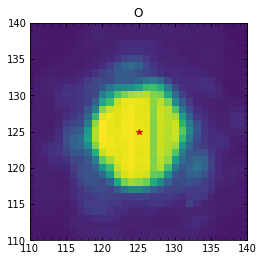

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03697.fits
bin_distcorr_lm_150104_03698.fits
7858.031353623912
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03698.fits: -0.9914684187295961, -0.8295709711579775


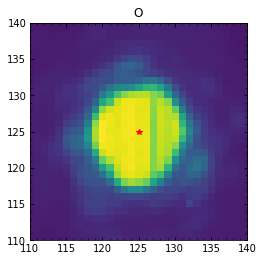

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03698.fits
bin_distcorr_lm_150104_03699.fits
7876.718392683071
STARTING  O
X: 196  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03699.fits: -0.9684670707009388, 0.1342235610932505


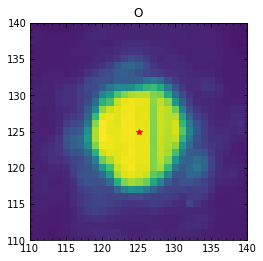

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03699.fits
bin_distcorr_lm_150104_03700.fits
7789.642811826286
STARTING  O
X: 196  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03700.fits: -0.9817118974747814, 0.14877193094212515


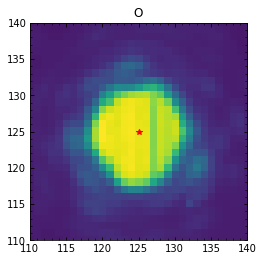

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03700.fits
bin_distcorr_lm_150104_03701.fits
7835.831873468897
STARTING  O
X: 195  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03701.fits: -0.9709932708343487, -0.8375196472725079


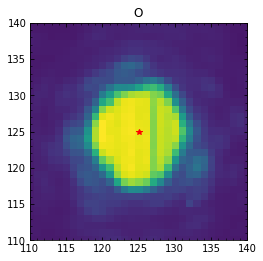

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03701.fits
bin_distcorr_lm_150104_03702.fits
7878.134160651729
STARTING  O
X: 196  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03702.fits: -0.9701837471851462, 0.12794461072241603


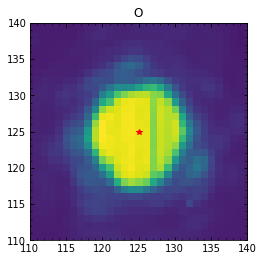

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03702.fits
bin_distcorr_lm_150104_03703.fits
7879.229173206266
STARTING  O
X: 196  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03703.fits: -0.9506610722258699, 0.11070556681789157


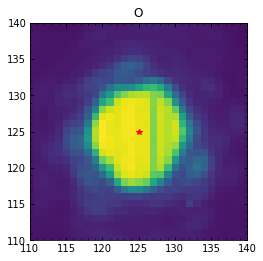

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03703.fits
bin_distcorr_lm_150104_03704.fits
7790.5421943040965
STARTING  O
X: 196  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03704.fits: -1.0076536180477547, 0.14661127196956159


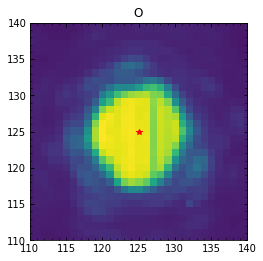

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03704.fits
bin_distcorr_lm_150104_03705.fits
7827.774606655714
STARTING  O
X: 196  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03705.fits: -0.9265122955854395, 0.12537446992136125


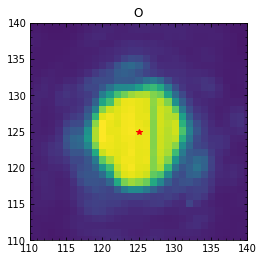

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03705.fits
bin_distcorr_lm_150104_03706.fits
7880.558075166946
STARTING  O
X: 196  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03706.fits: -0.9471835454799375, 0.126397566296248


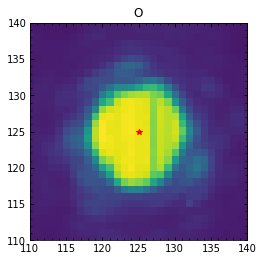

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03706.fits
bin_distcorr_lm_150104_03707.fits
7848.022536806836
STARTING  O
X: 196  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03707.fits: -0.8978155967114034, 0.10019378618565611


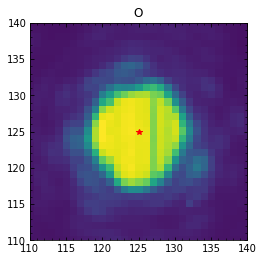

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03707.fits
bin_distcorr_lm_150104_03708.fits
7840.186114789784
STARTING  O
X: 196  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03708.fits: -0.9517686243723773, 0.08726825706342822


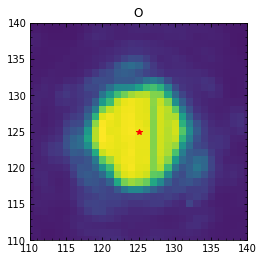

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03708.fits
bin_distcorr_lm_150104_03709.fits
7858.2747238490765
STARTING  O
X: 196  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03709.fits: -0.9600653723272998, 0.07155410986141675


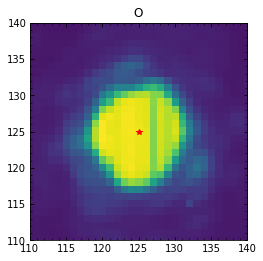

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03709.fits
bin_distcorr_lm_150104_03710.fits
7847.120174324384
STARTING  O
X: 196  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03710.fits: -0.9705982152440313, 0.07893372945049748


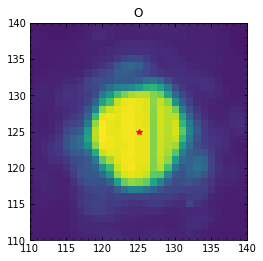

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03710.fits
bin_distcorr_lm_150104_03711.fits
7864.015325044114
STARTING  O
X: 196  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03711.fits: -0.9133992830675055, 0.048941420230526944


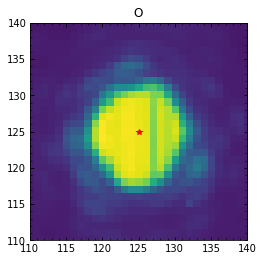

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03711.fits
bin_distcorr_lm_150104_03712.fits
7858.395811643111
STARTING  O
X: 196  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03712.fits: -0.9892988709677724, 0.1055499732150551


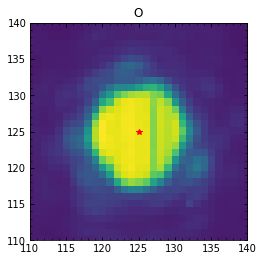

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03712.fits
bin_distcorr_lm_150104_03713.fits
7878.0622146795395
STARTING  O
X: 196  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03713.fits: -0.976772801620605, 0.10934799820523011


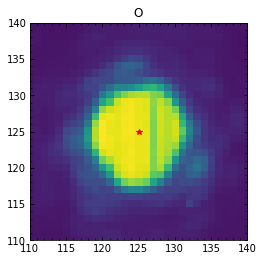

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03713.fits
bin_distcorr_lm_150104_03714.fits
7856.400275237379
STARTING  O
X: 196  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03714.fits: -0.9240850731249282, 0.10452849736063285


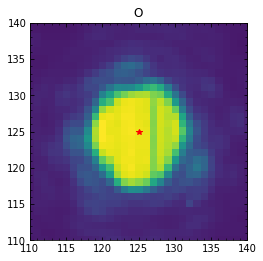

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03714.fits
bin_distcorr_lm_150104_03715.fits
7879.12458985087
STARTING  O
X: 196  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03715.fits: -0.9662819259188353, 0.06970648648100308


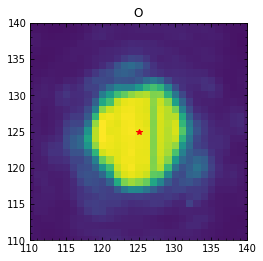

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03715.fits
bin_distcorr_lm_150104_03716.fits
7890.945486498357
STARTING  O
X: 196  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03716.fits: -0.9415716877575662, 0.04377789354393258


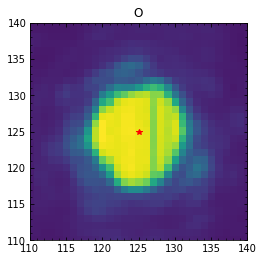

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03716.fits
bin_distcorr_lm_150104_03717.fits
7866.107545636783
STARTING  O
X: 196  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03717.fits: -0.9266078546649723, 0.0798689121786964


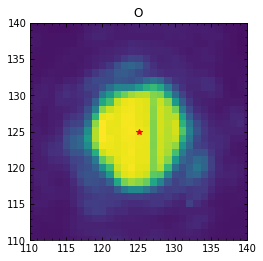

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03717.fits
bin_distcorr_lm_150104_03718.fits
7884.2670410700475
STARTING  O
X: 196  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03718.fits: -0.9805553104277962, 0.09026483283318498


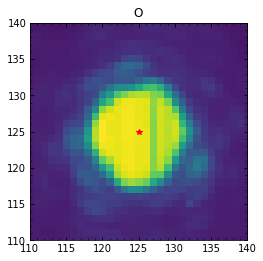

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03718.fits
bin_distcorr_lm_150104_03719.fits
7896.856877835224
STARTING  O
X: 196  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03719.fits: -0.9636932034751382, 0.05127463456109638


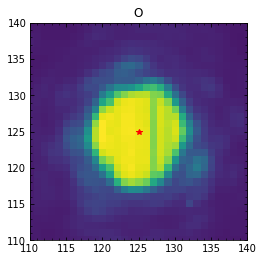

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03719.fits
bin_distcorr_lm_150104_03720.fits
7891.063028296801
STARTING  O
X: 196  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03720.fits: -0.9816434471432842, 0.06574213598613454


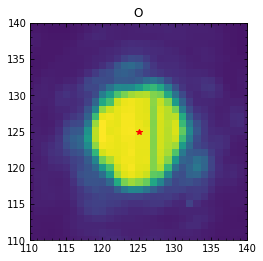

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03720.fits
bin_distcorr_lm_150104_03721.fits
7854.245136398142
STARTING  O
X: 196  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03721.fits: -0.9901355574227111, 0.03714546774013172


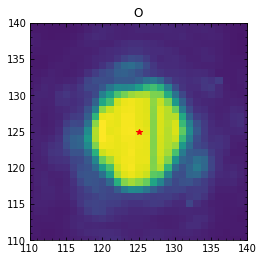

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03721.fits
bin_distcorr_lm_150104_03722.fits
7855.236769813273
STARTING  O
X: 196  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03722.fits: -0.9764787778116641, 0.03471270649261271


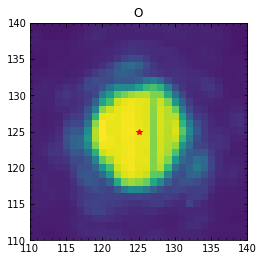

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03722.fits
bin_distcorr_lm_150104_03723.fits
7917.1352949952025
STARTING  O
X: 196  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03723.fits: -0.9107143492656391, 0.030730321254601733


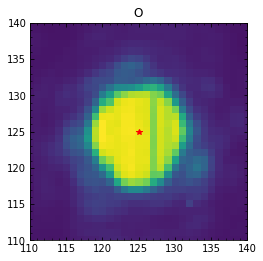

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03723.fits
bin_distcorr_lm_150104_03724.fits
7704.728439796028
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03724.fits: -0.7866062432384169, -0.17595932295240146


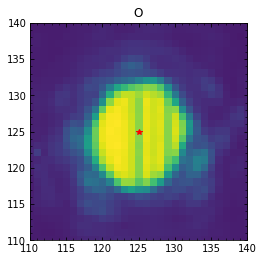

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03724.fits
bin_distcorr_lm_150104_03725.fits
7724.617255042724
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03725.fits: -0.7921401510820374, -0.17098324416041066


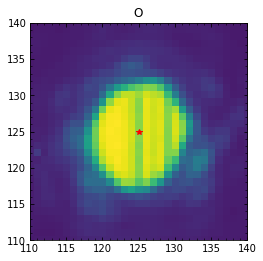

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03725.fits
bin_distcorr_lm_150104_03726.fits
7742.398516092001
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03726.fits: -0.7895506379512298, -0.1647694308053076


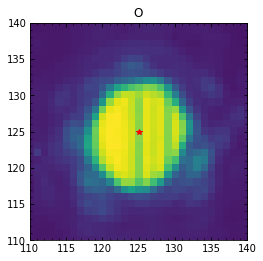

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03726.fits
bin_distcorr_lm_150104_03727.fits
7720.479245757793
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03727.fits: -0.7672189883147098, -0.1727338279237145


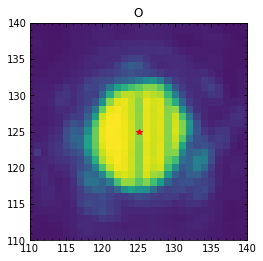

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03727.fits
bin_distcorr_lm_150104_03728.fits
7759.9559933502815
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03728.fits: -0.737914917831425, -0.20512041935086245


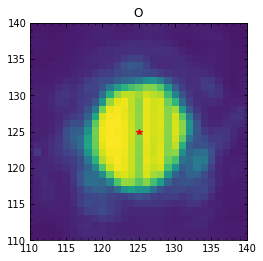

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03728.fits
bin_distcorr_lm_150104_03729.fits
7753.460324646412
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03729.fits: -0.7514573027749947, -0.18260362201825586


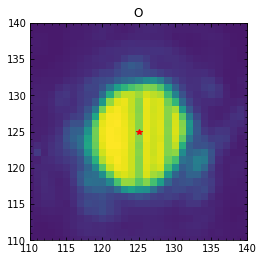

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03729.fits
bin_distcorr_lm_150104_03730.fits
7756.453818225199
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03730.fits: -0.7404775589021071, -0.18805610684882623


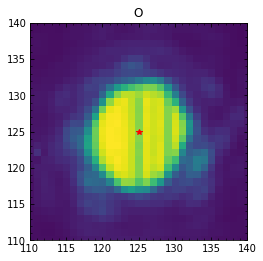

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03730.fits
bin_distcorr_lm_150104_03731.fits
7726.7267601438825
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03731.fits: -0.7435923088929499, -0.17552302430946298


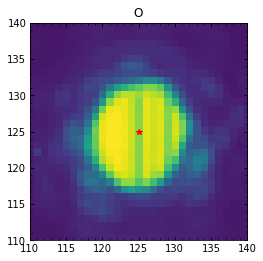

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03731.fits
bin_distcorr_lm_150104_03732.fits
7750.4399893945265
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03732.fits: -0.7650703779543591, -0.17065696809397224


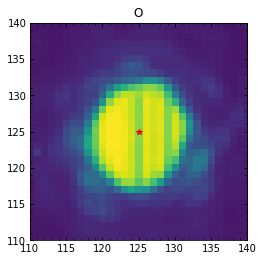

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03732.fits
bin_distcorr_lm_150104_03733.fits
7735.471883776552
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03733.fits: -0.7539178988556614, -0.17355842586248116


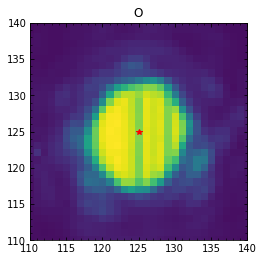

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03733.fits
bin_distcorr_lm_150104_03734.fits
7711.829438931694
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03734.fits: -0.7702349643817925, -0.19762363661340032


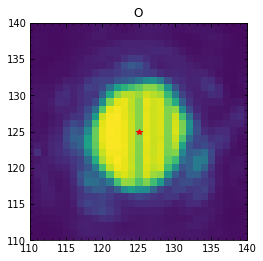

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03734.fits
bin_distcorr_lm_150104_03735.fits
7742.260310882204
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03735.fits: -0.7551661205879938, -0.18794916016369712


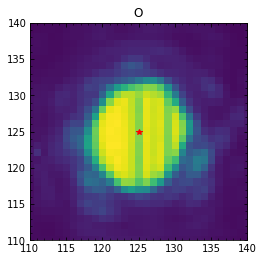

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03735.fits
bin_distcorr_lm_150104_03736.fits
7742.3141869910405
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03736.fits: -0.7628775770849288, -0.20477677937248728


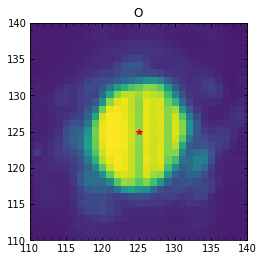

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03736.fits
bin_distcorr_lm_150104_03737.fits
7725.675993411724
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03737.fits: -0.7904315895939575, -0.20177830370379723


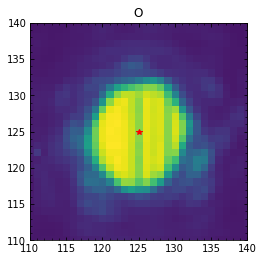

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03737.fits
bin_distcorr_lm_150104_03738.fits
7644.490699023628
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03738.fits: -0.7835256898029925, -0.20646545125892857


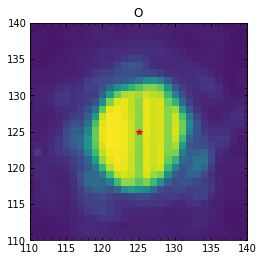

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03738.fits
bin_distcorr_lm_150104_03739.fits
7666.178430873406
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03739.fits: -0.772465365535318, -0.26085466134748003


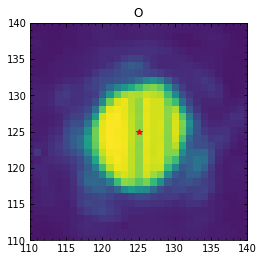

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03739.fits
bin_distcorr_lm_150104_03740.fits
7697.747210087269
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03740.fits: -0.7421662715229189, -0.26170067660663676


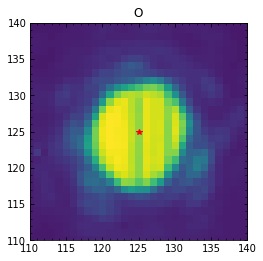

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03740.fits
bin_distcorr_lm_150104_03741.fits
7695.0130363821445
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03741.fits: -0.8196730205648279, -0.25901022135612095


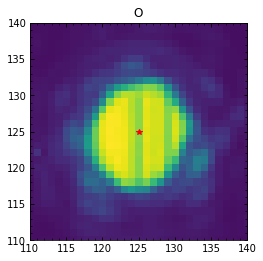

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03741.fits
bin_distcorr_lm_150104_03742.fits
7691.830055107638
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03742.fits: -0.7982441494198724, -0.23729258683854937


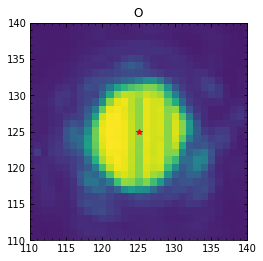

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03742.fits
bin_distcorr_lm_150104_03743.fits
7732.086472454939
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03743.fits: -0.8081979777403632, -0.23309262970366973


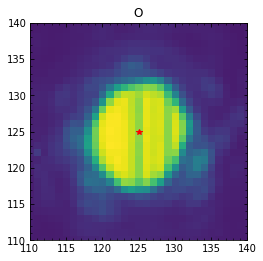

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03743.fits
bin_distcorr_lm_150104_03744.fits
7718.705275381461
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03744.fits: -0.8142807991506302, -0.2422645763487452


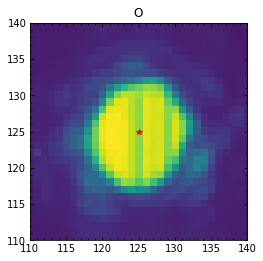

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03744.fits
bin_distcorr_lm_150104_03745.fits
7728.2966932352365
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03745.fits: -0.8182789887572284, -0.24351021348598323


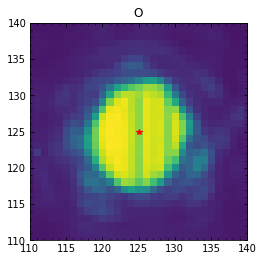

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03745.fits
bin_distcorr_lm_150104_03746.fits
7731.91654916514
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03746.fits: -0.8069862776428565, -0.2283843781227759


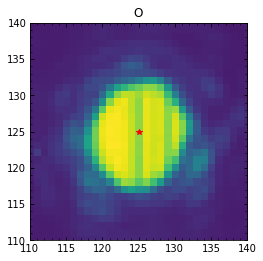

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03746.fits
bin_distcorr_lm_150104_03747.fits
7760.975316519928
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03747.fits: -0.8046084019730344, -0.22461342205777157


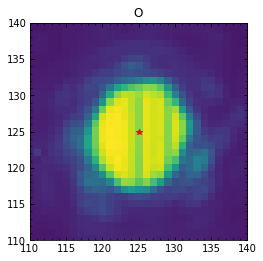

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03747.fits
bin_distcorr_lm_150104_03748.fits
7734.939008455381
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03748.fits: -0.8327439847392029, -0.21276714707613564


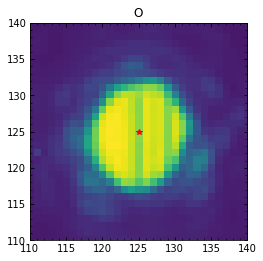

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03748.fits
bin_distcorr_lm_150104_03749.fits
7740.670198453028
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03749.fits: -0.8003132693035155, -0.2528104198484513


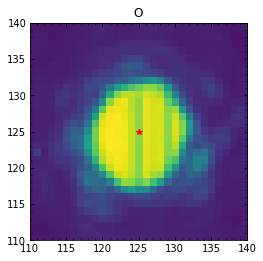

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03749.fits
bin_distcorr_lm_150104_03750.fits
7757.580791531163
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03750.fits: -0.8101010950545913, -0.24673268862445497


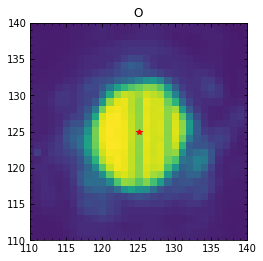

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03750.fits
bin_distcorr_lm_150104_03751.fits
7744.473131853216
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03751.fits: -0.8057122445968403, -0.24286695540625658


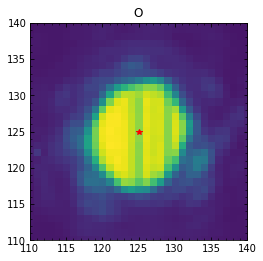

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03751.fits
bin_distcorr_lm_150104_03752.fits
7756.097451923732
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03752.fits: -0.8291042253648655, -0.24743874298778223


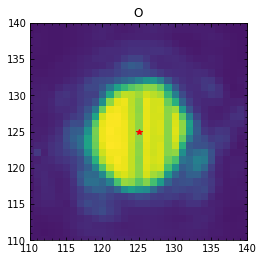

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03752.fits
bin_distcorr_lm_150104_03753.fits
7733.439259416255
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03753.fits: -0.875247360803094, -0.26488871886846255


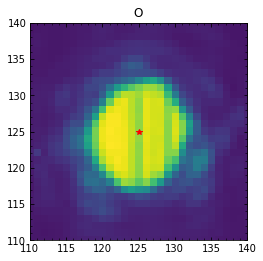

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03753.fits
bin_distcorr_lm_150104_03754.fits
7742.368978182005
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03754.fits: -0.8248789931013505, -0.2857600720102198


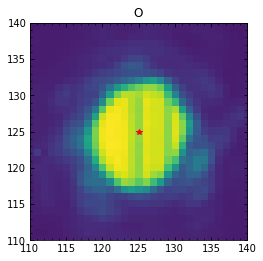

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03754.fits
bin_distcorr_lm_150104_03755.fits
7714.421290704649
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03755.fits: -0.8293735352330529, -0.24333432016535994


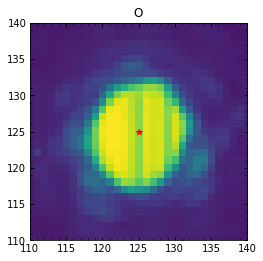

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03755.fits
bin_distcorr_lm_150104_03756.fits
7693.648021867628
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03756.fits: -0.8295064332386772, -0.27852472321510646


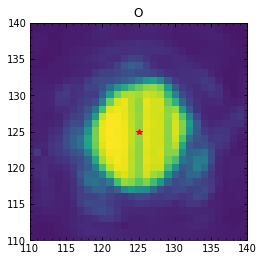

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03756.fits
bin_distcorr_lm_150104_03757.fits
7729.061217578294
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03757.fits: -0.8071451940650931, -0.29540491846430683


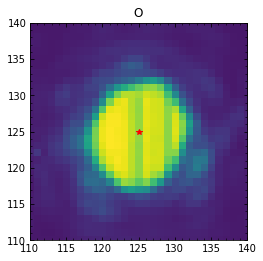

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03757.fits
bin_distcorr_lm_150104_03758.fits
7722.880104119279
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03758.fits: -0.7990216197039857, -0.3027575941786935


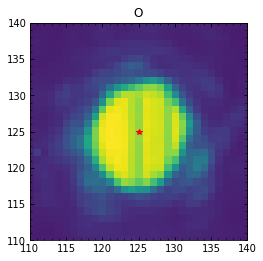

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03758.fits
bin_distcorr_lm_150104_03759.fits
7707.774259177993
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03759.fits: -0.806104117669264, -0.2815756636298161


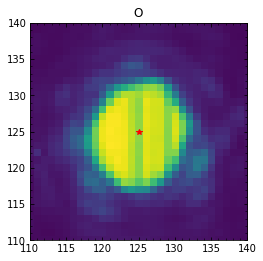

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03759.fits
bin_distcorr_lm_150104_03760.fits
7702.550816338686
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03760.fits: -0.8195049609174418, -0.2878026521563015


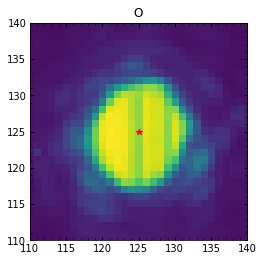

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03760.fits
bin_distcorr_lm_150104_03761.fits
7705.135233675178
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03761.fits: -0.826413628963536, -0.29732378071951615


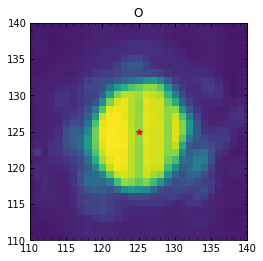

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03761.fits
bin_distcorr_lm_150104_03762.fits
7715.248207994389
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03762.fits: -0.7944416630845694, -0.2944902110486254


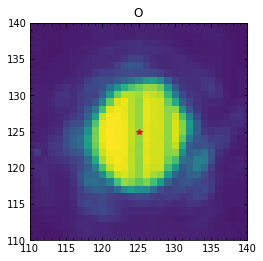

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03762.fits
bin_distcorr_lm_150104_03763.fits
7696.531921789571
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03763.fits: -0.8047059578248081, -0.2993141176355891


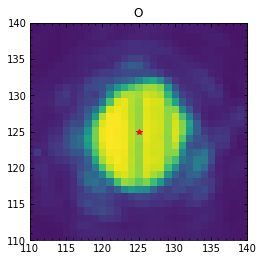

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03763.fits
bin_distcorr_lm_150104_03764.fits
7717.238251332128
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03764.fits: -0.8242959034233337, -0.3072447069739752


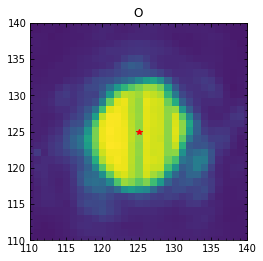

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03764.fits
bin_distcorr_lm_150104_03765.fits
7694.276228049107
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03765.fits: -0.8005705069234921, -0.32058603233159033


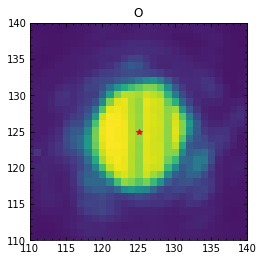

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03765.fits
bin_distcorr_lm_150104_03766.fits
7711.589667501069
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03766.fits: -0.7777566585686841, -0.3373813456760004


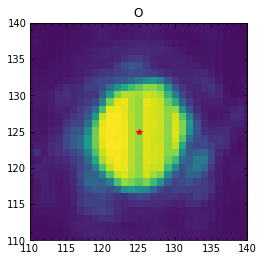

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03766.fits
bin_distcorr_lm_150104_03767.fits
7714.332374712933
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03767.fits: -0.8184144473536961, -0.3533116801603242


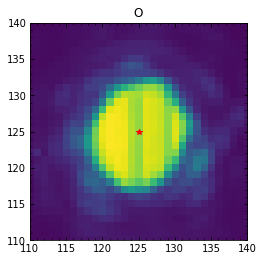

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03767.fits
bin_distcorr_lm_150104_03768.fits
7696.884814893111
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03768.fits: -0.827892636182554, -0.321737924990785


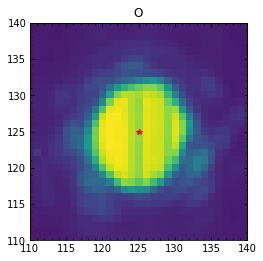

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03768.fits
bin_distcorr_lm_150104_03769.fits
7688.356558942865
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03769.fits: -0.8087266631886791, -0.33158262650367476


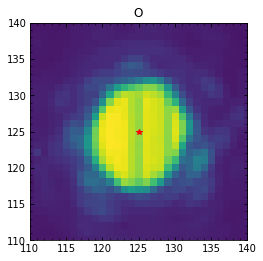

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03769.fits
bin_distcorr_lm_150104_03770.fits
7663.736825698618
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03770.fits: -0.8258608809812458, -0.3187076705535361


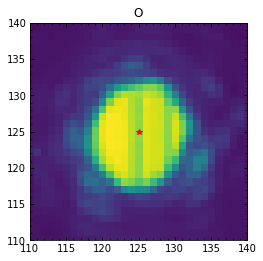

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03770.fits
bin_distcorr_lm_150104_03771.fits
7692.257551157402
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03771.fits: -0.7891253442782471, -0.3399093888949025


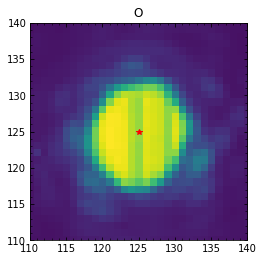

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03771.fits
bin_distcorr_lm_150104_03772.fits
7697.340414889565
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03772.fits: -0.8685512319569142, -0.5792429344494678


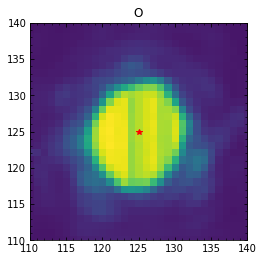

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03772.fits
bin_distcorr_lm_150104_03773.fits
7636.1011097812625
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03773.fits: -0.8600802406372026, -0.5886865392975693


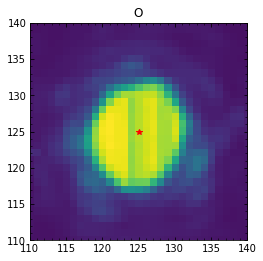

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03773.fits
bin_distcorr_lm_150104_03774.fits
7613.606138357883
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03774.fits: -0.7719549775888908, -0.3667293242186034


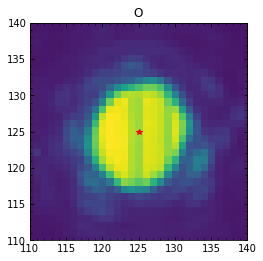

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03774.fits
bin_distcorr_lm_150104_03775.fits
7692.373366175493
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03775.fits: -0.8257383272557419, -0.3725845306894868


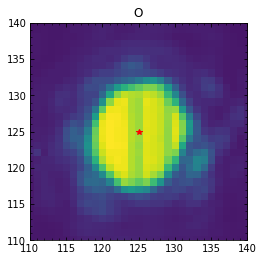

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03775.fits
bin_distcorr_lm_150104_03776.fits
7684.255777291735
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03776.fits: -0.8463007515626941, -0.3671052107649615


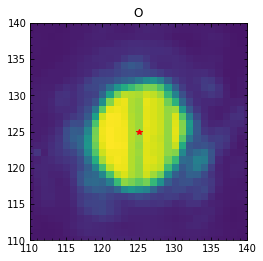

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03776.fits
bin_distcorr_lm_150104_03777.fits
7646.651781484636
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03777.fits: -0.8032773176680905, -0.3640503457283515


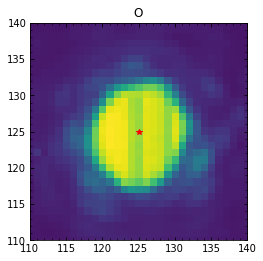

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03777.fits
bin_distcorr_lm_150104_03778.fits
7658.84519341038
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03778.fits: -0.8967464853031331, -0.6237512744120863


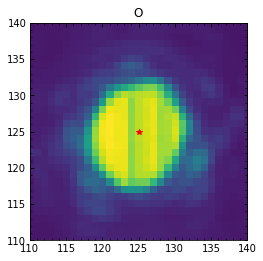

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03778.fits
bin_distcorr_lm_150104_03779.fits
7701.0784772174575
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03779.fits: -0.8779627326566413, -0.6280305647142868


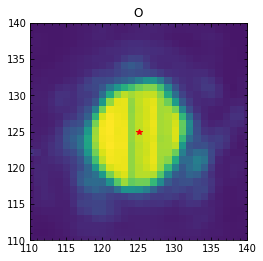

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03779.fits
bin_distcorr_lm_150104_03780.fits
7701.906605493389
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03780.fits: -0.9171481688789456, -0.6079659961384465


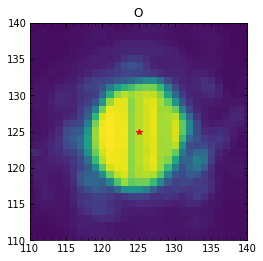

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03780.fits
bin_distcorr_lm_150104_03781.fits
7657.979020822247
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03781.fits: -0.874951936341624, -0.36785146646253253


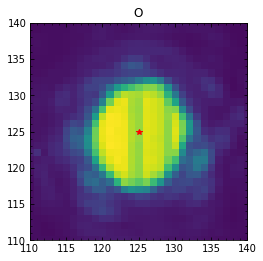

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03781.fits
bin_distcorr_lm_150104_03782.fits
7707.623702491524
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03782.fits: -0.911980449478186, -0.6205569892028322


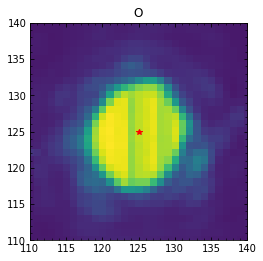

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03782.fits
bin_distcorr_lm_150104_03783.fits
7687.892039310814
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03783.fits: -0.8413495135533324, -0.35637352711442816


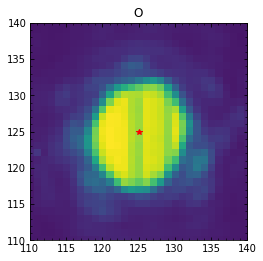

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03783.fits
bin_distcorr_lm_150104_03784.fits
7673.839239531231
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03784.fits: -0.8335629900931139, -0.3687430579715141


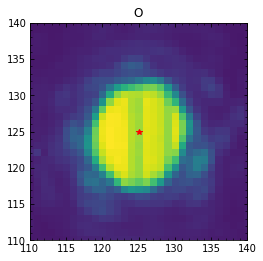

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03784.fits
bin_distcorr_lm_150104_03785.fits
7693.070673488031
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03785.fits: -0.87721550222507, -0.6099775270762606


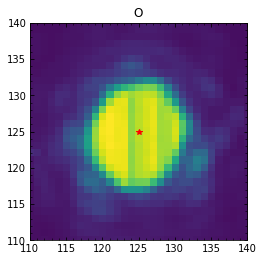

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03785.fits
bin_distcorr_lm_150104_03786.fits
7713.988514735654
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03786.fits: -0.8903936300521806, -0.614302127643441


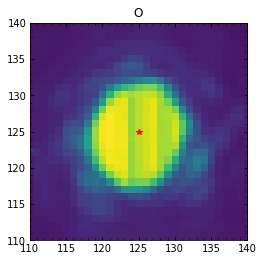

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03786.fits
bin_distcorr_lm_150104_03787.fits
7692.296649675337
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03787.fits: -0.8878707375593962, -0.6006544148657369


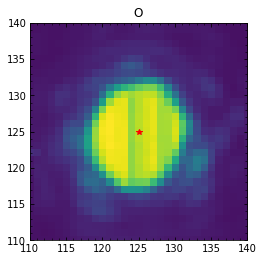

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03787.fits
bin_distcorr_lm_150104_03788.fits
7685.695541802781
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03788.fits: -0.9504626065956145, -0.6181476401188704


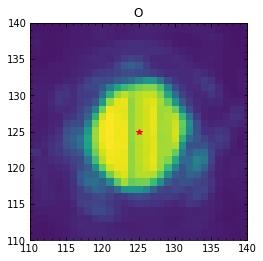

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03788.fits
bin_distcorr_lm_150104_03789.fits
7715.02780588423
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03789.fits: -0.8957020972558212, -0.6145843131169286


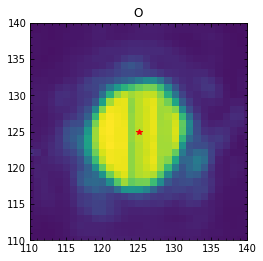

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03789.fits
bin_distcorr_lm_150104_03790.fits
7687.045296269913
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03790.fits: -0.8736937770919511, -0.37518704522181423


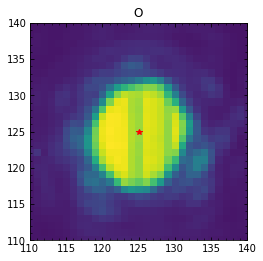

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03790.fits
bin_distcorr_lm_150104_03791.fits
7676.615680177384
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03791.fits: -0.9166421299241208, -0.3455176541411049


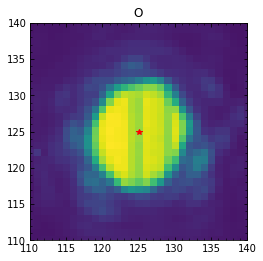

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03791.fits
bin_distcorr_lm_150104_03792.fits
7661.477847759822
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03792.fits: -0.888939380313289, -0.3215462119692063


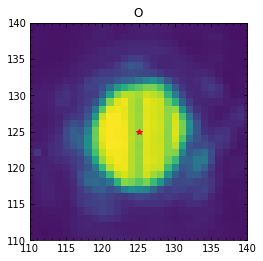

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03792.fits
bin_distcorr_lm_150104_03793.fits
7661.624579718024
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03793.fits: -0.9207338499519935, -0.3299550651895018


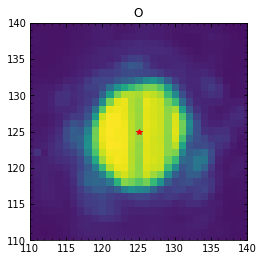

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03793.fits
bin_distcorr_lm_150104_03794.fits
7651.729379547556
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03794.fits: -0.865145650030918, -0.36876752268953084


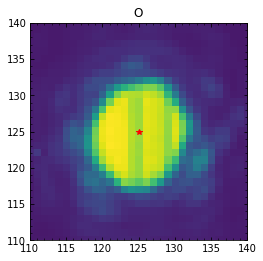

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03794.fits
bin_distcorr_lm_150104_03795.fits
7671.0289999790075
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03795.fits: -0.9375042654423993, -0.6261503592748383


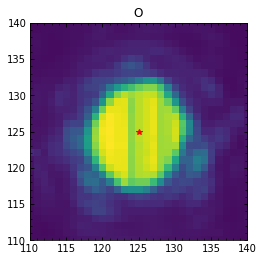

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03795.fits
bin_distcorr_lm_150104_03796.fits
7691.630525581032
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03796.fits: -0.9111761227117157, -0.6360594855028694


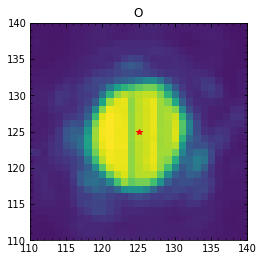

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03796.fits
bin_distcorr_lm_150104_03797.fits
7710.217220234952
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03797.fits: -0.9455603679927336, -0.6040573385945649


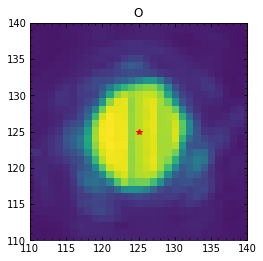

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03797.fits
bin_distcorr_lm_150104_03798.fits
7681.521898676912
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03798.fits: -0.9300976485260506, -0.5979484901491574


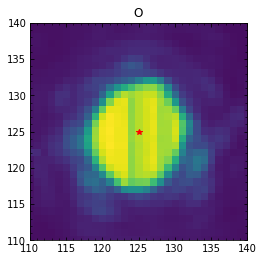

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03798.fits
bin_distcorr_lm_150104_03799.fits
7697.845909179638
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03799.fits: -0.9042400955310583, -0.6395419684458119


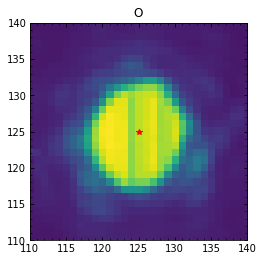

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03799.fits
bin_distcorr_lm_150104_03800.fits
7692.821308933336
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03800.fits: -0.9240317828580942, -0.6189836998294282


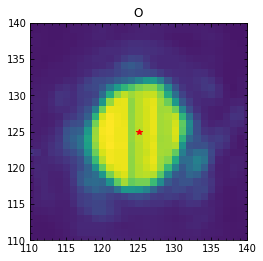

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03800.fits
bin_distcorr_lm_150104_03801.fits
7687.491217447047
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03801.fits: -0.9478719298591827, -0.6424875953990679


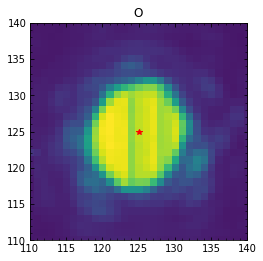

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03801.fits
bin_distcorr_lm_150104_03802.fits
7680.270246608525
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03802.fits: -0.9246649443016963, -0.668532019359084


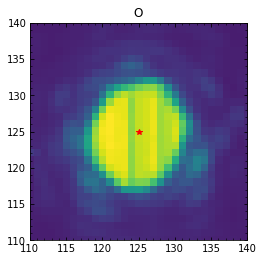

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03802.fits
bin_distcorr_lm_150104_03803.fits
7664.759924711248
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03803.fits: -0.9487925147195355, -0.6573002816890394


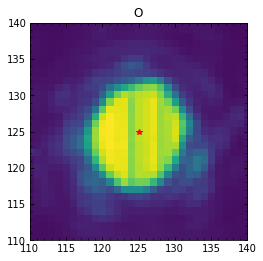

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03803.fits
bin_distcorr_lm_150104_03804.fits
7686.603085532321
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03804.fits: -0.9619079097346699, -0.6403986537165025


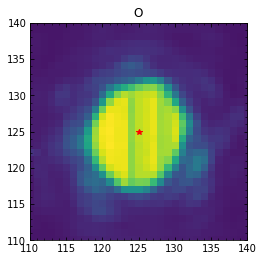

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03804.fits
bin_distcorr_lm_150104_03805.fits
7647.803413321695
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03805.fits: -0.9190079490407541, -0.6707086788158634


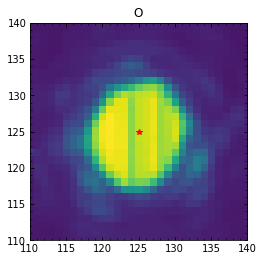

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03805.fits
bin_distcorr_lm_150104_03806.fits
7661.0065078135185
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03806.fits: -0.918101764401186, -0.6419483440320235


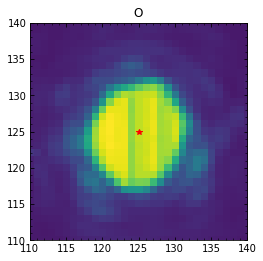

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03806.fits
bin_distcorr_lm_150104_03807.fits
7681.446461751027
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03807.fits: -0.9061635356752546, -0.6442312773832626


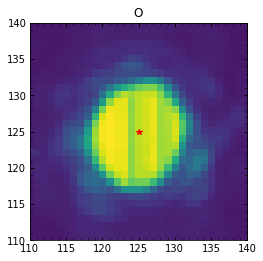

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03807.fits
bin_distcorr_lm_150104_03808.fits
7702.53984005085
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03808.fits: -0.9348964124744796, -0.6643929405585638


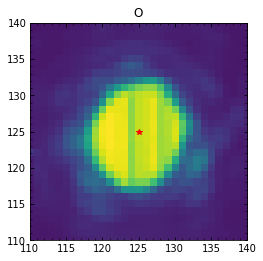

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03808.fits
bin_distcorr_lm_150104_03809.fits
7654.058398493187
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03809.fits: -0.9485768220832753, -0.6545186438754129


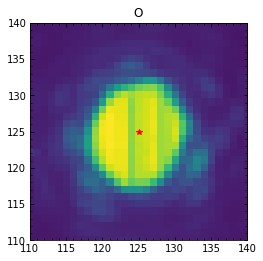

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03809.fits
bin_distcorr_lm_150104_03810.fits
7677.761982357448
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03810.fits: -0.9431980288947202, -0.6753885223913798


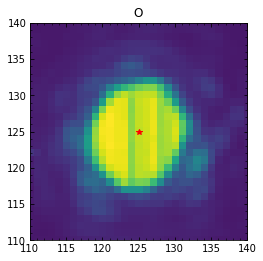

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03810.fits
bin_distcorr_lm_150104_03811.fits
7695.974421584833
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03811.fits: -0.9659807404692273, -0.676443052058211


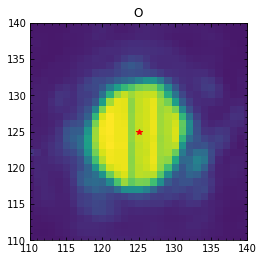

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03811.fits
bin_distcorr_lm_150104_03812.fits
7689.493135712943
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03812.fits: -0.947650497447647, -0.6877629189649355


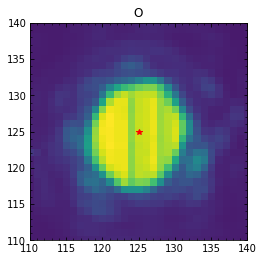

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03812.fits
bin_distcorr_lm_150104_03813.fits
7663.0256063276265
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03813.fits: -0.9675466687670635, -0.7141195285171094


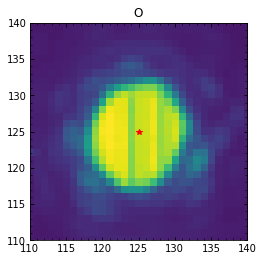

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03813.fits
bin_distcorr_lm_150104_03814.fits
7717.4806865385235
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03814.fits: -0.9560063313692595, -0.7247491539187294


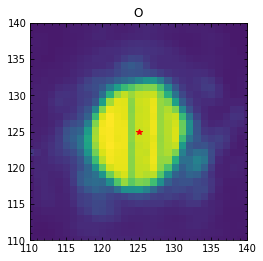

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03814.fits
bin_distcorr_lm_150104_03815.fits
7715.96240744169
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03815.fits: -0.9984639326348415, -0.7043521246385893


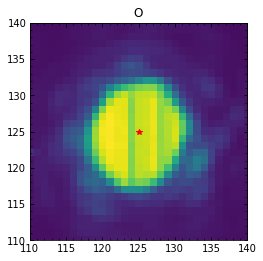

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03815.fits
bin_distcorr_lm_150104_03816.fits
7674.627478123784
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03816.fits: -0.9775199209300425, -0.6853506060860255


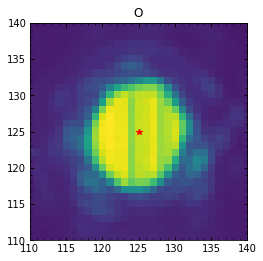

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03816.fits
bin_distcorr_lm_150104_03817.fits
7709.340460837808
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03817.fits: -0.9909065069100151, -0.6584700440443143


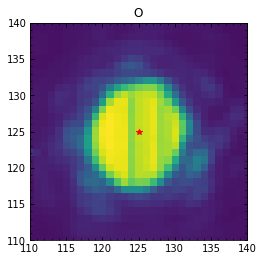

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03817.fits
bin_distcorr_lm_150104_03818.fits
7701.514635807376
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03818.fits: -0.9663593859494171, -0.6619044450097462


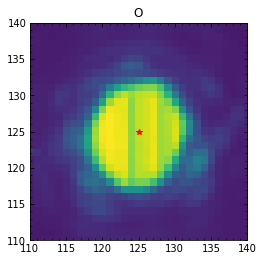

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03818.fits
bin_distcorr_lm_150104_03819.fits
7690.162588678645
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03819.fits: -0.9709877484468947, -0.6659754150681678


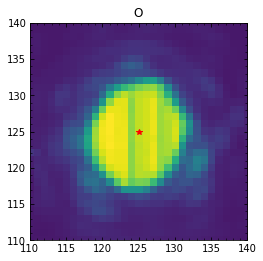

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03819.fits
bin_distcorr_lm_150104_03820.fits
7696.5401141211505
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03820.fits: -0.991745681566492, -0.6492567777295619


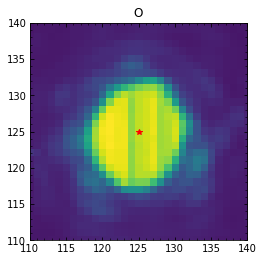

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03820.fits
bin_distcorr_lm_150104_03821.fits
7699.085497450709
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03821.fits: -0.9601809879606478, -0.6821760865583499


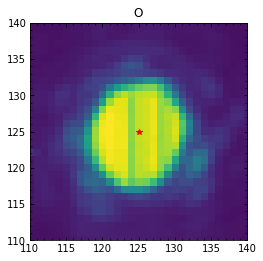

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03821.fits
bin_distcorr_lm_150104_03822.fits
7715.697208950047
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03822.fits: -0.9443789570290022, -0.6795649418332914


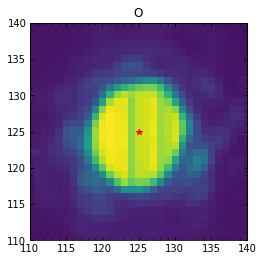

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03822.fits
bin_distcorr_lm_150104_03823.fits
7715.43037476979
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03823.fits: -0.9569594071730094, -0.709717004250848


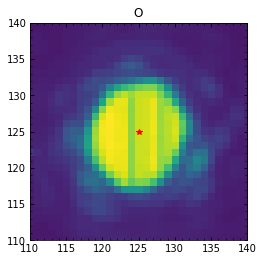

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03823.fits
bin_distcorr_lm_150104_03824.fits
7696.433520698169
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03824.fits: -0.9867757534449737, -0.6876919077327202


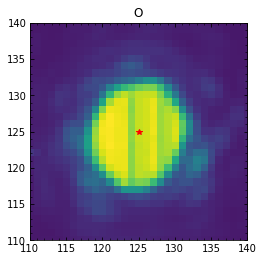

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03824.fits
bin_distcorr_lm_150104_03825.fits
7704.189356732156
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03825.fits: -0.9682046309799546, -0.6954751376179686


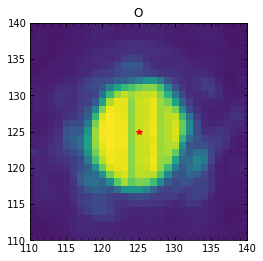

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03825.fits
bin_distcorr_lm_150104_03826.fits
7662.140060681711
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03826.fits: -0.985890585777156, -0.6900589139557951


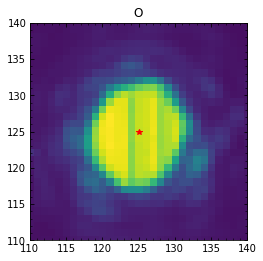

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03826.fits
bin_distcorr_lm_150104_03827.fits
7632.542815718089
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03827.fits: -1.0055108420250605, -0.6827473138271927


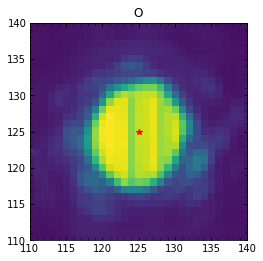

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03827.fits
bin_distcorr_lm_150104_03828.fits
7628.103304557227
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03828.fits: -0.9991820027406817, -0.6825445630509392


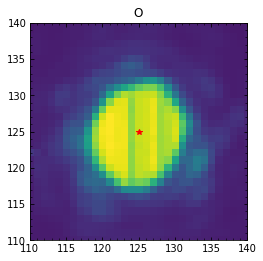

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03828.fits
bin_distcorr_lm_150104_03829.fits
7646.68562272593
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03829.fits: -0.9995658275257213, -0.6786658241960737


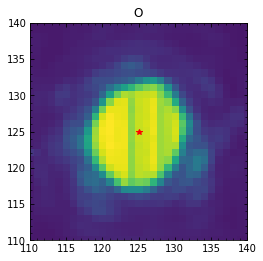

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03829.fits
bin_distcorr_lm_150104_03830.fits
7672.65267371926
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03830.fits: -0.9734892002078297, -0.7399506341246962


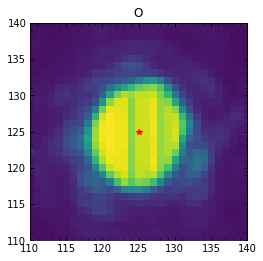

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03830.fits
bin_distcorr_lm_150104_03831.fits
7662.736068784089
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03831.fits: -1.0051514884197772, -0.6932508087544278


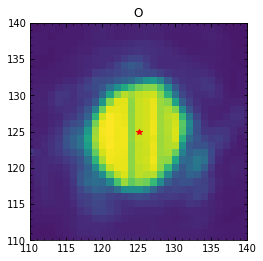

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03831.fits
bin_distcorr_lm_150104_03832.fits
7624.23022795792
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03832.fits: -1.0210417234618205, -0.7359745917640765


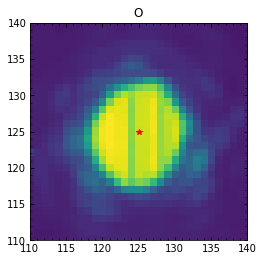

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03832.fits
bin_distcorr_lm_150104_03833.fits
7638.249184978235
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03833.fits: -0.9770682230770404, -0.7291987350919129


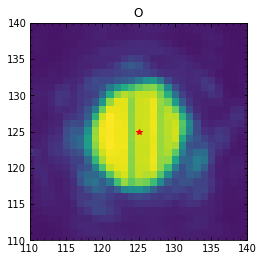

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03833.fits
bin_distcorr_lm_150104_03834.fits
7625.649132853716
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03834.fits: -0.9725468408796942, -0.7360433919400009


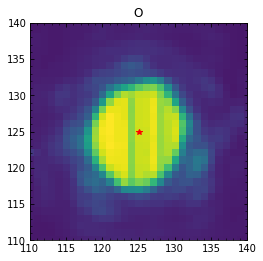

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03834.fits
bin_distcorr_lm_150104_03835.fits
7680.124329207076
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03835.fits: -0.9760219853143752, -0.7202045669043002


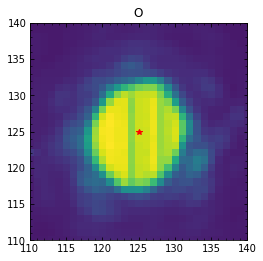

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03835.fits
bin_distcorr_lm_150104_03836.fits
7642.617125232082
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03836.fits: -0.9733544405056449, -0.7160241142993158


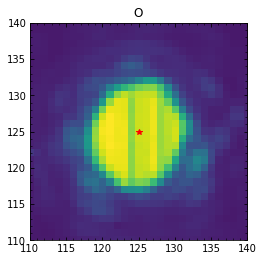

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03836.fits
bin_distcorr_lm_150104_03837.fits
7650.867572587114
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03837.fits: -0.94704768917493, -0.6809241249097369


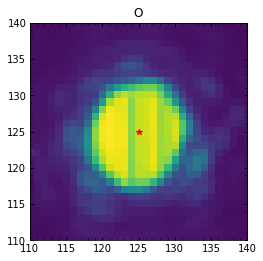

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03837.fits
bin_distcorr_lm_150104_03838.fits
7706.398384756674
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03838.fits: -0.9767792292710453, -0.6565799593610819


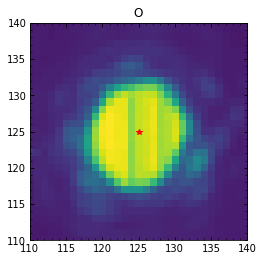

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03838.fits
bin_distcorr_lm_150104_03839.fits
7674.377978671698
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03839.fits: -0.9837166313270487, -0.36162127648979236


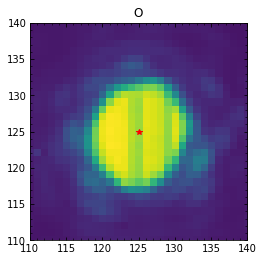

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03839.fits
bin_distcorr_lm_150104_03840.fits
7598.29706485434
STARTING  O
X: 200  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03840.fits: -0.05226185357996371, -0.35724343423908067


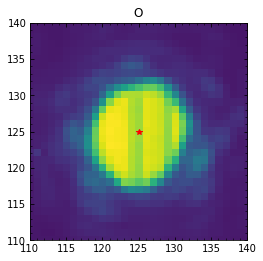

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03840.fits
bin_distcorr_lm_150104_03841.fits
7685.896352684025
STARTING  O
X: 200  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03841.fits: -0.06756033868886391, -0.3010417742140348


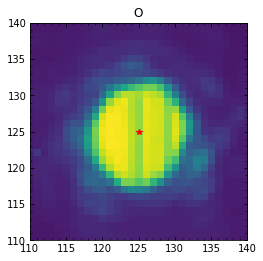

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03841.fits
bin_distcorr_lm_150104_03842.fits
7649.7635846532585
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03842.fits: -1.0727318911973143, -0.6494105421754597


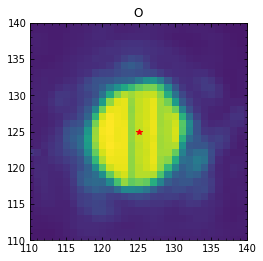

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03842.fits
bin_distcorr_lm_150104_03843.fits
7644.3625955047755
STARTING  O
X: 200  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03843.fits: -0.9793702096470653, -0.3636852879760113


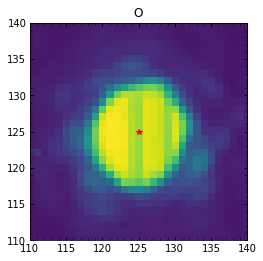

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_03843.fits
bin_distcorr_lm_150104_04324.fits
8035.8437502471315
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04324.fits: -0.05353581016068176, -0.0007445879259933008


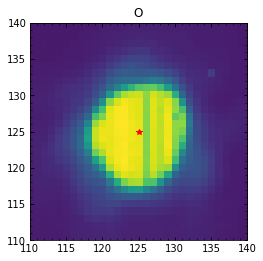

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04324.fits
bin_distcorr_lm_150104_04325.fits
8004.6492304464955
STARTING  O
X: 197  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04325.fits: -1.0110956806626774, -0.04202982951135681


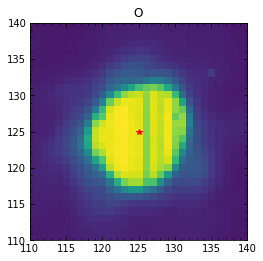

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04325.fits
bin_distcorr_lm_150104_04326.fits
7798.662172022067
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04326.fits: -0.05910908657102709, 0.00625371494487581


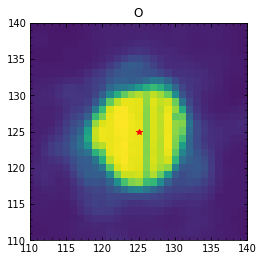

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04326.fits
bin_distcorr_lm_150104_04327.fits
7905.798777523439
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04327.fits: -0.058065799702312404, -0.020779631214658423


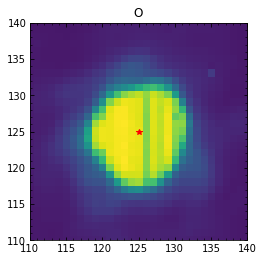

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04327.fits
bin_distcorr_lm_150104_04328.fits
7913.075194264736
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04328.fits: -0.03700179595904274, -0.03288409160040118


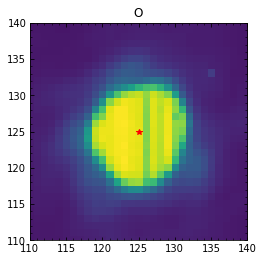

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04328.fits
bin_distcorr_lm_150104_04329.fits
8029.894933254041
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04329.fits: -0.023456988308488746, -0.02678655763411797


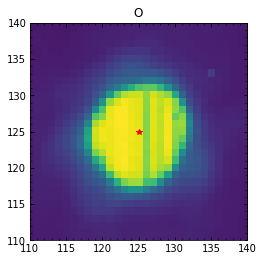

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04329.fits
bin_distcorr_lm_150104_04330.fits
7917.044182838708
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04330.fits: -0.08739163956329321, -0.012899821961305236


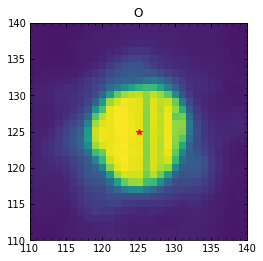

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04330.fits
bin_distcorr_lm_150104_04331.fits
8007.505207324179
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04331.fits: -0.07885371796540142, 0.011174514826223003


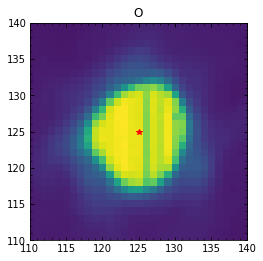

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04331.fits
bin_distcorr_lm_150104_04332.fits
8103.392113243076
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04332.fits: -0.12393640370676451, 0.06673550865236422


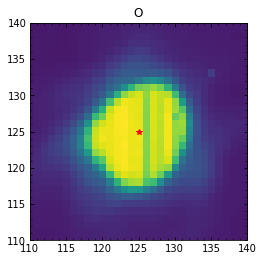

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04332.fits
bin_distcorr_lm_150104_04333.fits
8150.42755410202
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04333.fits: -0.09258515732192762, 0.02472834844510885


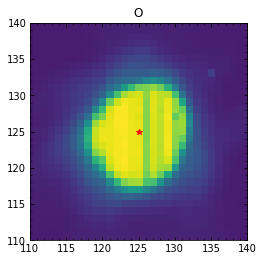

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04333.fits
bin_distcorr_lm_150104_04334.fits
8093.838877769857
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04334.fits: -0.00750387107041206, 0.05628537528814803


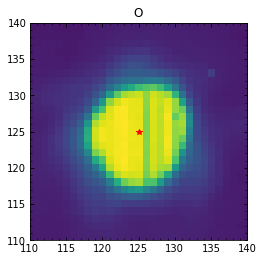

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04334.fits
bin_distcorr_lm_150104_04335.fits
7928.66056600243
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04335.fits: -0.08562839148802226, 0.027902266562570333


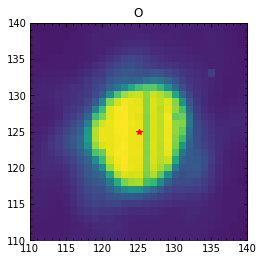

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04335.fits
bin_distcorr_lm_150104_04336.fits
7992.908945897143
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04336.fits: -0.06672086596997673, 0.09106850738537986


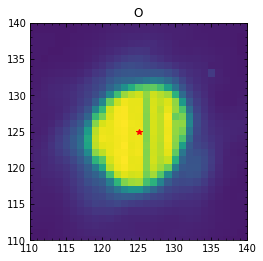

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04336.fits
bin_distcorr_lm_150104_04337.fits
7943.39631994599
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04337.fits: -0.11177675599269321, 0.06291556733776815


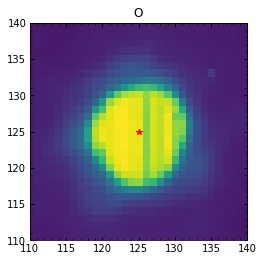

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04337.fits
bin_distcorr_lm_150104_04338.fits
7937.817865253886
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04338.fits: -0.11888041985500308, 0.01388088572973345


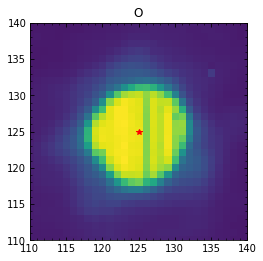

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04338.fits
bin_distcorr_lm_150104_04339.fits
7830.039476132593
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04339.fits: -0.09276702577376739, 0.04951820641639415


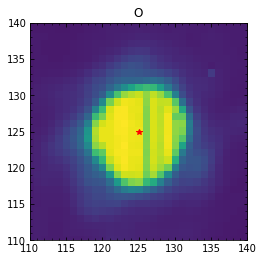

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04339.fits
bin_distcorr_lm_150104_04340.fits
7866.462642023148
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04340.fits: -0.1625372932982856, -0.032495731742244516


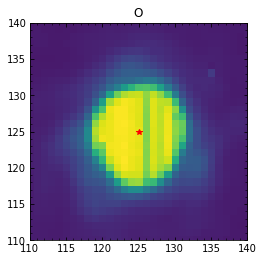

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04340.fits
bin_distcorr_lm_150104_04341.fits
7843.961745741483
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04341.fits: -0.11838287317372931, -0.005418558512047866


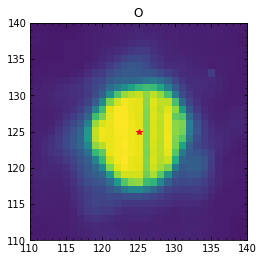

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04341.fits
bin_distcorr_lm_150104_04342.fits
7886.672224554715
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04342.fits: -0.08289576799211318, 0.011450834779680008


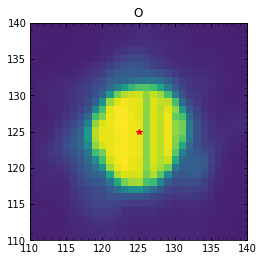

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04342.fits
bin_distcorr_lm_150104_04343.fits
7821.564448522684
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04343.fits: -0.09645448036732063, -0.008221176657755791


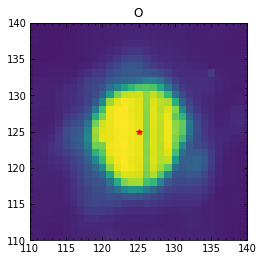

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04343.fits
bin_distcorr_lm_150104_04344.fits
7793.946527625541
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04344.fits: -0.0743591610575649, 0.01819419325126148


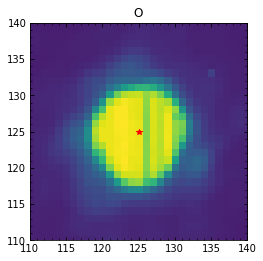

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04344.fits
bin_distcorr_lm_150104_04345.fits
7934.138173395262
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04345.fits: -0.060273867198347375, -0.0024997198225946704


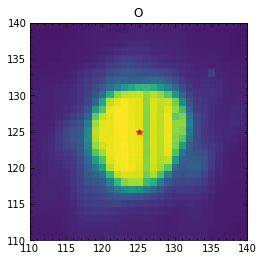

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04345.fits
bin_distcorr_lm_150104_04346.fits
8038.329735458179
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04346.fits: -0.1503187384453213, 0.06544688712234148


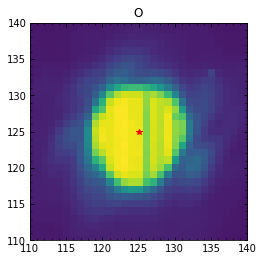

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04346.fits
bin_distcorr_lm_150104_04347.fits
7991.19773563747
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04347.fits: -0.14038241901898374, -6.365801273489069e-05


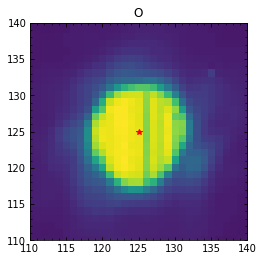

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04347.fits
bin_distcorr_lm_150104_04348.fits
8154.646188242451
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04348.fits: -0.1258528128059737, -0.016161039145103473


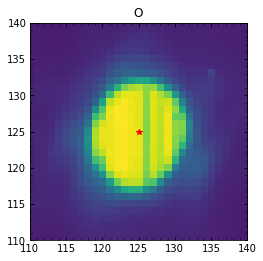

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04348.fits
bin_distcorr_lm_150104_04349.fits
7988.007371298776
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04349.fits: -0.07492676357892236, -0.028271947457994884


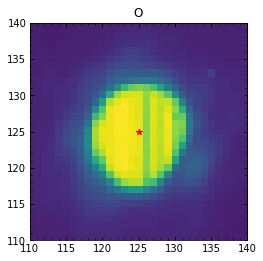

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04349.fits
bin_distcorr_lm_150104_04350.fits
7952.987124446695
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04350.fits: -0.12601688135880806, -0.023736204808940897


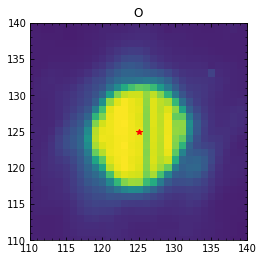

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04350.fits
bin_distcorr_lm_150104_04351.fits
7970.119136461024
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04351.fits: -0.07123496536909357, -0.023449018781676045


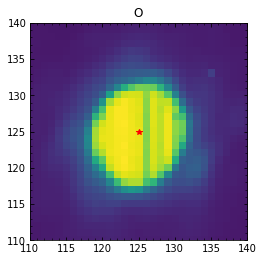

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04351.fits
bin_distcorr_lm_150104_04352.fits
8075.879916327956
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04352.fits: -0.10224541411604804, 0.009946984297116046


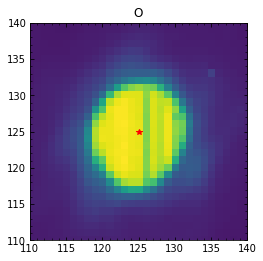

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04352.fits
bin_distcorr_lm_150104_04353.fits
8130.949922192054
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04353.fits: -0.07473947676402304, -0.01147923059940581


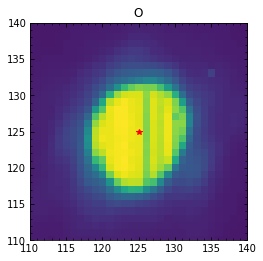

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04353.fits
bin_distcorr_lm_150104_04354.fits
8087.938884739129
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04354.fits: -0.09021673947609088, 0.04382451356448769


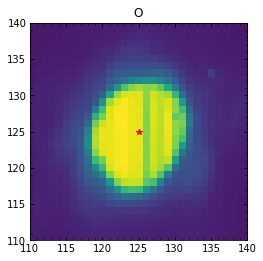

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04354.fits
bin_distcorr_lm_150104_04355.fits
7901.142462763004
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04355.fits: -0.12442506306712886, 1.0583524861829119e-05


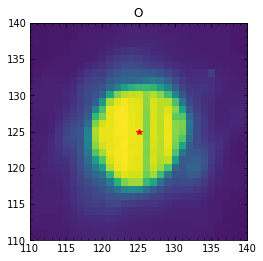

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04355.fits
bin_distcorr_lm_150104_04356.fits
7974.757012093397
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04356.fits: -0.05745423610277811, 0.019216160472858235


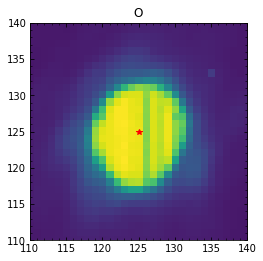

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04356.fits
bin_distcorr_lm_150104_04357.fits
7945.8352106964485
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04357.fits: -0.04895479698461003, 0.05537958691420641


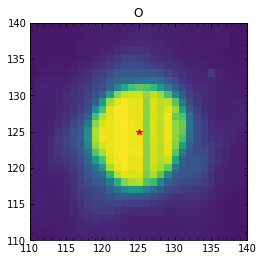

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04357.fits
bin_distcorr_lm_150104_04358.fits
8172.775117780034
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04358.fits: -0.06671084527690851, 0.04277793681276876


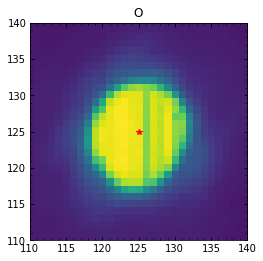

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04358.fits
bin_distcorr_lm_150104_04359.fits
8069.971171564429
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04359.fits: -0.17430539888319885, 0.10732460838181623


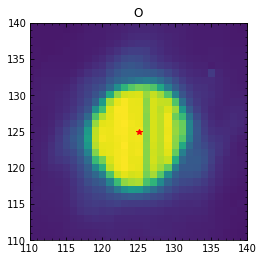

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04359.fits
bin_distcorr_lm_150104_04360.fits
7934.334118408734
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04360.fits: -0.14359716777668297, 0.050002359453827694


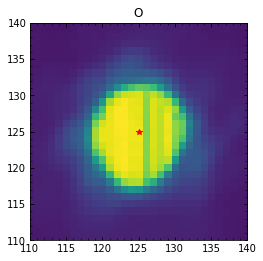

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04360.fits
bin_distcorr_lm_150104_04361.fits
7851.452947396422
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04361.fits: -0.17227740532183589, 0.07053112881689572


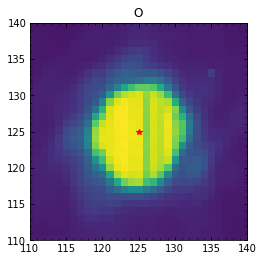

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04361.fits
bin_distcorr_lm_150104_04362.fits
8070.5934876126275
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04362.fits: -0.13832662296771048, 0.03646248061154722


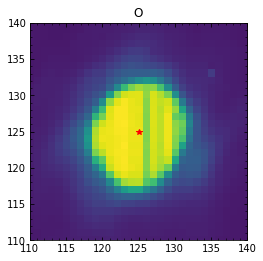

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04362.fits
bin_distcorr_lm_150104_04363.fits
8141.324412758505
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04363.fits: -0.1582668094581976, 0.014546047362209436


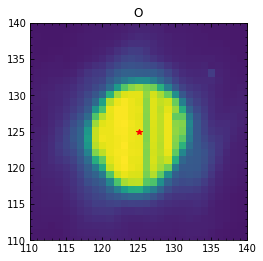

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04363.fits
bin_distcorr_lm_150104_04364.fits
7900.79791258263
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04364.fits: -0.15088089494793167, -4.193398935115056e-05


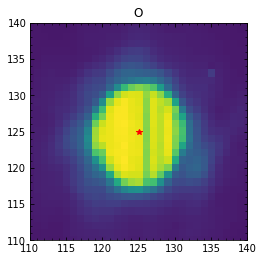

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04364.fits
bin_distcorr_lm_150104_04365.fits
8021.808665426142
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04365.fits: -0.1611271994286838, 0.0141576154424925


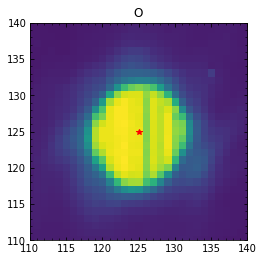

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04365.fits
bin_distcorr_lm_150104_04366.fits
7966.886660789248
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04366.fits: -0.177168305376199, -0.018109048819290763


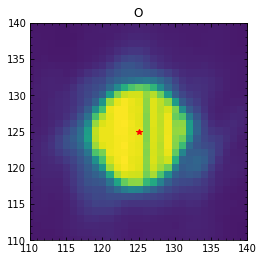

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04366.fits
bin_distcorr_lm_150104_04367.fits
7937.148487312315
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04367.fits: -0.11984898915978448, 0.03538439904962587


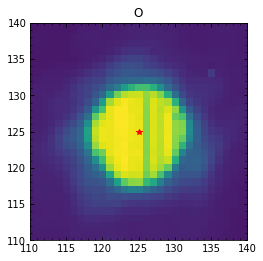

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04367.fits
bin_distcorr_lm_150104_04368.fits
7960.188715906641
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04368.fits: -0.09511900527463979, 0.03379378621513496


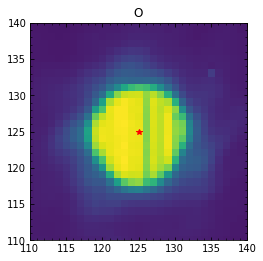

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04368.fits
bin_distcorr_lm_150104_04369.fits
7976.282711295021
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04369.fits: -0.05766744797966794, 0.026264637743963704


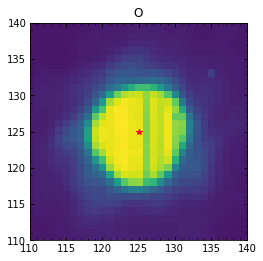

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04369.fits
bin_distcorr_lm_150104_04370.fits
8029.794884476391
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04370.fits: -0.06404270797715839, 0.0480805935224069


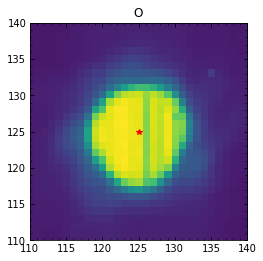

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04370.fits
bin_distcorr_lm_150104_04371.fits
8024.258888398237
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04371.fits: -0.08335367591594434, 0.02251860831809438


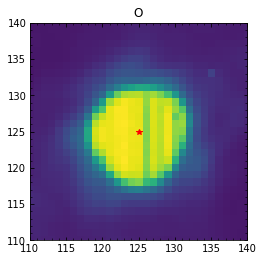

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04371.fits
bin_distcorr_lm_150104_04372.fits
7962.118043340129
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04372.fits: -0.09571303976510137, 0.07944156710968286


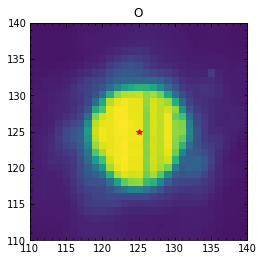

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04372.fits
bin_distcorr_lm_150104_04373.fits
7908.148599060189
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04373.fits: -0.11670135205537235, 0.031217088880239885


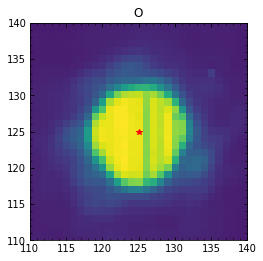

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04373.fits
bin_distcorr_lm_150104_04374.fits
7829.312487973472
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04374.fits: -0.09424559278055256, 0.006735437798980115


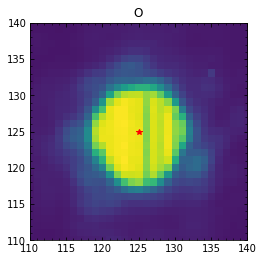

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04374.fits
bin_distcorr_lm_150104_04375.fits
7980.457478823433
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04375.fits: -0.11237148331508706, 0.005332914252917931


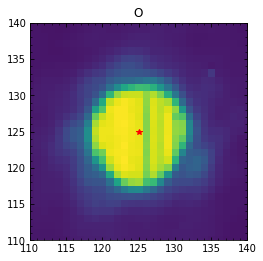

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04375.fits
bin_distcorr_lm_150104_04376.fits
7947.234627166295
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04376.fits: -0.11746816535664095, 0.016395486660449876


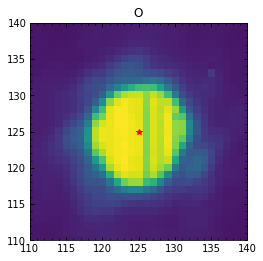

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04376.fits
bin_distcorr_lm_150104_04377.fits
7904.6668555726865
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04377.fits: -0.10216951959645115, 0.04447493487861465


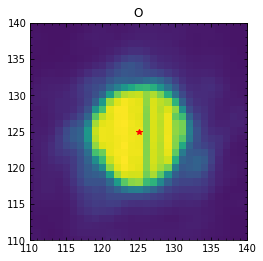

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04377.fits
bin_distcorr_lm_150104_04378.fits
8034.62735138792
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04378.fits: -0.13683582649671422, 0.03179927158407736


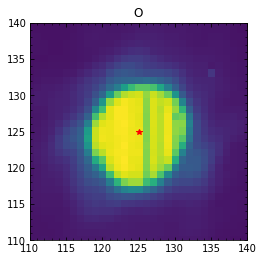

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04378.fits
bin_distcorr_lm_150104_04379.fits
8097.39577315606
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04379.fits: -0.1378771596766626, 0.011150179609749955


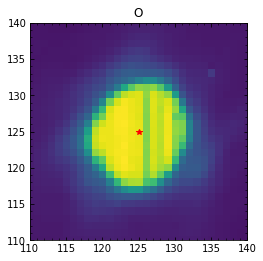

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04379.fits
bin_distcorr_lm_150104_04380.fits
8026.952528026165
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04380.fits: -0.1819764611202288, 0.05063869016527178


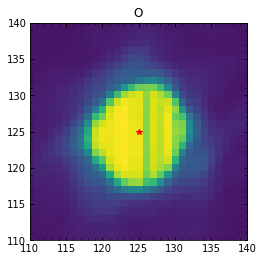

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04380.fits
bin_distcorr_lm_150104_04381.fits
7947.959761999122
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04381.fits: -0.16402517341757772, -0.013339900727771692


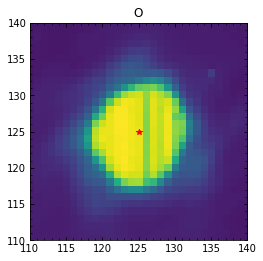

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04381.fits
bin_distcorr_lm_150104_04382.fits
7979.006207086556
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04382.fits: -0.21862035891378895, -0.010880807203072607


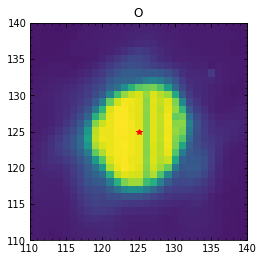

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04382.fits
bin_distcorr_lm_150104_04383.fits
7908.912495218878
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04383.fits: -0.16418772990663655, 0.0031077865140503036


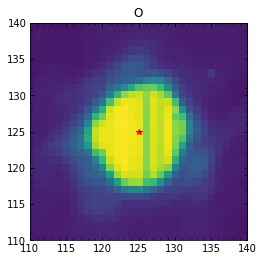

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04383.fits
bin_distcorr_lm_150104_04384.fits
7907.867692451321
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04384.fits: -0.1459158953308659, 0.022610092417735927


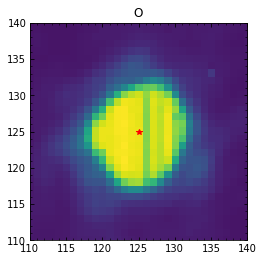

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04384.fits
bin_distcorr_lm_150104_04385.fits
7989.005879239224
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04385.fits: -0.11900513050956363, 0.007716556721099721


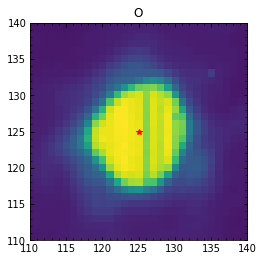

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04385.fits
bin_distcorr_lm_150104_04386.fits
7906.398027199908
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04386.fits: -0.09531561683272116, -0.02818883947106343


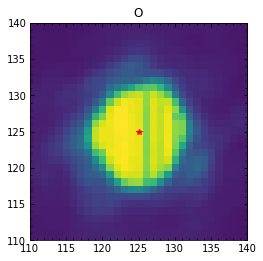

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04386.fits
bin_distcorr_lm_150104_04387.fits
7936.360309671379
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04387.fits: -0.11618221026628817, -0.01099400209320578


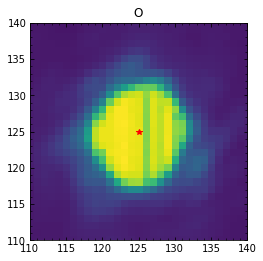

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04387.fits
bin_distcorr_lm_150104_04388.fits
7932.525943455918
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04388.fits: -0.13633077961966222, -0.012551032571884946


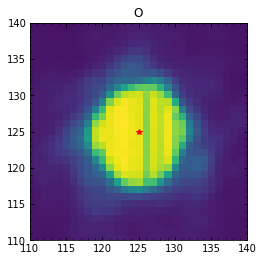

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04388.fits
bin_distcorr_lm_150104_04389.fits
7929.694787658298
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04389.fits: -0.12785060339029997, 0.006527926517655658


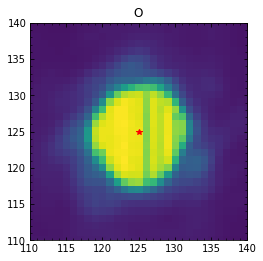

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04389.fits
bin_distcorr_lm_150104_04390.fits
8014.028238562353
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04390.fits: -0.08981030056438044, -0.052163995799482166


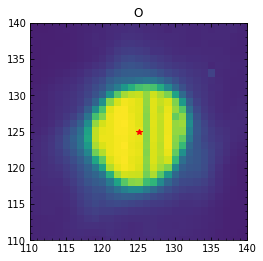

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04390.fits
bin_distcorr_lm_150104_04391.fits
7965.458206235722
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04391.fits: -0.038711253632826015, -0.03386346658651007


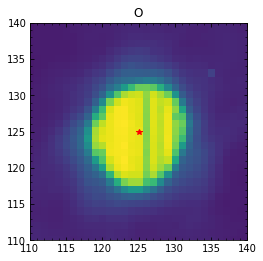

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04391.fits
bin_distcorr_lm_150104_04392.fits
7949.210368963255
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04392.fits: -0.06112983450165643, -0.03339193097443882


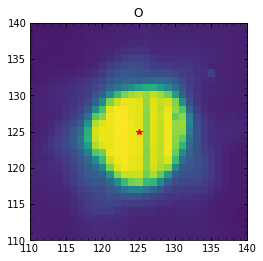

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04392.fits
bin_distcorr_lm_150104_04393.fits
7888.836399592191
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04393.fits: -0.16565383472054407, 0.00036677978417998247


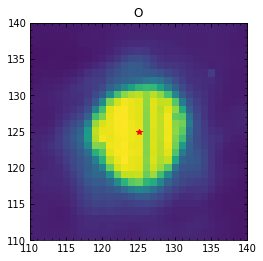

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04393.fits
bin_distcorr_lm_150104_04394.fits
7962.083704290291
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04394.fits: -0.08299320979570268, -0.023133446561089954


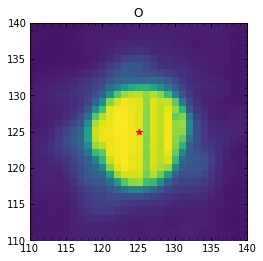

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04394.fits
bin_distcorr_lm_150104_04395.fits
7865.045026198551
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04395.fits: -0.08091614012872128, -0.036150890652308476


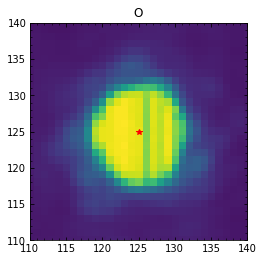

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04395.fits
bin_distcorr_lm_150104_04396.fits
7910.154210757683
STARTING  O
X: 197  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04396.fits: -1.0011926465424281, -0.12699734797313056


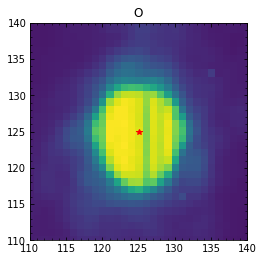

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04396.fits
bin_distcorr_lm_150104_04397.fits
7852.869885739798
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04397.fits: -0.11867371767976209, -0.005695117289739926


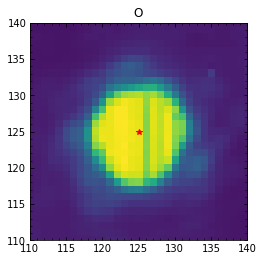

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04397.fits
bin_distcorr_lm_150104_04398.fits
7907.813681335621
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04398.fits: -0.11330757553958648, -0.041854403749781


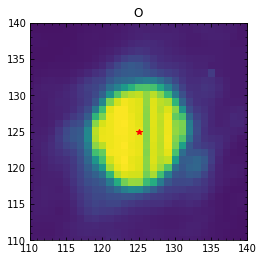

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04398.fits
bin_distcorr_lm_150104_04399.fits
7878.396485224678
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04399.fits: -0.14125306513128066, -0.009951269403323693


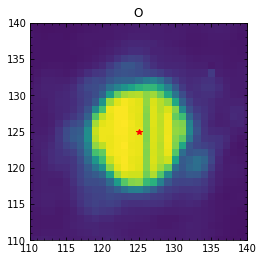

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04399.fits
bin_distcorr_lm_150104_04400.fits
7907.8654743163825
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04400.fits: -0.18522940084983475, 0.006984901328792148


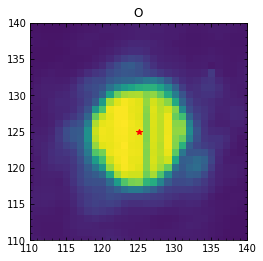

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04400.fits
bin_distcorr_lm_150104_04401.fits
7881.423653119584
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04401.fits: -0.18859521545026325, -0.009084780621599009


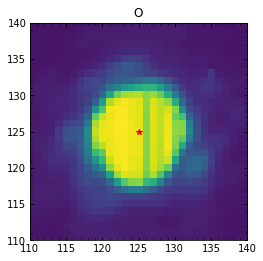

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04401.fits
bin_distcorr_lm_150104_04402.fits
7807.649279400972
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04402.fits: -0.19882100616835174, -0.0043256247973886275


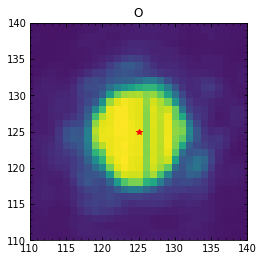

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04402.fits
bin_distcorr_lm_150104_04403.fits
7875.278588828298
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04403.fits: -0.1578675642056382, -0.0006469389208234588


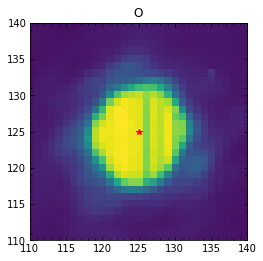

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04403.fits
bin_distcorr_lm_150104_04404.fits
7824.91573677529
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04404.fits: -0.09228138373218542, -0.015373053322733199


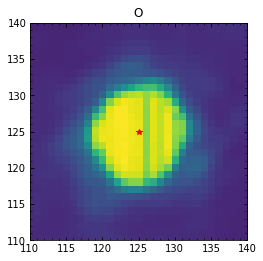

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04404.fits
bin_distcorr_lm_150104_04405.fits
7825.019818182254
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04405.fits: -0.12911019753460806, -0.001968129627883286


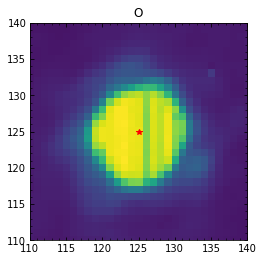

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04405.fits
bin_distcorr_lm_150104_04406.fits
7831.580575769328
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04406.fits: -0.13371911321100782, -0.008982452731743251


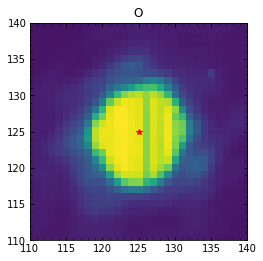

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04406.fits
bin_distcorr_lm_150104_04407.fits
7843.2590389978
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04407.fits: -0.12665316536455862, -0.03161436728564837


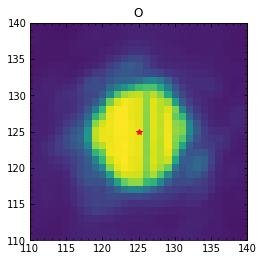

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04407.fits
bin_distcorr_lm_150104_04408.fits
7926.385341811434
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04408.fits: -0.10407415009625254, -0.01034322845233504


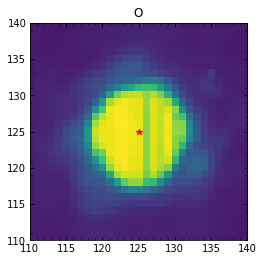

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04408.fits
bin_distcorr_lm_150104_04409.fits
7832.2082318254725
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04409.fits: -0.1244342534579701, -0.03944517246658563


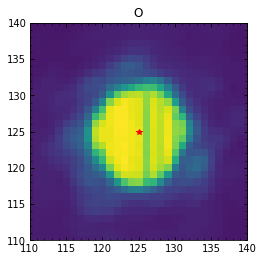

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04409.fits
bin_distcorr_lm_150104_04410.fits
7906.357486176589
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04410.fits: -0.12632955992945938, -0.037625327362349026


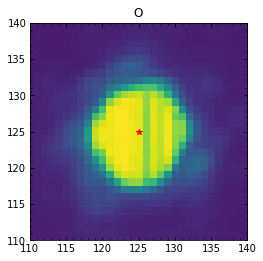

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04410.fits
bin_distcorr_lm_150104_04411.fits
7941.545992285531
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04411.fits: -0.12192831080988498, -0.025828148847637067


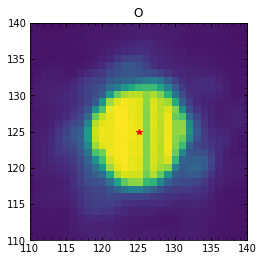

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04411.fits
bin_distcorr_lm_150104_04412.fits
7852.804918999747
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04412.fits: -0.13064867751864284, -0.0707898980368995


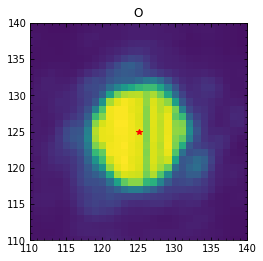

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04412.fits
bin_distcorr_lm_150104_04413.fits
7841.224467216961
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04413.fits: -0.11429179049189742, -0.05105184720537892


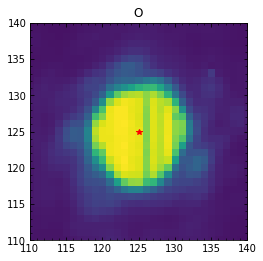

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04413.fits
bin_distcorr_lm_150104_04414.fits
7857.6407815592565
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04414.fits: -0.025306572039106356, -0.04346672774028093


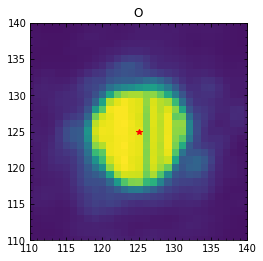

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04414.fits
bin_distcorr_lm_150104_04415.fits
7809.288974142166
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04415.fits: -0.059820591658535704, -0.02519115375664427


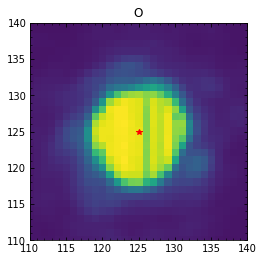

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04415.fits
bin_distcorr_lm_150104_04416.fits
7949.109988210515
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04416.fits: -0.11778952453756375, -0.041232316378220446


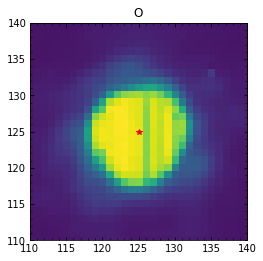

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04416.fits
bin_distcorr_lm_150104_04417.fits
7908.551428764471
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04417.fits: -0.1412329885596435, -0.09818962668592945


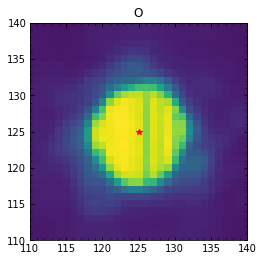

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04417.fits
bin_distcorr_lm_150104_04418.fits
7848.368636282803
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04418.fits: -0.16631513271260445, -0.08775628517158651


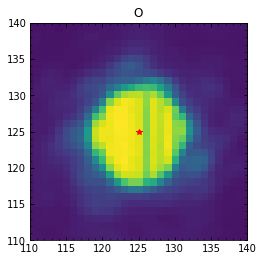

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04418.fits
bin_distcorr_lm_150104_04419.fits
7854.433145632677
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04419.fits: -0.15198999721033601, -0.09253838701780381


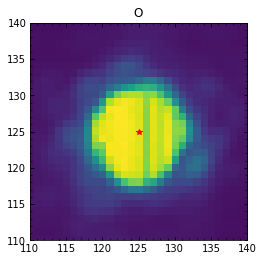

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04419.fits
bin_distcorr_lm_150104_04420.fits
7900.643011790773
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04420.fits: -0.1426746431951571, -0.057220702732344364


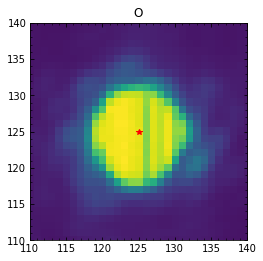

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04420.fits
bin_distcorr_lm_150104_04421.fits
7827.204547279647
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04421.fits: -0.11571932204459046, -0.057447661495423574


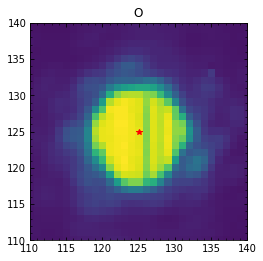

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04421.fits
bin_distcorr_lm_150104_04422.fits
7878.831093941774
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04422.fits: -0.07803664528389476, -0.08167779517318507


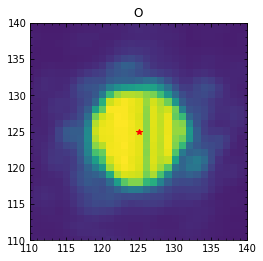

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04422.fits
bin_distcorr_lm_150104_04423.fits
7812.899513793478
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04423.fits: -0.03694593011326219, -0.052407136668144005


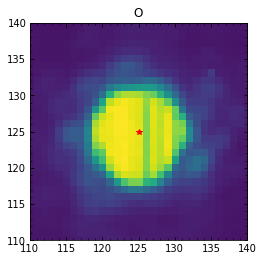

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04423.fits
bin_distcorr_lm_150104_04424.fits
7997.952253119395
STARTING  O
X: 197  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04424.fits: -1.017684249888724, -0.06726749621611106


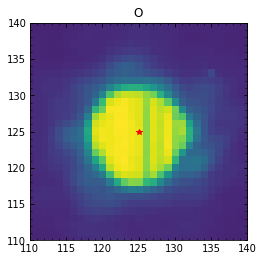

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04424.fits
bin_distcorr_lm_150104_04425.fits
7890.832802206601
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04425.fits: -0.07572773089579954, -0.06436452465511167


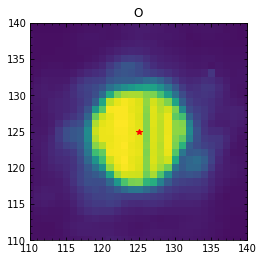

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04425.fits
bin_distcorr_lm_150104_04426.fits
7735.89427958707
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04426.fits: -0.04870591158177717, -0.03047802691409629


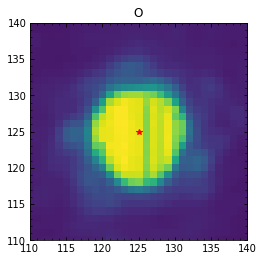

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04426.fits
bin_distcorr_lm_150104_04427.fits
7831.2561338576415
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04427.fits: -0.08492875120639809, -0.0464041575404508


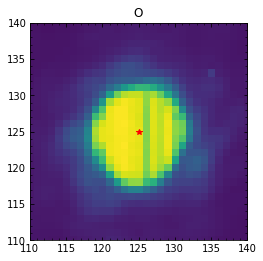

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04427.fits
bin_distcorr_lm_150104_04428.fits
7843.377686728231
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04428.fits: -0.09033312981683395, -0.061559350571009475


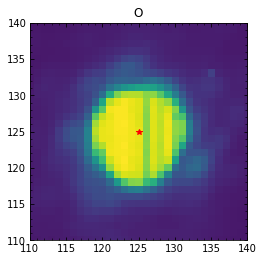

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04428.fits
bin_distcorr_lm_150104_04429.fits
7814.967903819409
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04429.fits: -0.07281453954802686, -0.0861817458517038


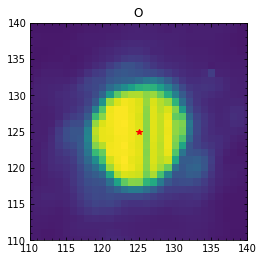

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04429.fits
bin_distcorr_lm_150104_04430.fits
7845.42151731623
STARTING  O
X: 197  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04430.fits: -1.0063063407023805, -0.035730032445769666


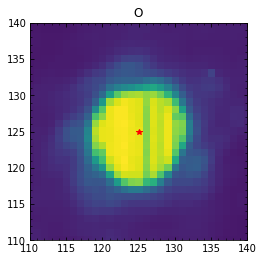

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04430.fits
bin_distcorr_lm_150104_04431.fits
7846.894830517456
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04431.fits: -0.08031955196211982, -0.032974326166304024


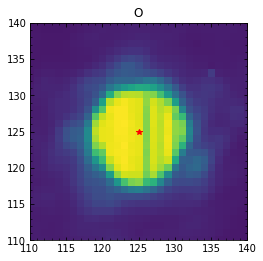

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04431.fits
bin_distcorr_lm_150104_04432.fits
7914.004827905055
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04432.fits: -0.11789261636628368, -0.07997702313807764


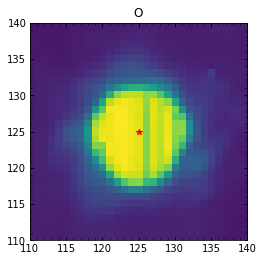

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04432.fits
bin_distcorr_lm_150104_04433.fits
7833.366365665574
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04433.fits: -0.1134423112673133, -0.021262987664407262


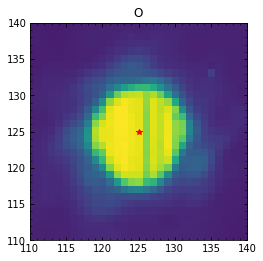

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04433.fits
bin_distcorr_lm_150104_04434.fits
7879.88304095727
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04434.fits: -0.07342531399702068, -0.022004875424237014


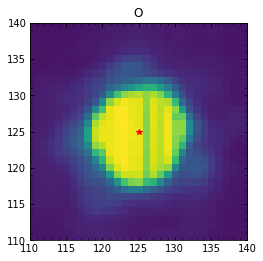

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04434.fits
bin_distcorr_lm_150104_04435.fits
7888.87013237628
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04435.fits: -0.07349846497625379, -0.07910110907220513


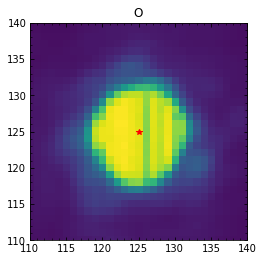

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04435.fits
bin_distcorr_lm_150104_04436.fits
7883.504579076299
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04436.fits: -0.08609590225993458, -0.08937439307101869


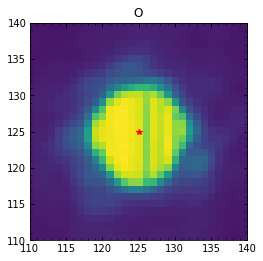

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04436.fits
bin_distcorr_lm_150104_04437.fits
7890.8192505611305
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04437.fits: -0.04682724163533436, -0.05680774044423487


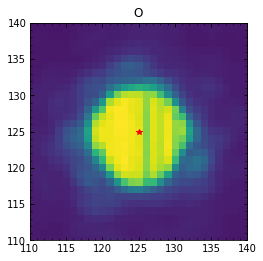

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04437.fits
bin_distcorr_lm_150104_04438.fits
7925.241324545559
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04438.fits: -0.04720896302021771, -0.0717193639678868


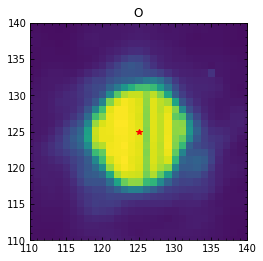

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04438.fits
bin_distcorr_lm_150104_04439.fits
8007.9446948632885
STARTING  O
X: 197  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04439.fits: -1.0217423789604112, -0.08958823182860698


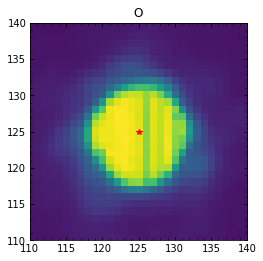

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04439.fits
bin_distcorr_lm_150104_04440.fits
7953.996276003913
STARTING  O
X: 197  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04440.fits: -1.0298682137483581, -0.11640395239899703


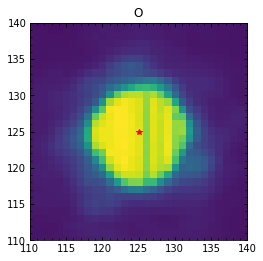

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04440.fits
bin_distcorr_lm_150104_04441.fits
7934.423556077046
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04441.fits: -0.09193380658006589, -0.09636512665589692


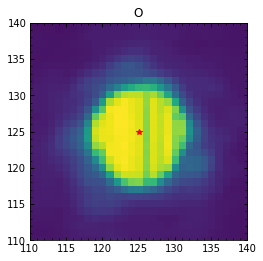

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04441.fits
bin_distcorr_lm_150104_04442.fits
8046.479489119015
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04442.fits: -0.08584688784093686, -0.1408211709892555


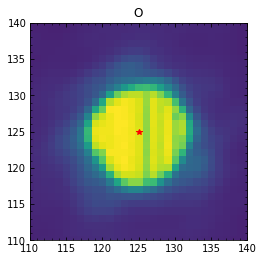

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04442.fits
bin_distcorr_lm_150104_04443.fits
7959.419614194068
STARTING  O
X: 197  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04443.fits: -0.07916468177371883, -0.14906666764698429


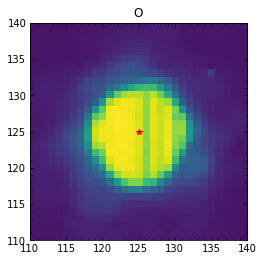

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04443.fits
bin_distcorr_lm_150104_04444.fits
8654.261382215687
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04444.fits: -1.0059528138278822, -0.3776856352122948


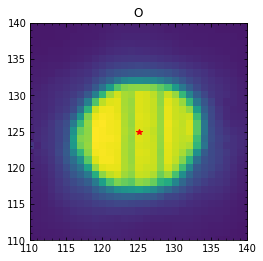

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04444.fits
bin_distcorr_lm_150104_04445.fits
8476.505383007738
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04445.fits: -1.0155601452590517, -0.3543159693573017


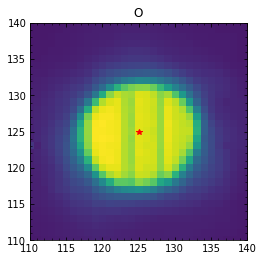

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04445.fits
bin_distcorr_lm_150104_04446.fits
8394.681869712647
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04446.fits: -0.9761900166072337, -0.35345003009087606


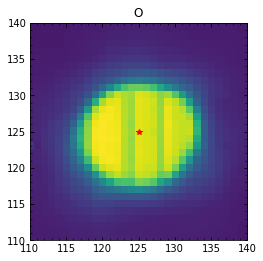

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04446.fits
bin_distcorr_lm_150104_04447.fits
8006.014990268376
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04447.fits: -1.005712879406957, -0.33132772779102737


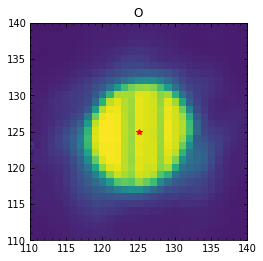

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04447.fits
bin_distcorr_lm_150104_04448.fits
8004.673843420295
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04448.fits: -0.9997964129513477, -0.28830330664575143


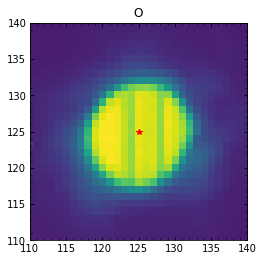

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04448.fits
bin_distcorr_lm_150104_04449.fits
8016.547162264745
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04449.fits: -0.9304939557500944, -0.33968136508554636


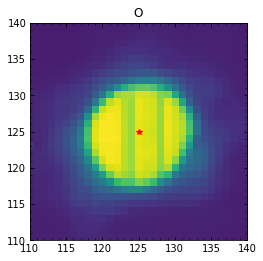

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04449.fits
bin_distcorr_lm_150104_04450.fits
8551.604387497484
STARTING  O
X: 201  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04450.fits: -0.03080272677582485, -0.3881558745614697


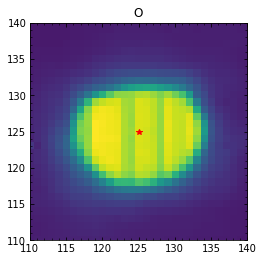

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04450.fits
bin_distcorr_lm_150104_04451.fits
8457.732237742846
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04451.fits: -1.027566655630551, -0.6438225446911829


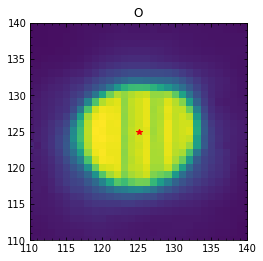

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04451.fits
bin_distcorr_lm_150104_04452.fits
9310.991842640538
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04452.fits: -1.030609323149065, -0.4357582546440568


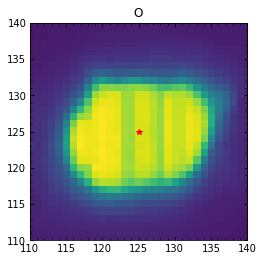

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04452.fits
bin_distcorr_lm_150104_04453.fits
9085.205796985283
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04453.fits: -1.0184225044061108, -0.5397718588656062


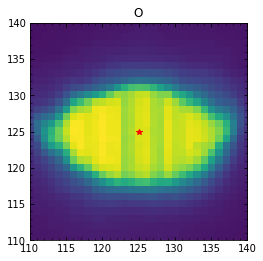

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04453.fits
bin_distcorr_lm_150104_04454.fits
8219.598551353816
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04454.fits: -1.006277270495623, -0.395249373766525


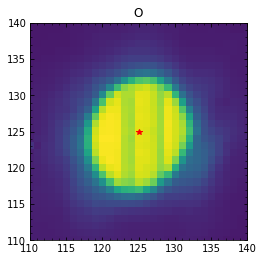

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04454.fits
bin_distcorr_lm_150104_04455.fits
8444.822582091994
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04455.fits: -0.9825784968501807, -0.3119365340452447


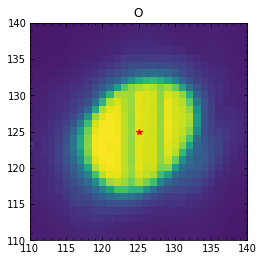

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04455.fits
bin_distcorr_lm_150104_04456.fits
8366.180014684003
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04456.fits: -0.9618647751817946, -0.3291749269927351


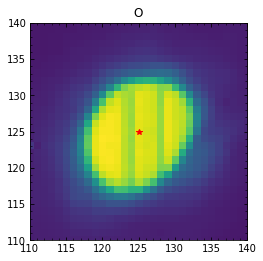

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04456.fits
bin_distcorr_lm_150104_04457.fits
8134.045151284134
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04457.fits: -0.8633956296357113, -0.40153779237009246


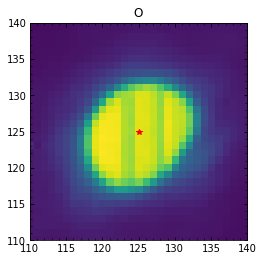

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04457.fits
bin_distcorr_lm_150104_04458.fits
7741.262443843105
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04458.fits: -0.9490977898365429, -0.34647225328598097


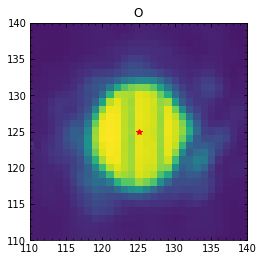

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04458.fits
bin_distcorr_lm_150104_04459.fits
7744.337628556095
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04459.fits: -0.9255802561234674, -0.318732844780925


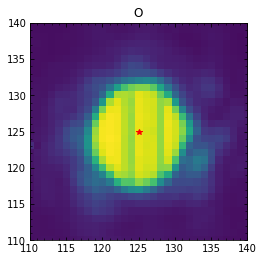

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04459.fits
bin_distcorr_lm_150104_04460.fits
7797.48105092482
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04460.fits: -0.877996610207525, -0.3497969432615662


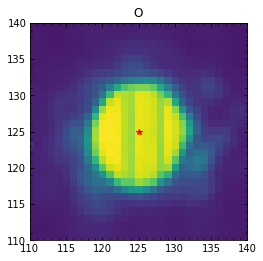

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04460.fits
bin_distcorr_lm_150104_04461.fits
7738.2906789139215
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04461.fits: -0.8803519106116156, -0.3677088092071443


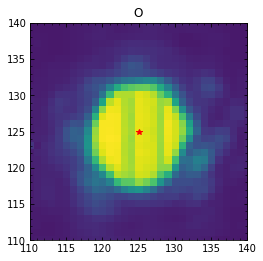

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04461.fits
bin_distcorr_lm_150104_04462.fits
7818.247631640966
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04462.fits: -0.8709588903585512, -0.36828932851377516


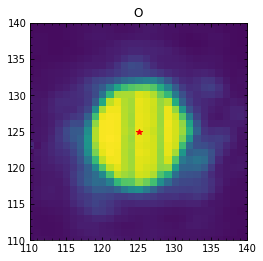

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04462.fits
bin_distcorr_lm_150104_04463.fits
7715.682789924671
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04463.fits: -0.9131031315857783, -0.3856719250136891


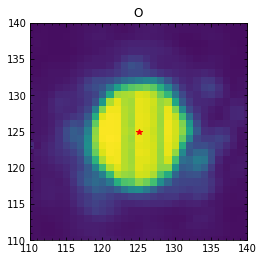

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04463.fits
bin_distcorr_lm_150104_04464.fits
7832.5805628351745
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04464.fits: -0.8657768903198431, -0.32876941366015444


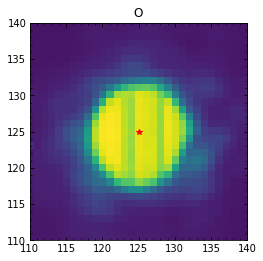

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04464.fits
bin_distcorr_lm_150104_04465.fits
7813.840703080234
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04465.fits: -0.8497594002528217, -0.3348638276579976


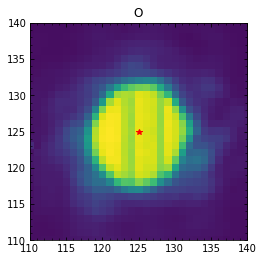

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04465.fits
bin_distcorr_lm_150104_04466.fits
7792.406062526988
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04466.fits: -0.8297442961915991, -0.38428050997348606


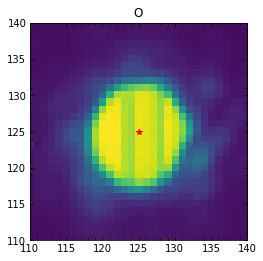

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04466.fits
bin_distcorr_lm_150104_04467.fits
7811.528497246271
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04467.fits: -0.8464030208706745, -0.3168507173603814


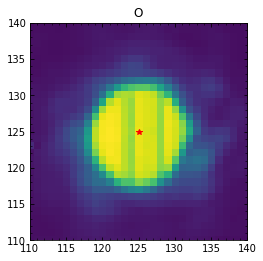

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04467.fits
bin_distcorr_lm_150104_04468.fits
7835.894222655646
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04468.fits: -0.9211975248934507, -0.3306378632871798


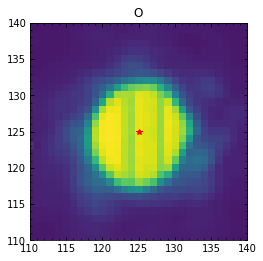

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04468.fits
bin_distcorr_lm_150104_04469.fits
7975.191576291844
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04469.fits: -0.9340052367040599, -0.33624713051569444


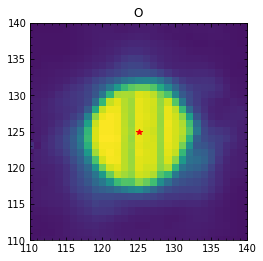

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04469.fits
bin_distcorr_lm_150104_04470.fits
7738.3218300757235
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04470.fits: -0.8733651963677929, -0.3123227325814497


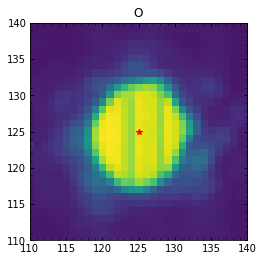

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04470.fits
bin_distcorr_lm_150104_04471.fits
7762.310277994873
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04471.fits: -0.8658244567036419, -0.3382579136798043


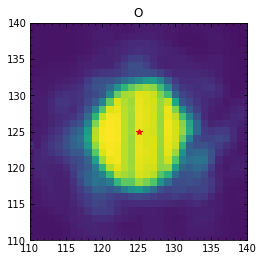

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04471.fits
bin_distcorr_lm_150104_04472.fits
7795.573690318804
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04472.fits: -0.8487233084228265, -0.3349054501436939


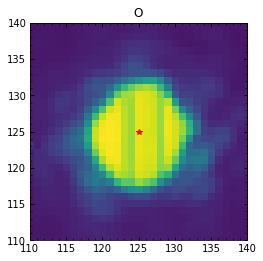

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04472.fits
bin_distcorr_lm_150104_04473.fits
7755.216324832901
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04473.fits: -0.8115127243489937, -0.3239612550126054


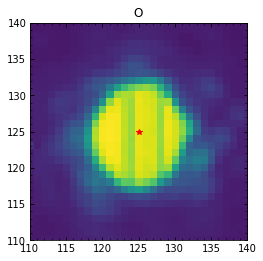

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04473.fits
bin_distcorr_lm_150104_04474.fits
7770.55466428429
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04474.fits: -0.7909409285342761, -0.3144299196212046


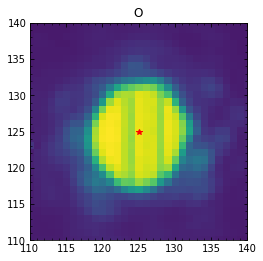

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04474.fits
bin_distcorr_lm_150104_04475.fits
7784.557533823424
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04475.fits: -0.7579692390690198, -0.31819707195764835


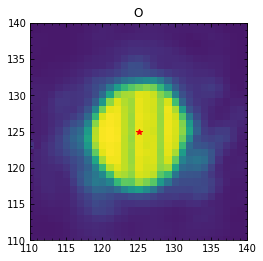

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04475.fits
bin_distcorr_lm_150104_04476.fits
7774.083286708921
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04476.fits: -0.7626128690814653, -0.3021381117851121


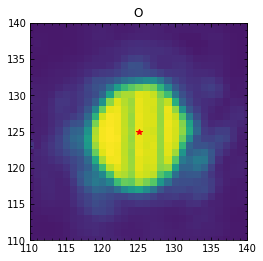

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04476.fits
bin_distcorr_lm_150104_04477.fits
7755.455885739277
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04477.fits: -0.7861897498429897, -0.33620641121511596


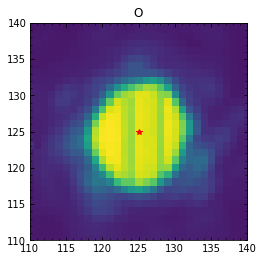

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04477.fits
bin_distcorr_lm_150104_04478.fits
7762.2054665230335
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04478.fits: -0.7470456173320912, -0.3409360081795043


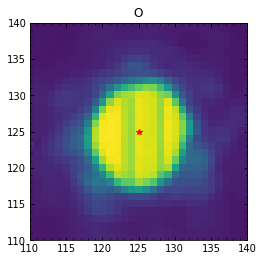

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04478.fits
bin_distcorr_lm_150104_04479.fits
7753.96526005044
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04479.fits: -0.7778352004153106, -0.3590532601488903


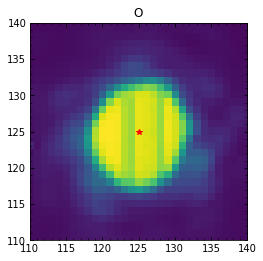

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04479.fits
bin_distcorr_lm_150104_04480.fits
7723.026034445799
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04480.fits: -0.7467123261426636, -0.34566306832535076


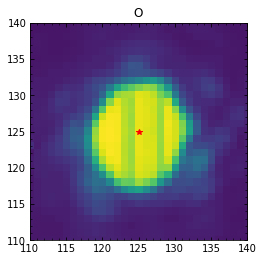

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04480.fits
bin_distcorr_lm_150104_04481.fits
7746.25746294219
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04481.fits: -0.7634306851866413, -0.3523154501570005


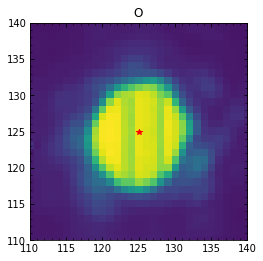

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04481.fits
bin_distcorr_lm_150104_04482.fits
7765.648643711514
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04482.fits: -0.7981920186765237, -0.3434782254078854


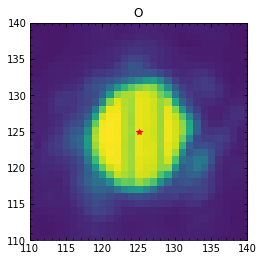

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04482.fits
bin_distcorr_lm_150104_04483.fits
7750.3897574413195
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04483.fits: -0.796607005533815, -0.35148306645064764


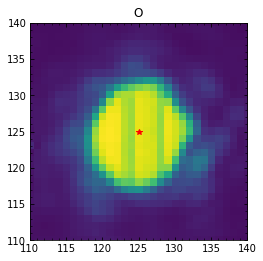

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04483.fits
bin_distcorr_lm_150104_04484.fits
7682.277368305233
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04484.fits: -0.725429371863143, -0.3333383641165639


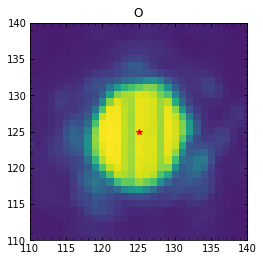

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04484.fits
bin_distcorr_lm_150104_04485.fits
7712.773099283141
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04485.fits: -0.6931840186585418, -0.3535504526791797


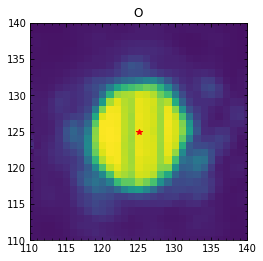

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04485.fits
bin_distcorr_lm_150104_04486.fits
7762.369264527373
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04486.fits: -0.7371688850283817, -0.34053210461924266


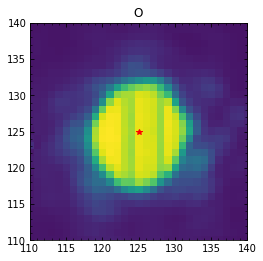

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04486.fits
bin_distcorr_lm_150104_04487.fits
7761.9526612115
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04487.fits: -0.7597503340876344, -0.33714925153552144


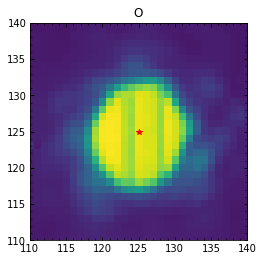

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04487.fits
bin_distcorr_lm_150104_04488.fits
7755.888975295935
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04488.fits: -0.739609770238495, -0.33324043471915843


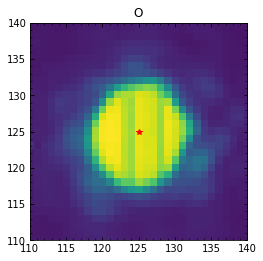

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04488.fits
bin_distcorr_lm_150104_04489.fits
7753.619557054977
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04489.fits: -0.7246434307556413, -0.3378452764165232


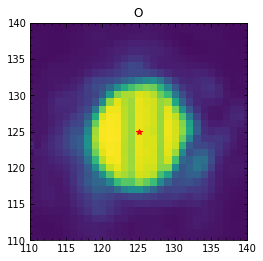

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04489.fits
bin_distcorr_lm_150104_04490.fits
7762.1350883622
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04490.fits: -0.7339025422381837, -0.3431183636610058


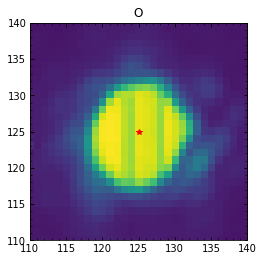

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04490.fits
bin_distcorr_lm_150104_04491.fits
7761.446725272886
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04491.fits: -0.7383559041564851, -0.35783616752808456


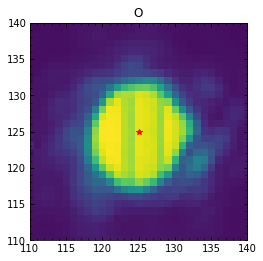

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04491.fits
bin_distcorr_lm_150104_04492.fits
7664.998075981073
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04492.fits: -0.7050711227565145, -0.3300726224527537


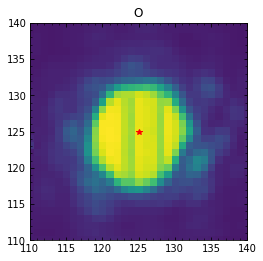

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04492.fits
bin_distcorr_lm_150104_04493.fits
7703.68217757248
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04493.fits: -0.6822617142140643, -0.37457570293882725


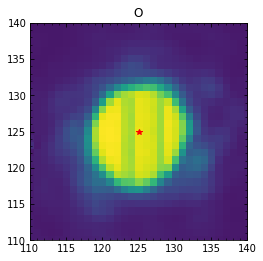

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04493.fits
bin_distcorr_lm_150104_04494.fits
7637.897347826313
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04494.fits: -0.658058752722873, -0.3277034989244356


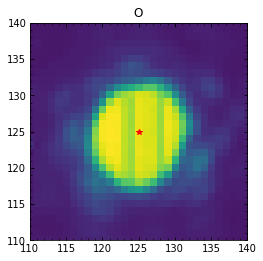

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04494.fits
bin_distcorr_lm_150104_04495.fits
7660.217365497495
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04495.fits: -0.663169611768538, -0.329639875546917


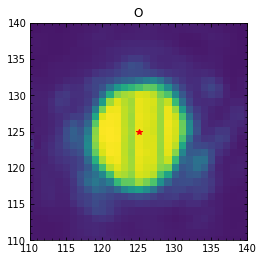

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04495.fits
bin_distcorr_lm_150104_04496.fits
7711.345346505894
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04496.fits: -0.6794461187317964, -0.32859175237604177


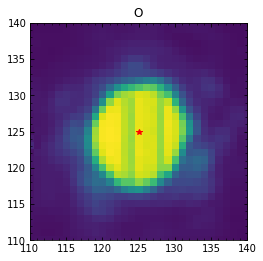

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04496.fits
bin_distcorr_lm_150104_04497.fits
7693.109882057223
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04497.fits: -0.676711256803415, -0.33132593382539


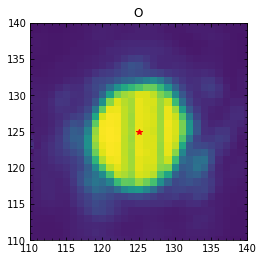

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04497.fits
bin_distcorr_lm_150104_04498.fits
7717.530078058278
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04498.fits: -0.7174741096724588, -0.3140918880128467


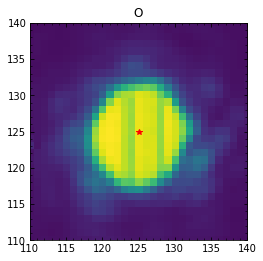

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04498.fits
bin_distcorr_lm_150104_04499.fits
7685.142348907347
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04499.fits: -0.714794287713417, -0.3016721483255651


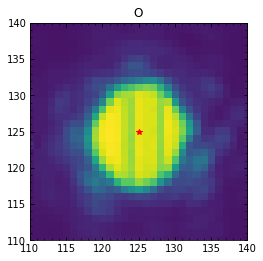

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04499.fits
bin_distcorr_lm_150104_04500.fits
7656.421968137541
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04500.fits: -0.7218858723054282, -0.32651029424818745


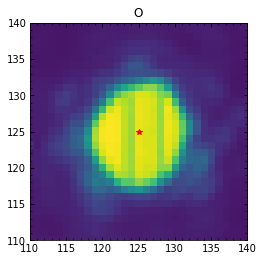

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04500.fits
bin_distcorr_lm_150104_04501.fits
7695.956938901009
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04501.fits: -0.75404654440662, -0.5576135589807052


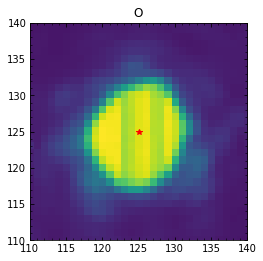

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04501.fits
bin_distcorr_lm_150104_04502.fits
7625.47016286646
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04502.fits: -0.7542030250923659, -0.583813018940532


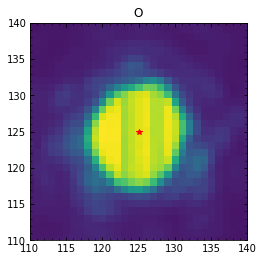

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04502.fits
bin_distcorr_lm_150104_04503.fits
7644.318185507151
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04503.fits: -0.6944425546442403, -0.5943097252527068


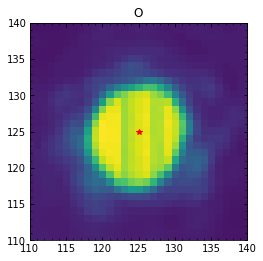

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04503.fits
bin_distcorr_lm_150104_04504.fits
7642.183557452019
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04504.fits: -0.6860837319879138, -0.6652472888400354


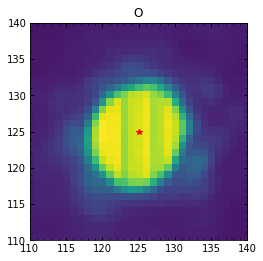

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04504.fits
bin_distcorr_lm_150104_04505.fits
7573.825542500737
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04505.fits: -0.685701451340698, -0.6423645616898952


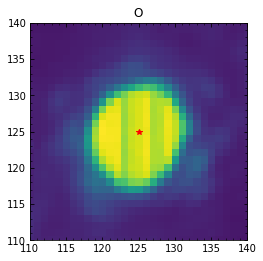

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04505.fits
bin_distcorr_lm_150104_04506.fits
7619.190081059373
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04506.fits: -0.6485843391744552, -0.5730452721520365


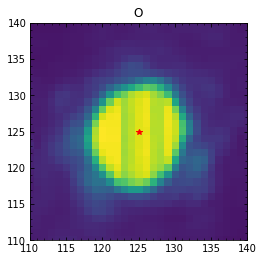

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04506.fits
bin_distcorr_lm_150104_04507.fits
7674.291177141394
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04507.fits: -0.35431846913256493, -0.2833165044244339


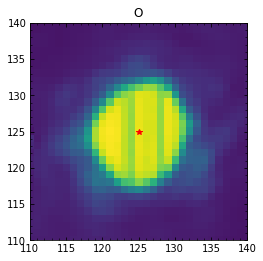

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04507.fits
bin_distcorr_lm_150104_04508.fits
7690.184422558521
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04508.fits: -0.6885121073623637, -0.5478288457265634


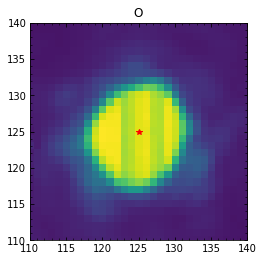

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04508.fits
bin_distcorr_lm_150104_04509.fits
7731.883048037564
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04509.fits: -0.6758431277506887, -0.5822872649182074


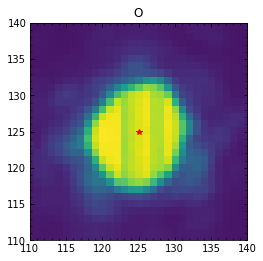

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04509.fits
bin_distcorr_lm_150104_04510.fits
7741.888527791186
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04510.fits: -0.6654798612348856, -0.5805019372053195


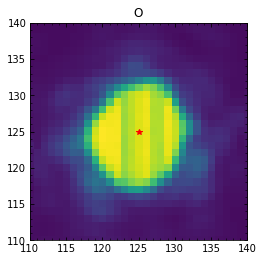

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04510.fits
bin_distcorr_lm_150104_04511.fits
7757.164284361873
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04511.fits: -0.6111864301500134, -0.339470365320075


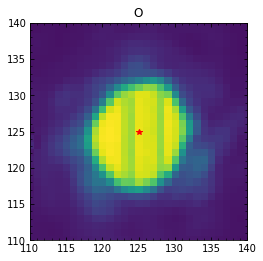

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04511.fits
bin_distcorr_lm_150104_04512.fits
7726.557641226549
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04512.fits: -0.3662586397490486, -0.32559375828705583


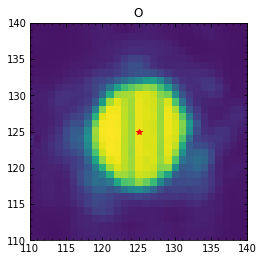

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04512.fits
bin_distcorr_lm_150104_04513.fits
7686.963141968417
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04513.fits: -0.34418359176968494, -0.2791771011260593


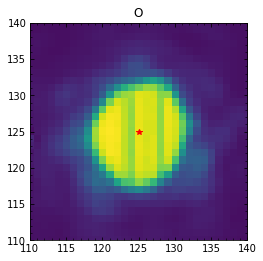

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04513.fits
bin_distcorr_lm_150104_04514.fits
7674.713274404803
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04514.fits: -0.37573560038454445, -0.24689999616410319


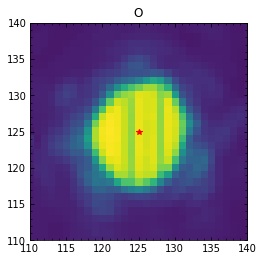

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04514.fits
bin_distcorr_lm_150104_04515.fits
7714.926123095362
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04515.fits: -0.3581974033832651, -0.2770398037959865


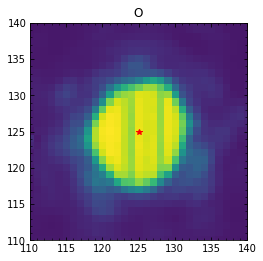

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04515.fits
bin_distcorr_lm_150104_04516.fits
7723.11276479571
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04516.fits: -0.3708279100045928, -0.24941249502274587


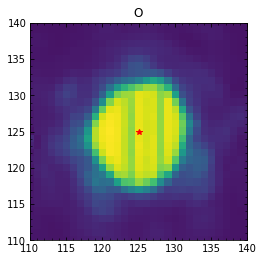

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04516.fits
bin_distcorr_lm_150104_04517.fits
7715.2550956486675
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04517.fits: -0.37470834453797863, -0.27793416773223356


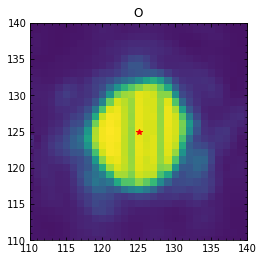

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04517.fits
bin_distcorr_lm_150104_04518.fits
7755.6992550104205
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04518.fits: -0.6044669019784195, -0.32426872970206944


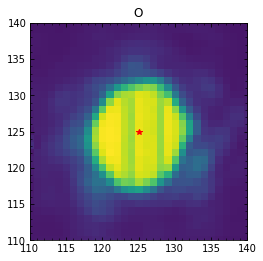

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04518.fits
bin_distcorr_lm_150104_04519.fits
7745.578907102055
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04519.fits: -0.36715831748095695, -0.3178216118483732


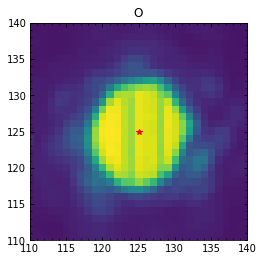

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04519.fits
bin_distcorr_lm_150104_04520.fits
7747.356549814527
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04520.fits: -0.36372701377541716, -0.33131722719819123


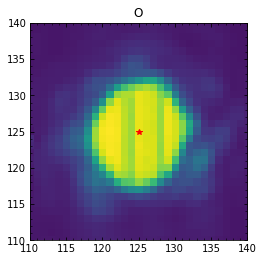

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04520.fits
bin_distcorr_lm_150104_04521.fits
7770.371798528536
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04521.fits: -0.6092668325276307, -0.34175735068274804


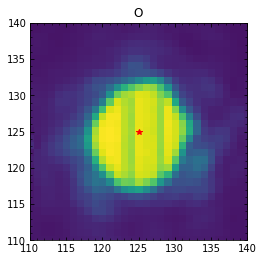

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04521.fits
bin_distcorr_lm_150104_04522.fits
7772.209732573673
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04522.fits: -0.37619068883908113, -0.32586942389800555


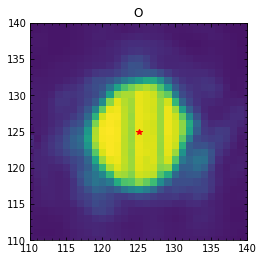

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04522.fits
bin_distcorr_lm_150104_04523.fits
7777.038445526724
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04523.fits: -0.35436133578568274, -0.3433908083432726


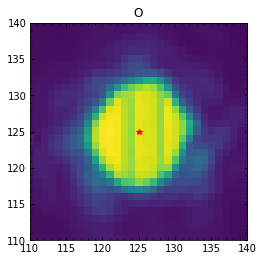

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04523.fits
bin_distcorr_lm_150104_04524.fits
7755.9169451358275
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04524.fits: -0.37964597602292116, -0.36329864813216517


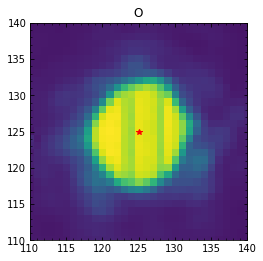

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04524.fits
bin_distcorr_lm_150104_04525.fits
7694.573546528796
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04525.fits: -0.3012197556205507, -0.3255413284898694


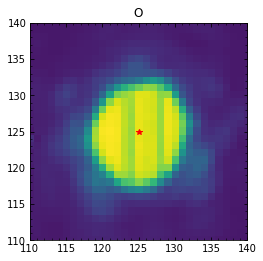

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04525.fits
bin_distcorr_lm_150104_04526.fits
7713.069758882209
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04526.fits: -0.28553258784639013, -0.30255255357444355


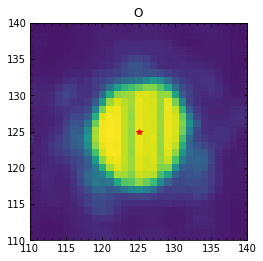

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04526.fits
bin_distcorr_lm_150104_04527.fits
7713.191328221707
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04527.fits: -0.294574478225357, -0.31523819263204444


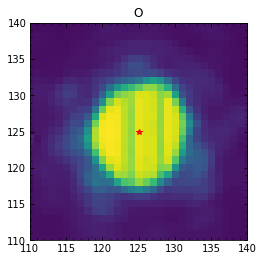

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04527.fits
bin_distcorr_lm_150104_04528.fits
7663.712444696725
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04528.fits: -0.3098260687844814, -0.29526053194275903


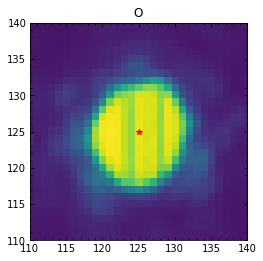

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04528.fits
bin_distcorr_lm_150104_04529.fits
7659.203998560364
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04529.fits: -0.3053936629728824, -0.3264356897252725


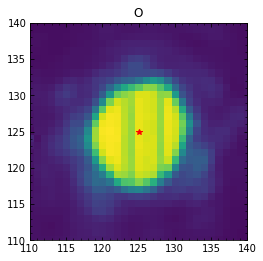

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04529.fits
bin_distcorr_lm_150104_04530.fits
7631.078719800542
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04530.fits: -0.3093025343632263, -0.2558307938802997


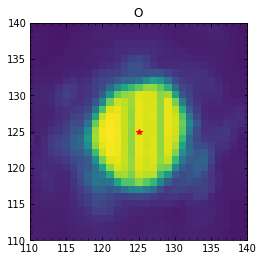

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04530.fits
bin_distcorr_lm_150104_04531.fits
7588.565612178265
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04531.fits: -0.3108451133471277, -0.2640282541380685


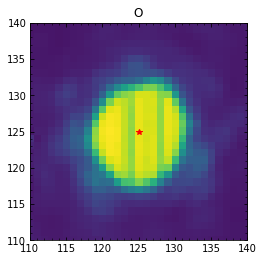

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04531.fits
bin_distcorr_lm_150104_04532.fits
7688.032590457624
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04532.fits: -0.2449031985553134, -0.2532449089335316


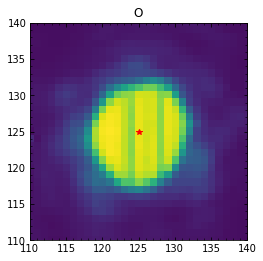

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04532.fits
bin_distcorr_lm_150104_04533.fits
7676.7916311533545
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04533.fits: -0.23653258291859203, -0.30361431769652825


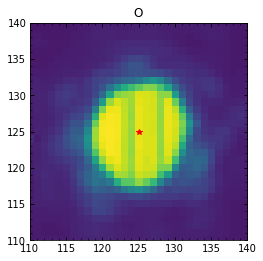

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04533.fits
bin_distcorr_lm_150104_04534.fits
7667.239637208359
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04534.fits: -0.24614727806332581, -0.33045343520841897


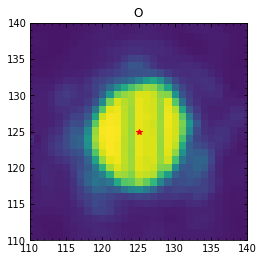

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04534.fits
bin_distcorr_lm_150104_04535.fits
7677.563727615061
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04535.fits: -0.23872562065101022, -0.28748423193097494


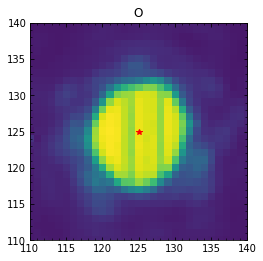

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04535.fits
bin_distcorr_lm_150104_04536.fits
7693.271419829971
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04536.fits: -0.22185958120169147, -0.3016326458773406


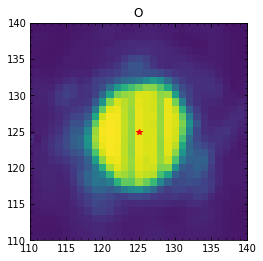

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04536.fits
bin_distcorr_lm_150104_04537.fits
7673.309266928766
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04537.fits: -0.2507044803928551, -0.31900128226841673


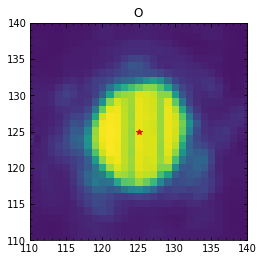

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04537.fits
bin_distcorr_lm_150104_04538.fits
7673.077795566109
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04538.fits: -0.23870764819591272, -0.3250900237594081


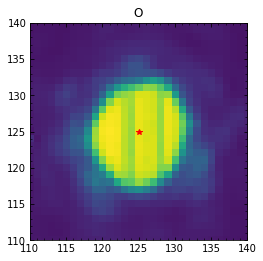

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04538.fits
bin_distcorr_lm_150104_04539.fits
7711.583693606637
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04539.fits: -0.22942362228796753, -0.3111756259550589


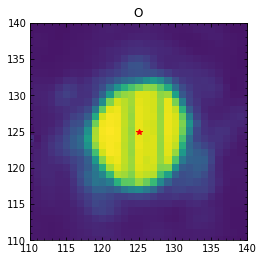

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04539.fits
bin_distcorr_lm_150104_04540.fits
7673.607446622347
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04540.fits: -0.23083235454947726, -0.31347320602936435


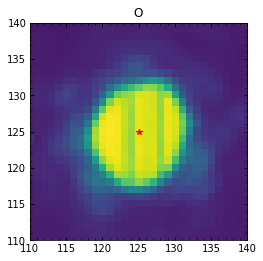

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04540.fits
bin_distcorr_lm_150104_04541.fits
7760.81049333167
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04541.fits: -0.20301959293967542, -0.3039952909036714


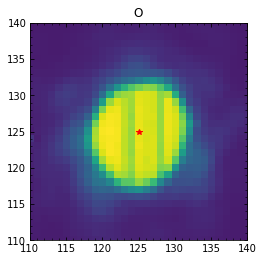

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04541.fits
bin_distcorr_lm_150104_04542.fits
7697.579066436345
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04542.fits: -0.23703873505619555, -0.3098601097921403


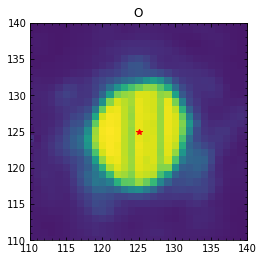

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04542.fits
bin_distcorr_lm_150104_04543.fits
7700.904885946624
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04543.fits: -0.22205032102156252, -0.350642642689472


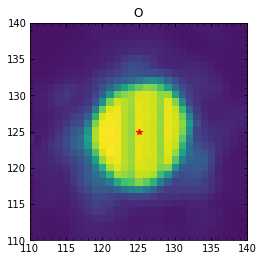

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04543.fits
bin_distcorr_lm_150104_04544.fits
7724.994384555919
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04544.fits: -0.18073835605306954, -0.328603661289101


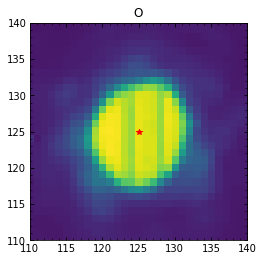

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04544.fits
bin_distcorr_lm_150104_04545.fits
7728.4187858277655
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04545.fits: -0.17671510293290282, -0.3473554646363226


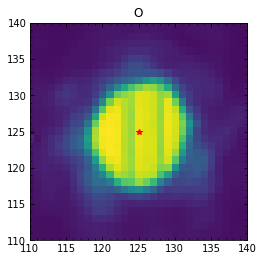

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04545.fits
bin_distcorr_lm_150104_04546.fits
7704.480547628578
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04546.fits: -0.1910495875958489, -0.33266537442807476


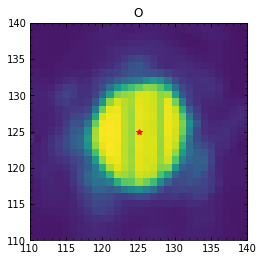

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04546.fits
bin_distcorr_lm_150104_04547.fits
7709.081669683113
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04547.fits: -0.20047317563378897, -0.3507101327934947


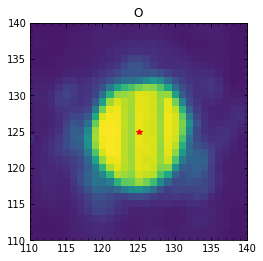

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04547.fits
bin_distcorr_lm_150104_04548.fits
7697.082323244903
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04548.fits: -0.19073310700376567, -0.3422560677505899


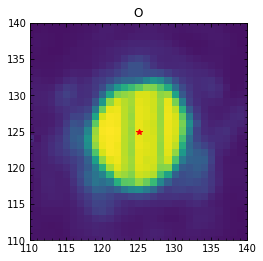

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04548.fits
bin_distcorr_lm_150104_04549.fits
7686.14661781069
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04549.fits: -0.181396534468945, -0.3434232280872038


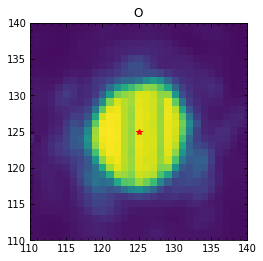

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04549.fits
bin_distcorr_lm_150104_04550.fits
7738.970832789936
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04550.fits: -0.21753443501827263, -0.619309363884831


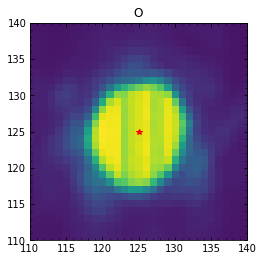

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04550.fits
bin_distcorr_lm_150104_04551.fits
7701.571076509426
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04551.fits: -0.21050168317439955, -0.5958320455698924


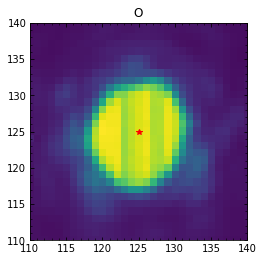

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04551.fits
bin_distcorr_lm_150104_04552.fits
7685.128672992649
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04552.fits: -0.21485823020567807, -0.6245892488729012


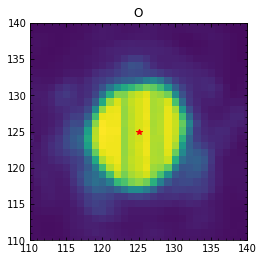

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04552.fits
bin_distcorr_lm_150104_04553.fits
7705.392789227141
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04553.fits: -0.20367040513610135, -0.5963917309457898


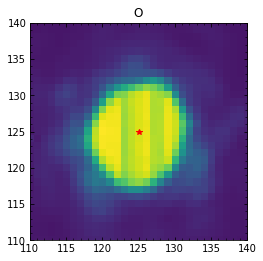

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04553.fits
bin_distcorr_lm_150104_04554.fits
7736.150838984551
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04554.fits: -0.20967970407393466, -0.6113445959996398


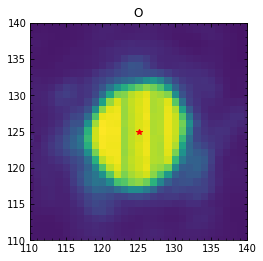

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04554.fits
bin_distcorr_lm_150104_04555.fits
7675.987800469504
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04555.fits: -0.2116265887439468, -0.6313384388770586


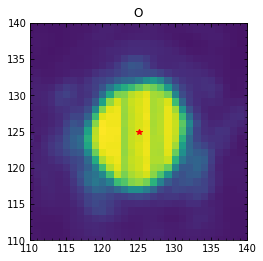

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04555.fits
bin_distcorr_lm_150104_04556.fits
7667.492560122146
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04556.fits: -0.21454844399553963, -0.6566114873202054


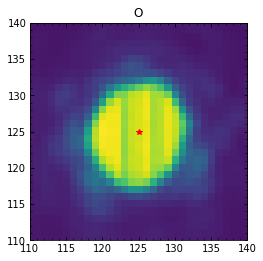

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04556.fits
bin_distcorr_lm_150104_04557.fits
7694.81576176699
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04557.fits: -0.22931143426193756, -0.6281990883273991


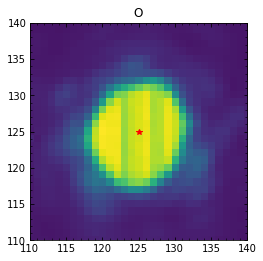

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04557.fits
bin_distcorr_lm_150104_04558.fits
7717.415752867399
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04558.fits: -0.2789864408124245, -0.5927402351568034


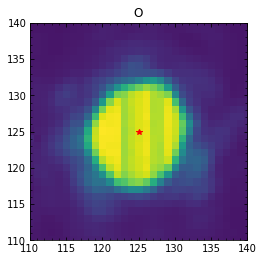

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04558.fits
bin_distcorr_lm_150104_04559.fits
7741.172650208099
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04559.fits: -0.2693219079859759, -0.6183442379730621


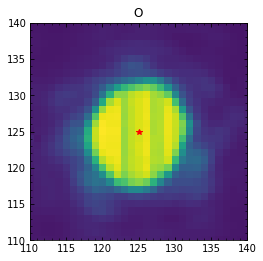

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04559.fits
bin_distcorr_lm_150104_04560.fits
7681.338826372986
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04560.fits: -0.2507663208426365, -0.6586875935117789


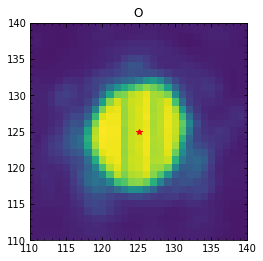

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04560.fits
bin_distcorr_lm_150104_04561.fits
7636.950812969416
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04561.fits: -0.24776152589912925, -0.7099897661350312


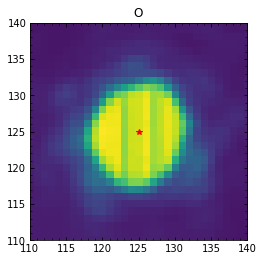

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04561.fits
bin_distcorr_lm_150104_04562.fits
7637.755653678835
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04562.fits: -0.264060362161743, -0.7122250259984071


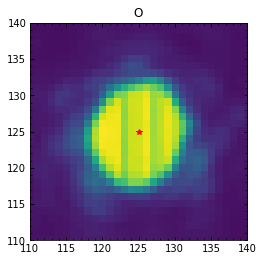

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04562.fits
bin_distcorr_lm_150104_04563.fits
7606.604291618487
STARTING  O
X: 201  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04563.fits: -0.23239523737758105, -0.6660613167901062


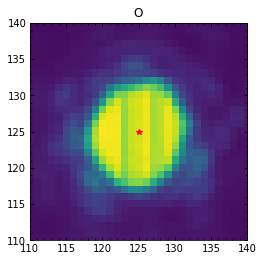

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04563.fits
bin_distcorr_lm_150104_04564.fits
7970.079510472495
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04564.fits: -0.8364559964888443, -0.17820130092972164


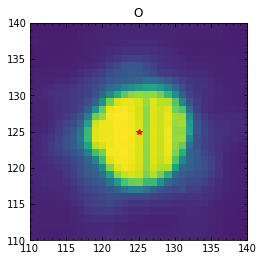

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04564.fits
bin_distcorr_lm_150104_04565.fits
7891.434478343773
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04565.fits: -0.7955454183869151, -0.22364395205884335


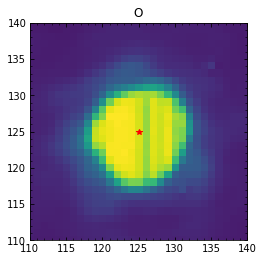

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04565.fits
bin_distcorr_lm_150104_04566.fits
7859.060186385495
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04566.fits: -0.8237953567681373, -0.20161548112602645


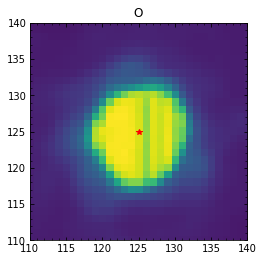

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04566.fits
bin_distcorr_lm_150104_04567.fits
7936.242908117237
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04567.fits: -0.8173600344821139, -0.1891382208608121


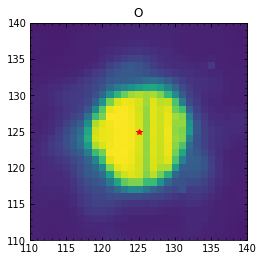

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04567.fits
bin_distcorr_lm_150104_04568.fits
7901.380799743395
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04568.fits: -0.7667189678797328, -0.20640611135534925


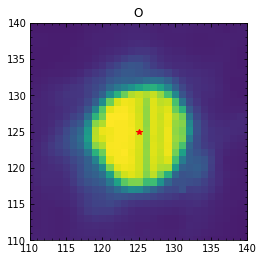

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04568.fits
bin_distcorr_lm_150104_04569.fits
8117.247442138619
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04569.fits: -0.7919365406548806, -0.25941864606514997


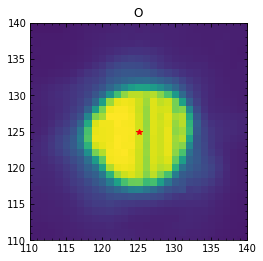

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04569.fits
bin_distcorr_lm_150104_04570.fits
7820.093871512763
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04570.fits: -0.8019437387818869, -0.2455843485396514


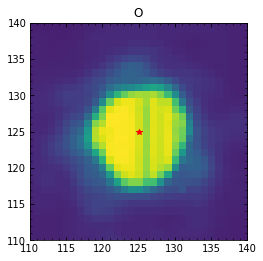

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04570.fits
bin_distcorr_lm_150104_04571.fits
7823.148702040318
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04571.fits: -0.7540582310231372, -0.1936726711514396


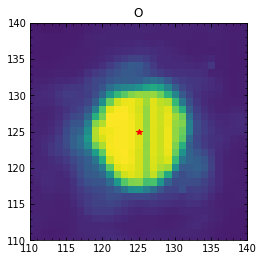

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04571.fits
bin_distcorr_lm_150104_04572.fits
7916.218674727241
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04572.fits: -0.7748361403019075, -0.254550900753884


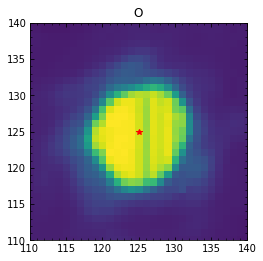

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04572.fits
bin_distcorr_lm_150104_04573.fits
7794.417340532177
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04573.fits: -0.7738632930126172, -0.2305593770966965


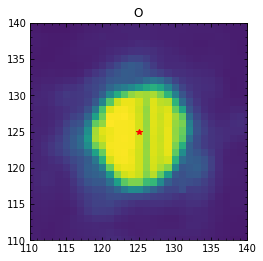

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04573.fits
bin_distcorr_lm_150104_04574.fits
7849.052675817724
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04574.fits: -0.7903459122113574, -0.2211854192714


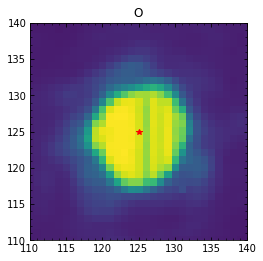

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04574.fits
bin_distcorr_lm_150104_04575.fits
7783.393045173468
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04575.fits: -0.8211026011911002, -0.19089701456147168


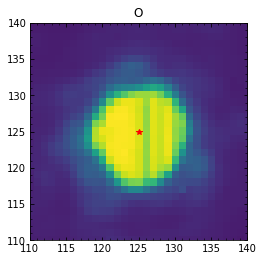

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04575.fits
bin_distcorr_lm_150104_04576.fits
7764.48801248332
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04576.fits: -0.7850057140823168, -0.22900481816311213


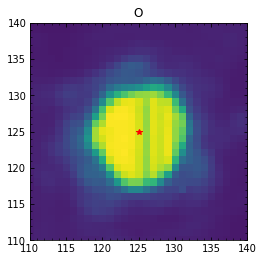

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04576.fits
bin_distcorr_lm_150104_04577.fits
7712.295581000033
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04577.fits: -0.7520922882190533, -0.23107651528503936


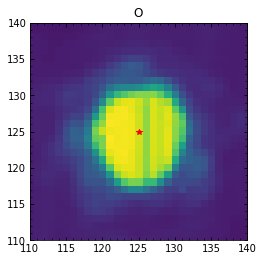

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04577.fits
bin_distcorr_lm_150104_04578.fits
7776.617320523621
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04578.fits: -0.7794045137360612, -0.22708527364390108


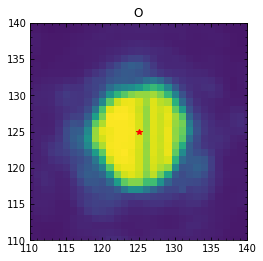

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04578.fits
bin_distcorr_lm_150104_04579.fits
7847.688780126599
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04579.fits: -0.8019186285545246, -0.2511885441600583


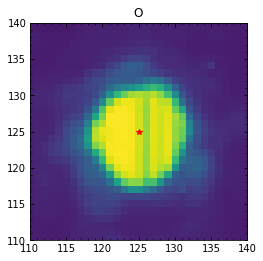

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04579.fits
bin_distcorr_lm_150104_04580.fits
7857.070784730027
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04580.fits: -0.7803389095260158, -0.22269768066723117


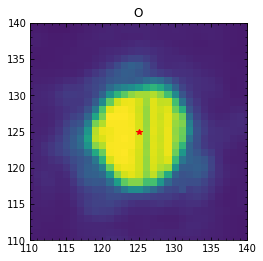

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04580.fits
bin_distcorr_lm_150104_04581.fits
7833.490875393378
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04581.fits: -0.7908365762708911, -0.20026373259395314


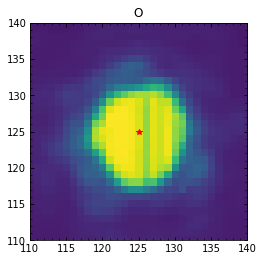

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04581.fits
bin_distcorr_lm_150104_04582.fits
7819.599340318358
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04582.fits: -0.8006518460880727, -0.22709916468845393


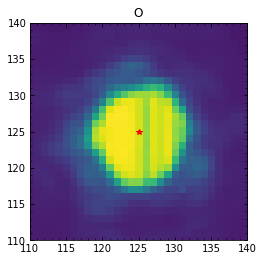

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04582.fits
bin_distcorr_lm_150104_04583.fits
7891.070415037214
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04583.fits: -0.8140080334358757, -0.21500141524910532


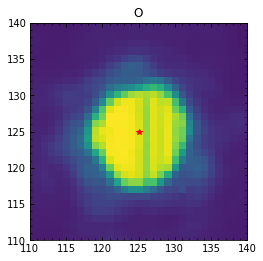

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04583.fits
bin_distcorr_lm_150104_04584.fits
7887.722788462484
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04584.fits: -0.7864569026592179, -0.2732999360381001


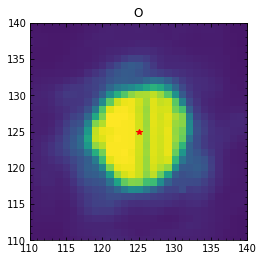

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04584.fits
bin_distcorr_lm_150104_04585.fits
7922.159332105372
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04585.fits: -0.8269799256234407, -0.5283371003502282


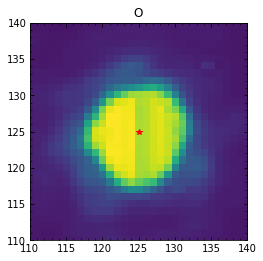

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04585.fits
bin_distcorr_lm_150104_04586.fits
7965.4420577300925
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04586.fits: -0.7936745723050933, -0.49226462397189863


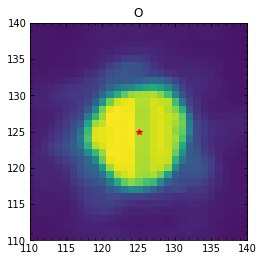

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04586.fits
bin_distcorr_lm_150104_04587.fits
7998.246180669406
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04587.fits: -0.8023245791023186, -0.26733820958508403


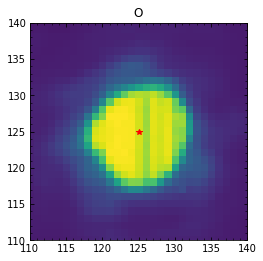

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04587.fits
bin_distcorr_lm_150104_04588.fits
7898.196992523974
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04588.fits: -0.8013090408084054, -0.2675005711689096


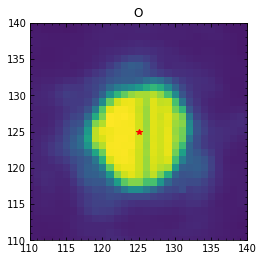

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04588.fits
bin_distcorr_lm_150104_04589.fits
7884.505140979596
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04589.fits: -0.8228411605830175, -0.5064663344430258


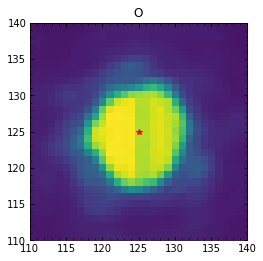

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04589.fits
bin_distcorr_lm_150104_04590.fits
7902.141504158177
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04590.fits: -0.8212476747605777, -0.5604916970064906


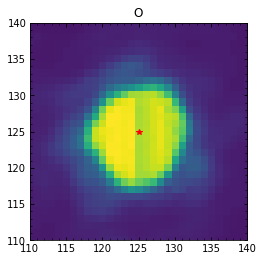

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04590.fits
bin_distcorr_lm_150104_04591.fits
7923.097356912687
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04591.fits: -0.8353734512323854, -0.5302217705490904


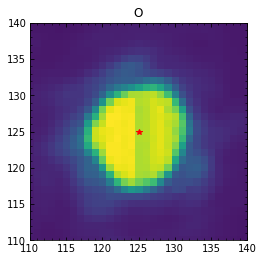

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04591.fits
bin_distcorr_lm_150104_04592.fits
7971.6999078010385
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04592.fits: -0.8297768455751253, -0.5520014347070514


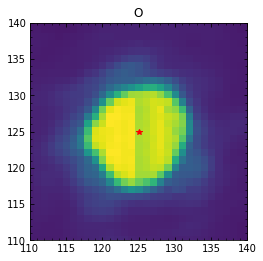

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04592.fits
bin_distcorr_lm_150104_04593.fits
7857.566926732843
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04593.fits: -0.8172111246857412, -0.5368358665560464


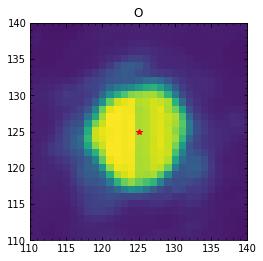

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04593.fits
bin_distcorr_lm_150104_04594.fits
7879.087709938169
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04594.fits: -0.8133236350339104, -0.579889353839441


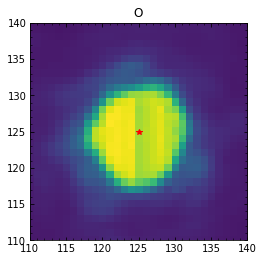

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04594.fits
bin_distcorr_lm_150104_04595.fits
7870.656037340471
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04595.fits: -0.8464842492386921, -0.5449444834768329


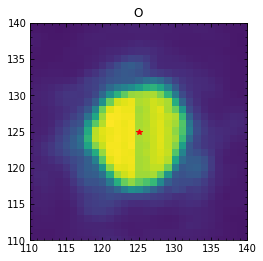

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04595.fits
bin_distcorr_lm_150104_04596.fits
7844.8225749957855
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04596.fits: -0.853597419428823, -0.5689021425743732


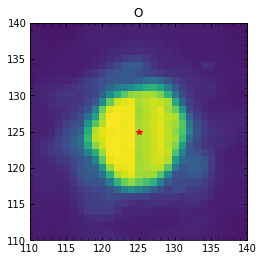

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04596.fits
bin_distcorr_lm_150104_04597.fits
7822.333606413042
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04597.fits: -0.7924299902238019, -0.5591473760791317


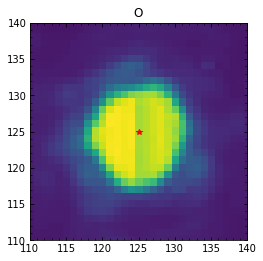

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04597.fits
bin_distcorr_lm_150104_04598.fits
7825.425306002483
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04598.fits: -0.7903638412075509, -0.5503494857840749


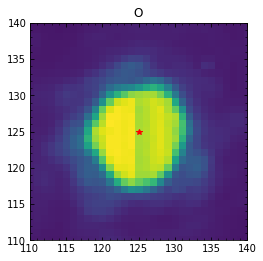

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04598.fits
bin_distcorr_lm_150104_04599.fits
7877.555129419491
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04599.fits: -0.8103563470844577, -0.5512442098456063


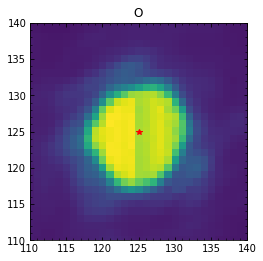

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04599.fits
bin_distcorr_lm_150104_04600.fits
7842.382642237545
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04600.fits: -0.8189884119093094, -0.5345634350435873


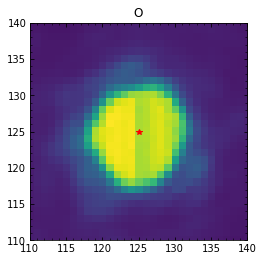

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04600.fits
bin_distcorr_lm_150104_04601.fits
7877.856743838722
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04601.fits: -0.8139483400952301, -0.5518063675718707


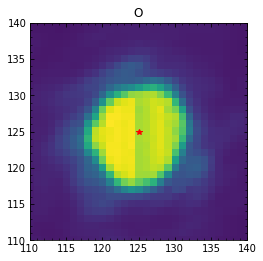

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04601.fits
bin_distcorr_lm_150104_04602.fits
7856.820456787333
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04602.fits: -0.8132595860982477, -0.5811663964935931


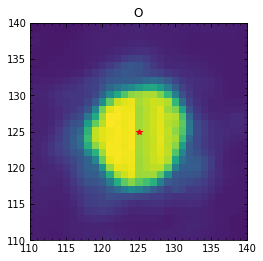

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04602.fits
bin_distcorr_lm_150104_04603.fits
7747.899882707125
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04603.fits: -0.7956682188938231, -0.6316062829343707


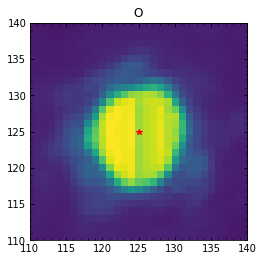

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04603.fits
bin_distcorr_lm_150104_04604.fits
7812.842766044363
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04604.fits: -0.7803174383393312, -0.5847471986561388


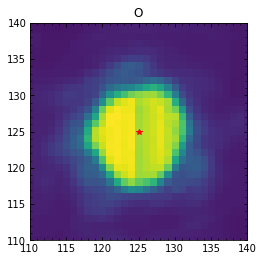

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04604.fits
bin_distcorr_lm_150104_04605.fits
7817.856749417736
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04605.fits: -0.788764830083899, -0.5822544201254871


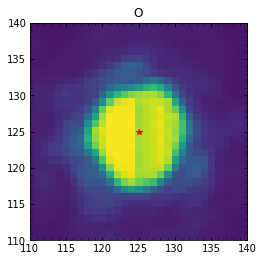

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04605.fits
bin_distcorr_lm_150104_04606.fits
7845.651866774574
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04606.fits: -0.803187821912573, -0.5806778365744023


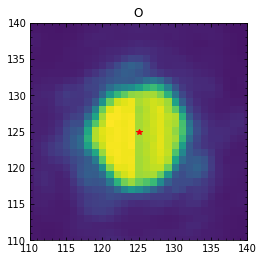

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04606.fits
bin_distcorr_lm_150104_04607.fits
7830.7547556312875
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04607.fits: -0.7969833049602499, -0.5795788356554965


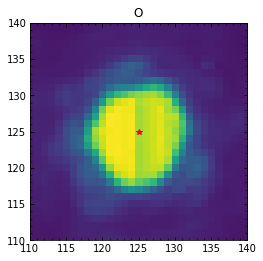

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04607.fits
bin_distcorr_lm_150104_04608.fits
7805.839217254838
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04608.fits: -0.8275794226111373, -0.5722740853334187


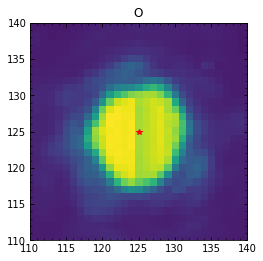

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04608.fits
bin_distcorr_lm_150104_04609.fits
7828.965162767791
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04609.fits: -0.8129499996607237, -0.6109526676152583


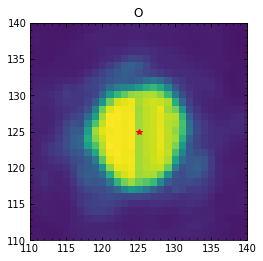

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04609.fits
bin_distcorr_lm_150104_04610.fits
7832.052580722204
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04610.fits: -0.8117751518323146, -0.6174582526770394


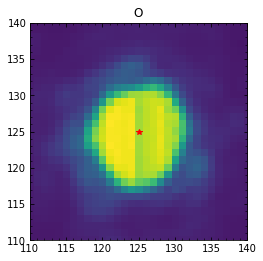

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04610.fits
bin_distcorr_lm_150104_04611.fits
7850.7683723312475
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04611.fits: -0.8350370063515342, -0.6242263398099581


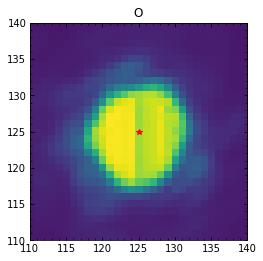

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04611.fits
bin_distcorr_lm_150104_04612.fits
7851.923407265425
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04612.fits: -0.7943856816685297, -0.6192565828856686


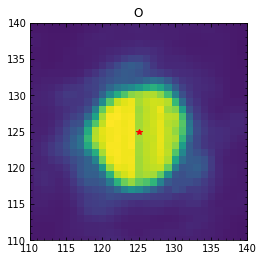

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04612.fits
bin_distcorr_lm_150104_04613.fits
7834.437478035153
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04613.fits: -0.8098492991294677, -0.6373376646113655


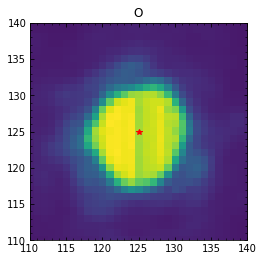

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04613.fits
bin_distcorr_lm_150104_04614.fits
7855.408502416493
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04614.fits: -0.8223624055356566, -0.6631803656803896


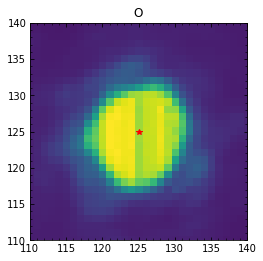

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04614.fits
bin_distcorr_lm_150104_04615.fits
7908.672275256042
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04615.fits: -0.8522051292057782, -0.7180276846994573


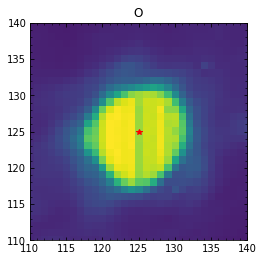

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04615.fits
bin_distcorr_lm_150104_04616.fits
7792.294004537222
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04616.fits: -0.7885512180206007, -0.6638184930724549


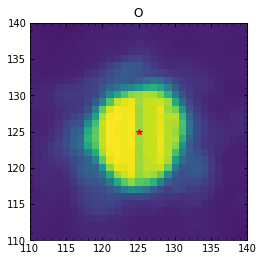

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04616.fits
bin_distcorr_lm_150104_04617.fits
7811.547974796676
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04617.fits: -0.7676052775063269, -0.6606672192580376


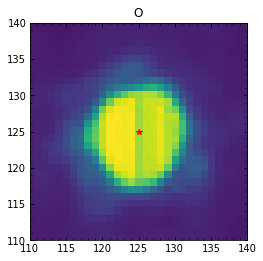

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04617.fits
bin_distcorr_lm_150104_04618.fits
7850.592074853394
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04618.fits: -0.7930519200725357, -0.6238949763425623


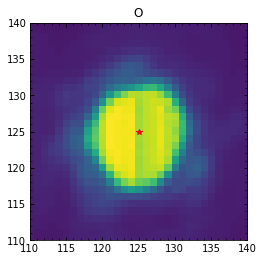

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04618.fits
bin_distcorr_lm_150104_04619.fits
7795.530565175589
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04619.fits: -0.8097990668559376, -0.6773668543058022


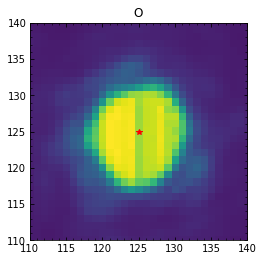

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04619.fits
bin_distcorr_lm_150104_04620.fits
7899.46703440445
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04620.fits: -0.7979488106627812, -0.6453973901299577


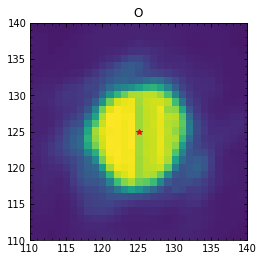

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04620.fits
bin_distcorr_lm_150104_04621.fits
7798.571729712894
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04621.fits: -0.7982312036053116, -0.7112624121155733


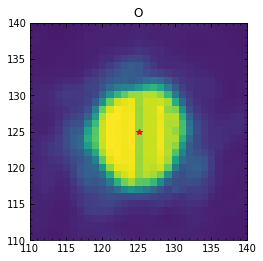

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04621.fits
bin_distcorr_lm_150104_04622.fits
7771.572252537084
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04622.fits: -0.8098843379633749, -0.7123462435534265


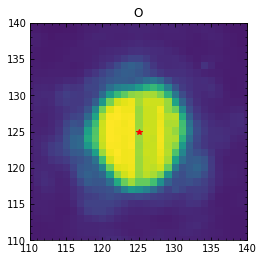

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04622.fits
bin_distcorr_lm_150104_04623.fits
7761.8797420333885
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04623.fits: -0.7701399171525196, -0.7102882315560706


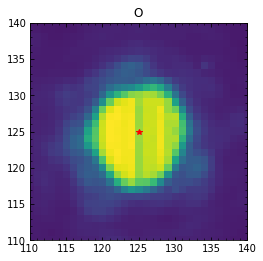

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04623.fits
bin_distcorr_lm_150104_04624.fits
7826.52448905915
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04624.fits: -0.7347998647705367, -0.6950290778213173


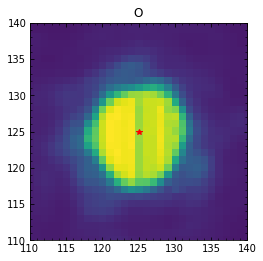

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04624.fits
bin_distcorr_lm_150104_04625.fits
7790.352356539022
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04625.fits: -0.782463989367173, -0.6605720136853392


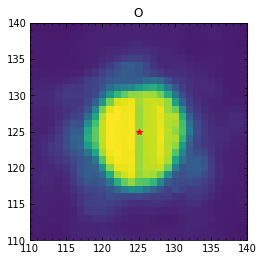

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04625.fits
bin_distcorr_lm_150104_04626.fits
7728.729602979215
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04626.fits: -0.7706816713642723, -0.6826044426940001


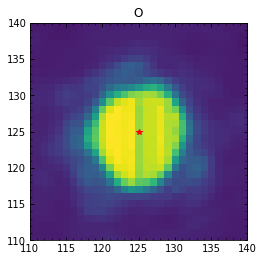

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04626.fits
bin_distcorr_lm_150104_04627.fits
7749.964262662611
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04627.fits: -0.7961312636829518, -0.6799700376854219


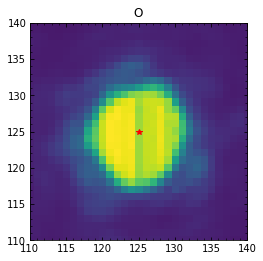

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04627.fits
bin_distcorr_lm_150104_04628.fits
7812.247008709626
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04628.fits: -0.7474048824925106, -0.6716030993433009


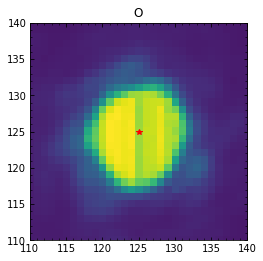

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04628.fits
bin_distcorr_lm_150104_04629.fits
7809.450098143175
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04629.fits: -0.7635750466125941, -0.7017777416990967


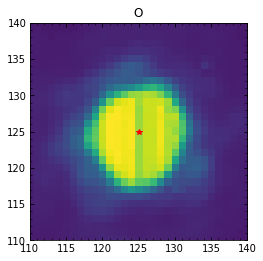

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04629.fits
bin_distcorr_lm_150104_04630.fits
7815.373874258816
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04630.fits: -0.768917372836853, -0.6959548104201971


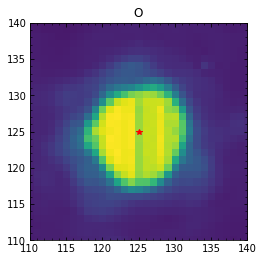

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04630.fits
bin_distcorr_lm_150104_04631.fits
7755.435292689981
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04631.fits: -0.7907921651807683, -0.6919628090568892


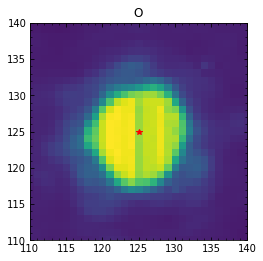

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04631.fits
bin_distcorr_lm_150104_04632.fits
7651.246242884466
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04632.fits: -0.8111398453906631, -0.7382888010413495


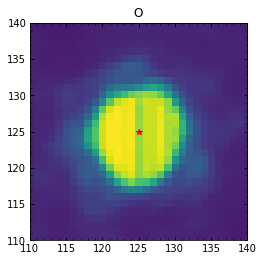

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04632.fits
bin_distcorr_lm_150104_04633.fits
7703.356807309362
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04633.fits: -0.7483995752376416, -0.704583326055463


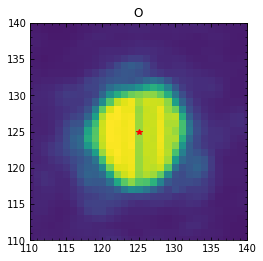

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04633.fits
bin_distcorr_lm_150104_04634.fits
7689.761645424111
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04634.fits: -0.743869576845583, -0.7717743283803173


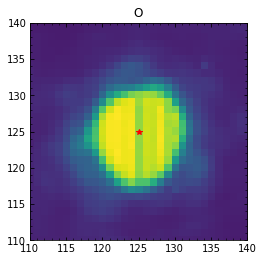

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04634.fits
bin_distcorr_lm_150104_04635.fits
7773.5542341875935
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04635.fits: -0.7886082854710565, -0.7027878226662025


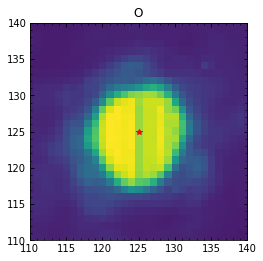

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04635.fits
bin_distcorr_lm_150104_04636.fits
7876.702882366578
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04636.fits: -0.7722707278239369, -0.623126872967724


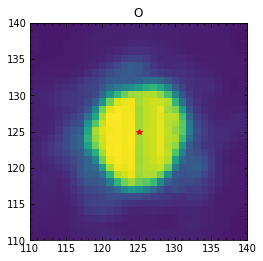

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04636.fits
bin_distcorr_lm_150104_04637.fits
7832.002601404923
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04637.fits: -0.7560886322669731, -0.6846450765558671


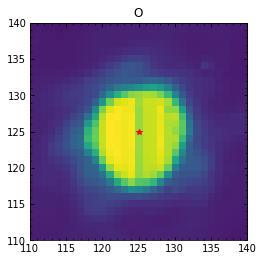

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04637.fits
bin_distcorr_lm_150104_04638.fits
7789.549478995726
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04638.fits: -0.7328608544480417, -0.614017536511966


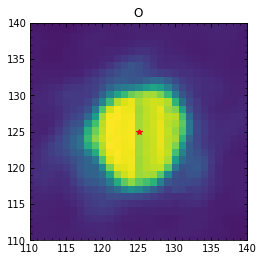

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04638.fits
bin_distcorr_lm_150104_04639.fits
7809.066137911925
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04639.fits: -0.7099842862498278, -0.6632015253709866


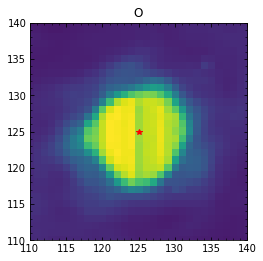

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04639.fits
bin_distcorr_lm_150104_04640.fits
7761.222787803255
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04640.fits: -0.7044031495256391, -0.6884591418843087


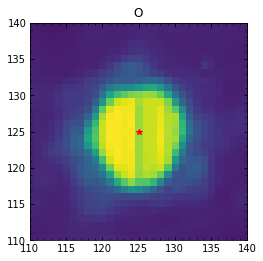

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04640.fits
bin_distcorr_lm_150104_04641.fits
7743.1541114310385
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04641.fits: -0.7184697906554263, -0.759792839083957


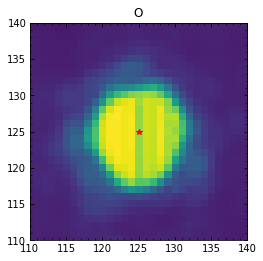

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04641.fits
bin_distcorr_lm_150104_04642.fits
7806.882252309506
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04642.fits: -0.7272868309634788, -0.6932415504390264


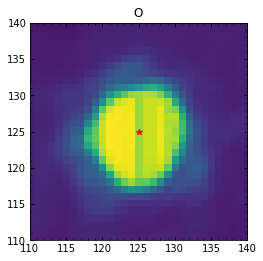

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04642.fits
bin_distcorr_lm_150104_04643.fits
7687.572672198907
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04643.fits: -0.7146448424033593, -0.6999131457725838


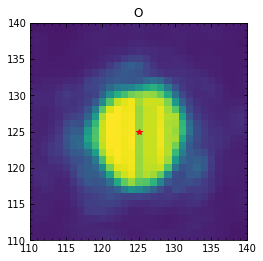

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04643.fits
bin_distcorr_lm_150104_04644.fits
7706.918752761419
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04644.fits: -0.7685941290398404, -0.713862953913079


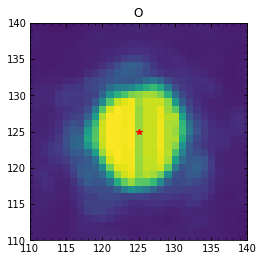

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04644.fits
bin_distcorr_lm_150104_04645.fits
7770.42863811638
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04645.fits: -0.7472377623428841, -0.7150876609062067


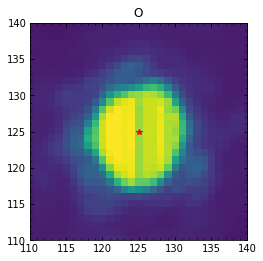

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04645.fits
bin_distcorr_lm_150104_04646.fits
7848.879516183948
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04646.fits: -0.7585916270959956, -0.7256988161305813


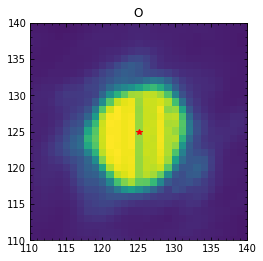

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04646.fits
bin_distcorr_lm_150104_04647.fits
7759.12091200019
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04647.fits: -0.7424385606355557, -0.7278123616344132


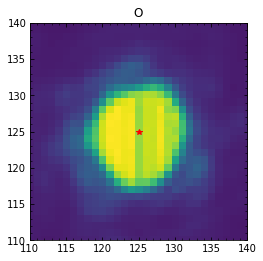

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04647.fits
bin_distcorr_lm_150104_04648.fits
7732.706089480168
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04648.fits: -0.763904870468977, -0.7077909977550405


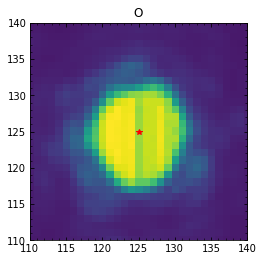

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04648.fits
bin_distcorr_lm_150104_04649.fits
7849.193791994702
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04649.fits: -0.7395949412821565, -0.7356006598981182


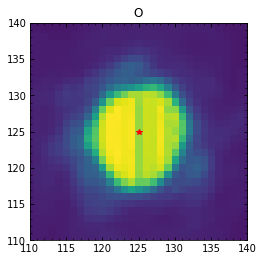

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04649.fits
bin_distcorr_lm_150104_04650.fits
7816.028059854458
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04650.fits: -0.749399125876522, -0.7343075883348504


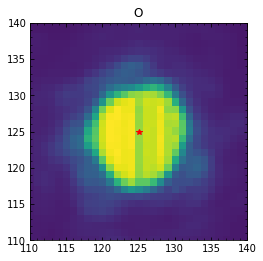

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04650.fits
bin_distcorr_lm_150104_04651.fits
7785.193120544151
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04651.fits: -0.7417333174373155, -0.7457884302546631


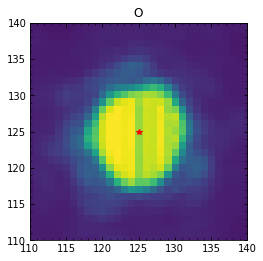

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04651.fits
bin_distcorr_lm_150104_04652.fits
7765.793410211185
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04652.fits: -0.7254766507968071, -0.7417483602708046


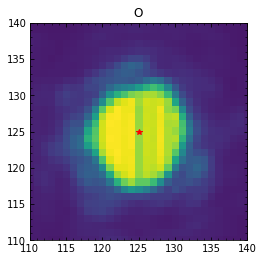

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04652.fits
bin_distcorr_lm_150104_04653.fits
7811.575769865149
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04653.fits: -0.7200485728386354, -0.7426608781923036


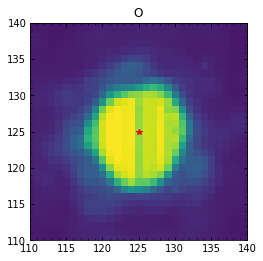

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04653.fits
bin_distcorr_lm_150104_04654.fits
7800.690289317644
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04654.fits: -0.7172559012514839, -0.737270313196646


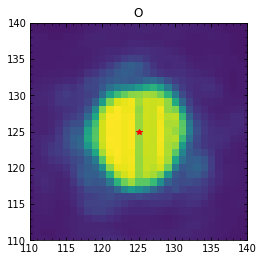

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04654.fits
bin_distcorr_lm_150104_04655.fits
7849.787814152901
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04655.fits: -0.7237468263094158, -0.7126204345687341


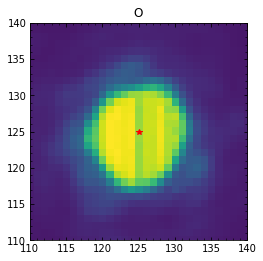

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04655.fits
bin_distcorr_lm_150104_04656.fits
7966.69137030187
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04656.fits: -0.7499312786392593, -0.7533306420066879


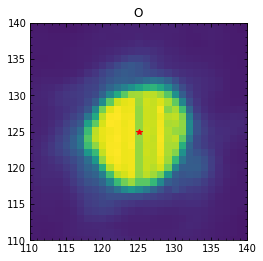

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04656.fits
bin_distcorr_lm_150104_04657.fits
7861.858872646255
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04657.fits: -0.7630536046696861, -0.7477174309074144


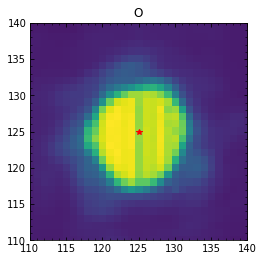

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04657.fits
bin_distcorr_lm_150104_04658.fits
7783.517688542443
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04658.fits: -0.7631906548619725, -0.725351391385729


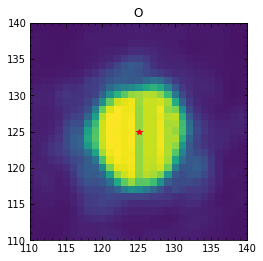

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04658.fits
bin_distcorr_lm_150104_04659.fits
7834.062105106657
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04659.fits: -0.7829093164448935, -0.7315417682951875


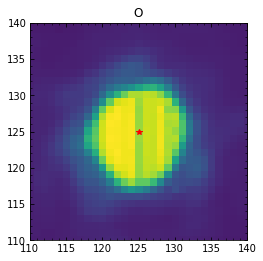

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04659.fits
bin_distcorr_lm_150104_04660.fits
7807.865533253198
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04660.fits: -0.7566171690959962, -0.7490441825593308


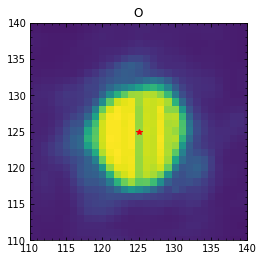

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04660.fits
bin_distcorr_lm_150104_04661.fits
7807.235700701147
STARTING  O
X: 198  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04661.fits: -0.743111383448813, 0.1890421848887911


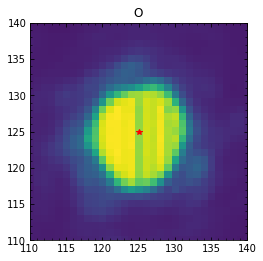

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04661.fits
bin_distcorr_lm_150104_04662.fits
7790.304627988206
STARTING  O
X: 198  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04662.fits: -0.7070058742470664, 0.1869142993032824


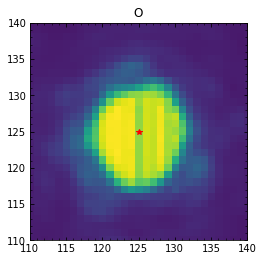

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04662.fits
bin_distcorr_lm_150104_04663.fits
7750.104868997008
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04663.fits: -0.7286042765155756, -0.7606542517320349


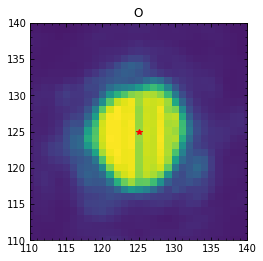

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04663.fits
bin_distcorr_lm_150104_04664.fits
7804.070038205171
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04664.fits: -0.7359792551806308, -0.7630030926929905


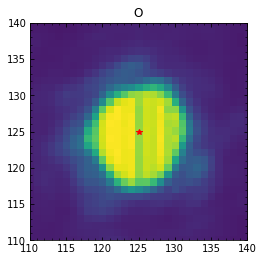

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04664.fits
bin_distcorr_lm_150104_04665.fits
7725.081948197918
STARTING  O
X: 197  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04665.fits: -0.75049229278833, -0.767552891865023


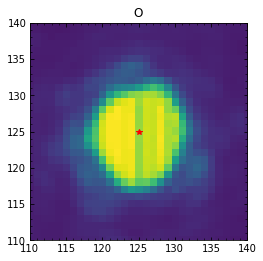

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04665.fits
bin_distcorr_lm_150104_04666.fits
7775.917387082354
STARTING  O
X: 198  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04666.fits: -0.73798534653735, 0.20651683387261244


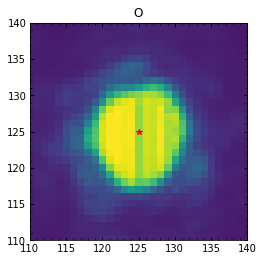

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04666.fits
bin_distcorr_lm_150104_04667.fits
7789.042570608063
STARTING  O
X: 198  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04667.fits: -0.7412785465467167, 0.21002505148351247


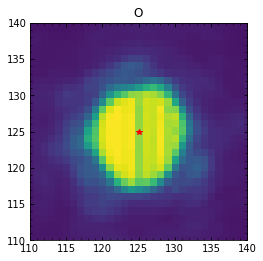

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04667.fits
bin_distcorr_lm_150104_04668.fits
7754.014674568606
STARTING  O
X: 198  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04668.fits: -0.73689804664901, 0.20678035190650235


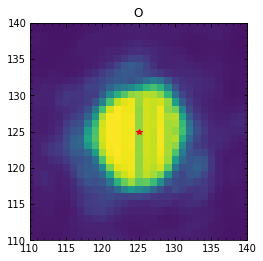

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04668.fits
bin_distcorr_lm_150104_04669.fits
7713.5312780114145
STARTING  O
X: 198  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04669.fits: -0.7433992381629437, 0.19427700365023526


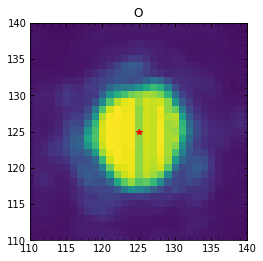

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04669.fits
bin_distcorr_lm_150104_04670.fits
7720.300783925966
STARTING  O
X: 198  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04670.fits: -0.7447905467121814, 0.17980560835638926


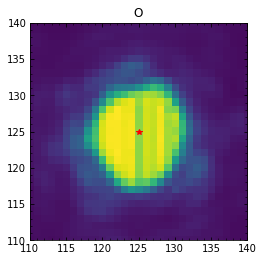

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04670.fits
bin_distcorr_lm_150104_04671.fits
7763.116373863205
STARTING  O
X: 198  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04671.fits: -0.7127946054083196, 0.17340794235197876


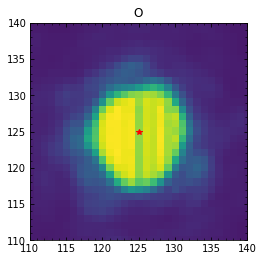

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04671.fits
bin_distcorr_lm_150104_04672.fits
7780.287164117807
STARTING  O
X: 198  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04672.fits: -0.6984170443258009, 0.15846844344183353


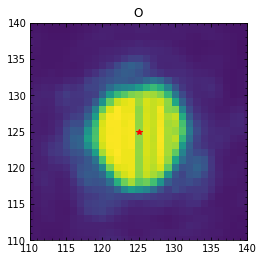

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04672.fits
bin_distcorr_lm_150104_04673.fits
7747.848827132779
STARTING  O
X: 198  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04673.fits: -0.7441279904709219, 0.17911036149970982


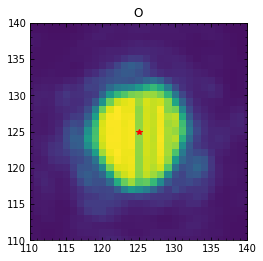

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04673.fits
bin_distcorr_lm_150104_04674.fits
7798.6506235967145
STARTING  O
X: 198  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04674.fits: -0.7178041817378897, 0.13432071834883885


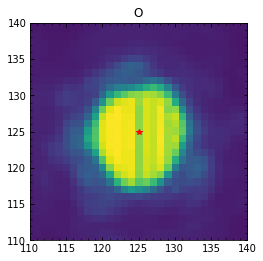

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04674.fits
bin_distcorr_lm_150104_04675.fits
7808.527747923706
STARTING  O
X: 198  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04675.fits: -0.7474663379282447, 0.16402593028072232


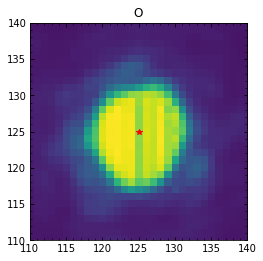

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04675.fits
bin_distcorr_lm_150104_04676.fits
7857.127773345277
STARTING  O
X: 198  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04676.fits: -0.7350826259920069, 0.1503219337824575


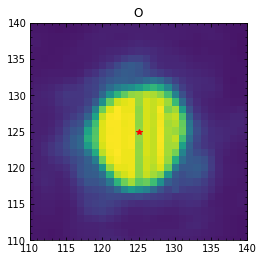

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04676.fits
bin_distcorr_lm_150104_04677.fits
7817.1588961942
STARTING  O
X: 198  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04677.fits: -0.695315538681605, 0.16356438655982686


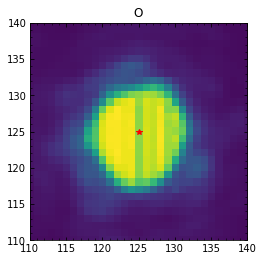

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04677.fits
bin_distcorr_lm_150104_04678.fits
7864.12611491501
STARTING  O
X: 198  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04678.fits: -0.7526946523734139, 0.17976175705516084


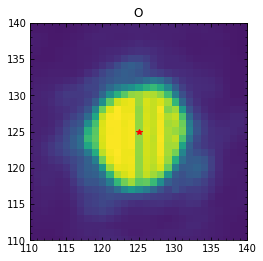

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04678.fits
bin_distcorr_lm_150104_04679.fits
7888.981813965578
STARTING  O
X: 198  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04679.fits: -0.7327635024657724, 0.14208453173594648


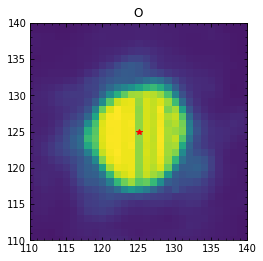

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04679.fits
bin_distcorr_lm_150104_04680.fits
7954.510200536562
STARTING  O
X: 198  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04680.fits: -0.7074087115341285, 0.15810568768164757


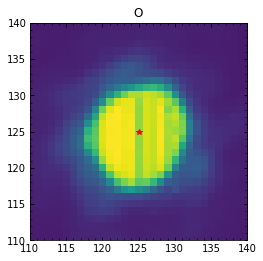

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04680.fits
bin_distcorr_lm_150104_04681.fits
7824.357446344658
STARTING  O
X: 198  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04681.fits: -0.7130138732077143, 0.1833482643267672


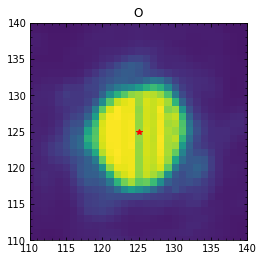

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04681.fits
bin_distcorr_lm_150104_04682.fits
7796.976384944493
STARTING  O
X: 198  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04682.fits: -0.7215690812825812, 0.16548160085475416


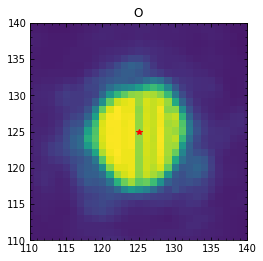

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04682.fits
bin_distcorr_lm_150104_04683.fits
7754.65888386396
STARTING  O
X: 198  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04683.fits: -0.7195851612038382, 0.16410471331887067


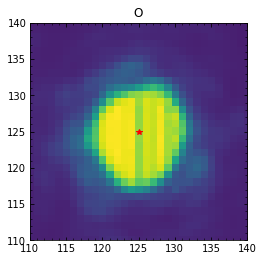

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04683.fits
bin_distcorr_lm_150104_04684.fits
7684.9667895293005
STARTING  O
X: 202  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04684.fits: -0.06444313014129222, -0.16892434216165242


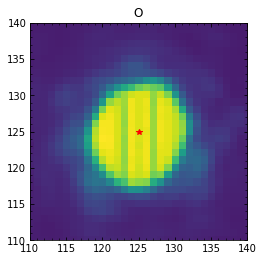

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04684.fits
bin_distcorr_lm_150104_04685.fits
7696.565725869617
STARTING  O
X: 202  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04685.fits: -0.05027875065032106, -0.18377573650806767


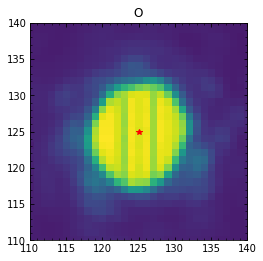

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04685.fits
bin_distcorr_lm_150104_04686.fits
7679.7918650422425
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04686.fits: -1.0026717755506027, -0.22411447397396245


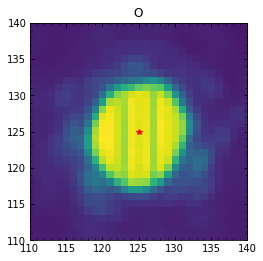

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04686.fits
bin_distcorr_lm_150104_04687.fits
7716.66700499007
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04687.fits: -1.008886680888473, -0.22319744122013674


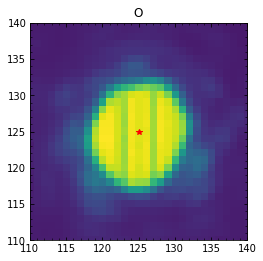

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04687.fits
bin_distcorr_lm_150104_04688.fits
7760.564537663816
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04688.fits: -1.0117022657951509, -0.19989138145658814


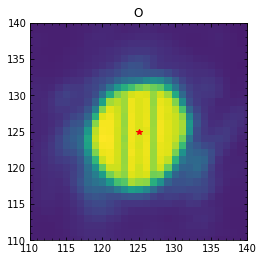

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04688.fits
bin_distcorr_lm_150104_04689.fits
7762.683689497644
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04689.fits: -0.9880478603696332, -0.24147569169095107


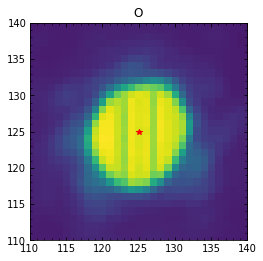

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04689.fits
bin_distcorr_lm_150104_04690.fits
7718.738141701758
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04690.fits: -1.0083627913985609, -0.21687225356873086


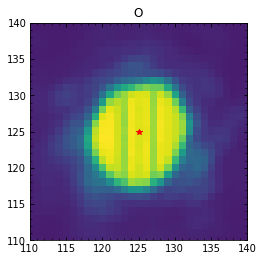

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04690.fits
bin_distcorr_lm_150104_04691.fits
7723.860908182152
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04691.fits: -1.0212322982018307, -0.26306918561737547


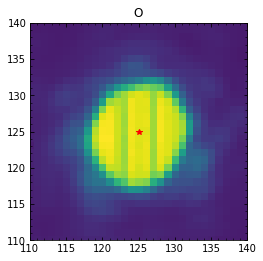

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04691.fits
bin_distcorr_lm_150104_04692.fits
7657.00827929102
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04692.fits: -0.9881901410596186, -0.2561532274427236


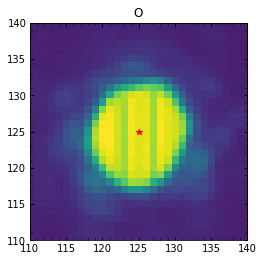

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04692.fits
bin_distcorr_lm_150104_04693.fits
7677.26955581832
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04693.fits: -0.9785172097321819, -0.25258912367769426


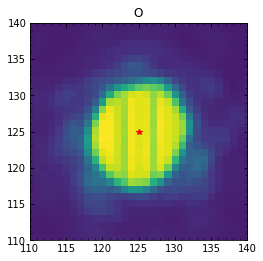

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04693.fits
bin_distcorr_lm_150104_04694.fits
7665.830219657466
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04694.fits: -0.9872434387798208, -0.23636923603786641


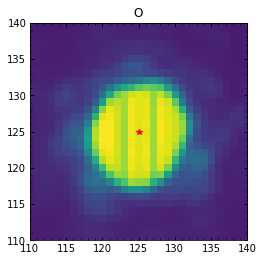

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04694.fits
bin_distcorr_lm_150104_04695.fits
7644.045581767011
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04695.fits: -0.9476589037225551, -0.23111485589124925


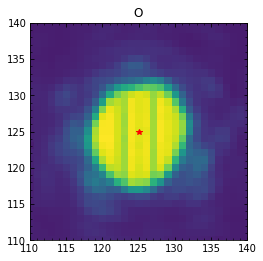

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04695.fits
bin_distcorr_lm_150104_04696.fits
7650.649526608599
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04696.fits: -0.9598343046796032, -0.24045155685657704


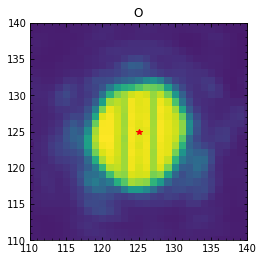

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04696.fits
bin_distcorr_lm_150104_04697.fits
7701.327796932785
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04697.fits: -0.9599579759650041, -0.20515946488856684


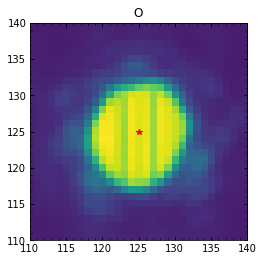

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04697.fits
bin_distcorr_lm_150104_04698.fits
7692.709460259075
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04698.fits: -0.9682984573072915, -0.17847510937437505


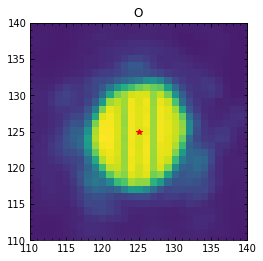

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04698.fits
bin_distcorr_lm_150104_04699.fits
7699.431074468201
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04699.fits: -0.9716978204304354, -0.18615058090477277


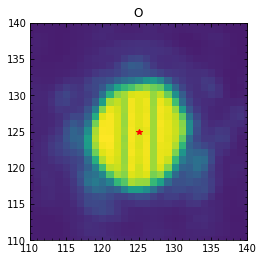

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04699.fits
bin_distcorr_lm_150104_04700.fits
7737.803753740615
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04700.fits: -1.0027370121034167, -0.20321085655000815


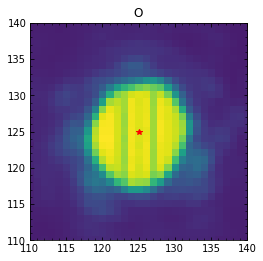

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04700.fits
bin_distcorr_lm_150104_04701.fits
7775.998168184106
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04701.fits: -1.0129656713398916, -0.22224058834051874


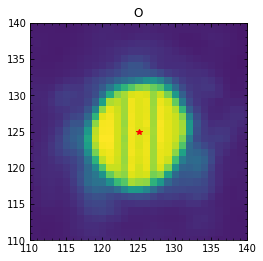

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04701.fits
bin_distcorr_lm_150104_04702.fits
7734.089273909829
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04702.fits: -0.9941353032713067, -0.24372258303885985


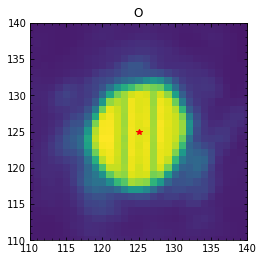

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04702.fits
bin_distcorr_lm_150104_04703.fits
7689.1828266937355
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04703.fits: -1.001426942094298, -0.20340834170886524


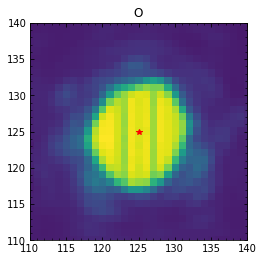

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04703.fits
bin_distcorr_lm_150104_04704.fits
7718.560227416895
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04704.fits: -0.973826851439128, -0.25421816459223123


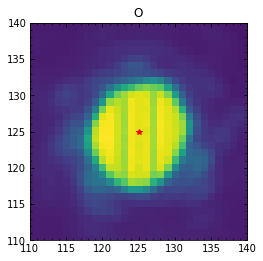

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04704.fits
bin_distcorr_lm_150104_04705.fits
7689.232025488587
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04705.fits: -0.9865827585831966, -0.267679417233154


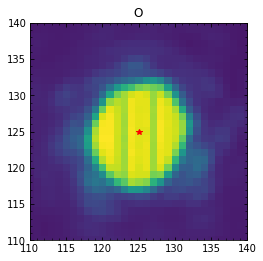

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04705.fits
bin_distcorr_lm_150104_04706.fits
7688.152677139103
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04706.fits: -1.0259164956593523, -0.24531901924520838


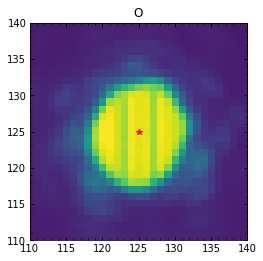

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04706.fits
bin_distcorr_lm_150104_04707.fits
7700.221126267104
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04707.fits: -1.0221403288463833, -0.23434070646293037


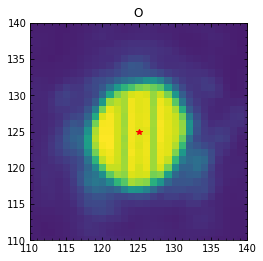

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04707.fits
bin_distcorr_lm_150104_04708.fits
7738.968611564066
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04708.fits: -0.9734809271349931, -0.23488405330404305


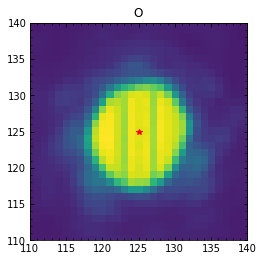

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04708.fits
bin_distcorr_lm_150104_04709.fits
7735.482650156142
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04709.fits: -0.9676071525231578, -0.2780348983565304


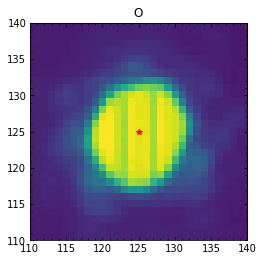

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04709.fits
bin_distcorr_lm_150104_04710.fits
7691.197952365856
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04710.fits: -0.9572635939312306, -0.2662276530773582


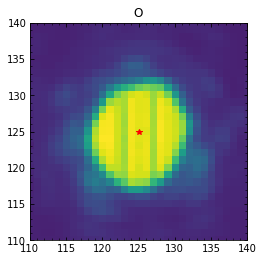

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04710.fits
bin_distcorr_lm_150104_04711.fits
7709.67690112139
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04711.fits: -0.9703386640751859, -0.30955412755961476


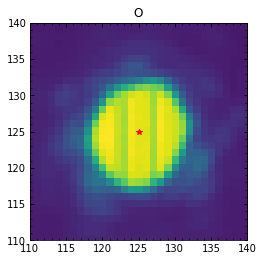

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04711.fits
bin_distcorr_lm_150104_04712.fits
7748.00346350076
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04712.fits: -0.9711976438782912, -0.31608943515379906


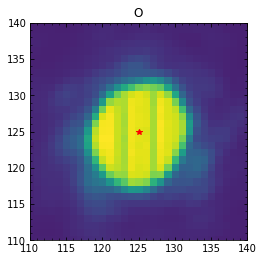

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04712.fits
bin_distcorr_lm_150104_04713.fits
7718.026541540925
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04713.fits: -0.9701141869391208, -0.2754887619890525


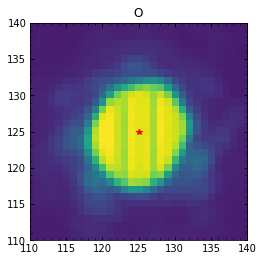

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04713.fits
bin_distcorr_lm_150104_04714.fits
7726.504185393932
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04714.fits: -0.9605145505784236, -0.3135695098857809


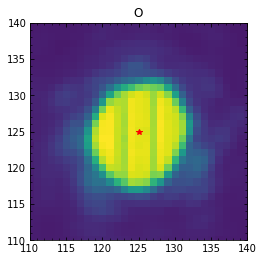

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04714.fits
bin_distcorr_lm_150104_04715.fits
7714.890357215367
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04715.fits: -0.9814258242957337, -0.30476542685275376


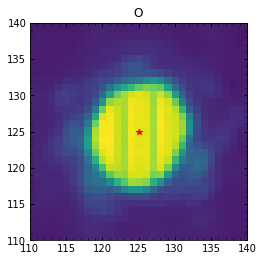

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04715.fits
bin_distcorr_lm_150104_04716.fits
7723.352718038852
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04716.fits: -0.9568579597635463, -0.3543753114290311


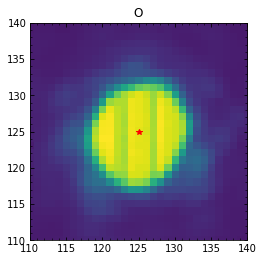

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04716.fits
bin_distcorr_lm_150104_04717.fits
7704.982715821025
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04717.fits: -0.9545922390044055, -0.2580354337518429


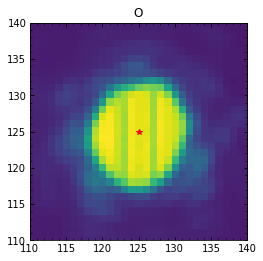

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04717.fits
bin_distcorr_lm_150104_04718.fits
7727.979759221798
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04718.fits: -0.9281430380057571, -0.3022116981176879


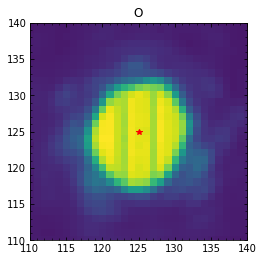

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04718.fits
bin_distcorr_lm_150104_04719.fits
7702.817279862835
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04719.fits: -0.9484566019265941, -0.32141514751407385


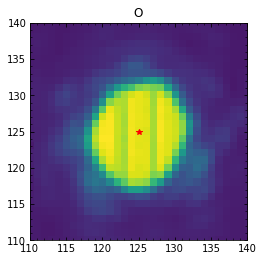

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04719.fits
bin_distcorr_lm_150104_04720.fits
7710.128803076372
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04720.fits: -0.957873318482882, -0.30298655486505766


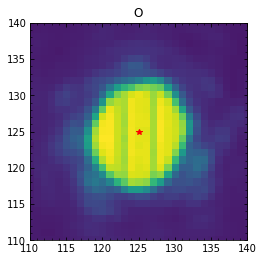

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04720.fits
bin_distcorr_lm_150104_04721.fits
7738.247141615357
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04721.fits: -0.9524488181244166, -0.33196040915672853


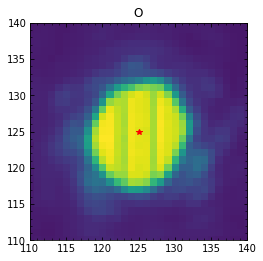

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04721.fits
bin_distcorr_lm_150104_04722.fits
7875.912823318854
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04722.fits: -0.9294663734249653, -0.3471815211491531


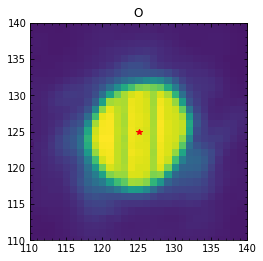

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04722.fits
bin_distcorr_lm_150104_04723.fits
7808.051911594963
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04723.fits: -0.930739075491104, -0.3132349816179243


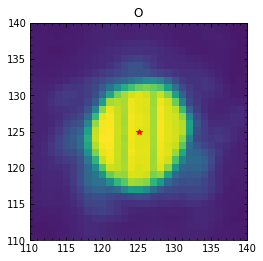

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04723.fits
bin_distcorr_lm_150104_04724.fits
7714.796285850931
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04724.fits: -0.9707882037919973, -0.5843637462446978


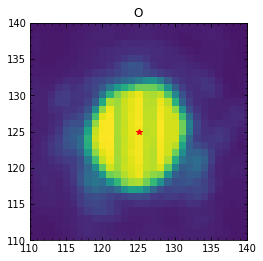

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04724.fits
bin_distcorr_lm_150104_04725.fits
7761.676806125941
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04725.fits: -0.9561312680734133, -0.3449360124484997


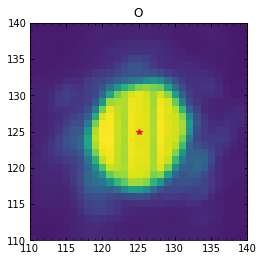

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04725.fits
bin_distcorr_lm_150104_04726.fits
7733.047257206055
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04726.fits: -0.9249906726825756, -0.3210775064816218


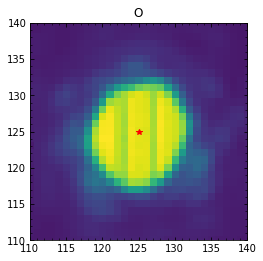

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04726.fits
bin_distcorr_lm_150104_04727.fits
7689.161455325156
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04727.fits: -0.9389276007318657, -0.3326629651457367


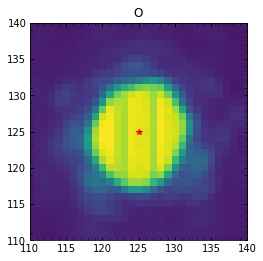

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04727.fits
bin_distcorr_lm_150104_04728.fits
7717.499781074555
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04728.fits: -1.0097540404996863, -0.5731471283298788


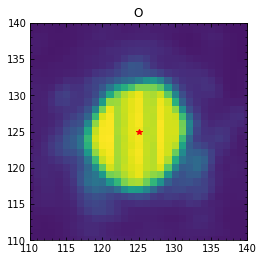

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04728.fits
bin_distcorr_lm_150104_04729.fits
7704.732332101364
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04729.fits: -0.9399426141575447, -0.3253504940235885


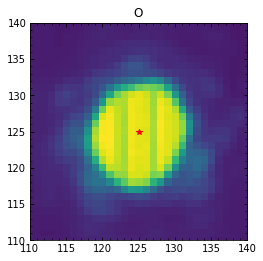

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04729.fits
bin_distcorr_lm_150104_04730.fits
7684.296157701212
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04730.fits: -1.0038760081226457, -0.6008524748420498


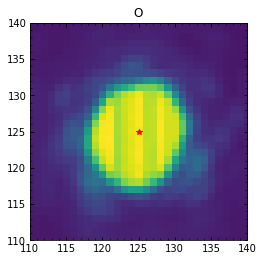

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04730.fits
bin_distcorr_lm_150104_04731.fits
7672.581485126597
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04731.fits: -1.0055893489048202, -0.6001152962162806


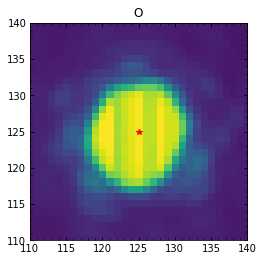

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04731.fits
bin_distcorr_lm_150104_04732.fits
7681.149880877353
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04732.fits: -0.9515121460016331, -0.3398675916513483


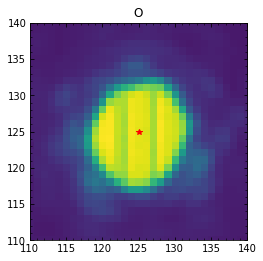

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04732.fits
bin_distcorr_lm_150104_04733.fits
7688.699847279051
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04733.fits: -0.9094684177129579, -0.34515899546514817


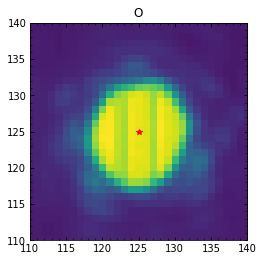

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04733.fits
bin_distcorr_lm_150104_04734.fits
7796.871719242948
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04734.fits: -0.9760706487261288, -0.5962393978612397


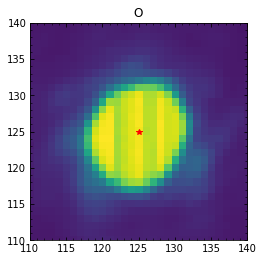

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04734.fits
bin_distcorr_lm_150104_04735.fits
7784.080673178252
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04735.fits: -0.9888164487140045, -0.580249134293382


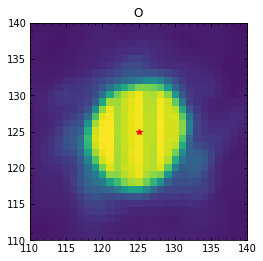

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04735.fits
bin_distcorr_lm_150104_04736.fits
7747.11172628662
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04736.fits: -1.0135202151919884, -0.6161129541329586


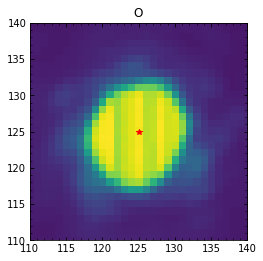

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04736.fits
bin_distcorr_lm_150104_04737.fits
7670.759668873548
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04737.fits: -0.9844249902278008, -0.6290068552761809


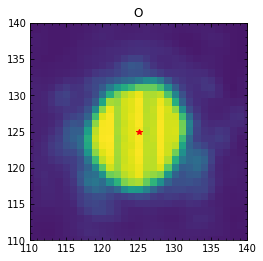

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04737.fits
bin_distcorr_lm_150104_04738.fits
7691.644920843473
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04738.fits: -0.9797406286469084, -0.6293864871638135


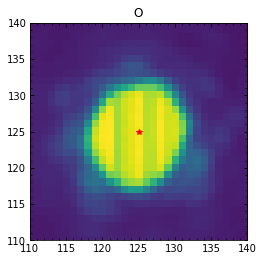

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04738.fits
bin_distcorr_lm_150104_04739.fits
7691.444088899552
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04739.fits: -0.9667930681196921, -0.6120046308492064


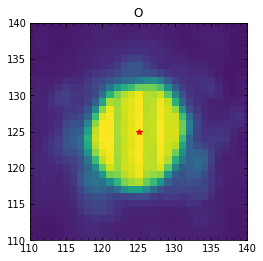

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04739.fits
bin_distcorr_lm_150104_04740.fits
7668.819068794231
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04740.fits: -0.9489172174075051, -0.6380484384884753


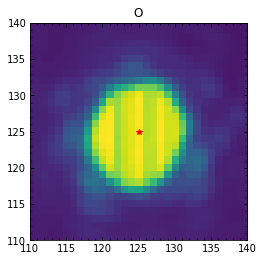

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04740.fits
bin_distcorr_lm_150104_04741.fits
7755.813542442058
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04741.fits: -0.9527788034478277, -0.6458354667825859


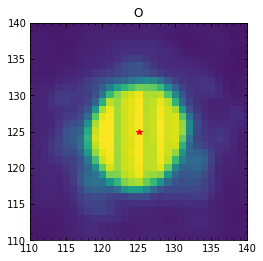

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04741.fits
bin_distcorr_lm_150104_04742.fits
7701.5745741324245
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04742.fits: -0.9716682154034331, -0.6529517183108737


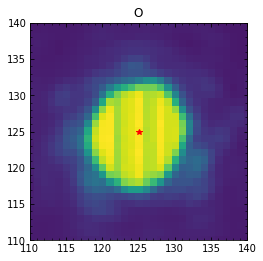

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04742.fits
bin_distcorr_lm_150104_04743.fits
7703.284568904019
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04743.fits: -0.9545097792777355, -0.6609980254275882


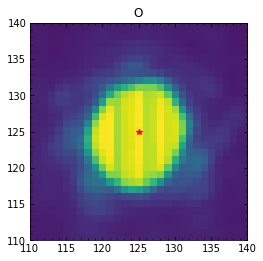

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04743.fits
bin_distcorr_lm_150104_04744.fits
7659.37283586816
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04744.fits: -0.9596327442046757, -0.66555437738009


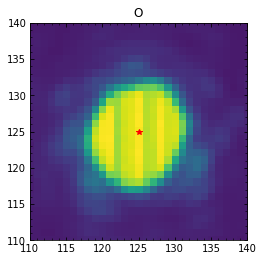

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04744.fits
bin_distcorr_lm_150104_04745.fits
7669.100615377671
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04745.fits: -0.9428967037401179, -0.648849941639206


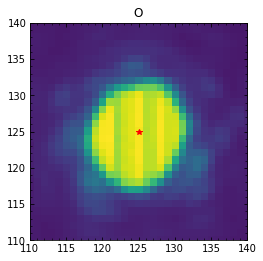

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04745.fits
bin_distcorr_lm_150104_04746.fits
7677.664010079657
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04746.fits: -0.9532108019516485, -0.6681963061982046


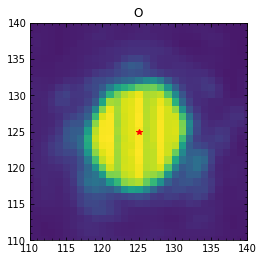

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04746.fits
bin_distcorr_lm_150104_04747.fits
7665.085243489309
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04747.fits: -0.9414295398757844, -0.6338938013279929


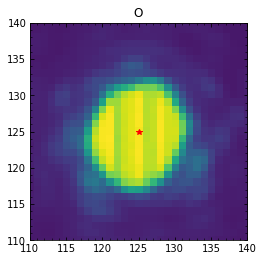

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04747.fits
bin_distcorr_lm_150104_04748.fits
7671.131804307874
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04748.fits: -0.9373692241140077, -0.6416829268856148


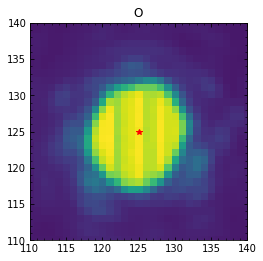

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04748.fits
bin_distcorr_lm_150104_04749.fits
7696.473532768345
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04749.fits: -0.900841367240524, -0.6492986098917157


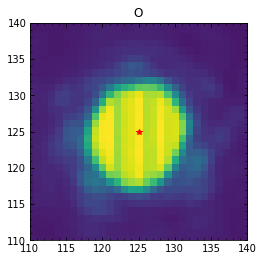

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04749.fits
bin_distcorr_lm_150104_04750.fits
7712.484792745451
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04750.fits: -0.9206577666190725, -0.645318651284029


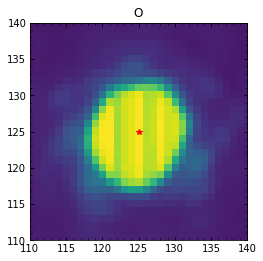

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04750.fits
bin_distcorr_lm_150104_04751.fits
7705.239193755904
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04751.fits: -0.9492906481857517, -0.6483460426103491


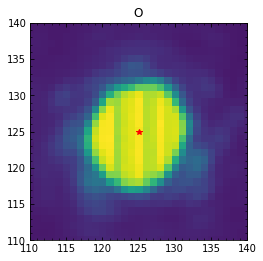

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04751.fits
bin_distcorr_lm_150104_04752.fits
7688.9737772363205
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04752.fits: -0.9603127532209257, -0.6561024842385166


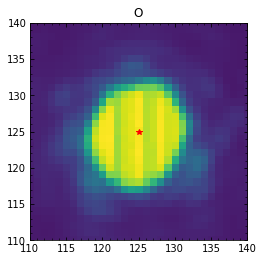

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04752.fits
bin_distcorr_lm_150104_04753.fits
7717.116070632746
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04753.fits: -0.9293555360644206, -0.6542958567793988


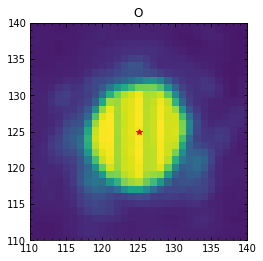

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04753.fits
bin_distcorr_lm_150104_04754.fits
7656.77787625849
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04754.fits: -0.9123805559061395, -0.6563486236610743


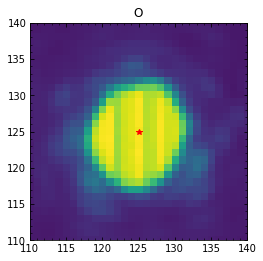

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04754.fits
bin_distcorr_lm_150104_04755.fits
7688.197508222938
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04755.fits: -0.8878870985641356, -0.654001340828799


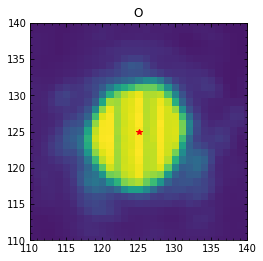

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04755.fits
bin_distcorr_lm_150104_04756.fits
7661.545355885509
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04756.fits: -0.909094284897499, -0.685641863330126


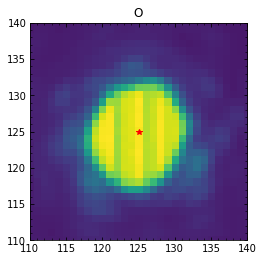

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04756.fits
bin_distcorr_lm_150104_04757.fits
7644.370150553445
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04757.fits: -0.9407581643441034, -0.6589840445212332


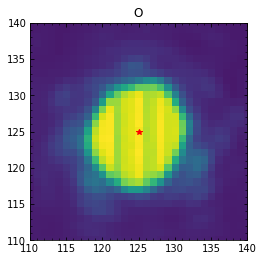

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04757.fits
bin_distcorr_lm_150104_04758.fits
7647.00405139798
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04758.fits: -0.9087961961761053, -0.7071553923114422


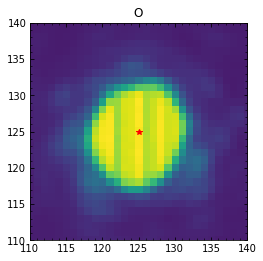

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04758.fits
bin_distcorr_lm_150104_04759.fits
7683.181967339537
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04759.fits: -0.911810987775965, -0.7020548088294092


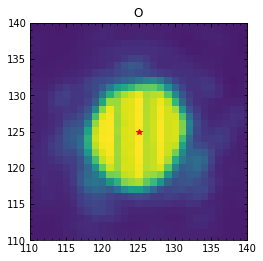

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04759.fits
bin_distcorr_lm_150104_04760.fits
7720.013308816369
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04760.fits: -0.9163668209452993, -0.693736574540786


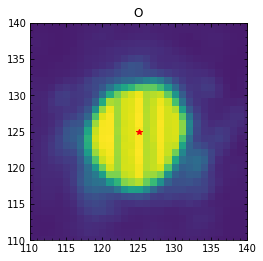

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04760.fits
bin_distcorr_lm_150104_04761.fits
7729.244939128309
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04761.fits: -0.9275617905767817, -0.7214431104959402


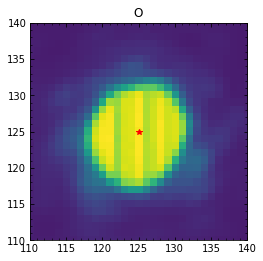

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04761.fits
bin_distcorr_lm_150104_04762.fits
7656.317625130355
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04762.fits: -0.9324486521382696, -0.7352083461261216


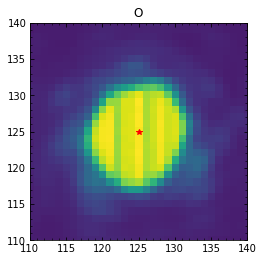

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04762.fits
bin_distcorr_lm_150104_04763.fits
7654.043285664729
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04763.fits: -0.8924895330206155, -0.7114670290745053


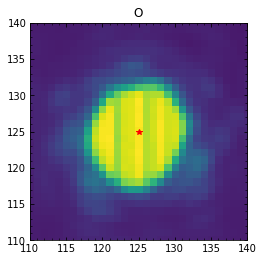

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04763.fits
bin_distcorr_lm_150104_04764.fits
7660.996831283499
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04764.fits: -0.8650996413128027, -0.7122912845062146


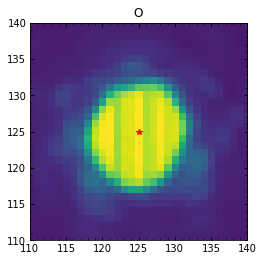

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04764.fits
bin_distcorr_lm_150104_04765.fits
7598.57370497365
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04765.fits: -0.9040104682222179, -0.7324778668042313


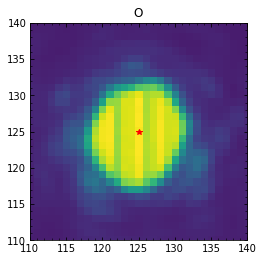

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04765.fits
bin_distcorr_lm_150104_04766.fits
7596.504996843155
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04766.fits: -0.94664911371855, -0.7169492589714395


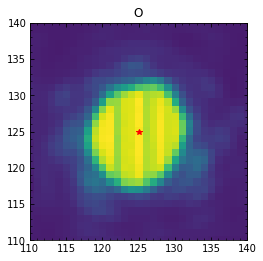

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04766.fits
bin_distcorr_lm_150104_04767.fits
7662.519249827188
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04767.fits: -0.9715187440267314, -0.6914123776867029


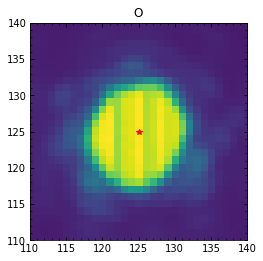

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04767.fits
bin_distcorr_lm_150104_04768.fits
7610.36390997321
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04768.fits: -0.8814910717390774, -0.7317454933932197


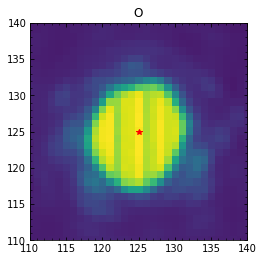

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04768.fits
bin_distcorr_lm_150104_04769.fits
7584.616101878316
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04769.fits: -0.9329324586917167, -0.771018328066063


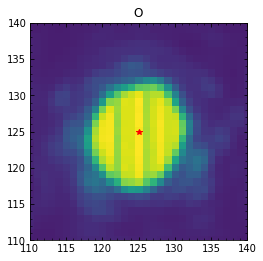

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04769.fits
bin_distcorr_lm_150104_04770.fits
7658.361758152815
STARTING  O
X: 203  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04770.fits: -0.8588441149572077, 0.21500583206969992


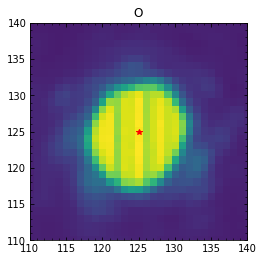

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04770.fits
bin_distcorr_lm_150104_04771.fits
7753.356260015362
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04771.fits: -0.8949720613711705, -0.7358623925712351


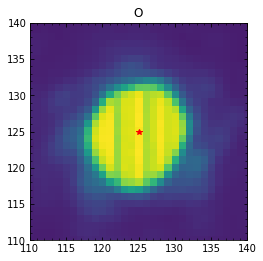

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04771.fits
bin_distcorr_lm_150104_04772.fits
7705.954614134305
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04772.fits: -0.9316618392621336, -0.7593734282176356


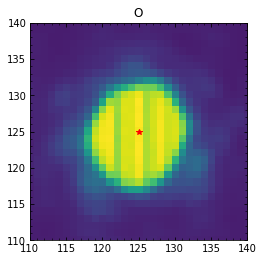

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04772.fits
bin_distcorr_lm_150104_04773.fits
7655.1457181907235
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04773.fits: -0.9116231339375531, -0.75187606609569


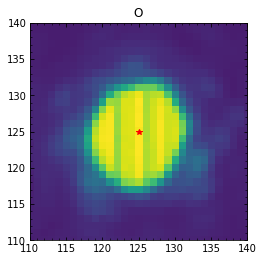

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04773.fits
bin_distcorr_lm_150104_04774.fits
7626.908740583106
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04774.fits: -0.9137646420360497, -0.7589275462035161


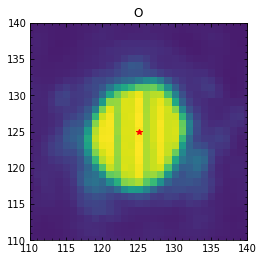

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04774.fits
bin_distcorr_lm_150104_04775.fits
7631.7872133298415
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04775.fits: -0.9067204122660115, -0.727945859818


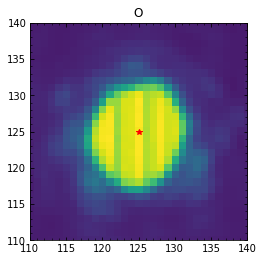

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04775.fits
bin_distcorr_lm_150104_04776.fits
7645.523736454335
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04776.fits: -0.9223929744786545, -0.7578580953859984


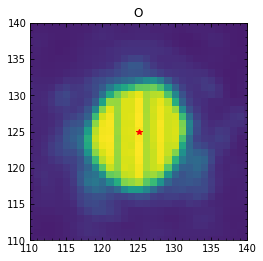

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04776.fits
bin_distcorr_lm_150104_04777.fits
7665.569068816917
STARTING  O
X: 203  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04777.fits: -0.9107842588849593, 0.21264167830904057


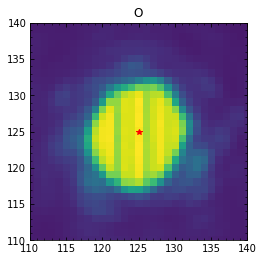

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04777.fits
bin_distcorr_lm_150104_04778.fits
7745.991023550778
STARTING  O
X: 203  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04778.fits: -0.9228790663462618, 0.16900402440577977


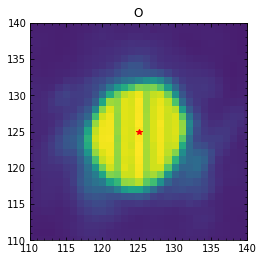

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04778.fits
bin_distcorr_lm_150104_04779.fits
7696.313855613846
STARTING  O
X: 203  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04779.fits: -0.8818516966377672, 0.21630016438000865


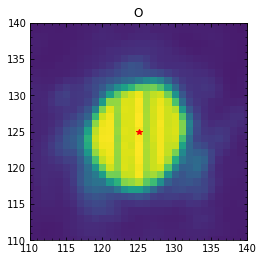

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04779.fits
bin_distcorr_lm_150104_04780.fits
7678.902821153057
STARTING  O
X: 202  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04780.fits: -0.9114227840537055, -0.7702829303188992


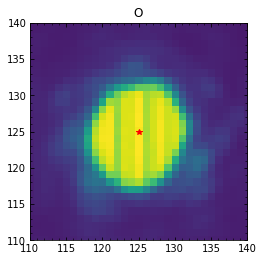

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04780.fits
bin_distcorr_lm_150104_04781.fits
7663.248237206766
STARTING  O
X: 203  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04781.fits: -0.8866155314236508, 0.17532506973212492


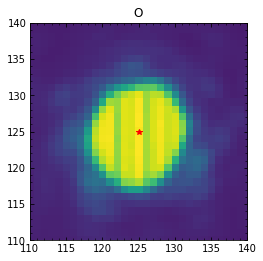

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04781.fits
bin_distcorr_lm_150104_04782.fits
7718.252442719989
STARTING  O
X: 203  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04782.fits: -0.8794989677528164, 0.18532642800119703


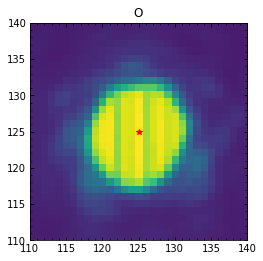

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04782.fits
bin_distcorr_lm_150104_04783.fits
7671.844998570878
STARTING  O
X: 203  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04783.fits: -0.8711319780431737, 0.18641411212937697


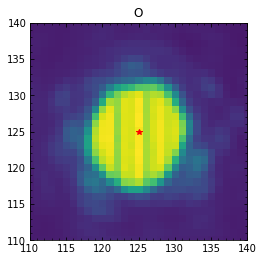

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04783.fits
bin_distcorr_lm_150104_04784.fits
7673.175734497336
STARTING  O
X: 203  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04784.fits: -0.8627485855196184, 0.1976276843406879


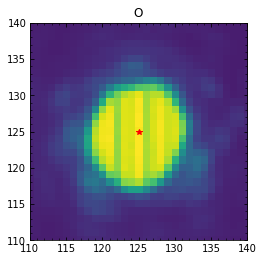

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04784.fits
bin_distcorr_lm_150104_04785.fits
7665.264129615171
STARTING  O
X: 203  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04785.fits: -0.8625230588823172, 0.15278606498826974


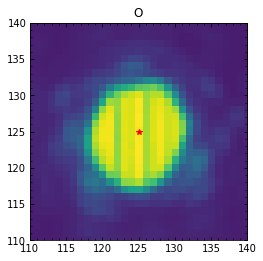

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04785.fits
bin_distcorr_lm_150104_04786.fits
7666.240389216013
STARTING  O
X: 203  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04786.fits: -0.8684106122547277, 0.12170906597791742


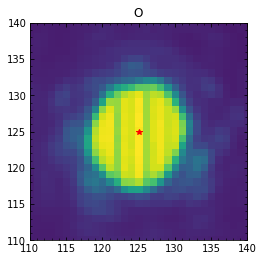

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04786.fits
bin_distcorr_lm_150104_04787.fits
7692.37308198041
STARTING  O
X: 203  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04787.fits: -0.8571950290499899, 0.09651357320651499


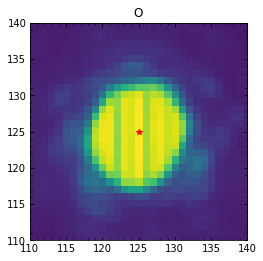

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04787.fits
bin_distcorr_lm_150104_04788.fits
7677.757599099485
STARTING  O
X: 203  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04788.fits: -0.8645214775945362, 0.094041823341108


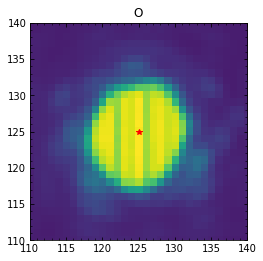

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04788.fits
bin_distcorr_lm_150104_04789.fits
7652.118355666379
STARTING  O
X: 203  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04789.fits: -0.838877205640479, 0.09609775237226614


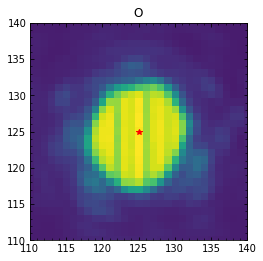

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04789.fits
bin_distcorr_lm_150104_04790.fits
7641.050180988452
STARTING  O
X: 203  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04790.fits: -0.8319378698125561, 0.12181183688561958


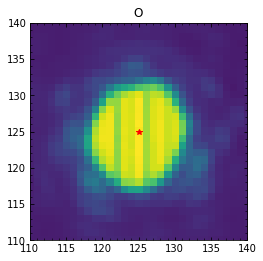

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04790.fits
bin_distcorr_lm_150104_04791.fits
7666.986157110748
STARTING  O
X: 203  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04791.fits: -0.8166837582704574, 0.1084548406558028


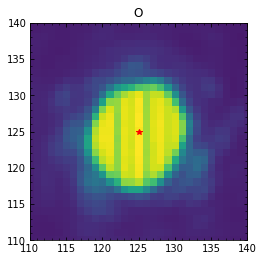

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04791.fits
bin_distcorr_lm_150104_04792.fits
7696.335642147632
STARTING  O
X: 203  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04792.fits: -0.8464594430566521, 0.10120097495635605


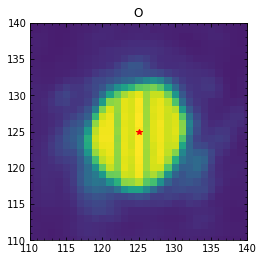

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04792.fits
bin_distcorr_lm_150104_04793.fits
7681.600865246439
STARTING  O
X: 203  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04793.fits: -0.8510369918894938, 0.10360904726945108


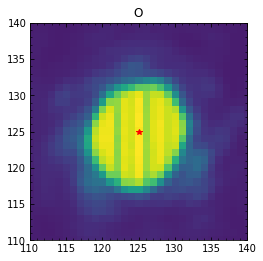

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04793.fits
bin_distcorr_lm_150104_04794.fits
7849.986508971511
STARTING  O
X: 203  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04794.fits: -0.8654708900090213, 0.07713348639370565


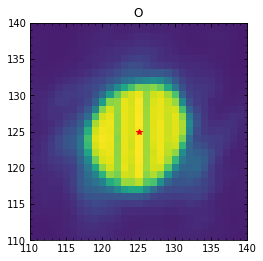

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04794.fits
bin_distcorr_lm_150104_04795.fits
7715.310125389705
STARTING  O
X: 203  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04795.fits: -0.8482330153486188, 0.12466586777247102


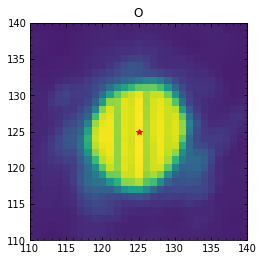

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04795.fits
bin_distcorr_lm_150104_04796.fits
7647.682140498423
STARTING  O
X: 203  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04796.fits: -0.8282637648126183, 0.091482263475271


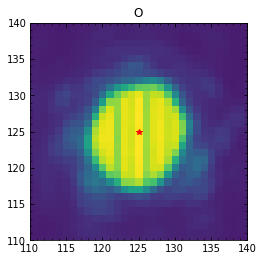

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04796.fits
bin_distcorr_lm_150104_04797.fits
7640.523775555235
STARTING  O
X: 203  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04797.fits: -0.8374578634291154, 0.06930128509042532


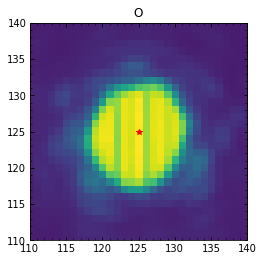

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04797.fits
bin_distcorr_lm_150104_04798.fits
7608.1634527628
STARTING  O
X: 203  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04798.fits: -0.8498383439534365, 0.08769938474731731


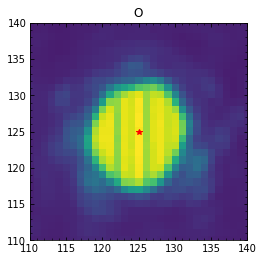

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04798.fits
bin_distcorr_lm_150104_04799.fits
7616.590811708446
STARTING  O
X: 203  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04799.fits: -0.81200600674903, 0.05323725348885233


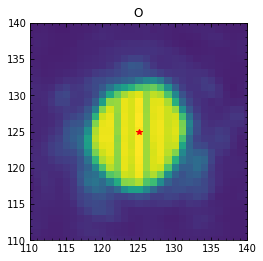

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04799.fits
bin_distcorr_lm_150104_04800.fits
7615.553159096129
STARTING  O
X: 203  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04800.fits: -0.8473382682389925, 0.08366138408685231


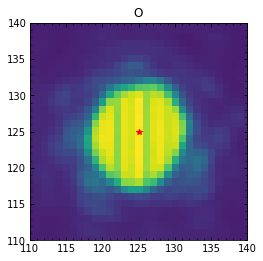

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04800.fits
bin_distcorr_lm_150104_04801.fits
7657.173902565123
STARTING  O
X: 203  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04801.fits: -0.8068724437860908, 0.04355686361486022


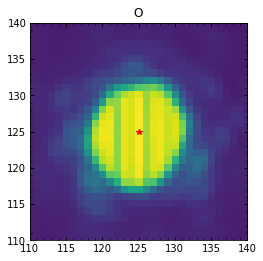

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04801.fits
bin_distcorr_lm_150104_04802.fits
7646.3792084274655
STARTING  O
X: 203  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04802.fits: -0.84534818456126, 0.03754520561578545


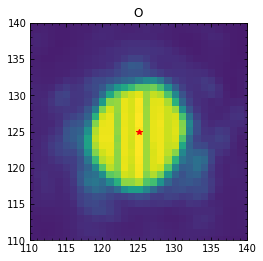

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04802.fits
bin_distcorr_lm_150104_04803.fits
7629.547690269246
STARTING  O
X: 203  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_04803.fits: -0.8262648499149492, 0.09016745659452141


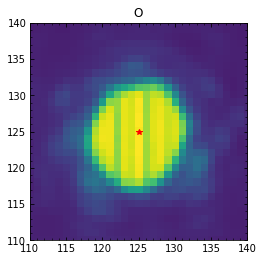

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/AB-Aur/Kshort/single_V2/Final_lm_150104_04803.fits
bin_distcorr_lm_150104_02884.fits
8061.6099129017375
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02884.fits: -0.9717192232399938, -0.7601268258333818


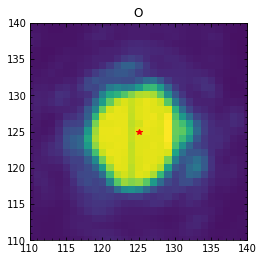

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02884.fits
bin_distcorr_lm_150104_02885.fits
8079.371776266577
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02885.fits: -0.9662981633422376, -0.7484102136091764


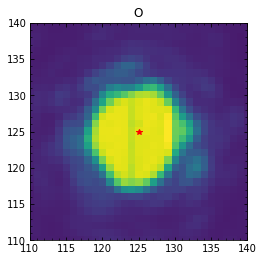

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02885.fits
bin_distcorr_lm_150104_02886.fits
8019.298895854073
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02886.fits: -0.9890208128455313, -0.7427710492233714


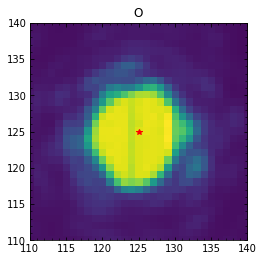

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02886.fits
bin_distcorr_lm_150104_02887.fits
8041.9561251413415
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02887.fits: -0.9955183832296797, -0.7512341643473022


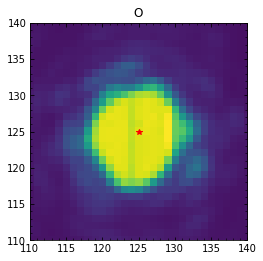

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02887.fits
bin_distcorr_lm_150104_02888.fits
8030.820476607267
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02888.fits: -1.0086879982320909, -0.7600020774184131


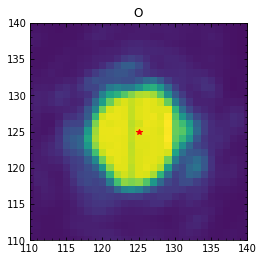

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02888.fits
bin_distcorr_lm_150104_02889.fits
8066.753886815539
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02889.fits: -1.0292159317822183, -0.7738245371991042


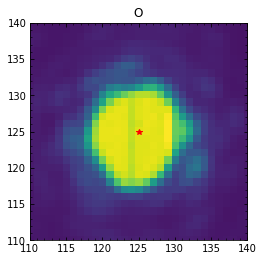

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02889.fits
bin_distcorr_lm_150104_02890.fits
8006.606836378582
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02890.fits: -1.020131234770055, -0.7732898308820353


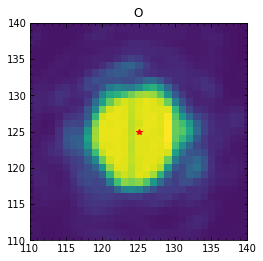

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02890.fits
bin_distcorr_lm_150104_02891.fits
7968.627911497728
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02891.fits: -1.035641953185774, -0.7557074373736015


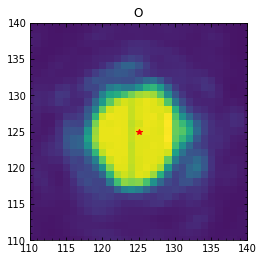

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02891.fits
bin_distcorr_lm_150104_02892.fits
7987.696851362164
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02892.fits: -1.0247257319376288, -0.7594381013242497


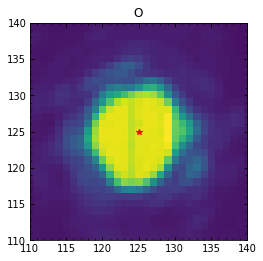

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02892.fits
bin_distcorr_lm_150104_02893.fits
8014.467779882079
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02893.fits: -0.992259213075684, -0.7490573300729793


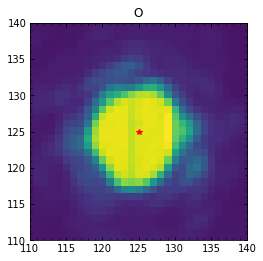

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02893.fits
bin_distcorr_lm_150104_02894.fits
7982.859166836224
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02894.fits: -1.0526072343249808, -0.7679983665454273


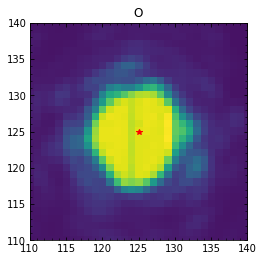

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02894.fits
bin_distcorr_lm_150104_02895.fits
8008.148976295608
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02895.fits: -0.9765418513408619, -0.770783409769507


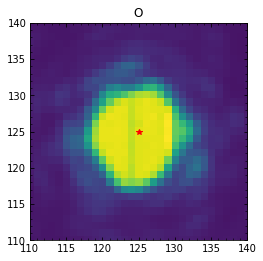

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02895.fits
bin_distcorr_lm_150104_02896.fits
8066.642551071083
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02896.fits: -0.9668480232309093, -0.748710466967772


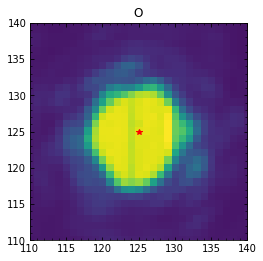

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02896.fits
bin_distcorr_lm_150104_02897.fits
8063.911672982815
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02897.fits: -0.9673297482223049, -0.7536425999851701


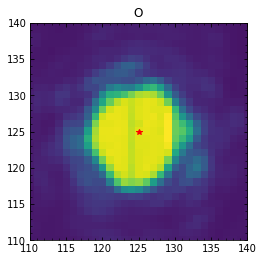

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02897.fits
bin_distcorr_lm_150104_02898.fits
8052.464305256857
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02898.fits: -0.9686073661228605, -0.7610548609836556


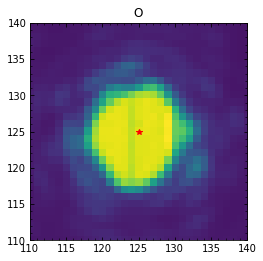

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02898.fits
bin_distcorr_lm_150104_02899.fits
8061.09679555093
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02899.fits: -0.9970036834724212, -0.7512687280037085


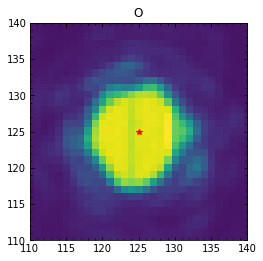

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02899.fits
bin_distcorr_lm_150104_02900.fits
8077.460646377258
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02900.fits: -0.9596376450161657, -0.745162323247996


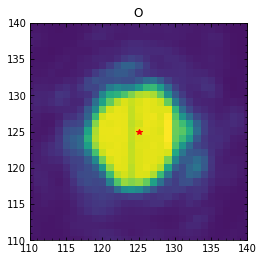

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02900.fits
bin_distcorr_lm_150104_02901.fits
8078.114410107755
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02901.fits: -0.9989766948812004, -0.7153250719384943


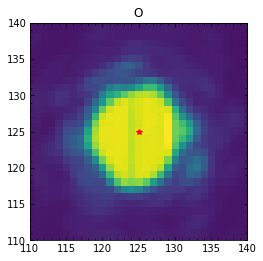

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02901.fits
bin_distcorr_lm_150104_02902.fits
8062.783053702465
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02902.fits: -0.9979982929728379, -0.7400181811413091


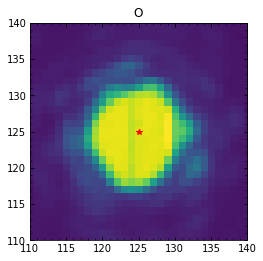

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02902.fits
bin_distcorr_lm_150104_02903.fits
8072.964253342813
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02903.fits: -0.9858948048343166, -0.7435403727179803


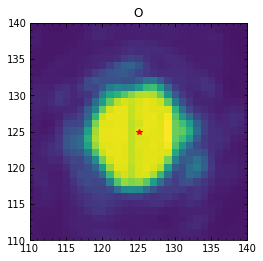

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02903.fits
bin_distcorr_lm_150104_02904.fits
8114.427452580929
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02904.fits: -0.9706131100157478, -0.7486540917828748


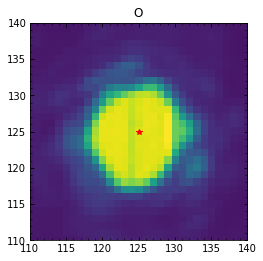

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02904.fits
bin_distcorr_lm_150104_02905.fits
8096.366960486845
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02905.fits: -0.9652007689370024, -0.7457869426640755


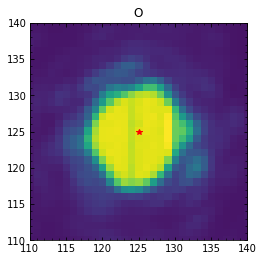

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02905.fits
bin_distcorr_lm_150104_02906.fits
8036.455650004977
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02906.fits: -0.9980908243089672, -0.7282350118365599


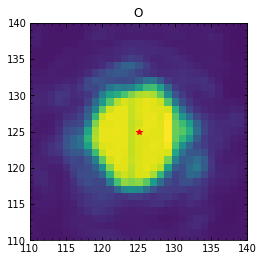

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02906.fits
bin_distcorr_lm_150104_02907.fits
8046.92450200202
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02907.fits: -0.9863612851231736, -0.7461779810638944


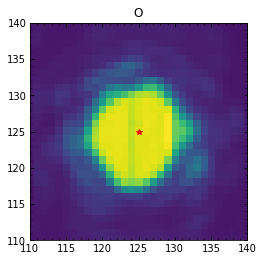

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02907.fits
bin_distcorr_lm_150104_02908.fits
8038.9010263935015
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02908.fits: -1.010983679965669, -0.6990209304076132


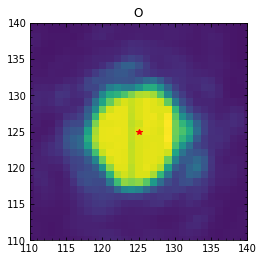

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02908.fits
bin_distcorr_lm_150104_02909.fits
8050.5286912580505
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02909.fits: -1.0317804124612735, -0.7152362952482392


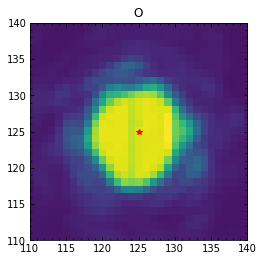

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02909.fits
bin_distcorr_lm_150104_02910.fits
8025.488564239615
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02910.fits: -0.997200986987103, -0.7312092506509202


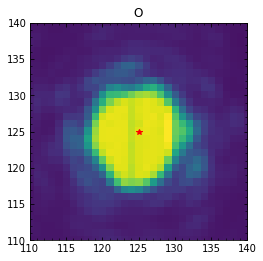

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02910.fits
bin_distcorr_lm_150104_02911.fits
8051.760137332001
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02911.fits: -1.0206001912792786, -0.7502470939010237


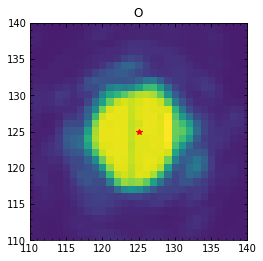

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02911.fits
bin_distcorr_lm_150104_02912.fits
8068.942639325135
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02912.fits: -1.0327608910480492, -0.7468442016000054


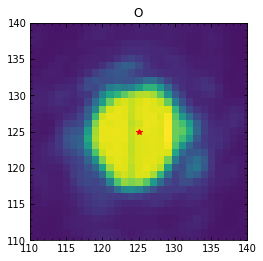

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02912.fits
bin_distcorr_lm_150104_02913.fits
8081.103497774456
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02913.fits: -1.0048655933509494, -0.7364966156432402


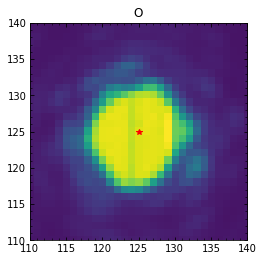

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02913.fits
bin_distcorr_lm_150104_02914.fits
8082.504400505851
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02914.fits: -0.9916861254071279, -0.738905930940362


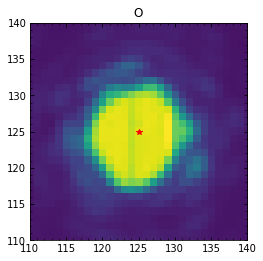

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02914.fits
bin_distcorr_lm_150104_02915.fits
8093.693849564484
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02915.fits: -1.0149334694841627, -0.7403832693680243


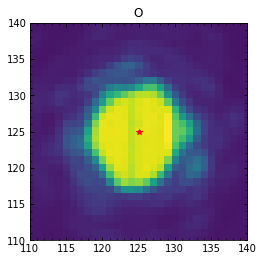

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02915.fits
bin_distcorr_lm_150104_02916.fits
8103.3170348535095
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02916.fits: -1.01726224550832, -0.7383445750591946


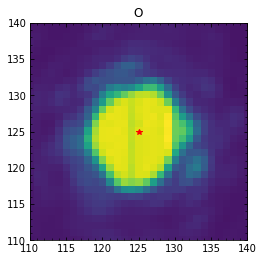

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02916.fits
bin_distcorr_lm_150104_02917.fits
8077.795789374373
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02917.fits: -1.0307469921708474, -0.7322116994481789


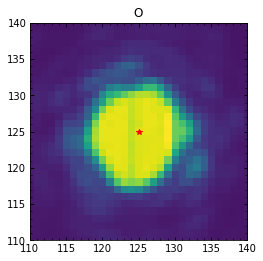

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02917.fits
bin_distcorr_lm_150104_02918.fits
8076.127186124551
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02918.fits: -0.9971604674687882, -0.7394053999923358


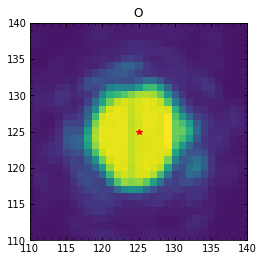

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02918.fits
bin_distcorr_lm_150104_02919.fits
8072.900086354642
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02919.fits: -1.0254859531018496, -0.7423029698270156


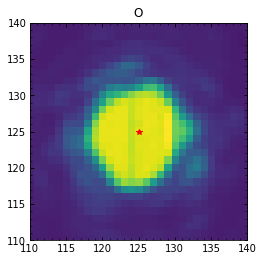

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02919.fits
bin_distcorr_lm_150104_02920.fits
8060.126724744823
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02920.fits: -1.0237239503470548, -0.7258055523402902


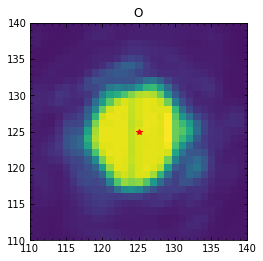

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02920.fits
bin_distcorr_lm_150104_02921.fits
8058.770233524407
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02921.fits: -1.0428482871326992, -0.7476950776293663


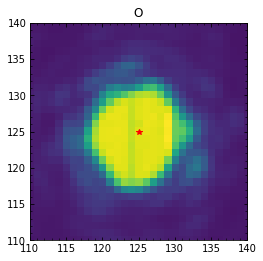

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02921.fits
bin_distcorr_lm_150104_02922.fits
8058.174336930445
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02922.fits: -1.019689864120103, -0.7522055736417883


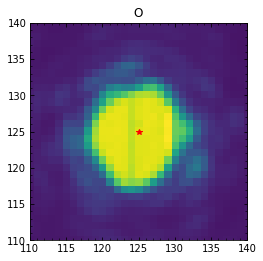

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02922.fits
bin_distcorr_lm_150104_02923.fits
8051.456567355852
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02923.fits: -1.0212794075874143, -0.7276682974869146


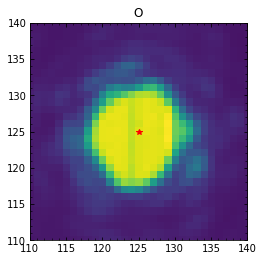

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02923.fits
bin_distcorr_lm_150104_02924.fits
8092.527487472811
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02924.fits: -1.0118483646566787, -0.7479582113429117


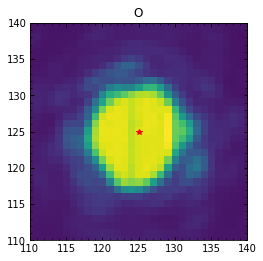

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02924.fits
bin_distcorr_lm_150104_02925.fits
8082.1669607259955
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02925.fits: -0.9808395568897765, -0.7205620299836113


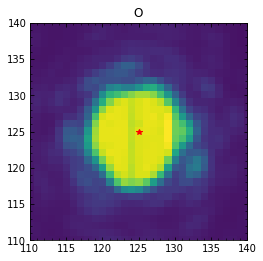

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02925.fits
bin_distcorr_lm_150104_02926.fits
8065.94413890358
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02926.fits: -1.0262050657738442, -0.7446656704785894


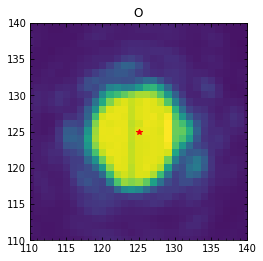

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02926.fits
bin_distcorr_lm_150104_02927.fits
8102.965485414312
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02927.fits: -1.0431194068381942, -0.7395295382098794


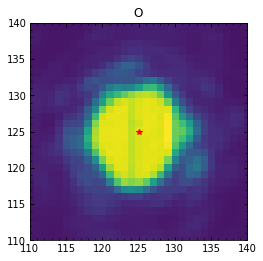

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02927.fits
bin_distcorr_lm_150104_02928.fits
8088.421024749539
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02928.fits: -1.0147479932957637, -0.7586447709102302


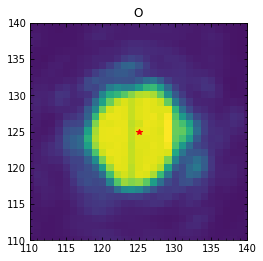

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02928.fits
bin_distcorr_lm_150104_02929.fits
8091.574284224138
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02929.fits: -1.0499255905132685, -0.7480955373368943


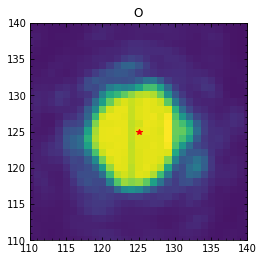

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02929.fits
bin_distcorr_lm_150104_02930.fits
8108.124982521965
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02930.fits: -1.06371425112674, -0.7414801292715012


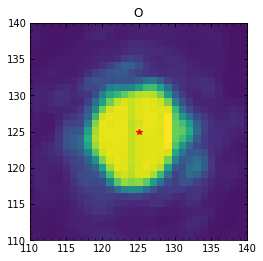

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02930.fits
bin_distcorr_lm_150104_02931.fits
8162.953982982954
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02931.fits: -1.045026003789637, -0.7109543825174214


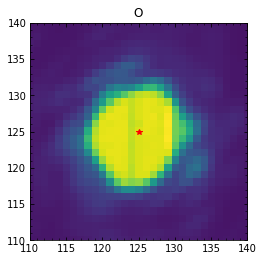

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02931.fits
bin_distcorr_lm_150104_02932.fits
8117.677888774317
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02932.fits: -1.0445243823378974, -0.7327096201561858


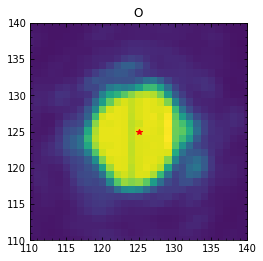

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02932.fits
bin_distcorr_lm_150104_02933.fits
8104.474632813607
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02933.fits: -1.0438683830083875, -0.7400112621351838


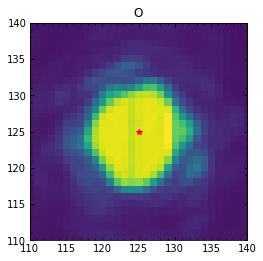

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02933.fits
bin_distcorr_lm_150104_02934.fits
8098.025056904249
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02934.fits: -1.0471806768630358, -0.738971082540651


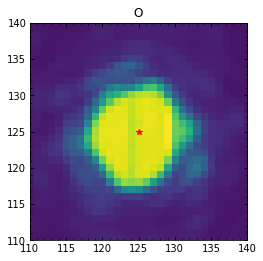

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02934.fits
bin_distcorr_lm_150104_02935.fits
8098.422283224025
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02935.fits: -0.08571272292711996, -0.7600783272720548


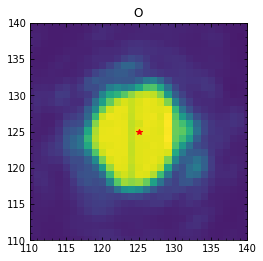

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02935.fits
bin_distcorr_lm_150104_02936.fits
8112.375989706195
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02936.fits: -1.0690831353136971, -0.7620517168575205


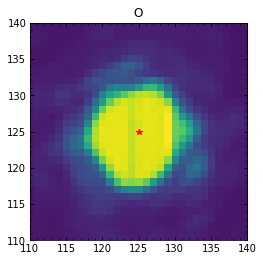

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02936.fits
bin_distcorr_lm_150104_02937.fits
8074.824516143476
STARTING  O
X: 186  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02937.fits: -1.0684087435464988, -0.7688821101887342


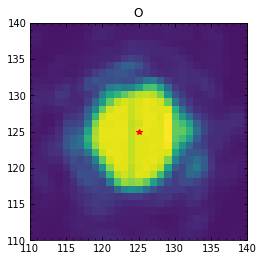

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02937.fits
bin_distcorr_lm_150104_02938.fits
8052.1879312207875
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02938.fits: -0.08944763929883237, -0.7566821996108857


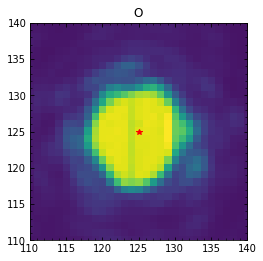

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02938.fits
bin_distcorr_lm_150104_02939.fits
8069.111330557595
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02939.fits: -0.08153760358548823, -0.720145039311241


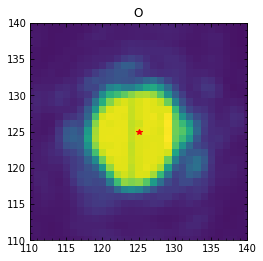

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02939.fits
bin_distcorr_lm_150104_02940.fits
8054.744455494735
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02940.fits: -0.08729616781515404, -0.760185091065047


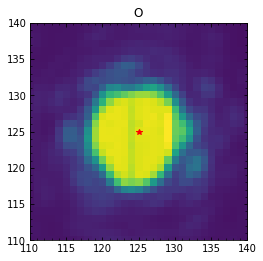

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02940.fits
bin_distcorr_lm_150104_02941.fits
7994.5461762999985
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02941.fits: -0.09542301391475405, -0.7532390248839889


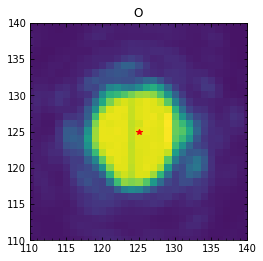

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02941.fits
bin_distcorr_lm_150104_02942.fits
8042.18159539085
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02942.fits: -0.11388778066606164, -0.7393571125357425


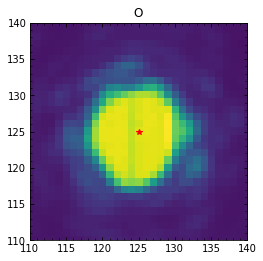

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02942.fits
bin_distcorr_lm_150104_02943.fits
8047.49723684071
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02943.fits: -0.09547744753006526, -0.7793024991005524


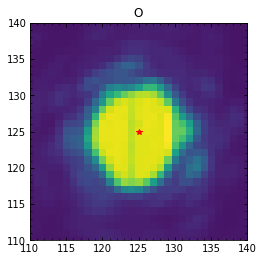

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02943.fits
bin_distcorr_lm_150104_02944.fits
8031.6906770958085
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02944.fits: -0.0949339792820254, -0.7451704513365556


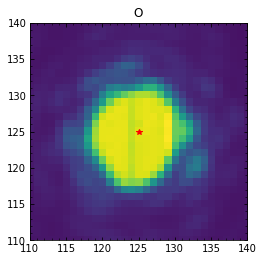

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02944.fits
bin_distcorr_lm_150104_02945.fits
8013.055663618588
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02945.fits: -0.11246305958391645, -0.7404416710775195


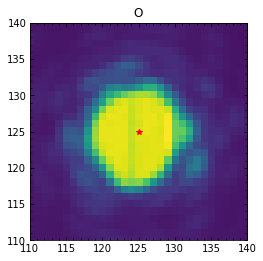

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02945.fits
bin_distcorr_lm_150104_02946.fits
8005.400127635364
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02946.fits: -0.11035155964213317, -0.7498476900405109


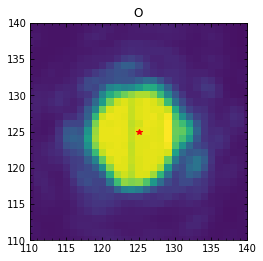

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02946.fits
bin_distcorr_lm_150104_02947.fits
8010.941161651109
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02947.fits: -0.1005222489677493, -0.7374503167992543


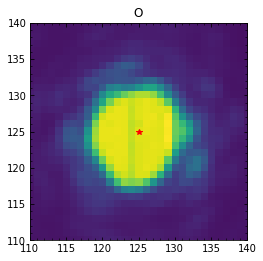

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02947.fits
bin_distcorr_lm_150104_02948.fits
7995.369341057029
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02948.fits: -0.13871423352659207, -0.7274982460736936


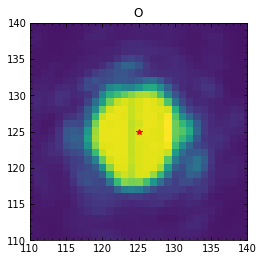

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02948.fits
bin_distcorr_lm_150104_02949.fits
8017.310008086055
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02949.fits: -0.11412256381721164, -0.7412052304862655


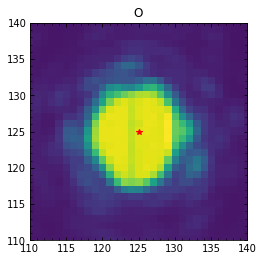

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02949.fits
bin_distcorr_lm_150104_02950.fits
8055.238160356876
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02950.fits: -0.1305431188928452, -0.7276525900422754


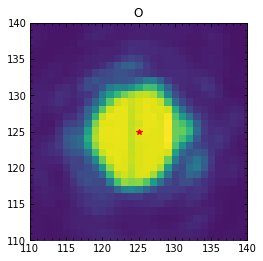

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02950.fits
bin_distcorr_lm_150104_02951.fits
8093.8252050087385
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02951.fits: -0.13583028750415593, -0.7586193224695421


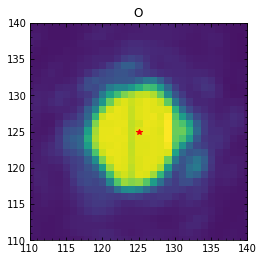

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02951.fits
bin_distcorr_lm_150104_02952.fits
8067.46798244445
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02952.fits: -0.12111363756883264, -0.7491349813981785


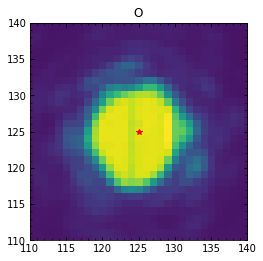

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02952.fits
bin_distcorr_lm_150104_02953.fits
8042.097283122652
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02953.fits: -0.12645985534459925, -0.7600379486557927


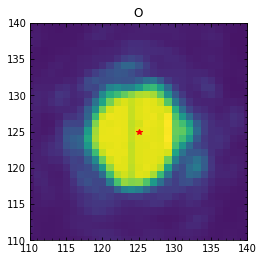

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02953.fits
bin_distcorr_lm_150104_02954.fits
8044.609608144643
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02954.fits: -0.11788543831490017, -0.7623863311865904


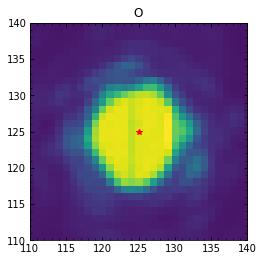

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02954.fits
bin_distcorr_lm_150104_02955.fits
8047.834067518366
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02955.fits: -0.1167096821799376, -0.7644437896040444


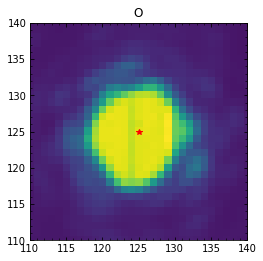

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02955.fits
bin_distcorr_lm_150104_02956.fits
8022.0066648898755
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02956.fits: -0.1381120068561117, -0.7798660963662201


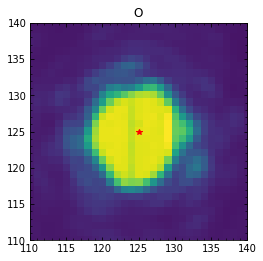

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02956.fits
bin_distcorr_lm_150104_02957.fits
8049.406412756825
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02957.fits: -0.13291165203389, -0.7637966349626524


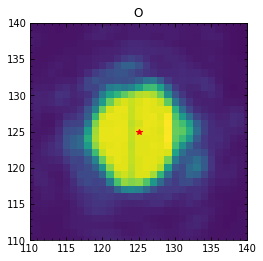

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02957.fits
bin_distcorr_lm_150104_02958.fits
8063.879427149155
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02958.fits: -0.11729544228755628, -0.7625371544268447


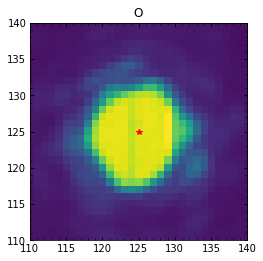

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02958.fits
bin_distcorr_lm_150104_02959.fits
8075.746041202467
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02959.fits: -0.13777284235701615, -0.7677718905061468


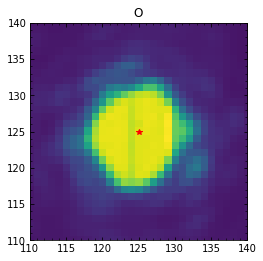

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02959.fits
bin_distcorr_lm_150104_02960.fits
8026.799456445794
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02960.fits: -0.1472783211018296, -0.7875686318883339


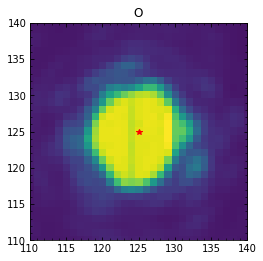

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02960.fits
bin_distcorr_lm_150104_02961.fits
8054.341752858617
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02961.fits: -0.10636839550507915, -0.7749268061036361


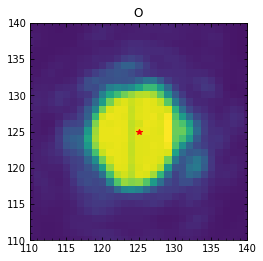

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02961.fits
bin_distcorr_lm_150104_02962.fits
8052.415586187142
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02962.fits: -0.1364491964809531, -0.7811563375740818


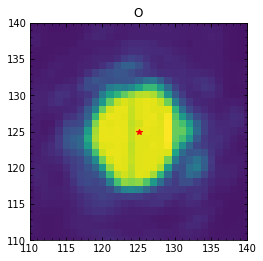

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02962.fits
bin_distcorr_lm_150104_02963.fits
8057.797660077449
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02963.fits: -0.11071838038866133, -0.7994139974289496


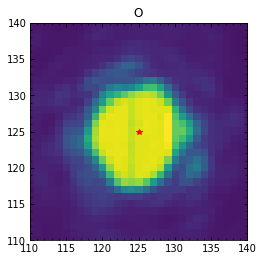

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02963.fits
bin_distcorr_lm_150104_02964.fits
8061.493555349736
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02964.fits: -0.1355011487686042, -0.7684474005886344


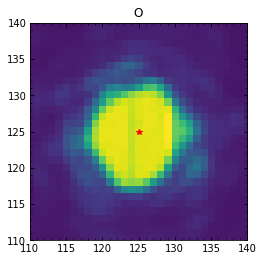

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02964.fits
bin_distcorr_lm_150104_02965.fits
8035.18598591111
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02965.fits: -0.12567726138967572, -0.7594385223407869


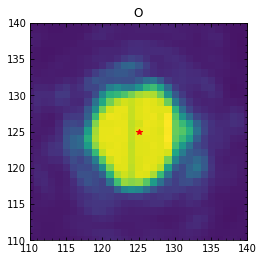

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02965.fits
bin_distcorr_lm_150104_02966.fits
8058.63316945133
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02966.fits: -0.12072062025605135, -0.7426112250248096


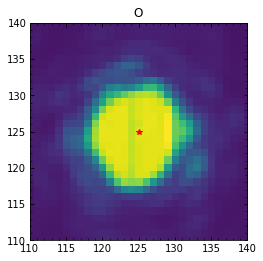

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02966.fits
bin_distcorr_lm_150104_02967.fits
8078.35654483515
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02967.fits: -0.13874062941441423, -0.7433474958199398


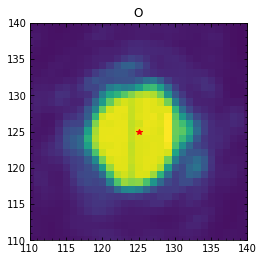

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02967.fits
bin_distcorr_lm_150104_02968.fits
8070.733271073193
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02968.fits: -0.12091470170251029, -0.76533131071659


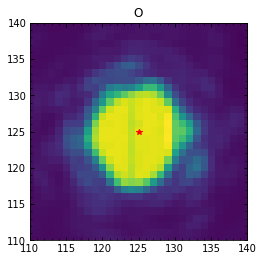

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02968.fits
bin_distcorr_lm_150104_02969.fits
8079.556826820954
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02969.fits: -0.15273331032758364, -0.7732253962053974


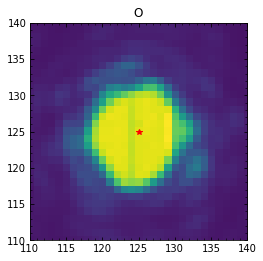

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02969.fits
bin_distcorr_lm_150104_02970.fits
8102.049505437543
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02970.fits: -0.15088262429868138, -0.7768028126559159


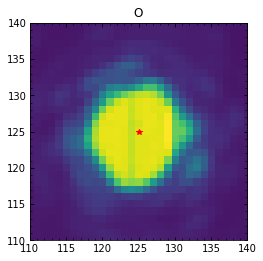

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02970.fits
bin_distcorr_lm_150104_02971.fits
8099.18788976691
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02971.fits: -0.15922559470426023, -0.7648093560002707


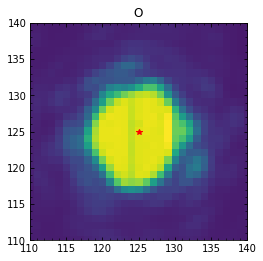

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02971.fits
bin_distcorr_lm_150104_02972.fits
8070.92962175974
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02972.fits: -0.1328608661080537, -0.7791339011485263


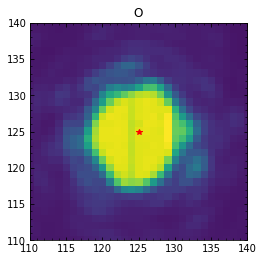

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02972.fits
bin_distcorr_lm_150104_02973.fits
8085.557659850585
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02973.fits: -0.14063269653738075, -0.7428412111050449


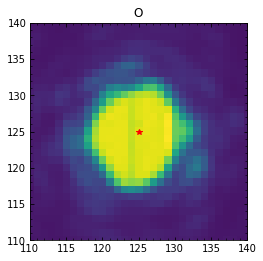

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02973.fits
bin_distcorr_lm_150104_02974.fits
8109.888050324498
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02974.fits: -0.13869502592820737, -0.7764883348618454


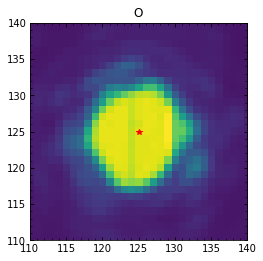

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02974.fits
bin_distcorr_lm_150104_02975.fits
8108.395338989159
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02975.fits: -0.13742851264265, -0.773583951149142


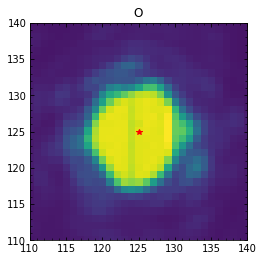

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02975.fits
bin_distcorr_lm_150104_02976.fits
8096.630239901751
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02976.fits: -0.1445621716899197, -0.7498409039905525


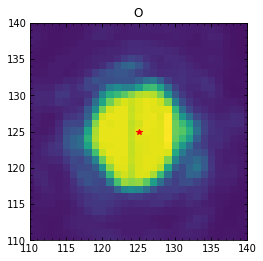

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02976.fits
bin_distcorr_lm_150104_02977.fits
8080.627841187348
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02977.fits: -0.19026508754922133, -0.7209244496023928


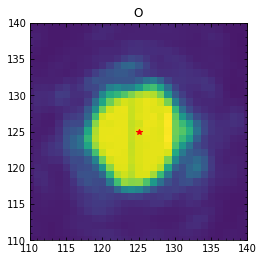

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02977.fits
bin_distcorr_lm_150104_02978.fits
8097.935121756531
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02978.fits: -0.18210324600239147, -0.7614664429856148


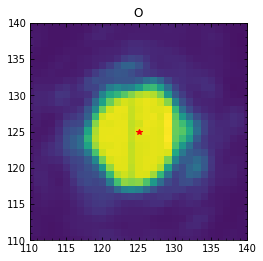

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02978.fits
bin_distcorr_lm_150104_02979.fits
8081.75205275291
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02979.fits: -0.17245190522836396, -0.7699894315027791


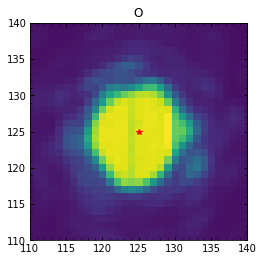

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02979.fits
bin_distcorr_lm_150104_02980.fits
8074.767385848101
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02980.fits: -0.19305347745236645, -0.7677714368540407


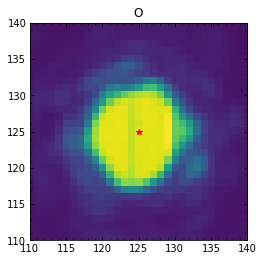

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02980.fits
bin_distcorr_lm_150104_02981.fits
8044.629966225937
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02981.fits: -0.18484984264561177, -0.7744003285576184


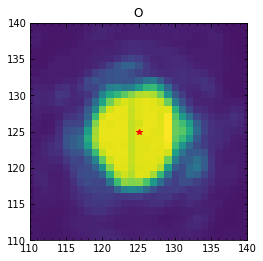

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02981.fits
bin_distcorr_lm_150104_02982.fits
8097.336683874803
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02982.fits: -0.1404945065677552, -0.7745959755196239


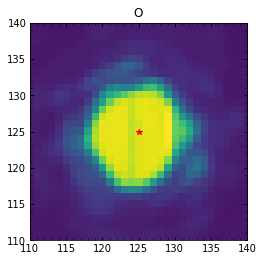

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02982.fits
bin_distcorr_lm_150104_02983.fits
8093.122728425651
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02983.fits: -0.14330707569585144, -0.7677891230692282


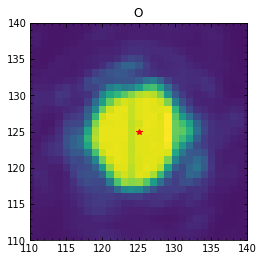

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02983.fits
bin_distcorr_lm_150104_02984.fits
8086.749601398195
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02984.fits: -0.15585147754001838, -0.7659411677562389


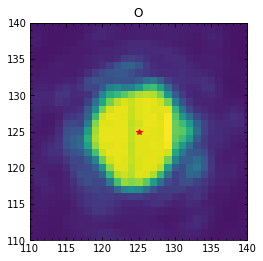

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02984.fits
bin_distcorr_lm_150104_02985.fits
8113.923527194862
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02985.fits: -0.14899004898249757, -0.7516979350803155


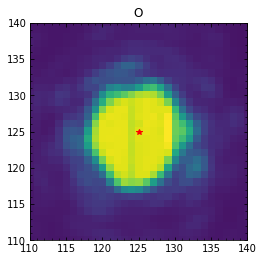

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02985.fits
bin_distcorr_lm_150104_02986.fits
8116.081826462614
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02986.fits: -0.16448393596030542, -0.7502789796821219


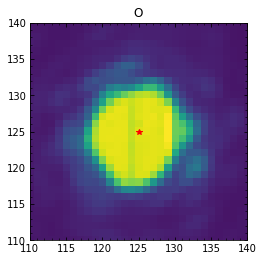

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02986.fits
bin_distcorr_lm_150104_02987.fits
8103.417542091334
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02987.fits: -0.16808368568140963, -0.760240640360955


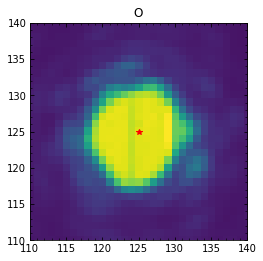

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02987.fits
bin_distcorr_lm_150104_02988.fits
8083.847294451801
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02988.fits: -0.17536145347909837, -0.7732947976358062


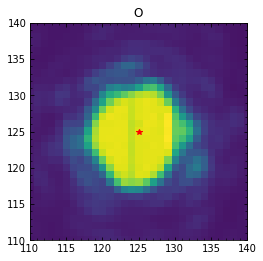

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02988.fits
bin_distcorr_lm_150104_02989.fits
8080.453679056511
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02989.fits: -0.16808359484125646, -0.7764975700634693


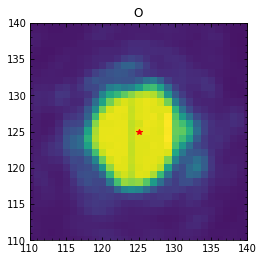

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02989.fits
bin_distcorr_lm_150104_02990.fits
8094.0111326352035
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02990.fits: -0.13829135727562658, -0.7796218730299245


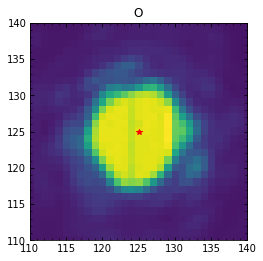

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02990.fits
bin_distcorr_lm_150104_02991.fits
8092.970198173043
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02991.fits: -0.1399874631433704, -0.7702770984571146


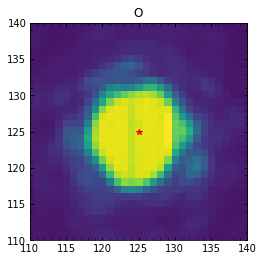

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02991.fits
bin_distcorr_lm_150104_02992.fits
8062.38552689328
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02992.fits: -0.1387564573237725, -0.7761070407440656


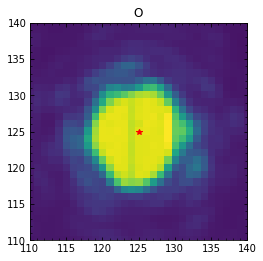

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02992.fits
bin_distcorr_lm_150104_02993.fits
8081.530253579161
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02993.fits: -0.13633938582046312, -0.7825335314432635


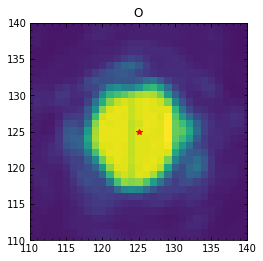

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02993.fits
bin_distcorr_lm_150104_02994.fits
8104.7612244762695
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02994.fits: -0.13139463413414632, -0.7728323779330779


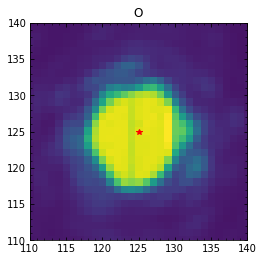

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02994.fits
bin_distcorr_lm_150104_02995.fits
8091.335369149268
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02995.fits: -0.1253033013069853, -0.7853034908641803


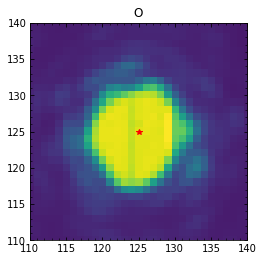

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02995.fits
bin_distcorr_lm_150104_02996.fits
8083.955872345002
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02996.fits: -0.13000950065615058, -0.7771471208250773


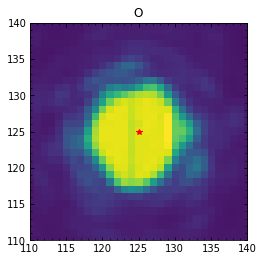

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02996.fits
bin_distcorr_lm_150104_02997.fits
8091.765693510789
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02997.fits: -0.142005507690655, -0.7761327340745439


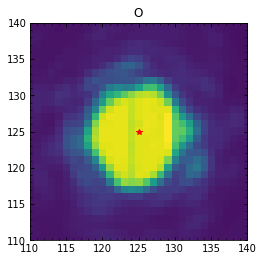

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02997.fits
bin_distcorr_lm_150104_02998.fits
8109.593335088191
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02998.fits: -0.10965524072459942, -0.7719958828587394


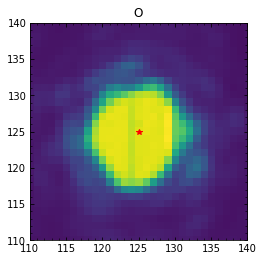

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02998.fits
bin_distcorr_lm_150104_02999.fits
8073.623473855993
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_02999.fits: -0.1390821542914864, -0.7670639151415628


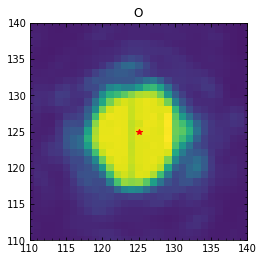

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_02999.fits
bin_distcorr_lm_150104_03000.fits
8008.904435405278
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03000.fits: -0.1717493747352563, -0.7874421932406577


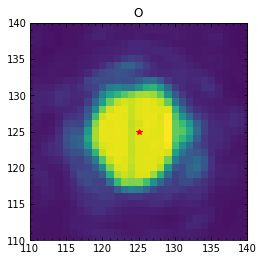

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03000.fits
bin_distcorr_lm_150104_03001.fits
8035.71542621512
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03001.fits: -0.18562242255988792, -0.7803088283259569


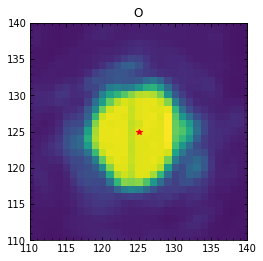

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03001.fits
bin_distcorr_lm_150104_03002.fits
7991.632263149535
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03002.fits: -0.2089862866574279, -0.768282080135684


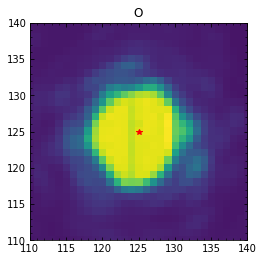

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03002.fits
bin_distcorr_lm_150104_03003.fits
8030.4332130137545
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03003.fits: -0.16339559646537083, 0.18359678348742392


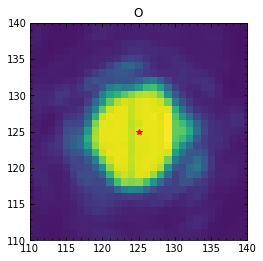

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03003.fits
bin_distcorr_lm_150104_03004.fits
8022.144030196852
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03004.fits: -0.9429987187270825, 0.08100898155722547


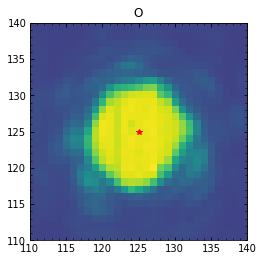

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03004.fits
bin_distcorr_lm_150104_03005.fits
8028.08638584267
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03005.fits: -0.9860325429425529, 0.06673505323671947


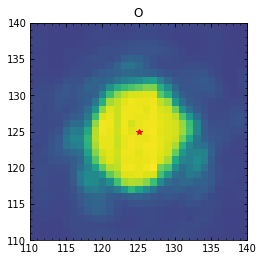

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03005.fits
bin_distcorr_lm_150104_03006.fits
7996.389865595536
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03006.fits: -0.9679150945684682, 0.03569709304890267


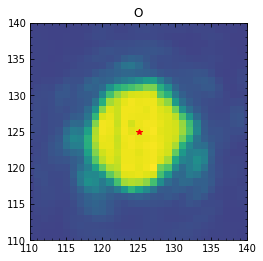

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03006.fits
bin_distcorr_lm_150104_03007.fits
7983.79549171146
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03007.fits: -0.9672174942665208, 0.04553964077079087


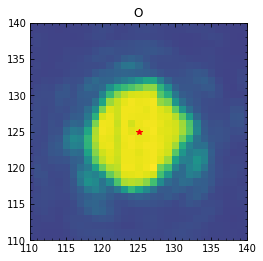

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03007.fits
bin_distcorr_lm_150104_03008.fits
7983.988576825968
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03008.fits: -1.0340392909733112, 0.04038972260887164


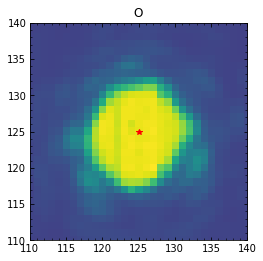

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03008.fits
bin_distcorr_lm_150104_03009.fits
7996.097150306124
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03009.fits: -0.9825420639638693, 0.02215794690754791


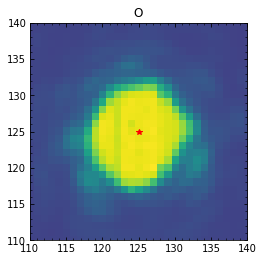

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03009.fits
bin_distcorr_lm_150104_03010.fits
7996.200749501491
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03010.fits: -0.9656714451742587, 0.012094760130736404


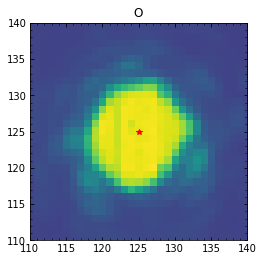

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03010.fits
bin_distcorr_lm_150104_03011.fits
7992.281388518561
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03011.fits: -0.9672990446584606, 0.01189406059935294


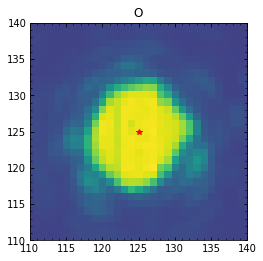

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03011.fits
bin_distcorr_lm_150104_03012.fits
8036.402311357328
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03012.fits: -0.9467785232001162, 0.04871667950966696


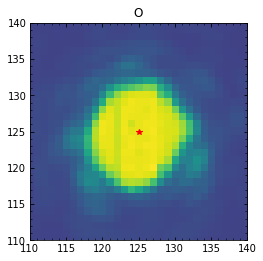

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03012.fits
bin_distcorr_lm_150104_03013.fits
8023.289079001688
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03013.fits: -0.92086726125072, 0.06223403469915212


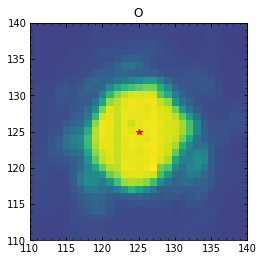

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03013.fits
bin_distcorr_lm_150104_03014.fits
8028.332667118828
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03014.fits: -0.9708088071163061, 0.053635827821871374


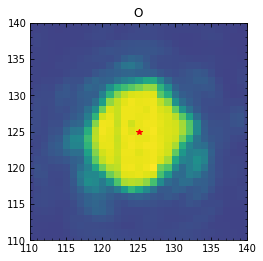

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03014.fits
bin_distcorr_lm_150104_03015.fits
8002.285521717556
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03015.fits: -0.9248619125922559, 0.03382774398085786


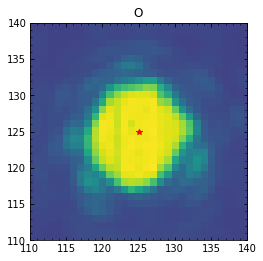

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03015.fits
bin_distcorr_lm_150104_03016.fits
8034.825974251035
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03016.fits: -0.9587032496460068, 0.07229459421508011


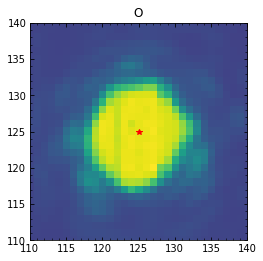

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03016.fits
bin_distcorr_lm_150104_03017.fits
8043.881737026526
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03017.fits: -0.9910793183329787, 0.07745914110937235


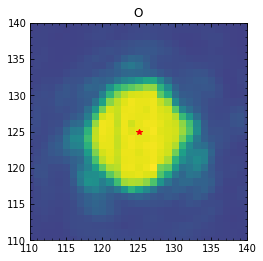

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03017.fits
bin_distcorr_lm_150104_03018.fits
8030.02274971061
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03018.fits: -0.958153469536775, 0.06951562817368284


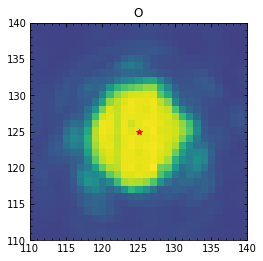

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03018.fits
bin_distcorr_lm_150104_03019.fits
8002.995212552534
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03019.fits: -0.9694496610243988, 0.054938057598654666


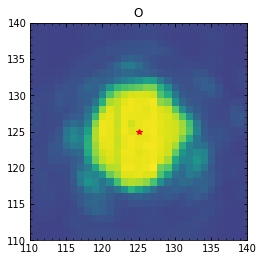

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03019.fits
bin_distcorr_lm_150104_03020.fits
8020.041564041786
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03020.fits: -0.9971548637679035, 0.05389257813587989


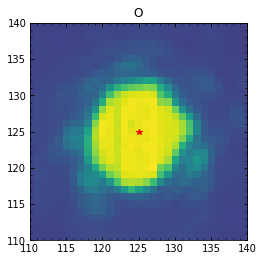

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03020.fits
bin_distcorr_lm_150104_03021.fits
8027.018257706445
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03021.fits: -0.9736587820209053, 0.043757953794433035


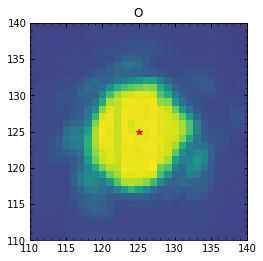

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03021.fits
bin_distcorr_lm_150104_03022.fits
8003.075527617133
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03022.fits: -0.9814016783646693, 0.04571653740774195


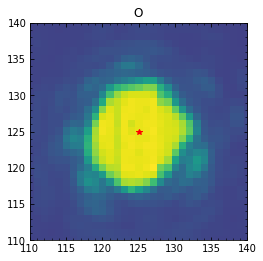

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03022.fits
bin_distcorr_lm_150104_03023.fits
8018.267059259717
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03023.fits: -1.0098639942180228, 0.030424786546490168


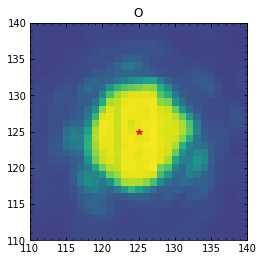

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03023.fits
bin_distcorr_lm_150104_03024.fits
8039.240183536751
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03024.fits: -1.0133865420902524, 0.04818425983033592


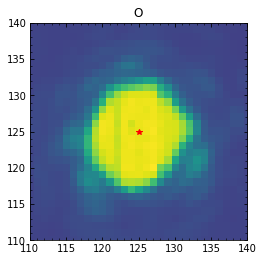

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03024.fits
bin_distcorr_lm_150104_03025.fits
8047.467897109199
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03025.fits: -0.967893000842885, 0.05073003754863237


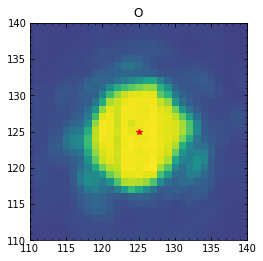

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03025.fits
bin_distcorr_lm_150104_03026.fits
8028.81601017724
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03026.fits: -0.9783712802645823, 0.05740578138095742


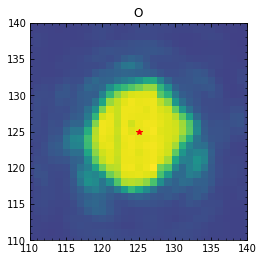

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03026.fits
bin_distcorr_lm_150104_03027.fits
8038.470089046761
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03027.fits: -0.9787782866929504, 0.057782723547468606


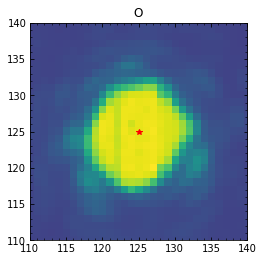

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03027.fits
bin_distcorr_lm_150104_03028.fits
8035.3331827018
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03028.fits: -0.9791152188560872, 0.045348249973628185


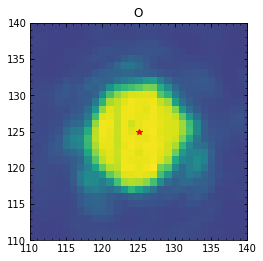

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03028.fits
bin_distcorr_lm_150104_03029.fits
8027.484130445094
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03029.fits: -0.9813316236350786, 0.0776873532759339


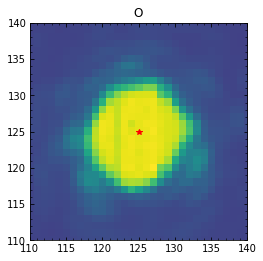

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03029.fits
bin_distcorr_lm_150104_03030.fits
7989.300425649159
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03030.fits: -1.0212621579973487, 0.03324519022612549


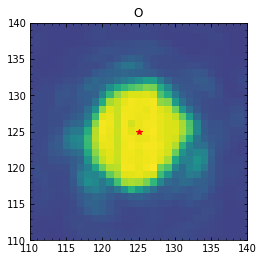

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03030.fits
bin_distcorr_lm_150104_03031.fits
8005.276428910274
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03031.fits: -1.0028520257183473, 0.01764778728170313


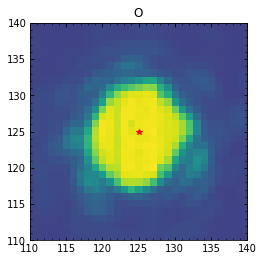

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03031.fits
bin_distcorr_lm_150104_03032.fits
8015.195639127603
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03032.fits: -1.0009957765591508, 0.042961219187837685


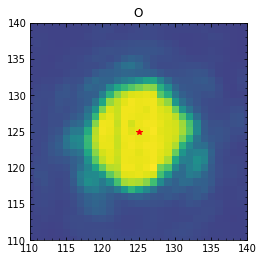

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03032.fits
bin_distcorr_lm_150104_03033.fits
7988.227733517171
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03033.fits: -1.0286950532947472, 0.051651933726788


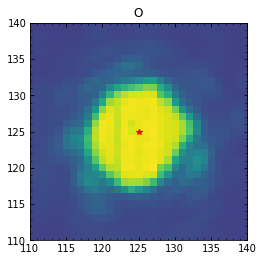

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03033.fits
bin_distcorr_lm_150104_03034.fits
7985.969514730957
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03034.fits: -1.036982610365122, 0.06035609458682245


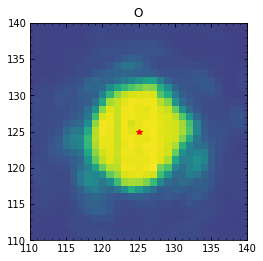

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03034.fits
bin_distcorr_lm_150104_03035.fits
8048.42690327236
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03035.fits: -0.9868784252304863, 0.07233158780741888


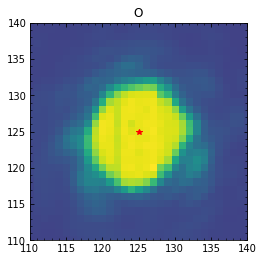

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03035.fits
bin_distcorr_lm_150104_03036.fits
8049.459306125628
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03036.fits: -0.9996115992517289, 0.041094267148444885


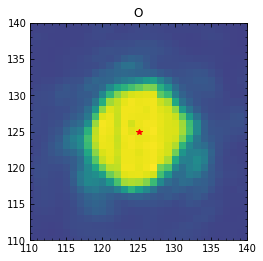

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03036.fits
bin_distcorr_lm_150104_03037.fits
8011.877501086484
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03037.fits: -0.9747471420345164, 0.036583103902849246


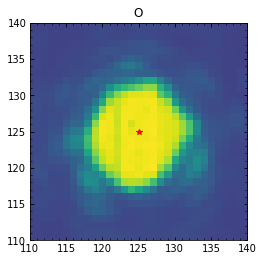

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03037.fits
bin_distcorr_lm_150104_03038.fits
8044.511412050092
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03038.fits: -0.9962247463582443, 0.04375166643247752


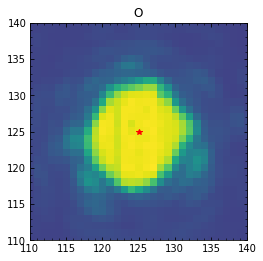

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03038.fits
bin_distcorr_lm_150104_03039.fits
8060.729773318521
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03039.fits: -0.9976798550765267, 0.04849730299630295


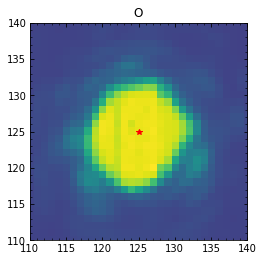

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03039.fits
bin_distcorr_lm_150104_03040.fits
8063.856149103103
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03040.fits: -0.9776056085415874, 0.07230808031690117


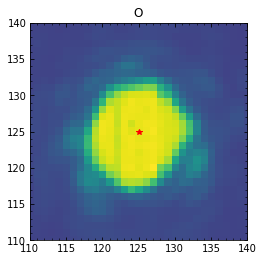

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03040.fits
bin_distcorr_lm_150104_03041.fits
8045.128458740041
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03041.fits: -0.9841758371815956, 0.08120565200664487


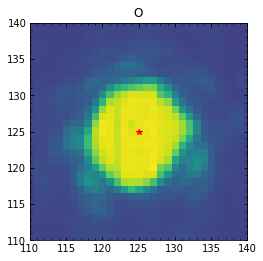

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03041.fits
bin_distcorr_lm_150104_03042.fits
8034.092886266073
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03042.fits: -1.005407995093094, 0.08837310675277621


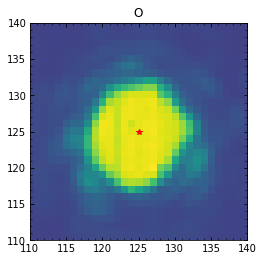

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03042.fits
bin_distcorr_lm_150104_03043.fits
8038.23652835501
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03043.fits: -1.009426703656949, 0.06497983321769851


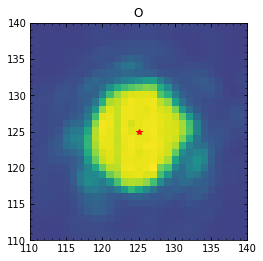

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03043.fits
bin_distcorr_lm_150104_03044.fits
8043.40234012053
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03044.fits: -1.0089248931884995, 0.05463215961009382


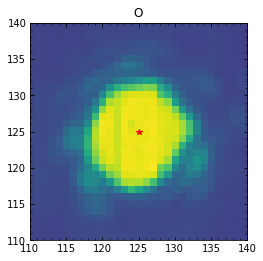

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03044.fits
bin_distcorr_lm_150104_03045.fits
8023.846249119384
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03045.fits: -1.0049245338196826, 0.061649576882096824


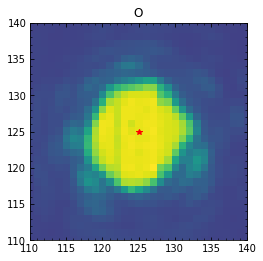

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03045.fits
bin_distcorr_lm_150104_03046.fits
8054.28097439078
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03046.fits: -0.9957062858743626, 0.03980989195054718


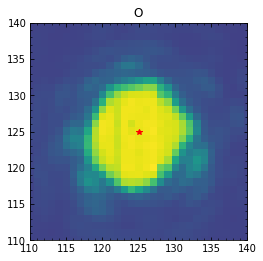

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03046.fits
bin_distcorr_lm_150104_03047.fits
8076.726941867617
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03047.fits: -0.995620335186679, 0.06690401236378563


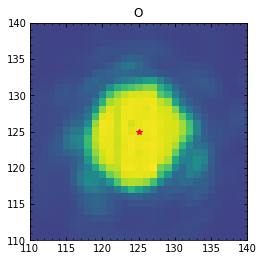

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03047.fits
bin_distcorr_lm_150104_03048.fits
8083.861618643686
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03048.fits: -1.0054198279288187, 0.05265833234849282


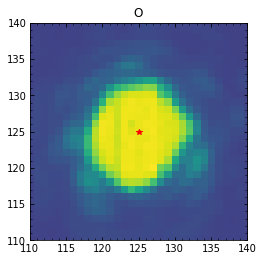

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03048.fits
bin_distcorr_lm_150104_03049.fits
8082.168587638444
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03049.fits: -1.007387847453444, 0.04389661635934061


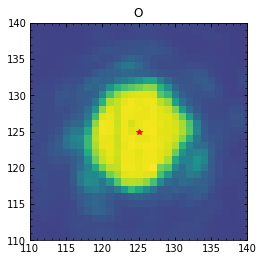

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03049.fits
bin_distcorr_lm_150104_03050.fits
8082.337733228376
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03050.fits: -0.9978044493710598, 0.04278697247112717


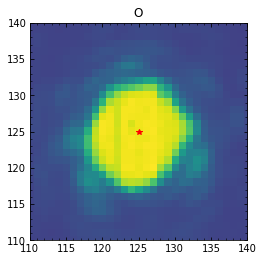

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03050.fits
bin_distcorr_lm_150104_03051.fits
8090.613211749946
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03051.fits: -1.0014864927304998, 0.04625331961916146


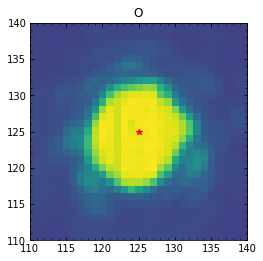

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03051.fits
bin_distcorr_lm_150104_03052.fits
8085.015506490045
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03052.fits: -1.013508664688743, 0.03133161400749174


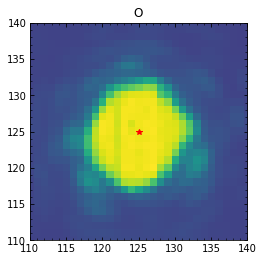

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03052.fits
bin_distcorr_lm_150104_03053.fits
8074.558028484343
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03053.fits: -0.9929102965107504, 0.04429195323565693


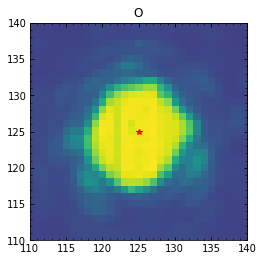

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03053.fits
bin_distcorr_lm_150104_03054.fits
8076.637283944826
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03054.fits: -0.9986313010720593, 0.06853868417628917


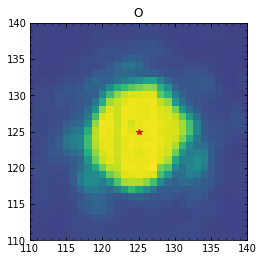

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03054.fits
bin_distcorr_lm_150104_03055.fits
8104.8966847349275
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03055.fits: -0.9834999479685109, 0.06885275624035359


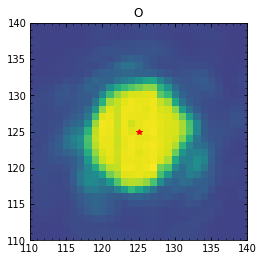

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03055.fits
bin_distcorr_lm_150104_03056.fits
8103.14857441861
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03056.fits: -1.0044091568910787, 0.06483107765313179


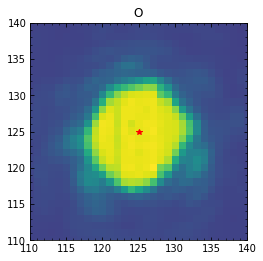

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03056.fits
bin_distcorr_lm_150104_03057.fits
8092.596314065348
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03057.fits: -1.0076169881442638, 0.046911014943816554


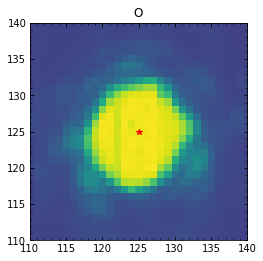

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03057.fits
bin_distcorr_lm_150104_03058.fits
8116.275355503983
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03058.fits: -1.045210576529911, 0.04213487492653201


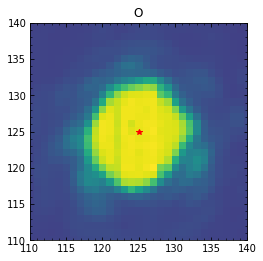

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03058.fits
bin_distcorr_lm_150104_03059.fits
8083.494232304039
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03059.fits: -1.0287650169363332, 0.04755060188074367


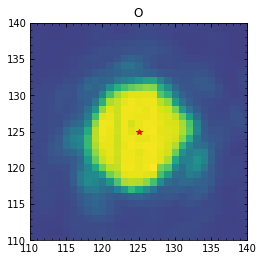

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03059.fits
bin_distcorr_lm_150104_03060.fits
8069.624734789567
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03060.fits: -1.0149855551588374, 0.03764564187142838


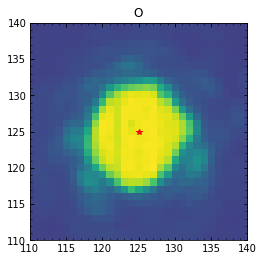

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03060.fits
bin_distcorr_lm_150104_03061.fits
8049.913024471749
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03061.fits: -0.9882624213089954, 0.047552843226362995


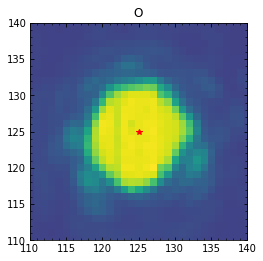

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03061.fits
bin_distcorr_lm_150104_03062.fits
8077.500138953417
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03062.fits: -0.9953546878804858, 0.04747670280685412


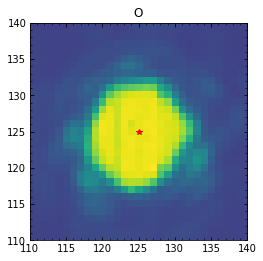

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03062.fits
bin_distcorr_lm_150104_03063.fits
8066.956175606172
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03063.fits: -0.9699677568637455, 0.0790458035486239


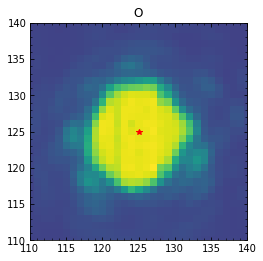

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03063.fits
bin_distcorr_lm_150104_03064.fits
8031.056048665892
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03064.fits: -1.0036769559915228, 0.06071109429446153


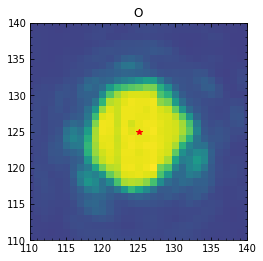

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03064.fits
bin_distcorr_lm_150104_03065.fits
8059.31856891134
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03065.fits: -1.0063399259255164, 0.04591640058103508


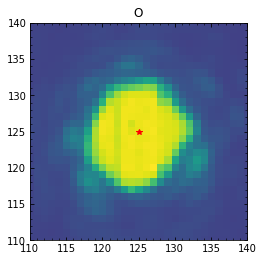

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03065.fits
bin_distcorr_lm_150104_03066.fits
8081.458473126431
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03066.fits: -1.014174302407902, 0.05314760732522217


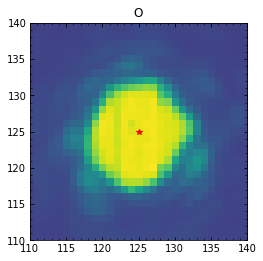

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03066.fits
bin_distcorr_lm_150104_03067.fits
8095.900403532862
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03067.fits: -1.0220128983255492, 0.022753601170101945


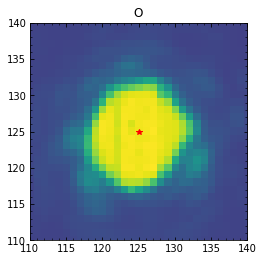

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03067.fits
bin_distcorr_lm_150104_03068.fits
8077.724409860927
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03068.fits: -0.9920947903287001, 0.0732123435598524


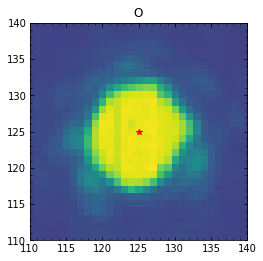

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03068.fits
bin_distcorr_lm_150104_03069.fits
8074.576402395668
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03069.fits: -1.0171209783051864, 0.05270716191822089


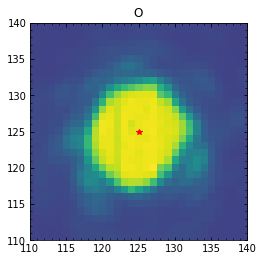

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03069.fits
bin_distcorr_lm_150104_03070.fits
8097.558781380584
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03070.fits: -1.0473233099642698, 0.0322468543628176


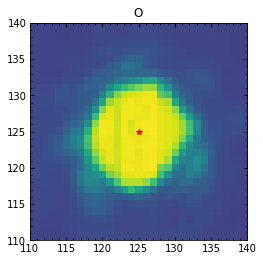

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03070.fits
bin_distcorr_lm_150104_03071.fits
8076.00354390423
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03071.fits: -1.0239355866258038, 0.017877638380042526


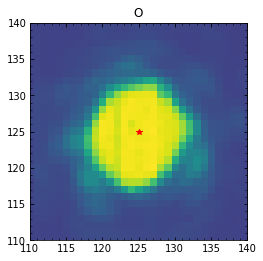

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03071.fits
bin_distcorr_lm_150104_03072.fits
8021.668152108039
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03072.fits: -1.0389320674742635, 0.02470332624544369


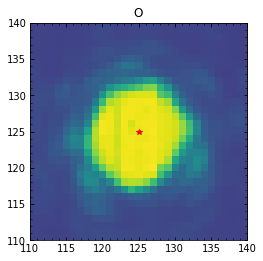

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03072.fits
bin_distcorr_lm_150104_03073.fits
8037.555338889382
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03073.fits: -1.02706097298163, 0.025250820567713106


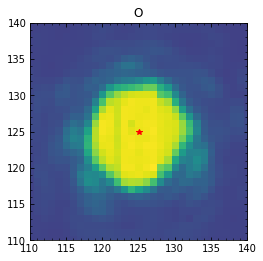

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03073.fits
bin_distcorr_lm_150104_03074.fits
8059.500402386957
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03074.fits: -0.06876424232228828, 0.07051477514227855


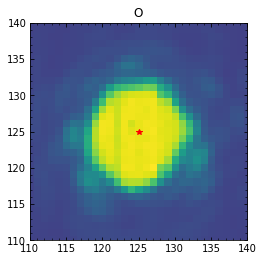

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03074.fits
bin_distcorr_lm_150104_03075.fits
8058.372652188415
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03075.fits: -0.07933724997096903, 0.0732223090106956


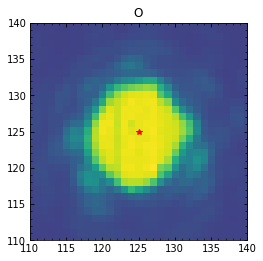

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03075.fits
bin_distcorr_lm_150104_03076.fits
8025.8540832248955
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03076.fits: -1.0590609129640924, 0.0560489126348358


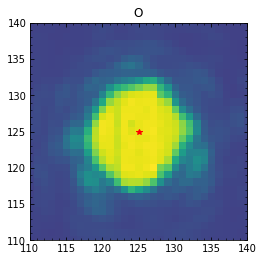

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03076.fits
bin_distcorr_lm_150104_03077.fits
8024.49153078662
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03077.fits: -1.0318670014470541, 0.01769775499701609


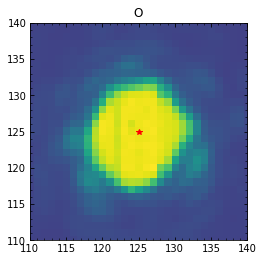

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03077.fits
bin_distcorr_lm_150104_03078.fits
8038.759704926358
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03078.fits: -0.08803073921679783, 0.015214118857798553


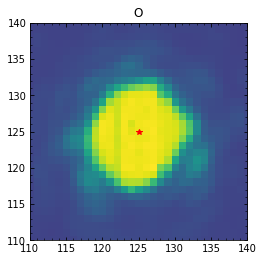

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03078.fits
bin_distcorr_lm_150104_03079.fits
7990.563296027012
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03079.fits: -0.08376030215747932, 0.0289235744514329


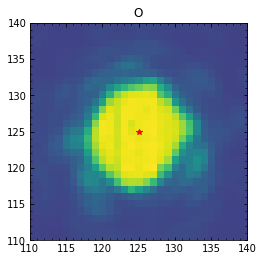

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03079.fits
bin_distcorr_lm_150104_03080.fits
7972.939336599462
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03080.fits: -0.07228133014731952, 0.016797869437809254


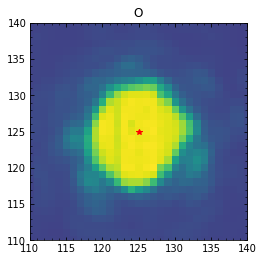

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03080.fits
bin_distcorr_lm_150104_03081.fits
7998.471515710986
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03081.fits: -0.09104687124501964, 0.004830676806534484


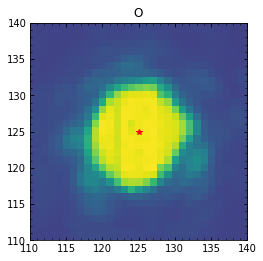

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03081.fits
bin_distcorr_lm_150104_03082.fits
7996.729858262486
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03082.fits: -0.06310281413288266, 0.017993585006337298


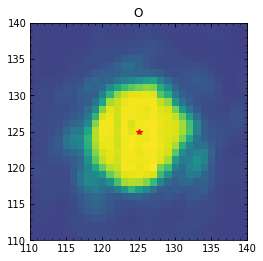

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03082.fits
bin_distcorr_lm_150104_03083.fits
7934.464126347745
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03083.fits: -0.1139769851887209, -0.01896395783917626


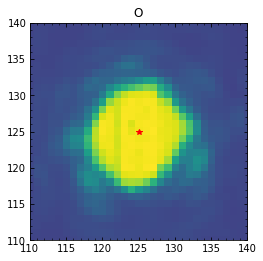

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03083.fits
bin_distcorr_lm_150104_03084.fits
7950.748257215768
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03084.fits: -0.09307829269626211, 0.003371321055951171


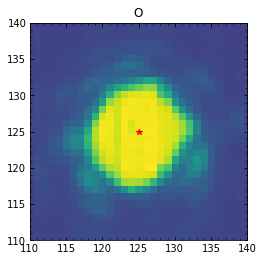

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03084.fits
bin_distcorr_lm_150104_03085.fits
7968.655839550048
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03085.fits: -0.08001352617527857, 0.026531639391535577


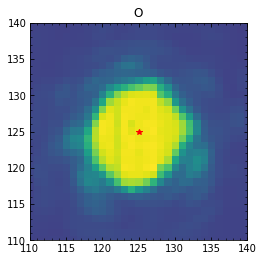

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03085.fits
bin_distcorr_lm_150104_03086.fits
8008.177709676433
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03086.fits: -0.06986841260994225, 0.035856813430918066


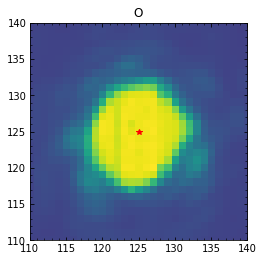

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03086.fits
bin_distcorr_lm_150104_03087.fits
8030.978319793674
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03087.fits: -1.0335620092766504, 0.03949446273848878


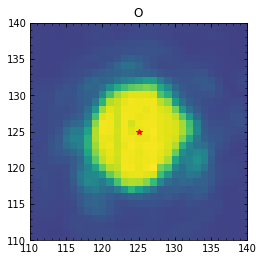

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03087.fits
bin_distcorr_lm_150104_03088.fits
8001.2663757707805
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03088.fits: -1.0246039276984007, 0.03622328992984336


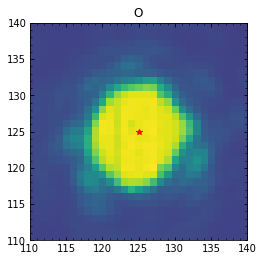

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03088.fits
bin_distcorr_lm_150104_03089.fits
8018.3534782427
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03089.fits: -1.028172336677244, 0.025166431654987775


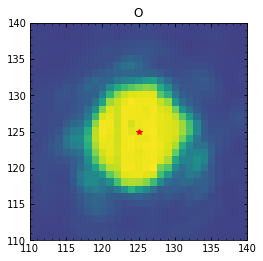

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03089.fits
bin_distcorr_lm_150104_03090.fits
7986.391831975108
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03090.fits: -1.0500207659775, 0.011455452296935675


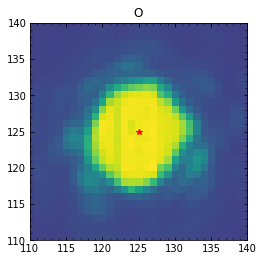

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03090.fits
bin_distcorr_lm_150104_03091.fits
7986.437030775408
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03091.fits: -0.08088446637520974, 0.005695951955566159


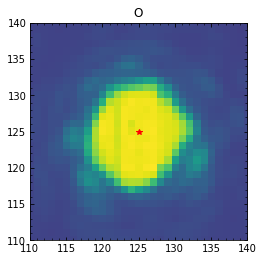

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03091.fits
bin_distcorr_lm_150104_03092.fits
7969.541529383757
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03092.fits: -0.09084568799678294, -0.0017741231346732889


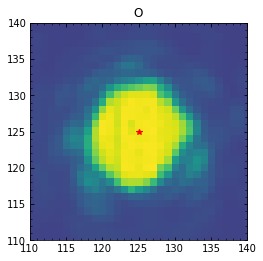

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03092.fits
bin_distcorr_lm_150104_03093.fits
7991.763391124425
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03093.fits: -0.11434976864808988, -0.0002920291622530158


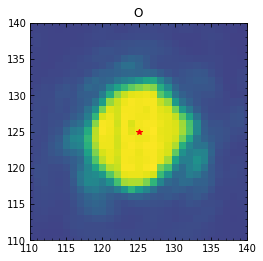

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03093.fits
bin_distcorr_lm_150104_03094.fits
7982.675502461703
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03094.fits: -1.0506468354643062, 0.003936287711383102


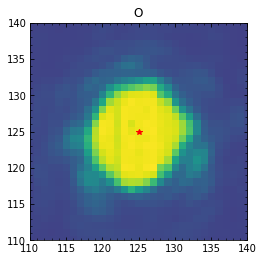

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03094.fits
bin_distcorr_lm_150104_03095.fits
7968.273959693521
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03095.fits: -0.07860851545434855, 0.023767453225119084


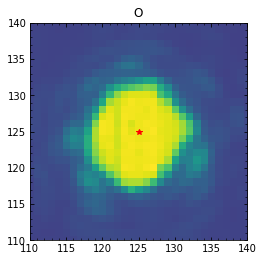

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03095.fits
bin_distcorr_lm_150104_03096.fits
8007.475400545609
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03096.fits: -0.08831462580958771, 0.006549073072648071


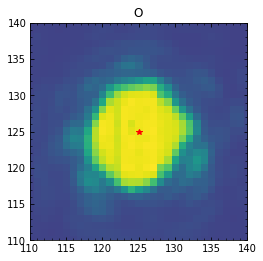

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03096.fits
bin_distcorr_lm_150104_03097.fits
8041.421361749958
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03097.fits: -0.08078092737257947, 0.02292101597642926


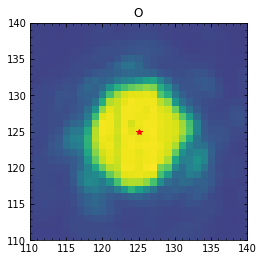

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03097.fits
bin_distcorr_lm_150104_03098.fits
7995.393999074908
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03098.fits: -0.06934024538868044, 0.03462425163366589


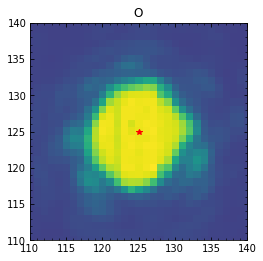

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03098.fits
bin_distcorr_lm_150104_03099.fits
7956.564588003258
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03099.fits: -0.10604019147092458, -0.004318493336604945


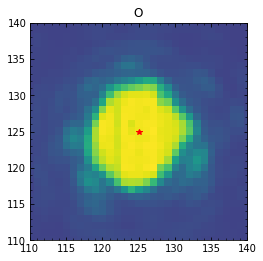

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03099.fits
bin_distcorr_lm_150104_03100.fits
7977.324569027578
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03100.fits: -0.08708734883833813, -0.0060147641749068725


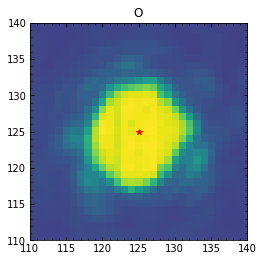

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03100.fits
bin_distcorr_lm_150104_03101.fits
7973.225111827671
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03101.fits: -0.06103317052900792, -0.015511676985909162


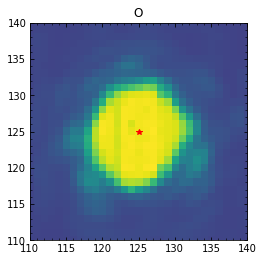

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03101.fits
bin_distcorr_lm_150104_03102.fits
7991.9393711678185
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03102.fits: -0.07885321589146344, 0.018965769201656713


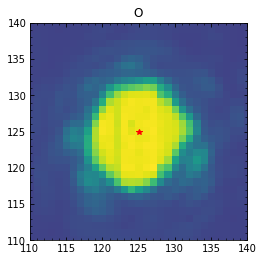

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03102.fits
bin_distcorr_lm_150104_03103.fits
7975.62970058115
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03103.fits: -0.08493089947620547, 0.018583447438821565


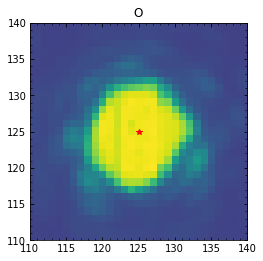

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03103.fits
bin_distcorr_lm_150104_03104.fits
8023.206536679936
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03104.fits: -0.11892781619118153, 0.014936203128137038


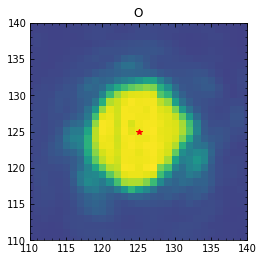

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03104.fits
bin_distcorr_lm_150104_03105.fits
8034.487551539534
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03105.fits: -0.1095818335165788, 0.05379341329890508


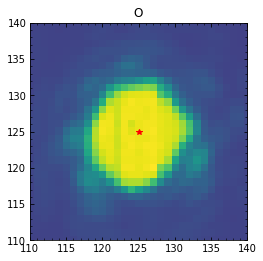

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03105.fits
bin_distcorr_lm_150104_03106.fits
8018.2125935701915
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03106.fits: -0.11017047854868167, 0.04658624578176074


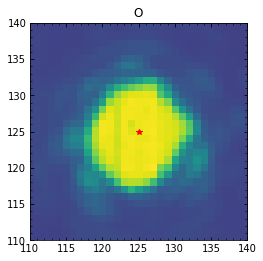

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03106.fits
bin_distcorr_lm_150104_03107.fits
8007.1108706349505
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03107.fits: -0.07105485226918518, 0.0242431154856817


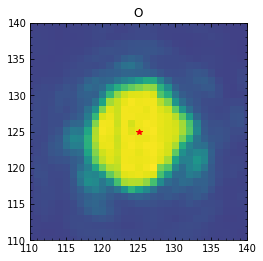

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03107.fits
bin_distcorr_lm_150104_03108.fits
8020.992972297233
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03108.fits: -0.07063465711058825, 0.043323929614913936


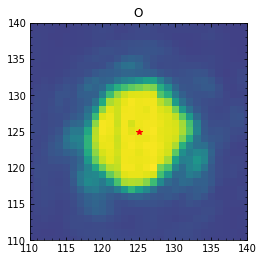

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03108.fits
bin_distcorr_lm_150104_03109.fits
8030.899504804161
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03109.fits: -0.10847951191111349, 0.04315487898240633


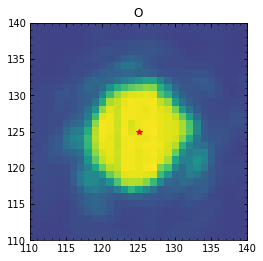

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03109.fits
bin_distcorr_lm_150104_03110.fits
7987.750858190459
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03110.fits: -0.13550945115238022, 0.05160378857623016


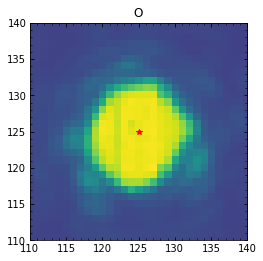

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03110.fits
bin_distcorr_lm_150104_03111.fits
7994.169450988244
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03111.fits: -0.11179731456095254, 0.04377570158814592


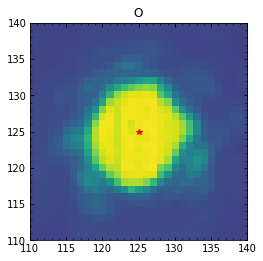

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03111.fits
bin_distcorr_lm_150104_03112.fits
8003.315056511272
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03112.fits: -0.13292317868390313, 0.04185669921231039


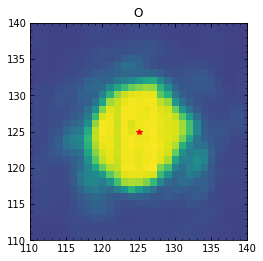

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03112.fits
bin_distcorr_lm_150104_03113.fits
8014.476695028504
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03113.fits: -0.12765412911183915, 0.007464874014765144


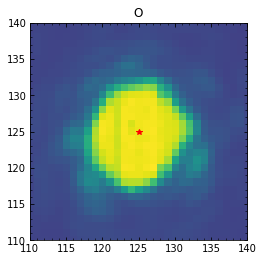

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03113.fits
bin_distcorr_lm_150104_03114.fits
8018.762834817259
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03114.fits: -0.09790339557057592, 0.02663385663770157


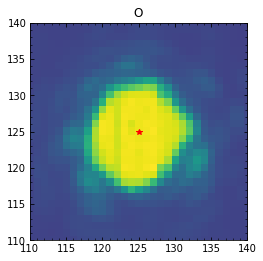

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03114.fits
bin_distcorr_lm_150104_03115.fits
8044.571267620364
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03115.fits: -0.1156210905644528, 0.020627782715784804


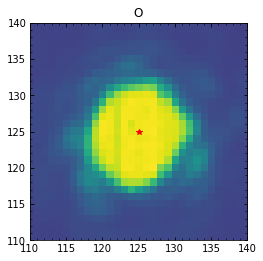

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03115.fits
bin_distcorr_lm_150104_03116.fits
8041.350962281669
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03116.fits: -0.12050979980363508, 0.020172789189956575


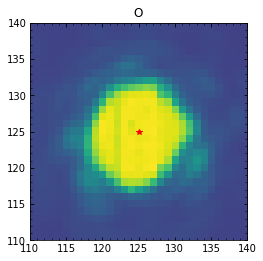

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03116.fits
bin_distcorr_lm_150104_03117.fits
8033.665999137395
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03117.fits: -0.13115326600829036, 0.026772545138889825


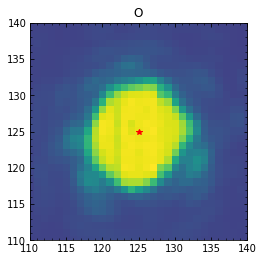

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03117.fits
bin_distcorr_lm_150104_03118.fits
8030.392058233367
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03118.fits: -0.11553167589394064, 0.05032236066206508


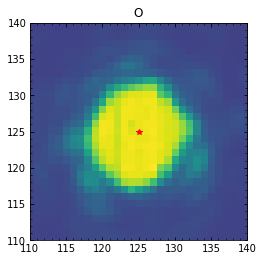

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03118.fits
bin_distcorr_lm_150104_03119.fits
8046.672651594774
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03119.fits: -0.12806710313697778, 0.04258784350076894


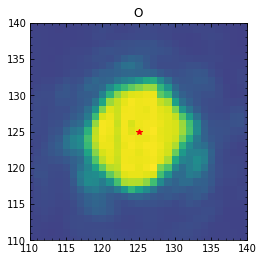

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03119.fits
bin_distcorr_lm_150104_03120.fits
8017.462517920481
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03120.fits: -0.12734270229741185, 0.0409838314771136


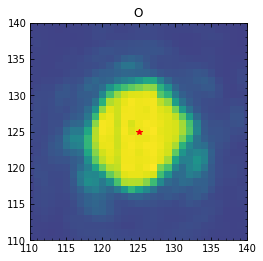

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03120.fits
bin_distcorr_lm_150104_03121.fits
8010.325469991227
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03121.fits: -0.1180890921429878, 0.04589360586768976


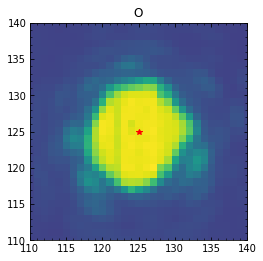

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03121.fits
bin_distcorr_lm_150104_03122.fits
8047.740330450146
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03122.fits: -0.1297470466164441, 0.07634437714948206


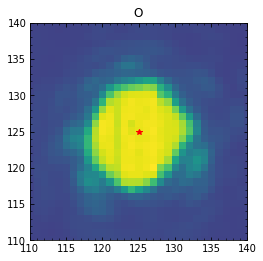

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03122.fits
bin_distcorr_lm_150104_03123.fits
8033.358208944636
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03123.fits: -0.10577621254837055, 0.04995451558052366


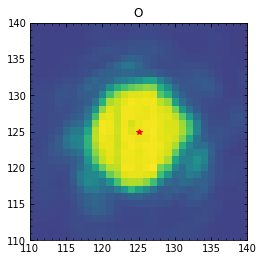

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03123.fits
bin_distcorr_lm_150104_03124.fits
8044.371835134796
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03124.fits: -0.1740276783076098, -0.8071488416641799


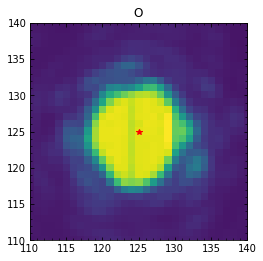

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03124.fits
bin_distcorr_lm_150104_03125.fits
8065.572011180038
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03125.fits: -0.18638717195253918, -0.7938855394693078


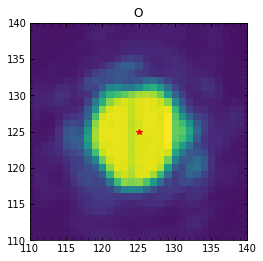

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03125.fits
bin_distcorr_lm_150104_03126.fits
8085.136074161306
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03126.fits: -0.2068679406607643, -0.7899215893140905


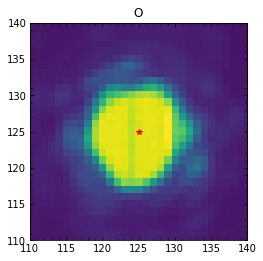

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03126.fits
bin_distcorr_lm_150104_03127.fits
8059.66278378932
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03127.fits: -0.2113024542988171, -0.7852013555415738


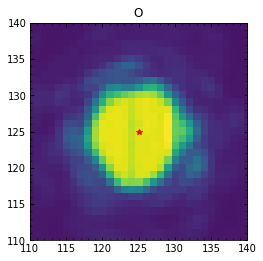

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03127.fits
bin_distcorr_lm_150104_03128.fits
8038.65803150613
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03128.fits: -0.2552858157733624, -0.793254759930548


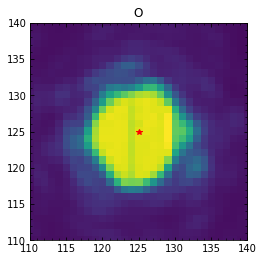

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03128.fits
bin_distcorr_lm_150104_03129.fits
8042.647804362769
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03129.fits: -0.2823105554817218, 0.18198311941738154


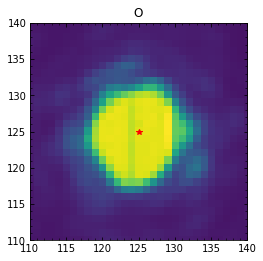

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03129.fits
bin_distcorr_lm_150104_03130.fits
8060.120221444215
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03130.fits: -0.21934229504445568, 0.16962483436858378


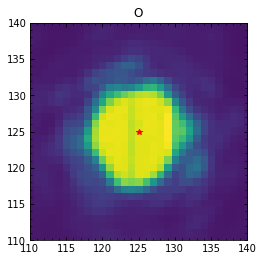

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03130.fits
bin_distcorr_lm_150104_03131.fits
8028.1135462188195
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03131.fits: -0.20134133062614978, -0.7826503541857335


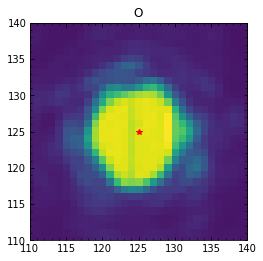

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03131.fits
bin_distcorr_lm_150104_03132.fits
8055.533473495445
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03132.fits: -0.218125059006681, -0.7889056954170073


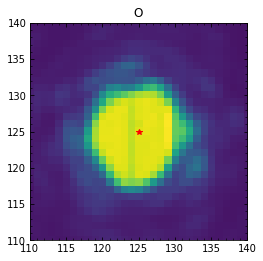

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03132.fits
bin_distcorr_lm_150104_03133.fits
8082.306365446437
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03133.fits: -0.21671358956932352, -0.7871161656268271


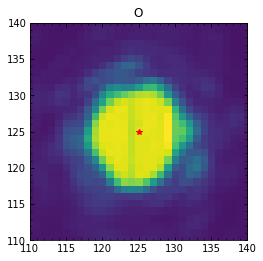

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03133.fits
bin_distcorr_lm_150104_03134.fits
8091.719423558188
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03134.fits: -0.21230271897582043, -0.7772980234383482


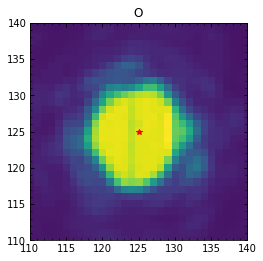

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03134.fits
bin_distcorr_lm_150104_03135.fits
8090.65362261006
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03135.fits: -0.2249391454828782, -0.7879827912859767


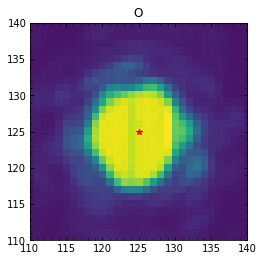

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03135.fits
bin_distcorr_lm_150104_03136.fits
8097.038631779347
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03136.fits: -0.2165487462121547, -0.7795334396286222


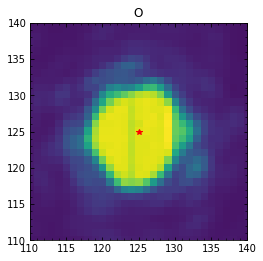

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03136.fits
bin_distcorr_lm_150104_03137.fits
8108.349602750344
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03137.fits: -0.20984034878117086, -0.7908611342440608


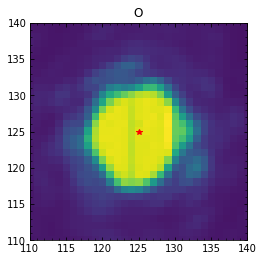

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03137.fits
bin_distcorr_lm_150104_03138.fits
8084.033993502855
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03138.fits: -0.22833963474195684, -0.7869981031335058


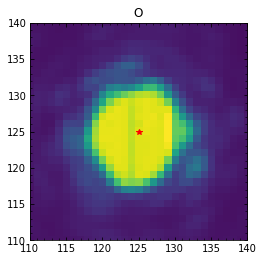

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03138.fits
bin_distcorr_lm_150104_03139.fits
8091.1249539816745
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03139.fits: -0.21459549596277583, -0.7953071781803231


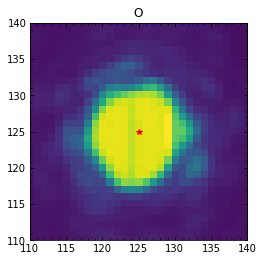

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03139.fits
bin_distcorr_lm_150104_03140.fits
8106.266435941363
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03140.fits: -0.20223090429025348, 0.18720914331515104


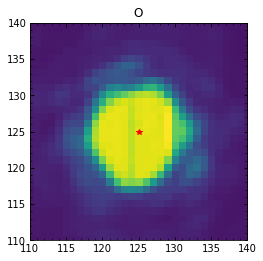

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03140.fits
bin_distcorr_lm_150104_03141.fits
8100.668121712659
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03141.fits: -0.23737542926498634, -0.7712757216649564


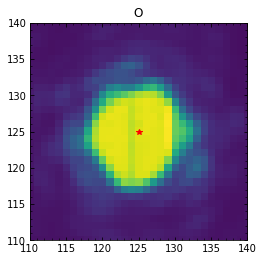

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03141.fits
bin_distcorr_lm_150104_03142.fits
8063.3809325256225
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03142.fits: -0.23295501780226147, -0.7965962878374597


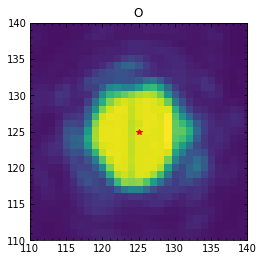

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03142.fits
bin_distcorr_lm_150104_03143.fits
8081.525006756383
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03143.fits: -0.21682075831017045, 0.19173121925250314


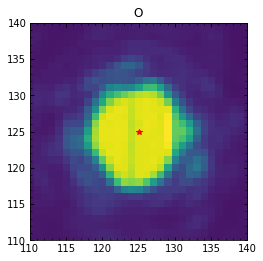

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03143.fits
bin_distcorr_lm_150104_03144.fits
8087.684268455164
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03144.fits: -0.19777634732824367, -0.7972625208005653


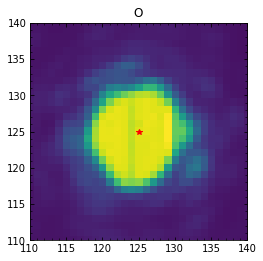

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03144.fits
bin_distcorr_lm_150104_03145.fits
8114.330684939539
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03145.fits: -0.2083356465419115, -0.801215579582319


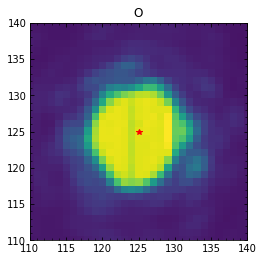

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03145.fits
bin_distcorr_lm_150104_03146.fits
8095.008102730367
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03146.fits: -0.21821774933643923, 0.19055750538897342


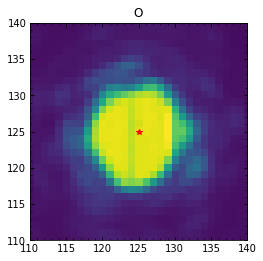

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03146.fits
bin_distcorr_lm_150104_03147.fits
8106.3512530458775
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03147.fits: -0.21418565192696803, -0.801559737057751


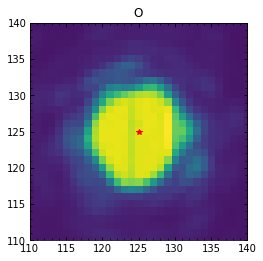

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03147.fits
bin_distcorr_lm_150104_03148.fits
8129.974808584087
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03148.fits: -0.2452994380621618, -0.7977613824073302


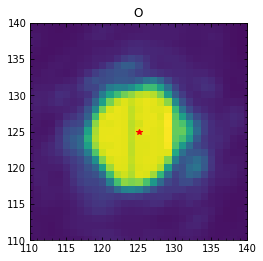

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03148.fits
bin_distcorr_lm_150104_03149.fits
8108.711213439507
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03149.fits: -0.25264078948352164, -0.7857923107133047


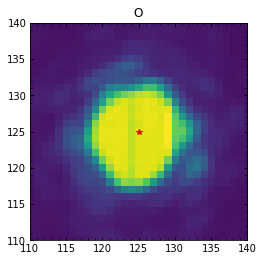

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03149.fits
bin_distcorr_lm_150104_03150.fits
8053.609383066794
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03150.fits: -0.2524613956135511, 0.18350912056218505


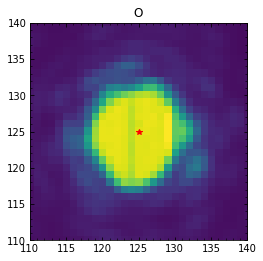

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03150.fits
bin_distcorr_lm_150104_03151.fits
8077.368632441512
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03151.fits: -0.25743482977593857, 0.17217500039379985


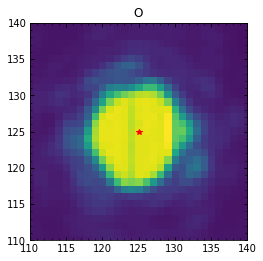

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03151.fits
bin_distcorr_lm_150104_03152.fits
8057.01555333357
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03152.fits: -0.21946124582015614, 0.18166708691539668


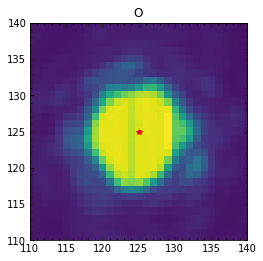

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03152.fits
bin_distcorr_lm_150104_03153.fits
8057.860454166786
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03153.fits: -0.2776758658573186, 0.18059004259652767


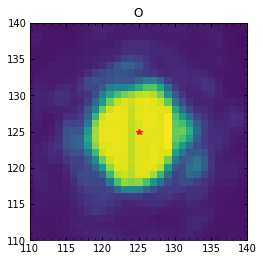

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03153.fits
bin_distcorr_lm_150104_03154.fits
8040.279029885968
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03154.fits: -0.23731675248293982, 0.17652081971057498


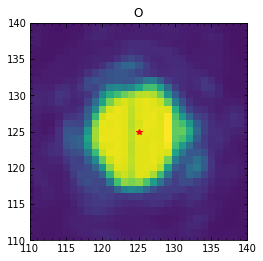

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03154.fits
bin_distcorr_lm_150104_03155.fits
8064.944516153962
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03155.fits: -0.2155826285436575, 0.18181954052855076


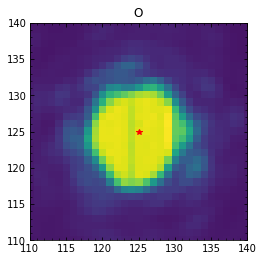

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03155.fits
bin_distcorr_lm_150104_03156.fits
8041.041312486546
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03156.fits: -0.2739536385148611, 0.186610382214198


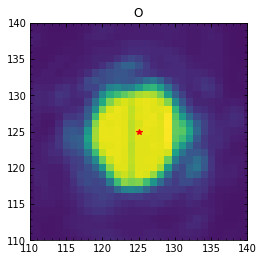

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03156.fits
bin_distcorr_lm_150104_03157.fits
8004.165075358668
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03157.fits: -0.26909720640806256, -0.7989606769312445


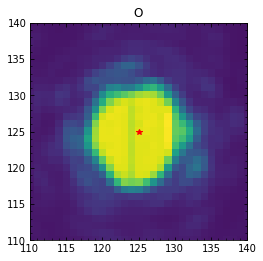

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03157.fits
bin_distcorr_lm_150104_03158.fits
8056.323774311841
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03158.fits: -0.2543350505899795, 0.18747344562880386


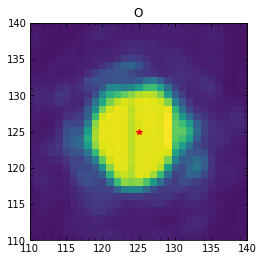

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03158.fits
bin_distcorr_lm_150104_03159.fits
8083.4508312656
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03159.fits: -0.25880525152965106, 0.18245793507376362


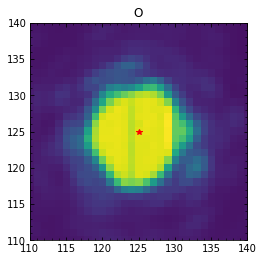

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03159.fits
bin_distcorr_lm_150104_03160.fits
8058.173451201364
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03160.fits: -0.22959121193675713, 0.18396340429060842


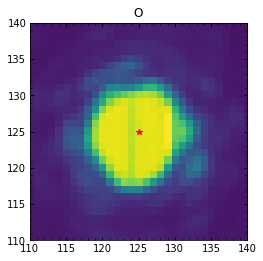

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03160.fits
bin_distcorr_lm_150104_03161.fits
8064.913632002835
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03161.fits: -0.26705919527282873, -0.8039606505629919


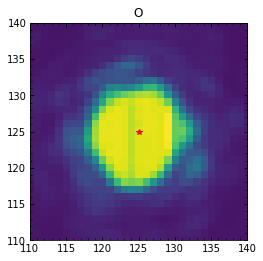

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03161.fits
bin_distcorr_lm_150104_03162.fits
8053.599670094824
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03162.fits: -0.2380306888253827, 0.18013711657942366


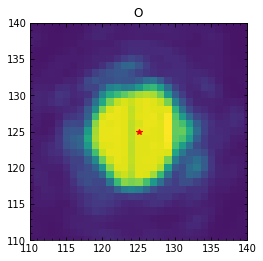

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03162.fits
bin_distcorr_lm_150104_03163.fits
8079.784170127534
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03163.fits: -0.272383049195696, 0.1871255577809734


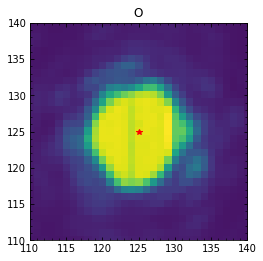

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03163.fits
bin_distcorr_lm_150104_03164.fits
8069.821801841176
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03164.fits: -0.2628519779669958, 0.17499425507133992


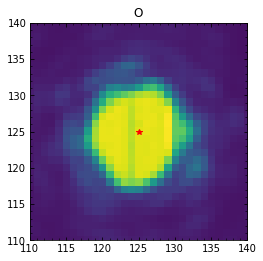

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03164.fits
bin_distcorr_lm_150104_03165.fits
8087.647689895488
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03165.fits: -0.2512024295827189, 0.18360538571269558


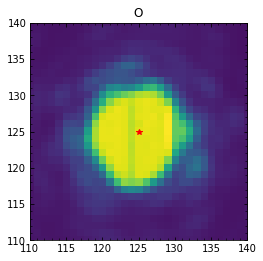

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03165.fits
bin_distcorr_lm_150104_03166.fits
8071.0491736144395
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03166.fits: -0.27647361296330786, 0.18914599302001278


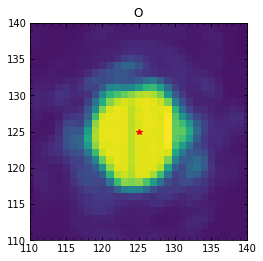

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03166.fits
bin_distcorr_lm_150104_03167.fits
8085.641280893869
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03167.fits: -0.2554972410094294, 0.17054870591933735


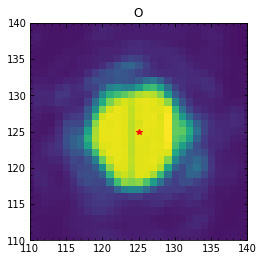

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03167.fits
bin_distcorr_lm_150104_03168.fits
8057.840834370138
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03168.fits: -0.2892489733521941, 0.17215018288983686


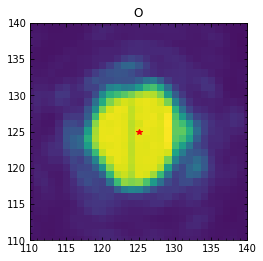

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03168.fits
bin_distcorr_lm_150104_03169.fits
8060.909236573259
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03169.fits: -0.2710278980768024, 0.15263840330782585


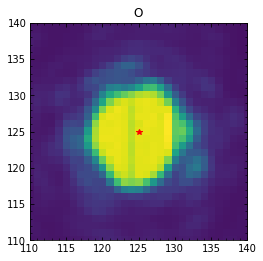

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03169.fits
bin_distcorr_lm_150104_03170.fits
8073.483217387464
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03170.fits: -0.2901523406727833, 0.15632011690684777


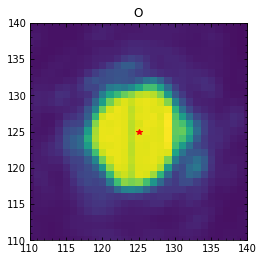

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03170.fits
bin_distcorr_lm_150104_03171.fits
8068.407286309595
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03171.fits: -0.2964272844697291, 0.1678694056140415


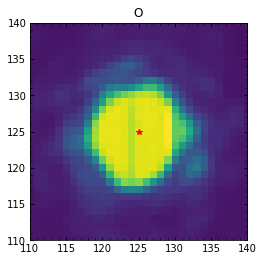

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03171.fits
bin_distcorr_lm_150104_03172.fits
8071.957777458104
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03172.fits: -0.2892156759319633, 0.16388050051083525


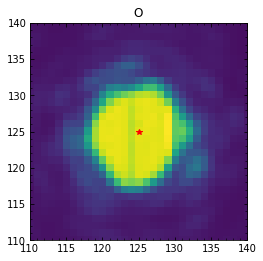

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03172.fits
bin_distcorr_lm_150104_03173.fits
8048.808623536759
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03173.fits: -0.32067604104301495, 0.16459696099485654


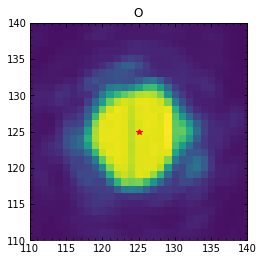

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03173.fits
bin_distcorr_lm_150104_03174.fits
8087.202554500815
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03174.fits: -0.3010791192509288, 0.14406680179981635


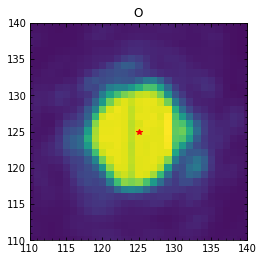

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03174.fits
bin_distcorr_lm_150104_03175.fits
8082.9538572888005
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03175.fits: -0.32076854899300855, 0.1720743775292206


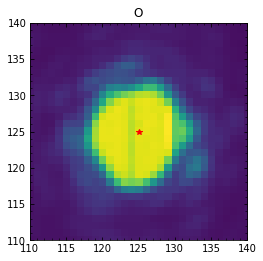

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03175.fits
bin_distcorr_lm_150104_03176.fits
8052.840468015729
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03176.fits: -0.32561865506784926, 0.17095387245078086


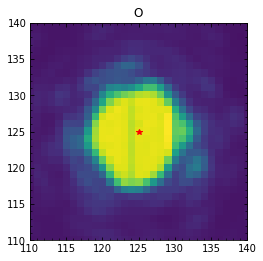

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03176.fits
bin_distcorr_lm_150104_03177.fits
8043.497694197876
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03177.fits: -0.34776645606012124, 0.1706329265210158


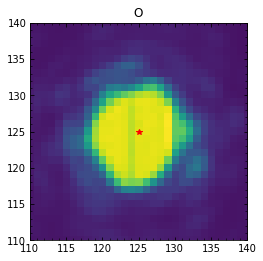

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03177.fits
bin_distcorr_lm_150104_03178.fits
8071.416567453849
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03178.fits: -0.3191557110088823, 0.16617590439675212


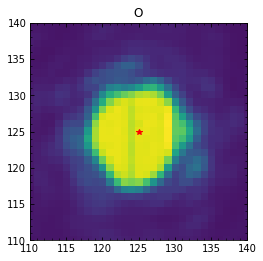

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03178.fits
bin_distcorr_lm_150104_03179.fits
8050.2424212167825
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03179.fits: -0.31043309256472895, -0.7996318978929295


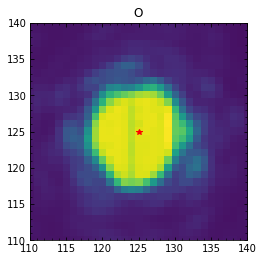

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03179.fits
bin_distcorr_lm_150104_03180.fits
8020.40908320778
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03180.fits: -0.29801068789248575, -0.7946495739096093


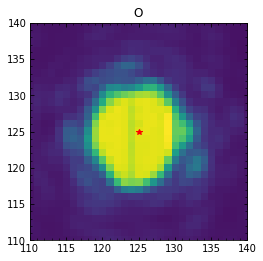

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03180.fits
bin_distcorr_lm_150104_03181.fits
8022.920810016557
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03181.fits: -0.3541346720804128, -0.8086204423518737


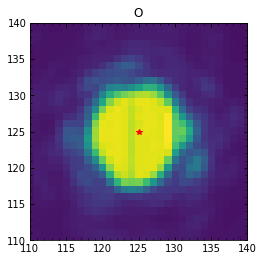

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03181.fits
bin_distcorr_lm_150104_03182.fits
8033.457592673449
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03182.fits: -0.3719276952423911, 0.18182926322938897


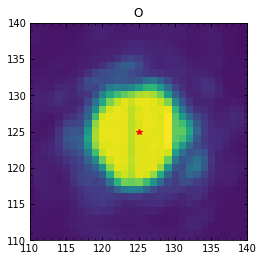

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03182.fits
bin_distcorr_lm_150104_03183.fits
8007.409394330163
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03183.fits: -0.3558303604708115, -0.811585250147715


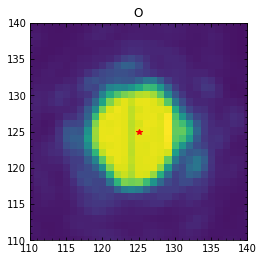

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03183.fits
bin_distcorr_lm_150104_03184.fits
8020.546657596666
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03184.fits: -0.33827887799310474, 0.18591829552953243


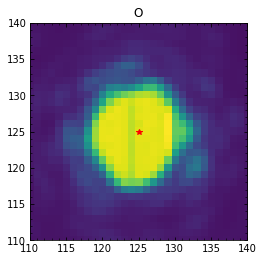

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03184.fits
bin_distcorr_lm_150104_03185.fits
8079.20751822881
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03185.fits: -0.3503682350373154, -0.7973015255005578


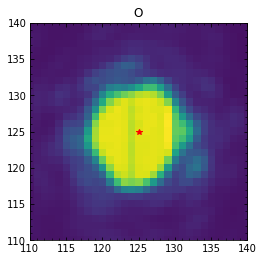

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03185.fits
bin_distcorr_lm_150104_03186.fits
8030.011064095375
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03186.fits: -0.3693017697374472, -0.7935160310933327


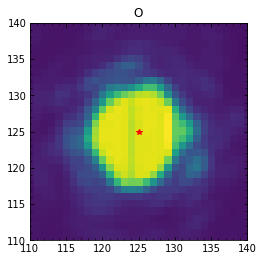

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03186.fits
bin_distcorr_lm_150104_03187.fits
7988.4398910722875
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03187.fits: -0.34984293579571357, 0.17196998251918671


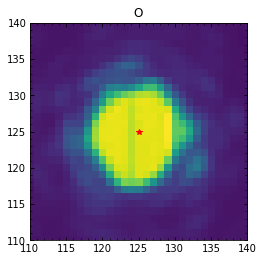

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03187.fits
bin_distcorr_lm_150104_03188.fits
8011.20498219259
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03188.fits: -0.355669524179163, 0.17519052522569467


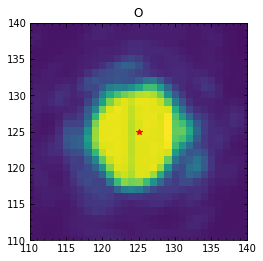

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03188.fits
bin_distcorr_lm_150104_03189.fits
8040.126621328924
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03189.fits: -0.35025702629188515, 0.1895160694867073


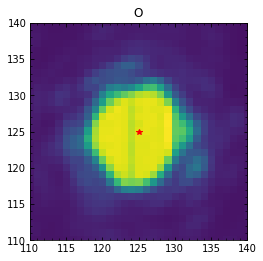

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03189.fits
bin_distcorr_lm_150104_03190.fits
8015.220423073088
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03190.fits: -0.3619050940488009, -0.7991941450590119


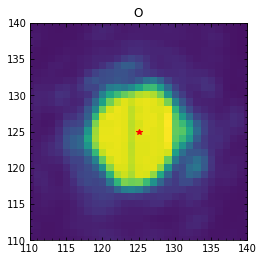

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03190.fits
bin_distcorr_lm_150104_03191.fits
8000.763453346013
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03191.fits: -0.35515236339994516, 0.19507415678084783


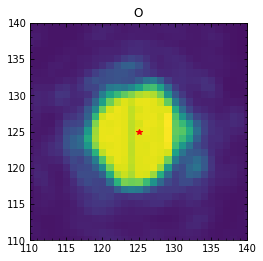

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03191.fits
bin_distcorr_lm_150104_03192.fits
8031.789030574813
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03192.fits: -0.3502182350304608, 0.19254757580289095


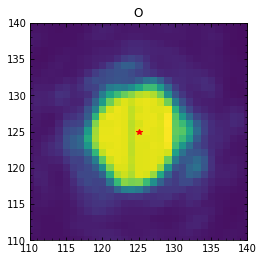

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03192.fits
bin_distcorr_lm_150104_03193.fits
8070.2685935590225
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03193.fits: -0.322450125784016, -0.7851797415431889


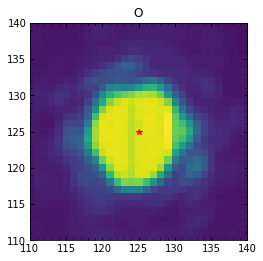

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03193.fits
bin_distcorr_lm_150104_03194.fits
8074.360831567301
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03194.fits: -0.32595535898769157, -0.7578710438359266


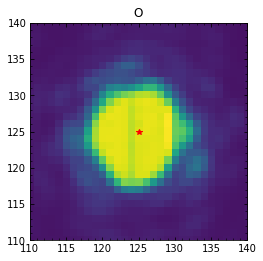

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03194.fits
bin_distcorr_lm_150104_03195.fits
8058.358654997528
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03195.fits: -0.39824193712858147, -0.7852584781542404


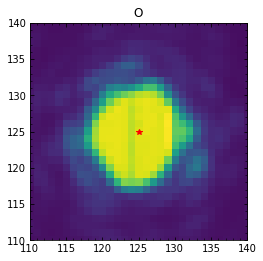

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03195.fits
bin_distcorr_lm_150104_03196.fits
8109.666871278836
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03196.fits: -0.37580100767085156, 0.17857243676240842


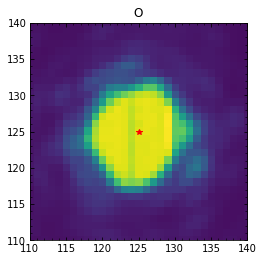

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03196.fits
bin_distcorr_lm_150104_03197.fits
8088.930994022121
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03197.fits: -0.3552503312504527, 0.18187042422187716


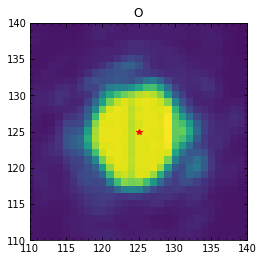

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03197.fits
bin_distcorr_lm_150104_03198.fits
8066.155960850605
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03198.fits: -0.35374787871332103, -0.7882178987115651


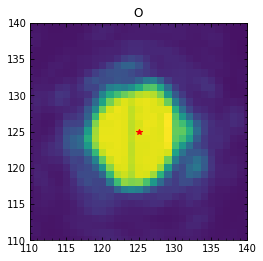

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03198.fits
bin_distcorr_lm_150104_03199.fits
8059.82273476833
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03199.fits: -0.3561492084373441, 0.16636824561524577


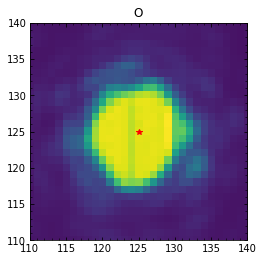

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03199.fits
bin_distcorr_lm_150104_03200.fits
8056.503572980049
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03200.fits: -0.37417715730244083, -0.7856456823740459


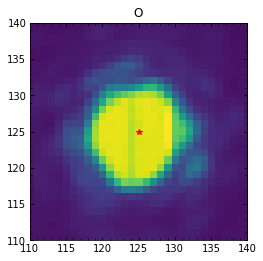

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03200.fits
bin_distcorr_lm_150104_03201.fits
8047.841827914502
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03201.fits: -0.3866468515410375, 0.17945926261759126


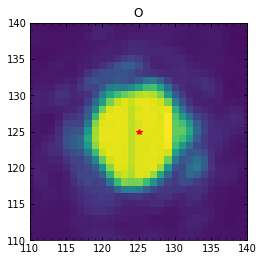

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03201.fits
bin_distcorr_lm_150104_03202.fits
8022.260907310848
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03202.fits: -0.3650867424394164, 0.17618534639996142


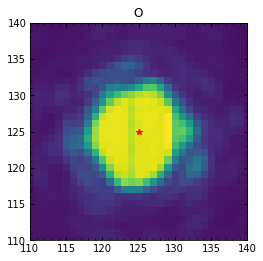

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03202.fits
bin_distcorr_lm_150104_03203.fits
8068.874909227036
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03203.fits: -0.3476502504805765, 0.1835237666907048


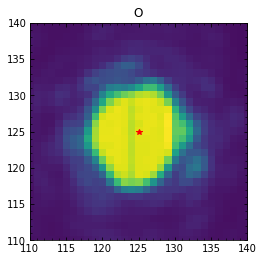

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03203.fits
bin_distcorr_lm_150104_03204.fits
8088.656783152368
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03204.fits: -0.3570299583379395, 0.17202813088482571


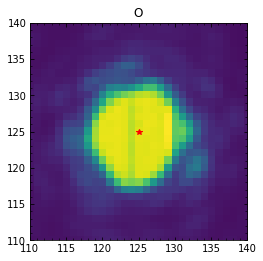

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03204.fits
bin_distcorr_lm_150104_03205.fits
8098.701673904108
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03205.fits: -0.3674181223005206, 0.18032919484429755


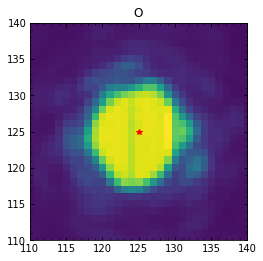

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03205.fits
bin_distcorr_lm_150104_03206.fits
8071.2755345650185
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03206.fits: -0.3752963988084659, 0.19136077573701726


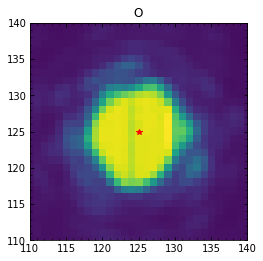

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03206.fits
bin_distcorr_lm_150104_03207.fits
8097.831647773496
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03207.fits: -0.3434604402452308, -0.7975216559042906


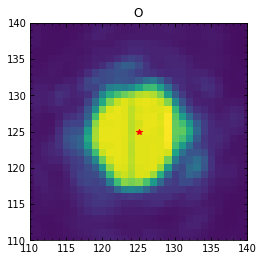

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03207.fits
bin_distcorr_lm_150104_03208.fits
8122.06752199313
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03208.fits: -0.3320866680538117, 0.18039718708296704


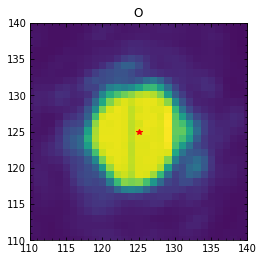

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03208.fits
bin_distcorr_lm_150104_03209.fits
8073.7851753907125
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03209.fits: -0.3530477097188367, 0.18809061715207775


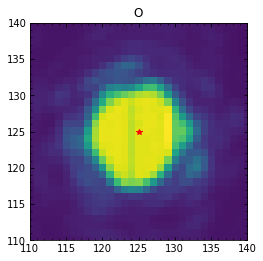

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03209.fits
bin_distcorr_lm_150104_03210.fits
8064.386691921707
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03210.fits: -0.35340225282367044, -0.7928365015768009


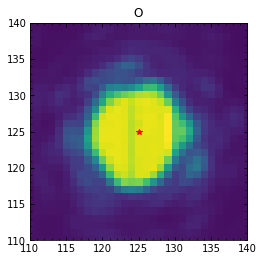

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03210.fits
bin_distcorr_lm_150104_03211.fits
8075.531681574598
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03211.fits: -0.3550101196931763, -0.785916174002331


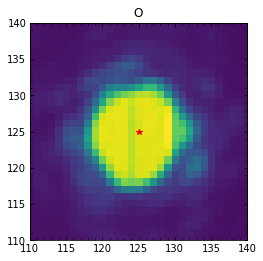

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03211.fits
bin_distcorr_lm_150104_03212.fits
8079.308650943131
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03212.fits: -0.3473295498915263, 0.1715224075640407


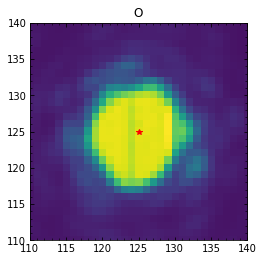

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03212.fits
bin_distcorr_lm_150104_03213.fits
8072.104314938875
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03213.fits: -0.3627950171414156, 0.17825787360752088


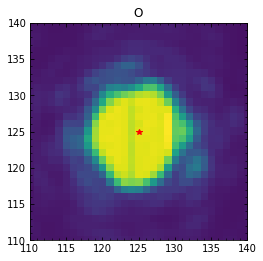

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03213.fits
bin_distcorr_lm_150104_03214.fits
8105.768549249726
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03214.fits: -0.34679774814279796, 0.17090608017882403


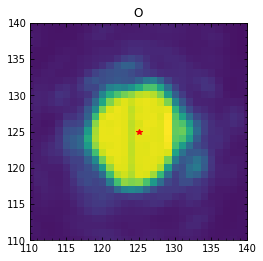

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03214.fits
bin_distcorr_lm_150104_03215.fits
8107.420065392237
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03215.fits: -0.3478689164918407, 0.1756551827159214


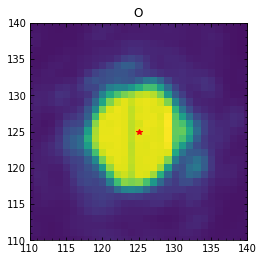

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03215.fits
bin_distcorr_lm_150104_03216.fits
8060.514327431278
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03216.fits: -0.35531102907177825, 0.17736406415929196


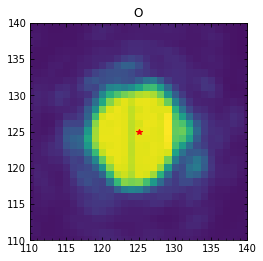

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03216.fits
bin_distcorr_lm_150104_03217.fits
8089.206320088523
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03217.fits: -0.3708163665719866, 0.17594144276286983


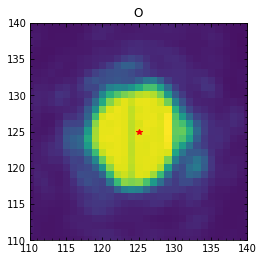

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03217.fits
bin_distcorr_lm_150104_03218.fits
8090.211717812388
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03218.fits: -0.33184877376442756, -0.8017292324038081


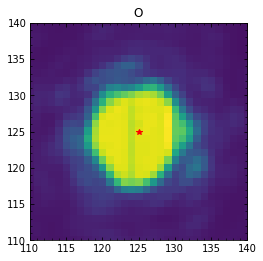

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03218.fits
bin_distcorr_lm_150104_03219.fits
8094.786528219085
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03219.fits: -0.3621439534753108, 0.17725713485335604


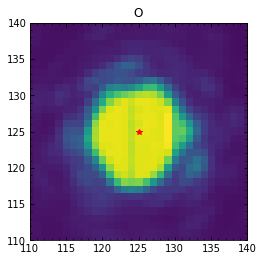

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03219.fits
bin_distcorr_lm_150104_03220.fits
8065.440254919471
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03220.fits: -0.3816797715069171, 0.1845671256084529


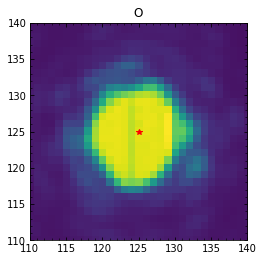

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03220.fits
bin_distcorr_lm_150104_03221.fits
8087.036810241709
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03221.fits: -0.3815368001400401, 0.18349695367434293


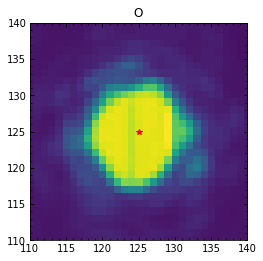

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03221.fits
bin_distcorr_lm_150104_03222.fits
8114.748274110917
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03222.fits: -0.35715908633116555, 0.19475702520617943


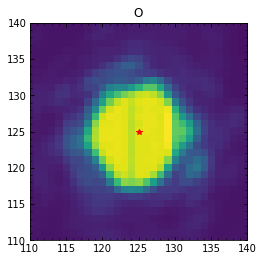

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03222.fits
bin_distcorr_lm_150104_03223.fits
8085.104186292047
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03223.fits: -0.39029764713306037, 0.1784599621929246


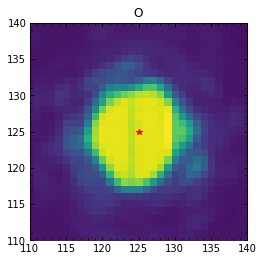

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03223.fits
bin_distcorr_lm_150104_03224.fits
8058.610749719493
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03224.fits: -0.3687440989611588, 0.16887866127789408


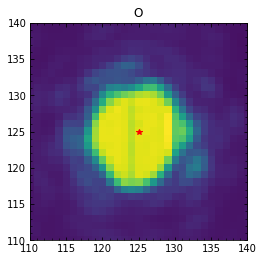

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03224.fits
bin_distcorr_lm_150104_03225.fits
8088.727349720745
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03225.fits: -0.3875500976348647, 0.17786949048426948


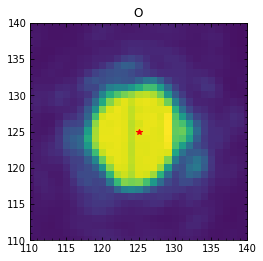

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03225.fits
bin_distcorr_lm_150104_03226.fits
8091.896224579597
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03226.fits: -0.37054580712445784, -0.8016103021263206


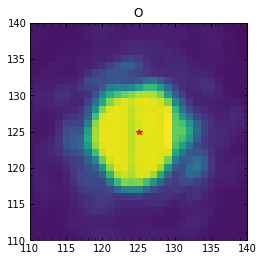

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03226.fits
bin_distcorr_lm_150104_03227.fits
8072.940367969853
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03227.fits: -0.37365160369642325, 0.17530027511878643


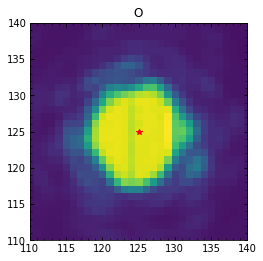

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03227.fits
bin_distcorr_lm_150104_03228.fits
8058.048985175392
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03228.fits: -0.4254254580171377, 0.19030656225839238


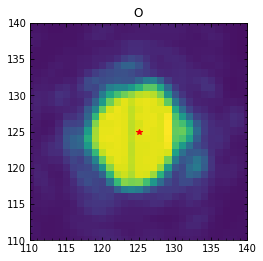

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03228.fits
bin_distcorr_lm_150104_03229.fits
8073.697836762785
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03229.fits: -0.4008936587772993, -0.775819423722794


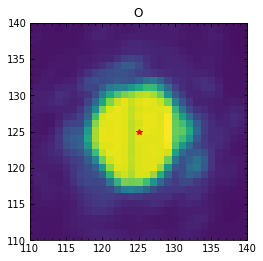

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03229.fits
bin_distcorr_lm_150104_03230.fits
8069.545793554417
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03230.fits: -0.41424065686646117, -0.7700786858035542


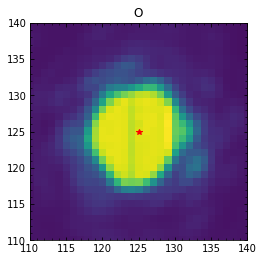

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03230.fits
bin_distcorr_lm_150104_03231.fits
8056.8128167164095
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03231.fits: -0.404349422046991, 0.1853697337239879


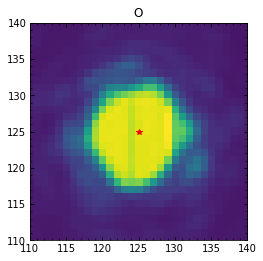

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03231.fits
bin_distcorr_lm_150104_03232.fits
8037.430354045877
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03232.fits: -0.3862689192884545, 0.15714793703088503


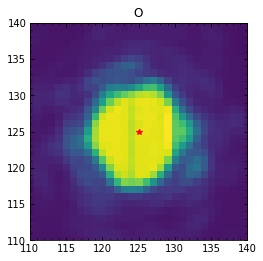

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03232.fits
bin_distcorr_lm_150104_03233.fits
8076.8361569836725
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03233.fits: -0.3481147497407022, 0.16778665259085557


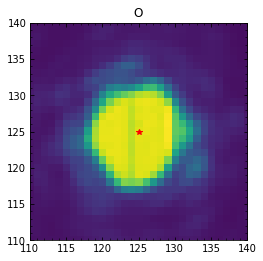

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03233.fits
bin_distcorr_lm_150104_03234.fits
8066.207939426497
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03234.fits: -0.3565424369903596, 0.16261122188418398


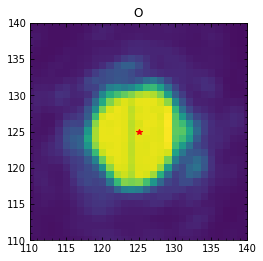

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03234.fits
bin_distcorr_lm_150104_03235.fits
8066.208629260151
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03235.fits: -0.36851969128687045, 0.1634903134790946


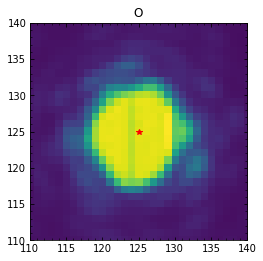

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03235.fits
bin_distcorr_lm_150104_03236.fits
8067.400334748915
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03236.fits: -0.3869293638996254, -0.8010105045375155


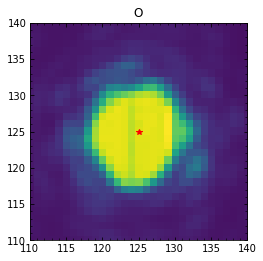

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03236.fits
bin_distcorr_lm_150104_03237.fits
8086.556223815271
STARTING  O
X: 186  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03237.fits: -0.37327962126416736, -0.8032883911964035


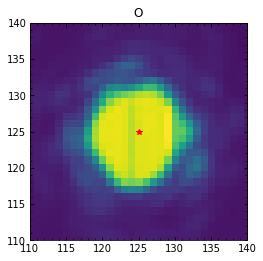

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03237.fits
bin_distcorr_lm_150104_03238.fits
8063.927718834114
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03238.fits: -0.3944391974368955, 0.17440852324536138


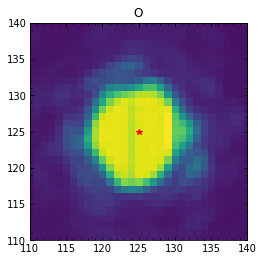

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03238.fits
bin_distcorr_lm_150104_03239.fits
8059.9655745132595
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03239.fits: -0.37756226937577964, 0.16565707049095124


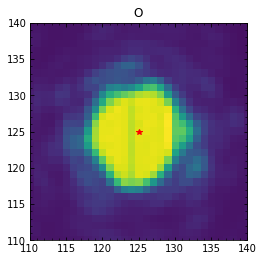

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03239.fits
bin_distcorr_lm_150104_03240.fits
8079.411664432937
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03240.fits: -0.41208271309648836, 0.1560538629941206


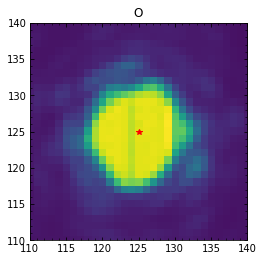

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03240.fits
bin_distcorr_lm_150104_03241.fits
8089.280673831352
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03241.fits: -0.40329189611350813, 0.17378972089338873


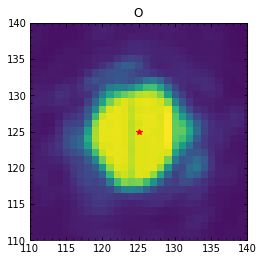

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03241.fits
bin_distcorr_lm_150104_03242.fits
8064.621091918603
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03242.fits: -0.41465917582009126, 0.1741290472724728


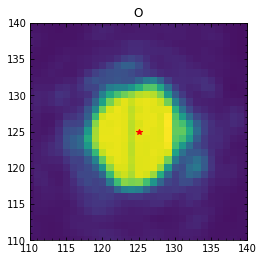

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03242.fits
bin_distcorr_lm_150104_03243.fits
8051.520742391597
STARTING  O
X: 187  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03243.fits: -0.38984645841435395, 0.14271968446119843


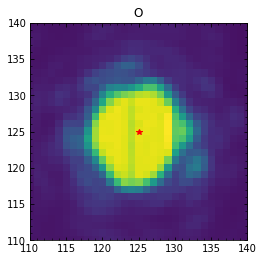

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03243.fits
bin_distcorr_lm_150104_03244.fits
7969.754416564222
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03244.fits: -0.07543607540850417, 0.000411696149122065


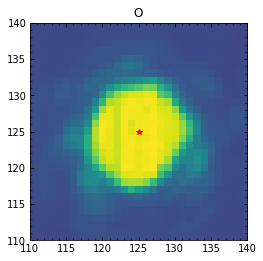

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03244.fits
bin_distcorr_lm_150104_03245.fits
7961.209263630709
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03245.fits: -0.07465351610602511, -0.02424749387316183


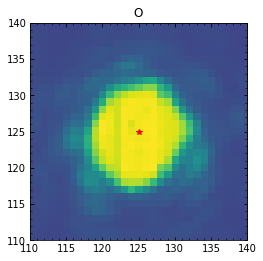

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03245.fits
bin_distcorr_lm_150104_03246.fits
7965.104680157598
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03246.fits: -0.11128571031579071, -0.028654047387071557


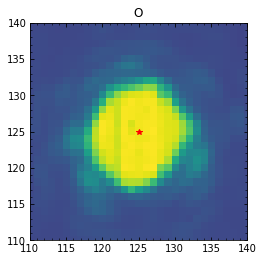

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03246.fits
bin_distcorr_lm_150104_03247.fits
8011.292328022806
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03247.fits: -0.09345746739730743, -0.005004691336424116


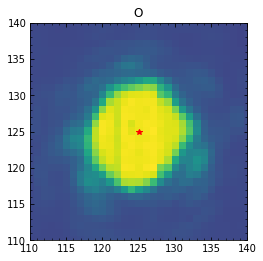

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03247.fits
bin_distcorr_lm_150104_03248.fits
8048.869948049467
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03248.fits: -0.12737590482735328, 0.015818782528590702


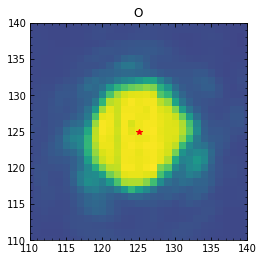

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03248.fits
bin_distcorr_lm_150104_03249.fits
7996.237938434666
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03249.fits: -0.08411894147749877, 0.006971933323349333


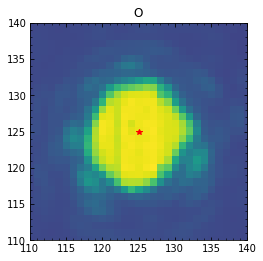

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03249.fits
bin_distcorr_lm_150104_03250.fits
8024.112529962742
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03250.fits: -0.06960198574693521, -0.010446117598355897


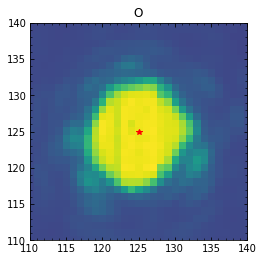

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03250.fits
bin_distcorr_lm_150104_03251.fits
8033.30887862959
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03251.fits: -0.08584887296181165, 0.02721038782529206


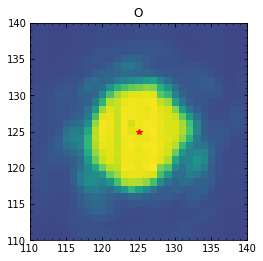

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03251.fits
bin_distcorr_lm_150104_03252.fits
8017.835418777804
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03252.fits: -0.07279607130663379, 0.009325904983334965


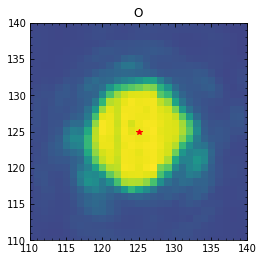

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03252.fits
bin_distcorr_lm_150104_03253.fits
8023.476466351832
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03253.fits: -0.13249553780983092, 0.011653744202689609


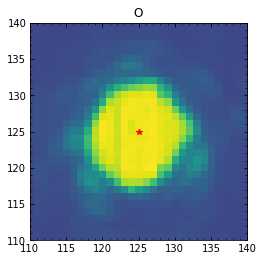

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03253.fits
bin_distcorr_lm_150104_03254.fits
8055.864888750322
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03254.fits: -0.11557312029143674, 0.016063083871280526


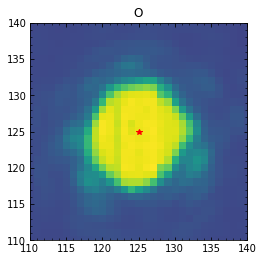

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03254.fits
bin_distcorr_lm_150104_03255.fits
8078.25440157451
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03255.fits: -0.10386423751118201, -0.012963380996481533


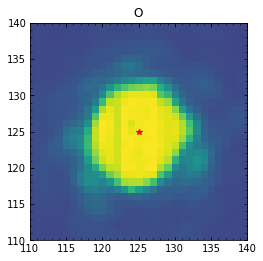

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03255.fits
bin_distcorr_lm_150104_03256.fits
8039.92869172054
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03256.fits: -0.09055456315496002, 0.00035972618218238495


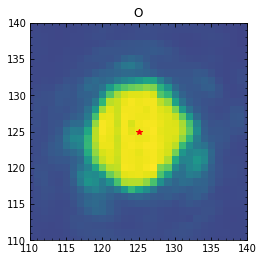

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03256.fits
bin_distcorr_lm_150104_03257.fits
8032.879905589426
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03257.fits: -0.0969701308688471, -0.0025152745417713618


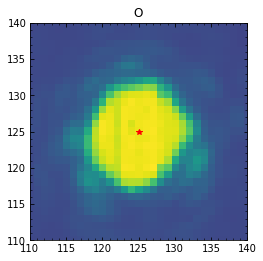

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03257.fits
bin_distcorr_lm_150104_03258.fits
8050.244947664684
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03258.fits: -0.11320966181163783, -0.015859186085890542


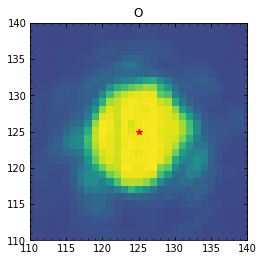

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03258.fits
bin_distcorr_lm_150104_03259.fits
8058.30178352478
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03259.fits: -0.0966457158605678, -0.013733854226167352


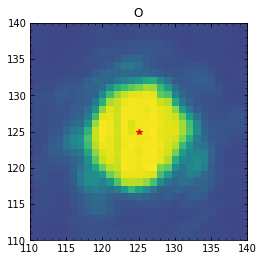

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03259.fits
bin_distcorr_lm_150104_03260.fits
8024.074856335494
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03260.fits: -1.0535194205907104, -0.04339947327120797


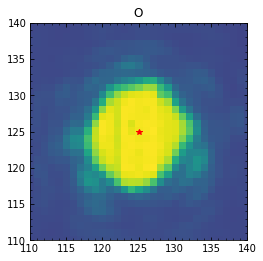

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03260.fits
bin_distcorr_lm_150104_03261.fits
8027.1907381143155
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03261.fits: -0.08242003611783133, 0.0037098183248858163


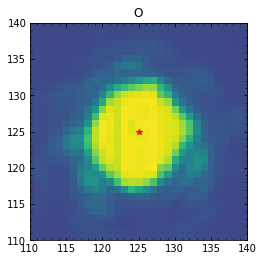

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03261.fits
bin_distcorr_lm_150104_03262.fits
8060.534182634804
STARTING  O
X: 191  Y: 132  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03262.fits: -1.0498477018153594, 0.006476243771473378


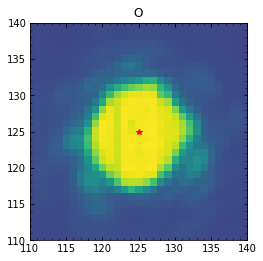

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03262.fits
bin_distcorr_lm_150104_03263.fits
8025.8712767219
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03263.fits: -0.10704230272938275, 0.00815991714214448


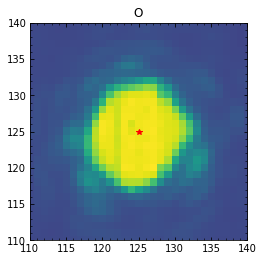

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03263.fits
bin_distcorr_lm_150104_03264.fits
8012.658283068988
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03264.fits: -0.08720209704635806, -0.009180255149892957


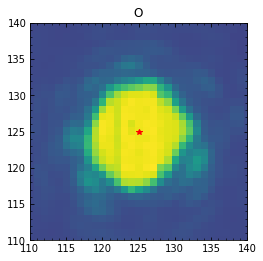

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03264.fits
bin_distcorr_lm_150104_03265.fits
8057.0403961493375
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03265.fits: -0.08627910611272682, -0.009657446181861928


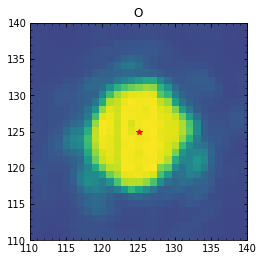

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03265.fits
bin_distcorr_lm_150104_03266.fits
8069.796661572277
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03266.fits: -0.09417183938546714, -0.017626437880693402


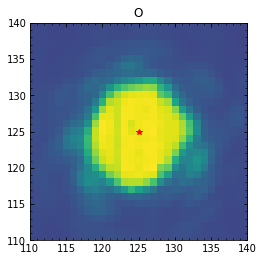

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03266.fits
bin_distcorr_lm_150104_03267.fits
8041.93917950162
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03267.fits: -0.1008378662537126, -0.0023113500866429604


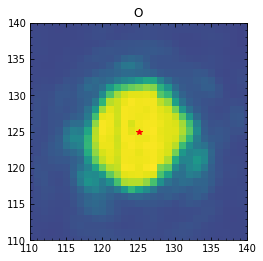

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03267.fits
bin_distcorr_lm_150104_03268.fits
8035.619698492778
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03268.fits: -0.10222817030339826, 0.01589124392428687


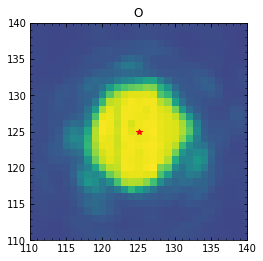

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03268.fits
bin_distcorr_lm_150104_03269.fits
8029.695123746302
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03269.fits: -0.09172746341157989, -0.004486318710817727


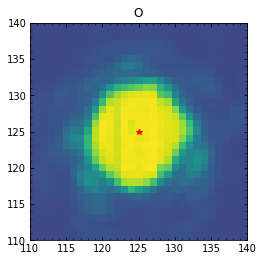

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03269.fits
bin_distcorr_lm_150104_03270.fits
8042.09427209131
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03270.fits: -0.09318145178982462, 0.0007725603543420334


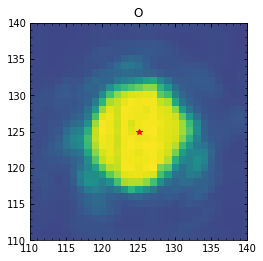

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03270.fits
bin_distcorr_lm_150104_03271.fits
8022.63850752631
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03271.fits: -0.09774743441986544, -0.020664952187715357


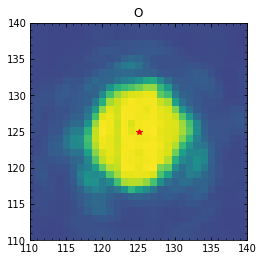

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03271.fits
bin_distcorr_lm_150104_03272.fits
8041.519210491577
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03272.fits: -0.08434409074131821, -0.03453039151541759


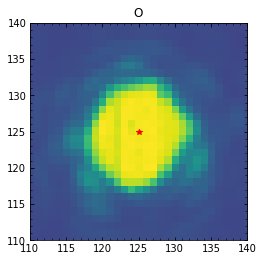

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03272.fits
bin_distcorr_lm_150104_03273.fits
8069.644326799478
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03273.fits: -0.11269826654466186, -0.024054799377488223


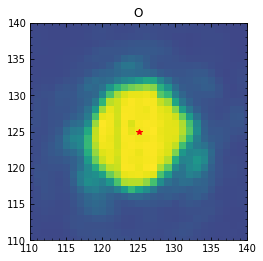

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03273.fits
bin_distcorr_lm_150104_03274.fits
8057.498526139494
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03274.fits: -0.11150485463936377, -0.013346814279707075


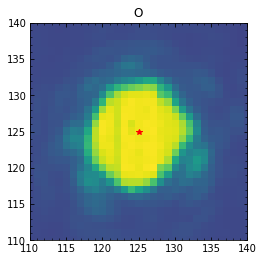

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03274.fits
bin_distcorr_lm_150104_03275.fits
8003.103612703095
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03275.fits: -0.11547991096821875, -0.00678171186876142


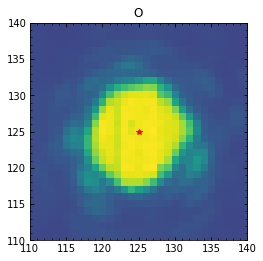

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03275.fits
bin_distcorr_lm_150104_03276.fits
8032.9457057494365
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03276.fits: -0.09450779755075445, -0.01559699533954273


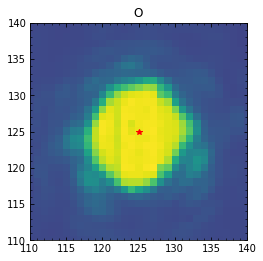

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03276.fits
bin_distcorr_lm_150104_03277.fits
8008.967136025888
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03277.fits: -0.12979047629315943, -0.02533582554499958


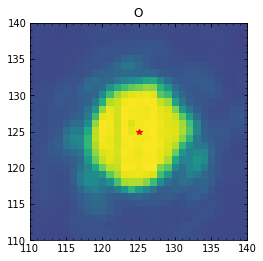

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03277.fits
bin_distcorr_lm_150104_03278.fits
7992.330326537916
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03278.fits: -0.16644466823888848, -0.05370637991592986


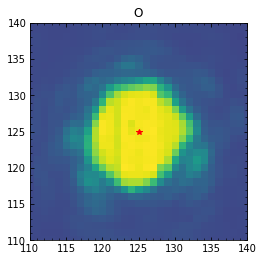

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03278.fits
bin_distcorr_lm_150104_03279.fits
7976.417396011567
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03279.fits: -0.1280620447984404, -0.007262466781924104


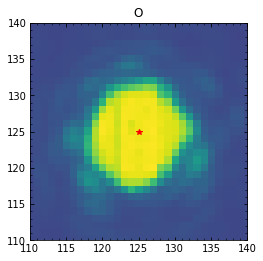

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03279.fits
bin_distcorr_lm_150104_03280.fits
8011.29970176975
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03280.fits: -0.12524503703892265, -0.023357142756566418


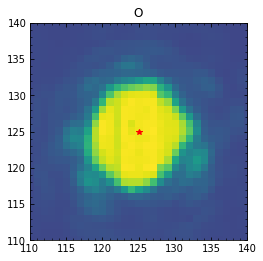

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03280.fits
bin_distcorr_lm_150104_03281.fits
8017.230006257994
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03281.fits: -0.10912973701552175, -0.026311116154538183


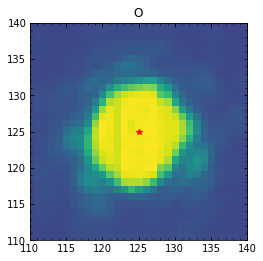

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03281.fits
bin_distcorr_lm_150104_03282.fits
8016.578083691813
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03282.fits: -0.0891828564155972, -0.048666150703951416


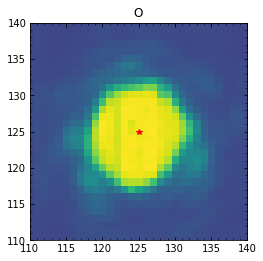

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03282.fits
bin_distcorr_lm_150104_03283.fits
7990.589732863398
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03283.fits: -0.09432152731245225, -0.04513812530248629


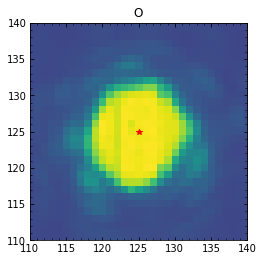

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03283.fits
bin_distcorr_lm_150104_03284.fits
8013.666948698478
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03284.fits: -0.12458948527001468, -0.03705671901881402


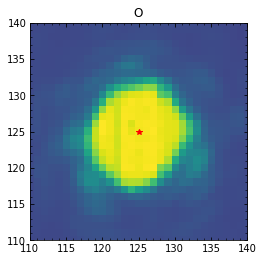

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03284.fits
bin_distcorr_lm_150104_03285.fits
8006.194143382592
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03285.fits: -0.12564332212728146, -0.021242155388080164


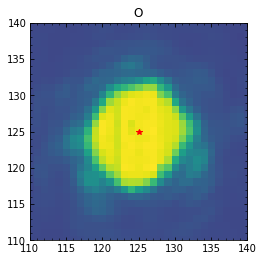

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03285.fits
bin_distcorr_lm_150104_03286.fits
7994.224861703786
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03286.fits: -0.1417872780638092, -0.0350526416431407


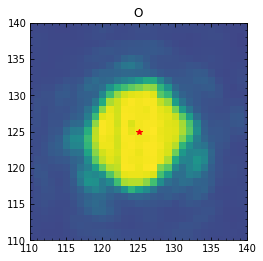

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03286.fits
bin_distcorr_lm_150104_03287.fits
8014.722597011266
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03287.fits: -0.12560658618279064, -0.01425810335955191


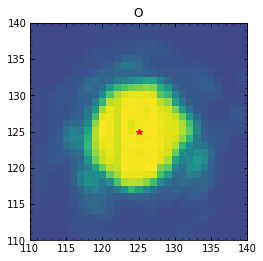

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03287.fits
bin_distcorr_lm_150104_03288.fits
8064.339683103124
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03288.fits: -0.13263221465680175, -0.009488409756222893


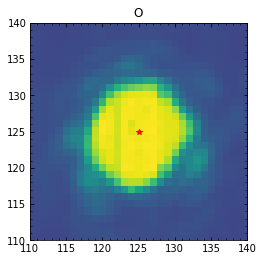

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03288.fits
bin_distcorr_lm_150104_03289.fits
8035.305945226205
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03289.fits: -0.1182796327474378, -0.020758880529122337


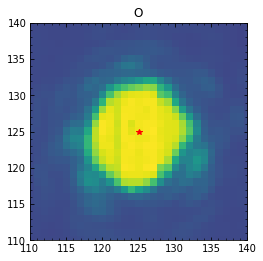

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03289.fits
bin_distcorr_lm_150104_03290.fits
7991.756267983132
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03290.fits: -0.13774083673784077, -0.03369680476436088


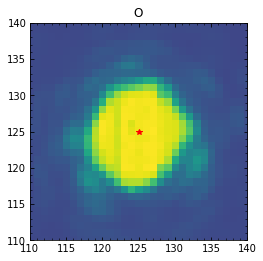

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03290.fits
bin_distcorr_lm_150104_03291.fits
8017.838532406891
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03291.fits: -0.08820466225354551, -0.06574208650175706


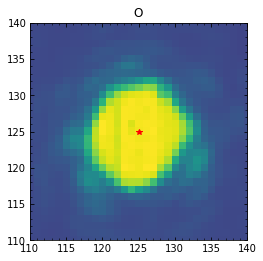

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03291.fits
bin_distcorr_lm_150104_03292.fits
8042.750491509383
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03292.fits: -0.09503062650519212, -0.06166933148730891


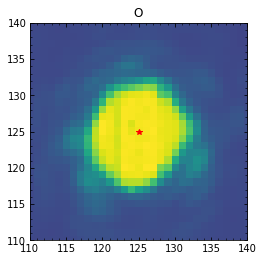

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03292.fits
bin_distcorr_lm_150104_03293.fits
8007.636184448186
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03293.fits: -0.11709040756161215, -0.04506669166205057


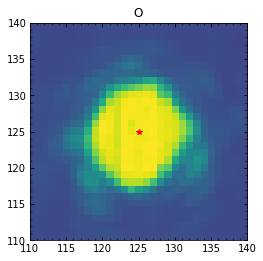

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03293.fits
bin_distcorr_lm_150104_03294.fits
7948.54808783033
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03294.fits: -0.1235030508235937, -0.035641855239774145


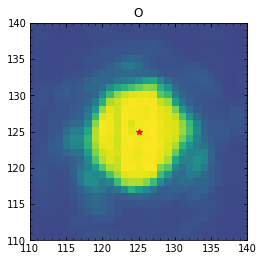

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03294.fits
bin_distcorr_lm_150104_03295.fits
7952.634547606806
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03295.fits: -0.12250774399415576, -0.043764879028792336


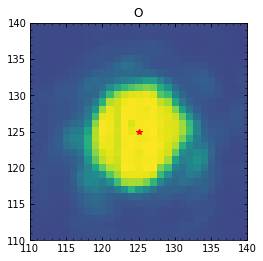

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03295.fits
bin_distcorr_lm_150104_03296.fits
8041.254362806614
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03296.fits: -0.16195130742226382, -0.050086081866972165


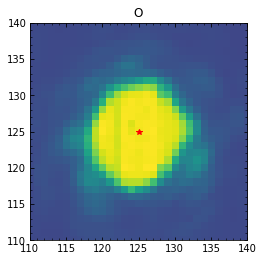

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03296.fits
bin_distcorr_lm_150104_03297.fits
8004.123032833976
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03297.fits: -0.13985552810951418, -0.04891225444603009


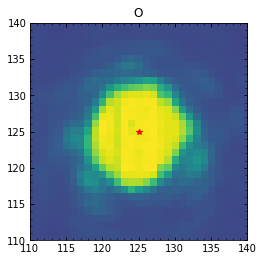

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03297.fits
bin_distcorr_lm_150104_03298.fits
7984.814766290309
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03298.fits: -0.15087501714513962, -0.06837221592015652


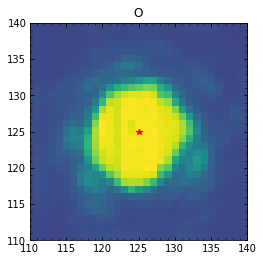

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03298.fits
bin_distcorr_lm_150104_03299.fits
8020.790683946291
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03299.fits: -0.10274437163081984, -0.05502390433215254


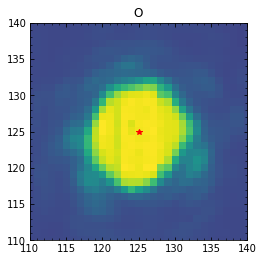

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03299.fits
bin_distcorr_lm_150104_03300.fits
8033.291239524374
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03300.fits: -0.08676985361442746, -0.04964015341291628


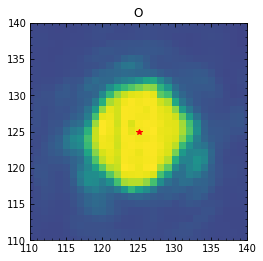

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03300.fits
bin_distcorr_lm_150104_03301.fits
8020.125657460769
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03301.fits: -0.10046511994470819, -0.03869883628644999


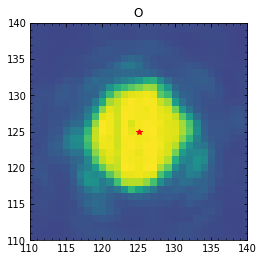

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03301.fits
bin_distcorr_lm_150104_03302.fits
8054.9800621682525
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03302.fits: -0.10102514999150713, -0.04956969894480068


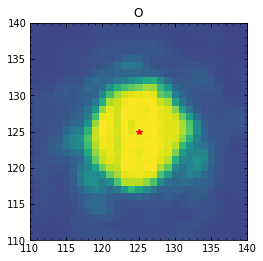

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03302.fits
bin_distcorr_lm_150104_03303.fits
8080.897907365527
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03303.fits: -0.13921174569861705, -0.03797512189528618


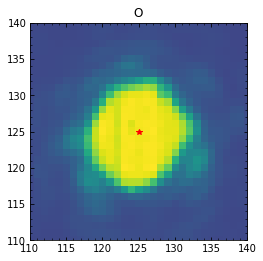

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03303.fits
bin_distcorr_lm_150104_03304.fits
8060.740638763567
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03304.fits: -0.13146127978724564, -0.01731040255924654


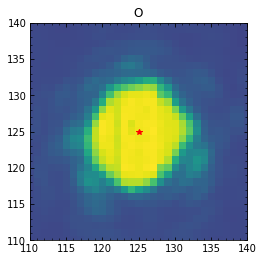

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03304.fits
bin_distcorr_lm_150104_03305.fits
8016.824950585309
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03305.fits: -0.14488927095950288, 0.0017053823372208399


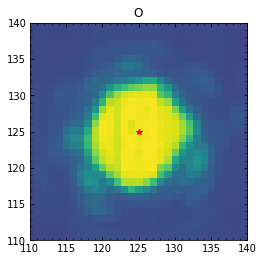

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03305.fits
bin_distcorr_lm_150104_03306.fits
8033.103867707381
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03306.fits: -0.12286689049737021, 0.010450554917902366


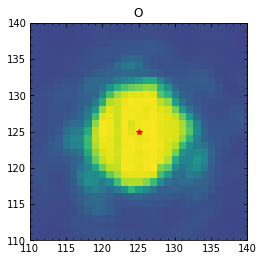

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03306.fits
bin_distcorr_lm_150104_03307.fits
8064.120882548452
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03307.fits: -0.11838536055090287, 0.01837617678632597


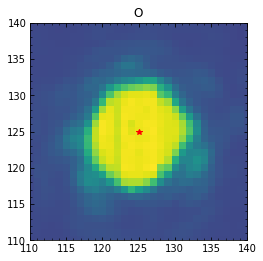

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03307.fits
bin_distcorr_lm_150104_03308.fits
8028.623841220153
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03308.fits: -0.19105440163998821, 0.0776996575031319


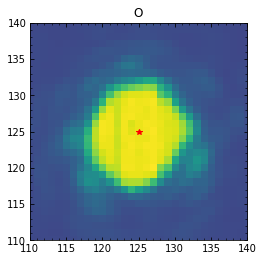

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03308.fits
bin_distcorr_lm_150104_03309.fits
7960.649740507652
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03309.fits: -0.23535006222571297, 0.12017083023589947


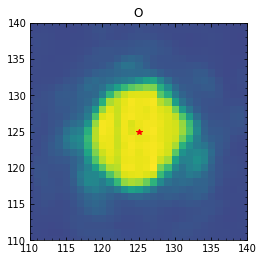

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03309.fits
bin_distcorr_lm_150104_03310.fits
7890.474713974098
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03310.fits: -0.2554691794716817, 0.1467162014985206


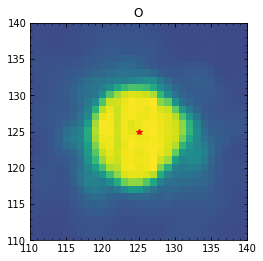

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03310.fits
bin_distcorr_lm_150104_03311.fits
7936.136435645114
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03311.fits: -0.22778803373159917, 0.13773796055596677


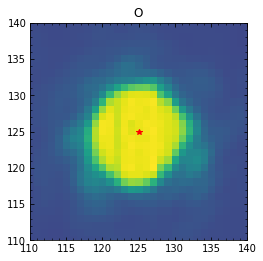

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03311.fits
bin_distcorr_lm_150104_03312.fits
7935.3016305924275
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03312.fits: -0.16428640208872025, 0.09434455827904742


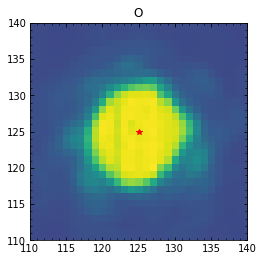

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03312.fits
bin_distcorr_lm_150104_03313.fits
7952.4017629557375
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03313.fits: -0.12371599206105799, 0.016835173058943553


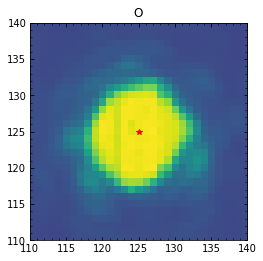

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03313.fits
bin_distcorr_lm_150104_03314.fits
7983.22887217175
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03314.fits: -0.10076502838186485, -0.012170988359329726


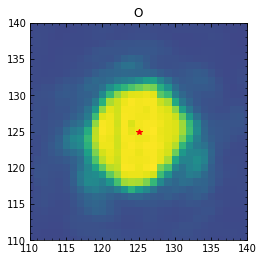

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03314.fits
bin_distcorr_lm_150104_03315.fits
8007.16500942588
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03315.fits: -0.16074400286883872, -0.03186970417294788


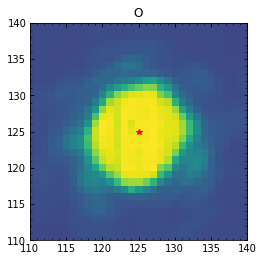

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03315.fits
bin_distcorr_lm_150104_03316.fits
7984.02789228723
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03316.fits: -0.16621263934144537, -0.106164831623623


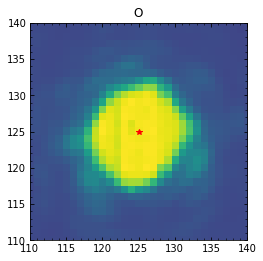

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03316.fits
bin_distcorr_lm_150104_03317.fits
8010.301008835973
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03317.fits: -0.17467694716786752, -0.06567004617218686


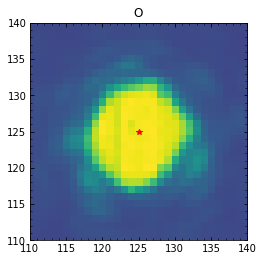

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03317.fits
bin_distcorr_lm_150104_03318.fits
8049.441912592292
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03318.fits: -0.1730689215327743, -0.06418188355886656


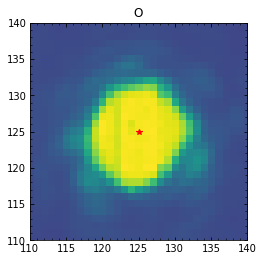

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03318.fits
bin_distcorr_lm_150104_03319.fits
8034.889817049889
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03319.fits: -0.15661616813856227, -0.08862354631256153


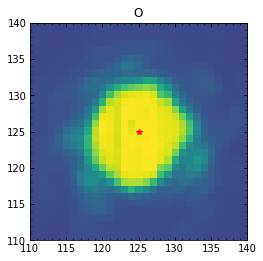

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03319.fits
bin_distcorr_lm_150104_03320.fits
8033.0873873144665
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03320.fits: -0.19895716950021836, -0.04133903426899366


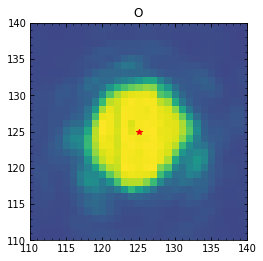

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03320.fits
bin_distcorr_lm_150104_03321.fits
7966.6781134652165
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03321.fits: -0.19357721243756743, -0.010232174021318485


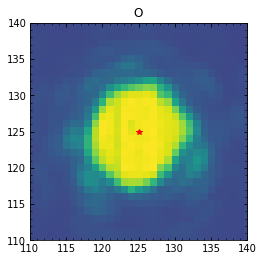

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03321.fits
bin_distcorr_lm_150104_03322.fits
8015.629419044102
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03322.fits: -0.2129615321029874, -0.021180712527190337


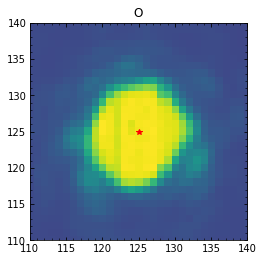

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03322.fits
bin_distcorr_lm_150104_03323.fits
8024.303676108283
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03323.fits: -0.1431472663072313, -0.039012620689788946


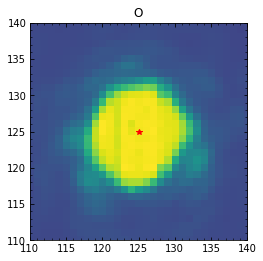

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03323.fits
bin_distcorr_lm_150104_03324.fits
8019.1351311673125
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03324.fits: -0.17455436882700326, -0.03889413473888226


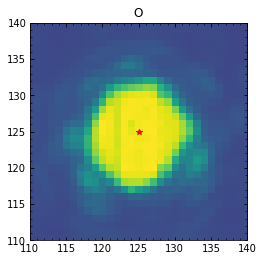

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03324.fits
bin_distcorr_lm_150104_03325.fits
7982.596559843029
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03325.fits: -0.15073425711970145, -0.020235968496557177


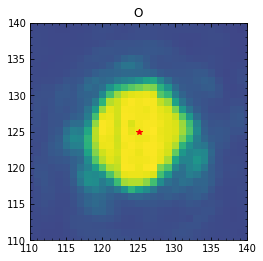

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03325.fits
bin_distcorr_lm_150104_03326.fits
8022.162428340786
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03326.fits: -0.1551436277236462, -0.032978293516968904


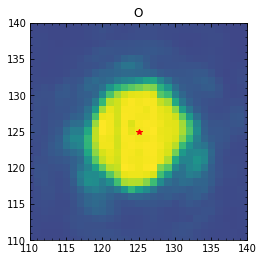

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03326.fits
bin_distcorr_lm_150104_03327.fits
8027.407398126036
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03327.fits: -0.16129903045576555, -0.05980192376506466


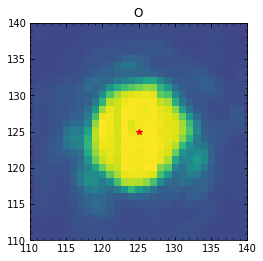

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03327.fits
bin_distcorr_lm_150104_03328.fits
8020.935397286681
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03328.fits: -0.19622146527351703, -0.08851143047862564


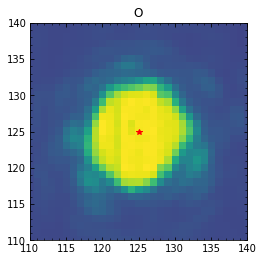

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03328.fits
bin_distcorr_lm_150104_03329.fits
7975.4779041640795
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03329.fits: -0.2019266969119542, -0.06296910611047224


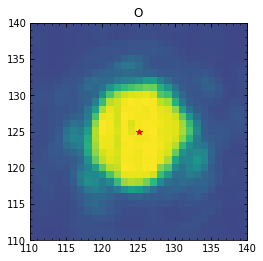

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03329.fits
bin_distcorr_lm_150104_03330.fits
8029.900979505073
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03330.fits: -0.21693876659522715, -0.043909146304521585


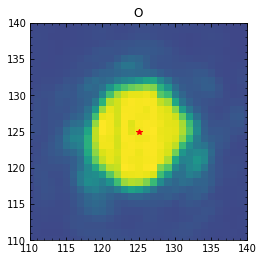

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03330.fits
bin_distcorr_lm_150104_03331.fits
8013.892017989091
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03331.fits: -0.22067552255388279, -0.037894908997479604


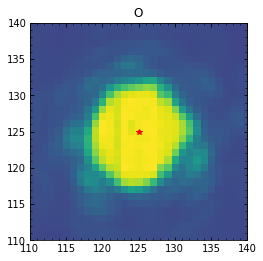

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03331.fits
bin_distcorr_lm_150104_03332.fits
8006.9944900747405
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03332.fits: -0.24556916095225034, -0.04551414614955718


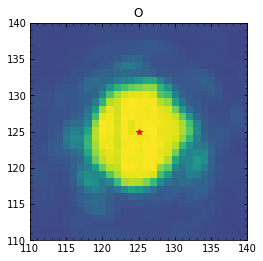

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03332.fits
bin_distcorr_lm_150104_03333.fits
8034.260629306105
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03333.fits: -0.17539418436710008, -0.06401143153519939


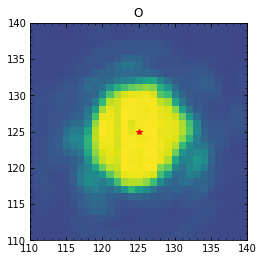

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03333.fits
bin_distcorr_lm_150104_03334.fits
8041.74290728622
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03334.fits: -0.19338406045349643, -0.05284586698101634


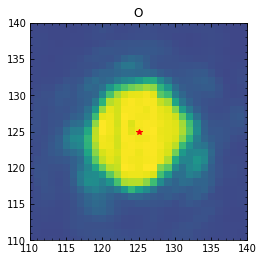

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03334.fits
bin_distcorr_lm_150104_03335.fits
8020.1105149323175
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03335.fits: -0.20129122094374452, -0.05214958827167493


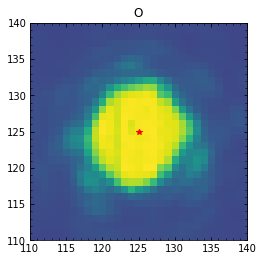

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03335.fits
bin_distcorr_lm_150104_03336.fits
7993.068892091296
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03336.fits: -0.2460036775424541, -0.027632249435889378


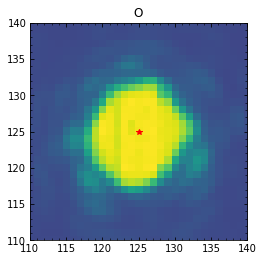

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03336.fits
bin_distcorr_lm_150104_03337.fits
8032.8755835440315
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03337.fits: -0.2325918585530431, -0.04472321575246241


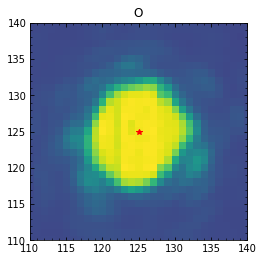

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03337.fits
bin_distcorr_lm_150104_03338.fits
8065.714297476958
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03338.fits: -0.2178372016103296, -0.035817882034095305


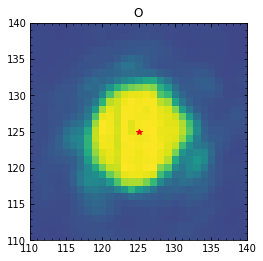

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03338.fits
bin_distcorr_lm_150104_03339.fits
8019.402807220372
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03339.fits: -0.24802216552880907, -0.033038758983295224


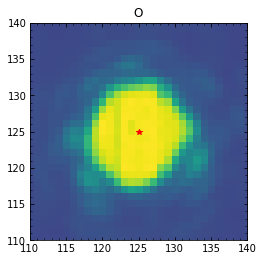

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03339.fits
bin_distcorr_lm_150104_03340.fits
8022.268693326483
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03340.fits: -0.20114202209511234, -0.05124796824638622


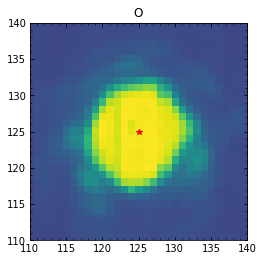

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03340.fits
bin_distcorr_lm_150104_03341.fits
8023.899374252006
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03341.fits: -0.15850277168409121, -0.059954750237139365


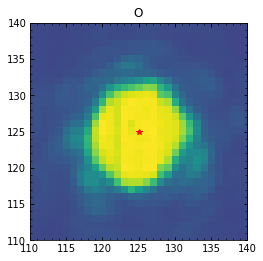

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03341.fits
bin_distcorr_lm_150104_03342.fits
8038.1055583208445
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03342.fits: -0.18572699081117605, -0.02559761360562618


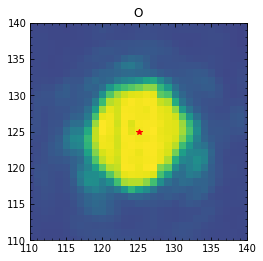

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03342.fits
bin_distcorr_lm_150104_03343.fits
8022.73000559945
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03343.fits: -0.16832007436104846, -0.039029488891458186


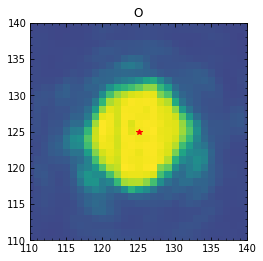

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03343.fits
bin_distcorr_lm_150104_03344.fits
8036.590039558933
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03344.fits: -0.16774487070422595, -0.04740992383312914


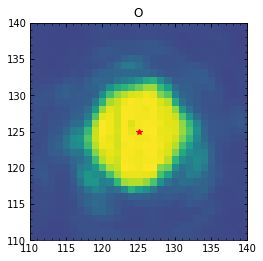

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03344.fits
bin_distcorr_lm_150104_03345.fits
8062.351085733363
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03345.fits: -0.17681437582682946, -0.07024691803974292


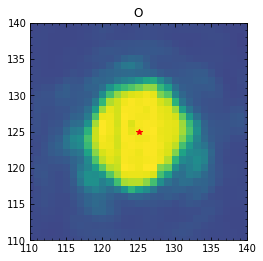

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03345.fits
bin_distcorr_lm_150104_03346.fits
8066.304334395323
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03346.fits: -0.21373171871976382, -0.03030986642725253


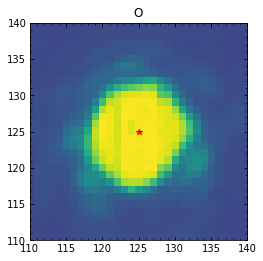

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03346.fits
bin_distcorr_lm_150104_03347.fits
8074.972112183846
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03347.fits: -0.27307592208170206, -0.041649508748150765


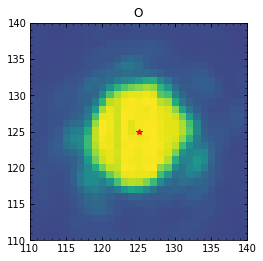

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03347.fits
bin_distcorr_lm_150104_03348.fits
8044.5669844944605
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03348.fits: -0.2227867751214916, -0.016433384486219893


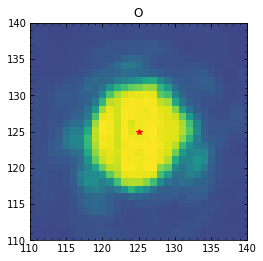

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03348.fits
bin_distcorr_lm_150104_03349.fits
8049.371402268178
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03349.fits: -0.2673668651355072, 0.009751936004285255


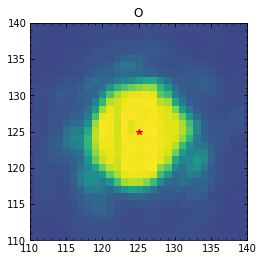

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03349.fits
bin_distcorr_lm_150104_03350.fits
8053.463777894496
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03350.fits: -0.2670321423541324, -0.0036174540720210757


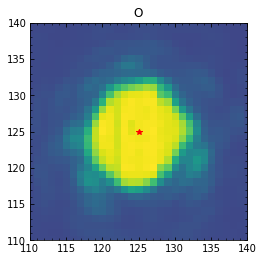

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03350.fits
bin_distcorr_lm_150104_03351.fits
8018.949532648563
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03351.fits: -0.2555330542320817, -0.007960907027147357


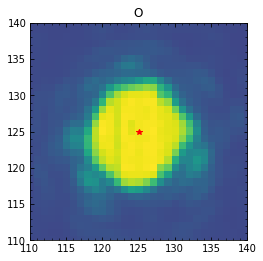

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03351.fits
bin_distcorr_lm_150104_03352.fits
8017.886278822889
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03352.fits: -0.2581999347328363, -0.026546570280835624


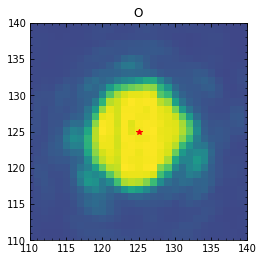

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03352.fits
bin_distcorr_lm_150104_03353.fits
8064.086714328626
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03353.fits: -0.28367910132375584, -0.02933434459349371


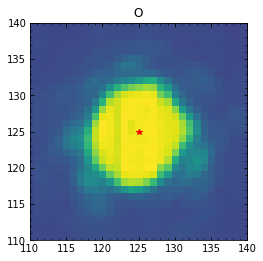

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03353.fits
bin_distcorr_lm_150104_03354.fits
8057.020185949699
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03354.fits: -0.2727822525169472, -0.054399685716433055


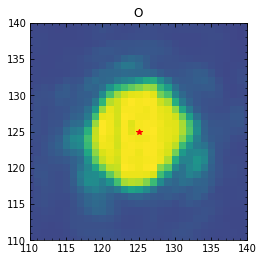

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03354.fits
bin_distcorr_lm_150104_03355.fits
8024.030713022035
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03355.fits: -0.29348628190794557, -0.03815971572315391


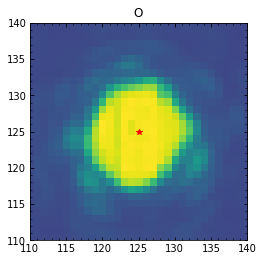

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03355.fits
bin_distcorr_lm_150104_03356.fits
8045.74267298885
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03356.fits: -0.27653028879230135, -0.03600901779163479


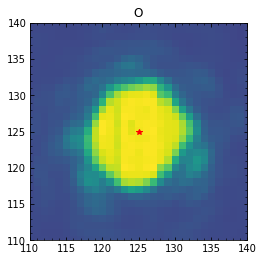

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03356.fits
bin_distcorr_lm_150104_03357.fits
8038.663801268901
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03357.fits: -0.28811790420093075, -0.020197288149653048


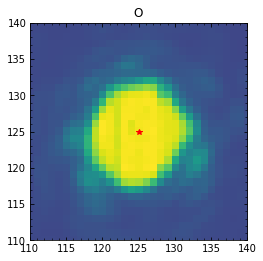

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03357.fits
bin_distcorr_lm_150104_03358.fits
8038.63437001444
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03358.fits: -0.2976976803105984, -0.03476368028672283


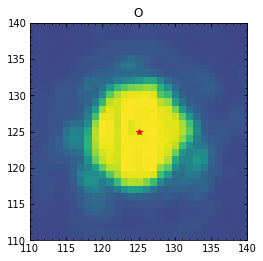

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03358.fits
bin_distcorr_lm_150104_03359.fits
8023.9858782796055
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03359.fits: -0.2876048796415205, -0.0377997658412923


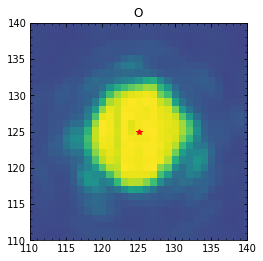

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03359.fits
bin_distcorr_lm_150104_03360.fits
8044.668474823809
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03360.fits: -0.29352575872714937, -0.03615007133888071


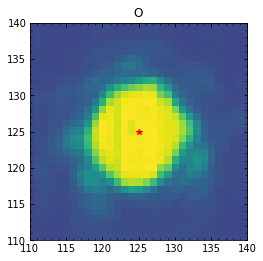

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03360.fits
bin_distcorr_lm_150104_03361.fits
8056.153269545108
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03361.fits: -0.265195632744863, -0.010569241849097466


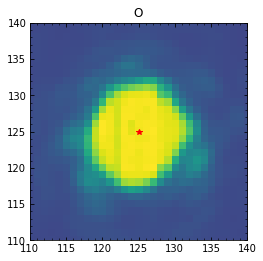

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03361.fits
bin_distcorr_lm_150104_03362.fits
8059.556364970273
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03362.fits: -0.31449845973778423, -0.04056743280157349


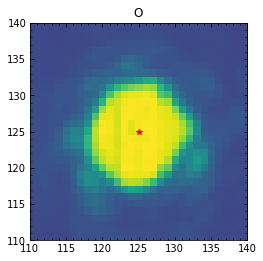

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03362.fits
bin_distcorr_lm_150104_03363.fits
8046.370155154486
STARTING  O
X: 191  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_03363.fits: -0.2805651785792662, -0.060759341850982196


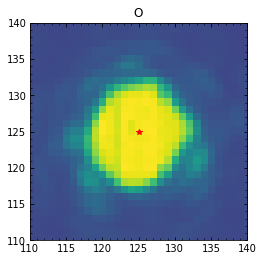

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP22138/Kshort/single_V2/Final_lm_150104_03363.fits
bin_distcorr_lm_150104_07632.fits
8627.38895736031
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07632.fits: -0.9774395892205376, -0.22626748984136213


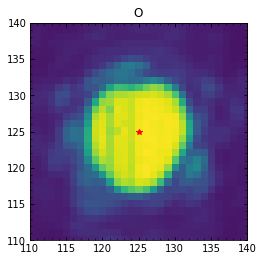

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07632.fits
bin_distcorr_lm_150104_07633.fits
8604.128477211056
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07633.fits: -0.9751139022904809, -0.24081557258382702


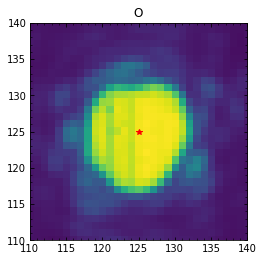

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07633.fits
bin_distcorr_lm_150104_07634.fits
8578.81747422466
STARTING  O
X: 206  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07634.fits: -0.0232197973239181, -0.24506822368064718


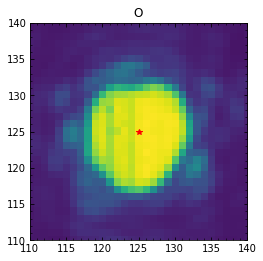

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07634.fits
bin_distcorr_lm_150104_07635.fits
8571.30207449257
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07635.fits: -0.9801133722325659, -0.24857232796512108


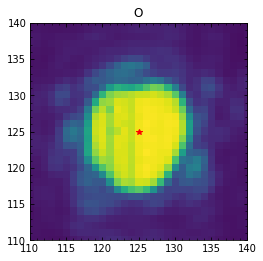

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07635.fits
bin_distcorr_lm_150104_07636.fits
8541.944888904314
STARTING  O
X: 206  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07636.fits: -0.024386427575642244, -0.25115697357347244


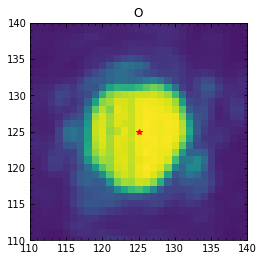

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07636.fits
bin_distcorr_lm_150104_07637.fits
8521.734614487614
STARTING  O
X: 206  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07637.fits: -0.05985333705292106, -0.2092951849447715


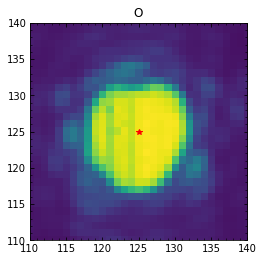

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07637.fits
bin_distcorr_lm_150104_07638.fits
8495.060698345029
STARTING  O
X: 206  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07638.fits: -0.04976255146145547, -0.28367318909322137


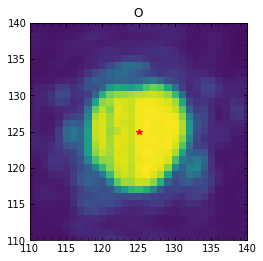

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07638.fits
bin_distcorr_lm_150104_07639.fits
8582.383025438361
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07639.fits: -0.9835736271853861, -0.24263911433190088


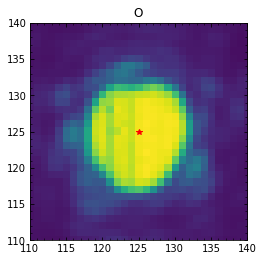

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07639.fits
bin_distcorr_lm_150104_07640.fits
8565.490813650722
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07640.fits: -0.9791213233420777, -0.31202848316689114


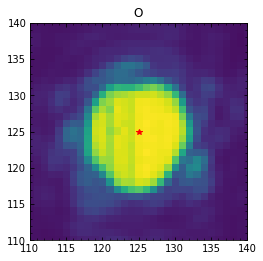

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07640.fits
bin_distcorr_lm_150104_07641.fits
8520.625008522842
STARTING  O
X: 206  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07641.fits: -0.09096738153706951, -0.28472719863528084


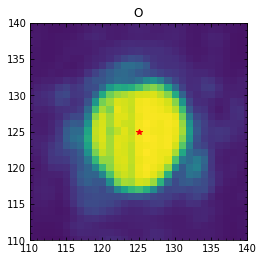

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07641.fits
bin_distcorr_lm_150104_07642.fits
8516.110729742124
STARTING  O
X: 206  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07642.fits: -0.05562947187705447, -0.25757129590050454


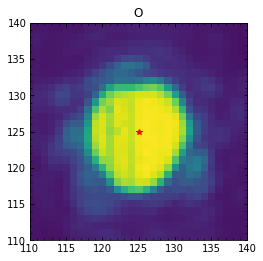

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07642.fits
bin_distcorr_lm_150104_07643.fits
8520.456142359979
STARTING  O
X: 206  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07643.fits: -0.07327807002863551, -0.22591636948151006


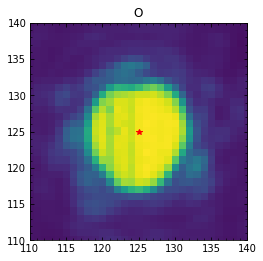

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07643.fits
bin_distcorr_lm_150104_07644.fits
8574.46219081429
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07644.fits: -1.0356839049200133, -0.2649531073648106


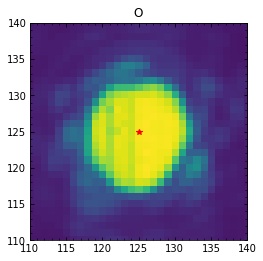

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07644.fits
bin_distcorr_lm_150104_07645.fits
8564.766919453421
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07645.fits: -1.027111431648116, -0.2424632904580406


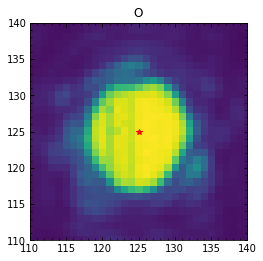

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07645.fits
bin_distcorr_lm_150104_07646.fits
8561.3607403741
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07646.fits: -1.0324619821732668, -0.20789038002069304


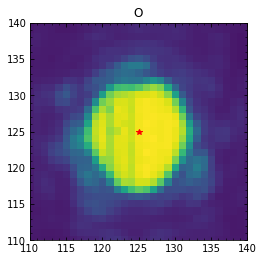

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07646.fits
bin_distcorr_lm_150104_07647.fits
8587.050006798541
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07647.fits: -1.0047905135910113, -0.22195940263188163


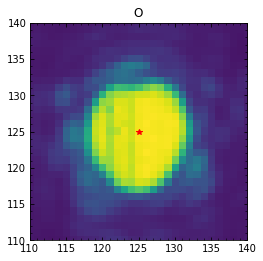

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07647.fits
bin_distcorr_lm_150104_07648.fits
8556.792417952987
STARTING  O
X: 206  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07648.fits: -0.03903392987562171, -0.26028015347737465


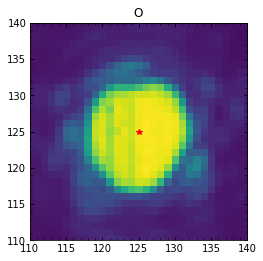

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07648.fits
bin_distcorr_lm_150104_07649.fits
8589.462949925562
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07649.fits: -0.9998124129714085, -0.28214084329631106


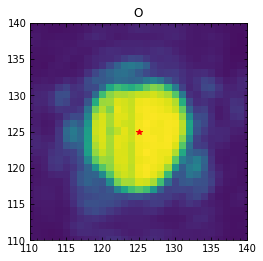

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07649.fits
bin_distcorr_lm_150104_07650.fits
8566.859668266376
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07650.fits: -1.0107247828003878, -0.2909779122245766


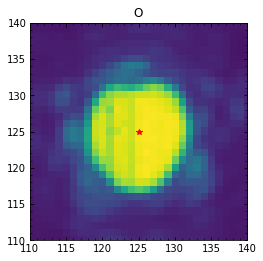

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07650.fits
bin_distcorr_lm_150104_07651.fits
8478.531032959969
STARTING  O
X: 206  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07651.fits: -0.051257491025182844, -0.3124396161307672


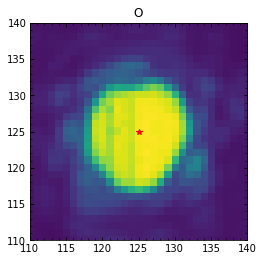

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07651.fits
bin_distcorr_lm_150104_07652.fits
8455.212702503602
STARTING  O
X: 206  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07652.fits: -0.15475583583998542, -0.32772390513167693


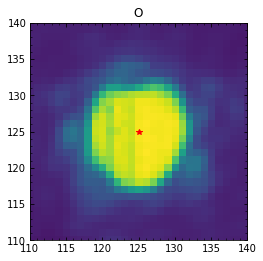

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07652.fits
bin_distcorr_lm_150104_07653.fits
8500.24131652093
STARTING  O
X: 206  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07653.fits: -0.057852879868256935, -0.24812667834194002


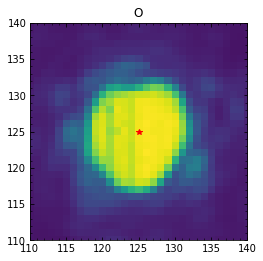

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07653.fits
bin_distcorr_lm_150104_07654.fits
8492.639160152004
STARTING  O
X: 206  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07654.fits: -0.02284744831152352, -0.26141386849766235


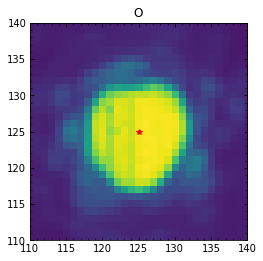

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07654.fits
bin_distcorr_lm_150104_07655.fits
8546.469146765654
STARTING  O
X: 206  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07655.fits: -0.03688851124703518, -0.21592436638528056


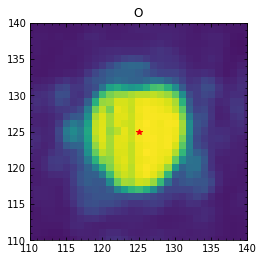

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07655.fits
bin_distcorr_lm_150104_07656.fits
8537.75436407315
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07656.fits: -0.9849472335744522, -0.2116260075826304


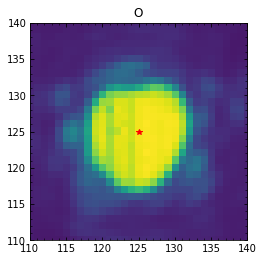

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07656.fits
bin_distcorr_lm_150104_07657.fits
8565.421271054376
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07657.fits: -0.9580230373945327, -0.21432002046274334


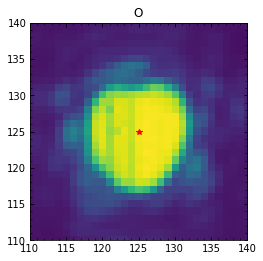

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07657.fits
bin_distcorr_lm_150104_07658.fits
8546.990672424396
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07658.fits: -0.9605547629721798, -0.1881348655911026


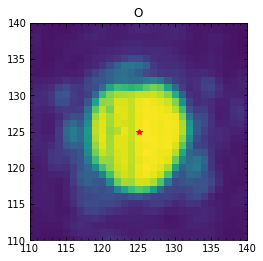

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07658.fits
bin_distcorr_lm_150104_07659.fits
8525.029095316648
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07659.fits: -0.9526800967768949, -0.15415975456819098


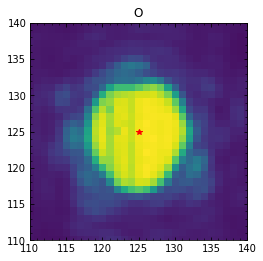

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07659.fits
bin_distcorr_lm_150104_07660.fits
8556.092178869414
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07660.fits: -1.019246109436878, -0.19189055228129348


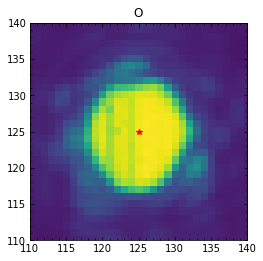

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07660.fits
bin_distcorr_lm_150104_07661.fits
8557.079852063234
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07661.fits: -0.9894689839958488, -0.16948685802286434


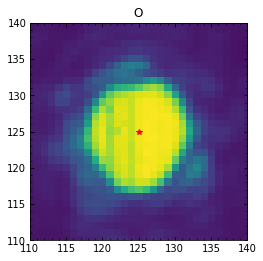

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07661.fits
bin_distcorr_lm_150104_07662.fits
8578.096871432193
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07662.fits: -0.9619523983246268, -0.1449924195748764


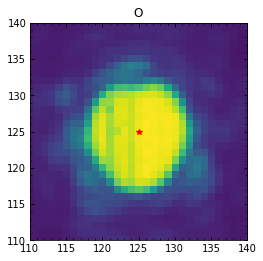

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07662.fits
bin_distcorr_lm_150104_07663.fits
8583.044197793055
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07663.fits: -0.9529479167046233, -0.21716193035556586


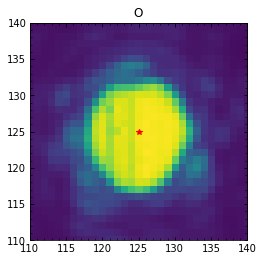

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07663.fits
bin_distcorr_lm_150104_07664.fits
8609.941266154512
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07664.fits: -0.965894211021336, -0.2186347428641895


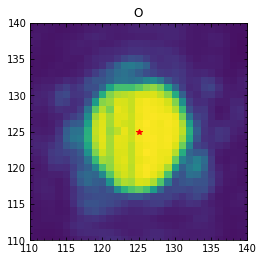

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07664.fits
bin_distcorr_lm_150104_07665.fits
8600.4982665648
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07665.fits: -1.0010586430727457, -0.2488000516005613


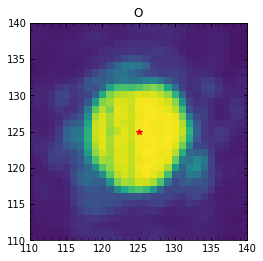

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07665.fits
bin_distcorr_lm_150104_07666.fits
8614.08602194722
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07666.fits: -0.9934405902006418, -0.25199775497166854


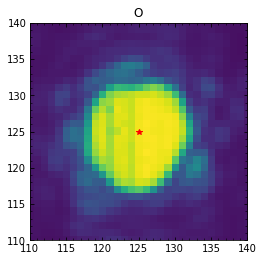

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07666.fits
bin_distcorr_lm_150104_07667.fits
8618.850582055175
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07667.fits: -1.0303609104444078, -0.3008590034664351


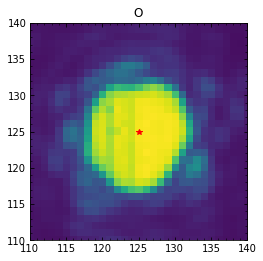

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07667.fits
bin_distcorr_lm_150104_07668.fits
8629.508363776147
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07668.fits: -0.9888195901692924, -0.2901202628844146


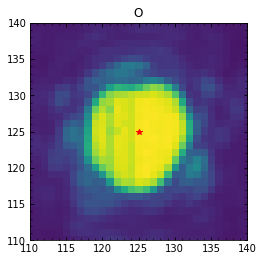

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07668.fits
bin_distcorr_lm_150104_07669.fits
8635.74094412154
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07669.fits: -0.9933961061844059, -0.2822410624964391


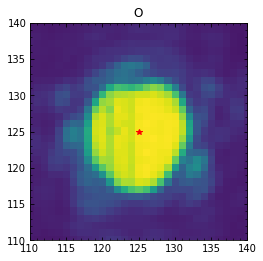

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07669.fits
bin_distcorr_lm_150104_07670.fits
8575.875765220819
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07670.fits: -0.990554652102901, -0.3215149931308545


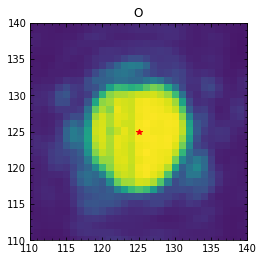

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07670.fits
bin_distcorr_lm_150104_07671.fits
8586.928000908541
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07671.fits: -1.0076045821331974, -0.3051968971837269


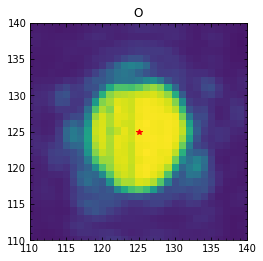

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07671.fits
bin_distcorr_lm_150104_07672.fits
8630.178936865212
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07672.fits: -1.0175441638241622, -0.3403182730811096


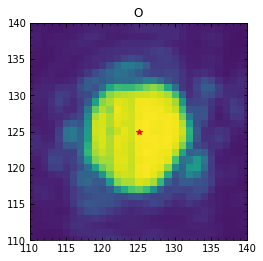

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07672.fits
bin_distcorr_lm_150104_07673.fits
8647.741761813393
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07673.fits: -1.021765619612836, -0.34139782162996113


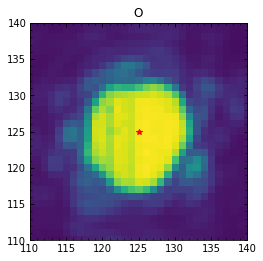

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07673.fits
bin_distcorr_lm_150104_07674.fits
8627.099544279728
STARTING  O
X: 206  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07674.fits: -0.044189870222218985, -0.3120443953265237


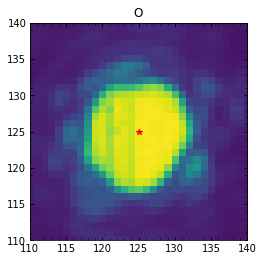

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07674.fits
bin_distcorr_lm_150104_07675.fits
8639.482301741116
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07675.fits: -1.0152983617595481, -0.3255311051451102


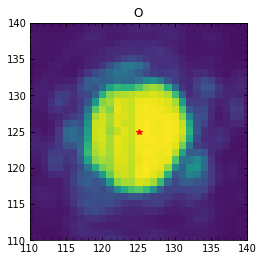

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07675.fits
bin_distcorr_lm_150104_07676.fits
8613.930954271667
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07676.fits: -1.0024088374104636, -0.3618211943513714


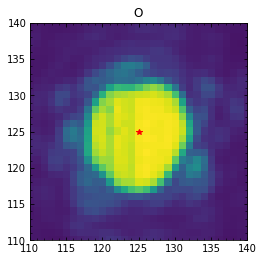

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07676.fits
bin_distcorr_lm_150104_07677.fits
8637.552186304694
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07677.fits: -0.9371603868570659, -0.321990015286417


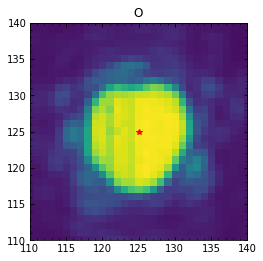

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07677.fits
bin_distcorr_lm_150104_07678.fits
8606.368222337036
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07678.fits: -0.9947113100521463, -0.3502485945281677


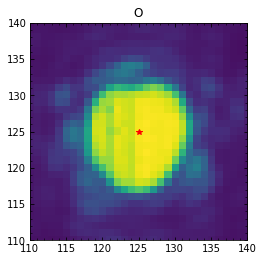

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07678.fits
bin_distcorr_lm_150104_07679.fits
8612.671102630442
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07679.fits: -1.0041246994786803, -0.3481727421286891


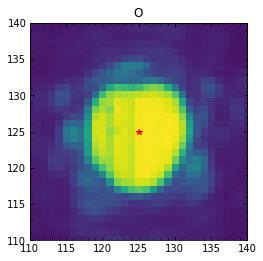

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07679.fits
bin_distcorr_lm_150104_07680.fits
8601.912697896614
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07680.fits: -0.9737344327117654, -0.32564960900327833


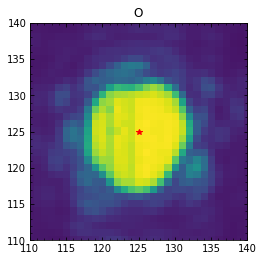

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07680.fits
bin_distcorr_lm_150104_07681.fits
8611.957150328219
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07681.fits: -0.9465548950111895, -0.296980422826735


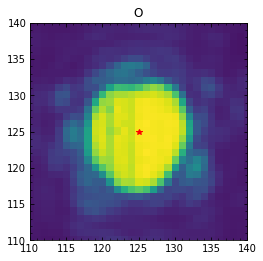

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07681.fits
bin_distcorr_lm_150104_07682.fits
8633.12901535222
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07682.fits: -0.9441316897402885, -0.2924628600524457


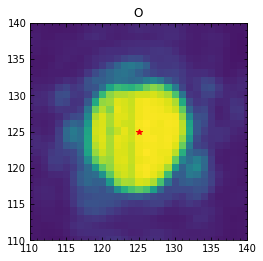

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07682.fits
bin_distcorr_lm_150104_07683.fits
8637.200285618237
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07683.fits: -0.9334020656879147, -0.3151280836720858


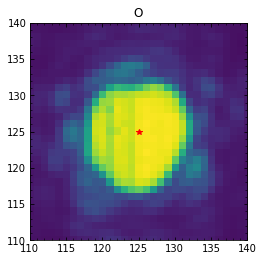

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07683.fits
bin_distcorr_lm_150104_07684.fits
8630.185074954852
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07684.fits: -0.9400714868536895, -0.29134211507027175


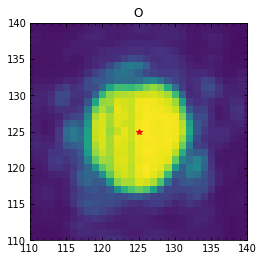

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07684.fits
bin_distcorr_lm_150104_07685.fits
8624.469405812717
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07685.fits: -0.9571043188733555, -0.29873310951532517


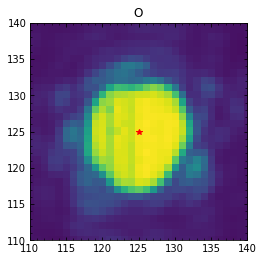

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07685.fits
bin_distcorr_lm_150104_07686.fits
8629.664541910897
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07686.fits: -0.9372571339132705, -0.2811053895034661


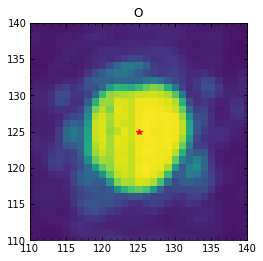

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07686.fits
bin_distcorr_lm_150104_07687.fits
8643.904878465968
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07687.fits: -0.9791320381423105, -0.3134299461828931


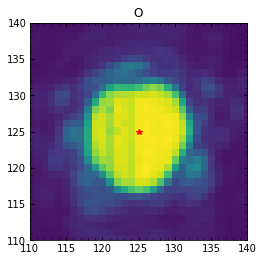

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07687.fits
bin_distcorr_lm_150104_07688.fits
8618.919473782493
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07688.fits: -0.9976824432754086, -0.3259780185806491


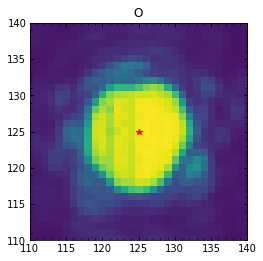

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07688.fits
bin_distcorr_lm_150104_07689.fits
8642.741971394627
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07689.fits: -0.9964394439290345, -0.33068183151561925


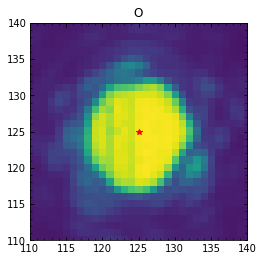

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07689.fits
bin_distcorr_lm_150104_07690.fits
8648.560217453803
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07690.fits: -0.990789812477125, -0.35719183770049057


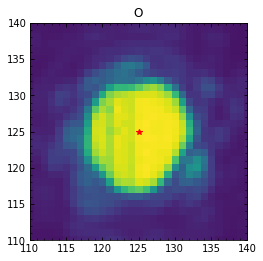

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07690.fits
bin_distcorr_lm_150104_07691.fits
8633.75722609149
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07691.fits: -0.9888746671060247, -0.34979813730510756


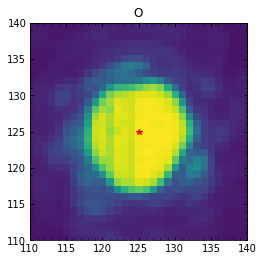

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07691.fits
bin_distcorr_lm_150104_07692.fits
8596.066838901557
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07692.fits: -1.0027529880408963, -0.31153003078710384


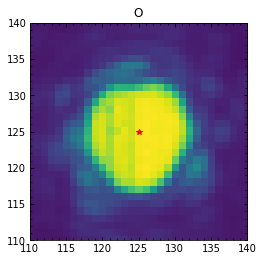

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07692.fits
bin_distcorr_lm_150104_07693.fits
8625.682129472007
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07693.fits: -0.9798760233903607, -0.3234914652991634


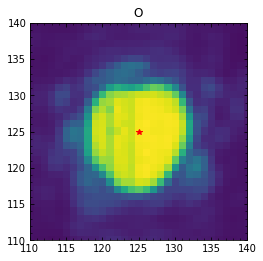

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07693.fits
bin_distcorr_lm_150104_07694.fits
8636.770566494988
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07694.fits: -0.9852384919309429, -0.3368835641684029


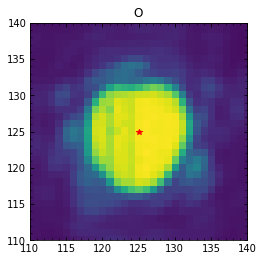

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07694.fits
bin_distcorr_lm_150104_07695.fits
8567.573543397182
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07695.fits: -0.9866049433890893, -0.3508005467155897


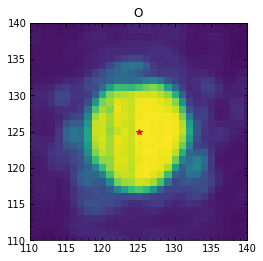

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07695.fits
bin_distcorr_lm_150104_07696.fits
8520.248460618834
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07696.fits: -1.0084197079062207, -0.31260528874836524


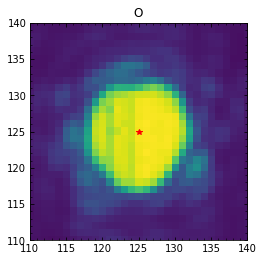

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07696.fits
bin_distcorr_lm_150104_07697.fits
8600.451143416101
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07697.fits: -0.940246231874788, -0.3148225380051386


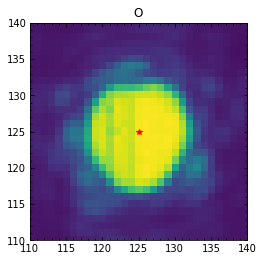

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07697.fits
bin_distcorr_lm_150104_07698.fits
8614.837043942734
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07698.fits: -0.9373467490035381, -0.31372178667505324


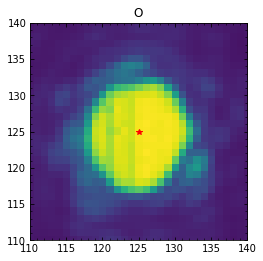

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07698.fits
bin_distcorr_lm_150104_07699.fits
8630.288191433334
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07699.fits: -0.9196551683888003, -0.3140883990729151


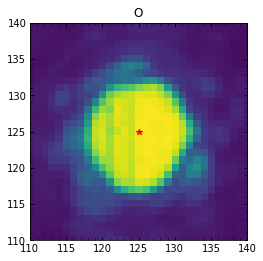

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07699.fits
bin_distcorr_lm_150104_07700.fits
8642.873313322725
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07700.fits: -0.9177200577249565, -0.3172468239429236


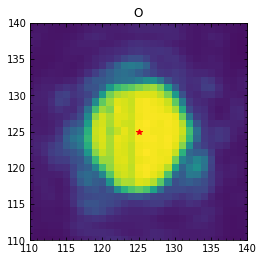

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07700.fits
bin_distcorr_lm_150104_07701.fits
8628.323041708796
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07701.fits: -0.8896082530553926, -0.3446929541026478


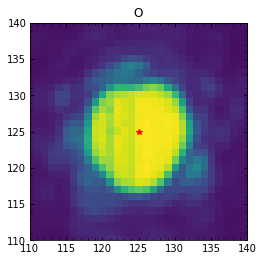

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07701.fits
bin_distcorr_lm_150104_07702.fits
8637.283233416223
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07702.fits: -0.8980555853366496, -0.32156672627872496


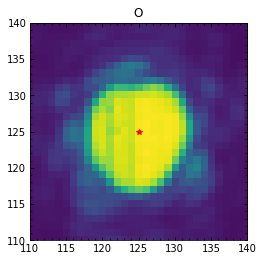

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07702.fits
bin_distcorr_lm_150104_07703.fits
8645.077907291394
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07703.fits: -0.9162498256198006, -0.3533788503396593


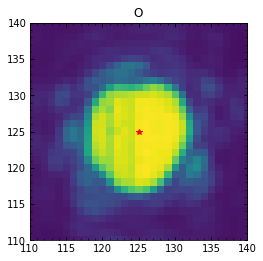

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07703.fits
bin_distcorr_lm_150104_07704.fits
8611.767897427455
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07704.fits: -0.9694776407138619, -0.34921043383833705


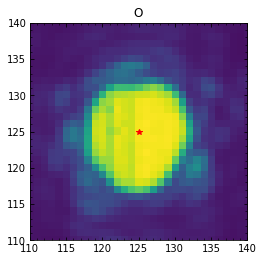

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07704.fits
bin_distcorr_lm_150104_07705.fits
8630.054033629134
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07705.fits: -0.9542862810307327, -0.33432634374191394


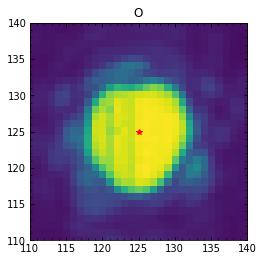

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07705.fits
bin_distcorr_lm_150104_07706.fits
8621.197706010602
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07706.fits: -0.9576102614039428, -0.3392747632771389


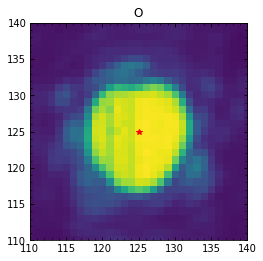

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07706.fits
bin_distcorr_lm_150104_07707.fits
8626.009106015472
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07707.fits: -1.004209051089063, -0.3906383216925704


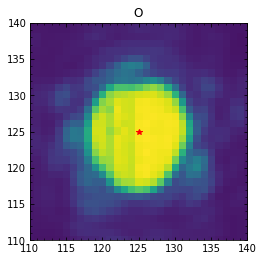

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07707.fits
bin_distcorr_lm_150104_07708.fits
8581.052943516102
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07708.fits: -1.0147945641991996, -0.3883530261874668


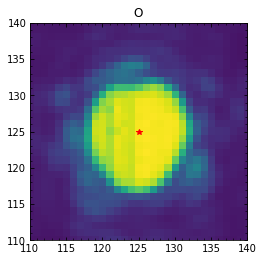

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07708.fits
bin_distcorr_lm_150104_07709.fits
8559.470109583395
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07709.fits: -0.9989494388043312, -0.3337237193777085


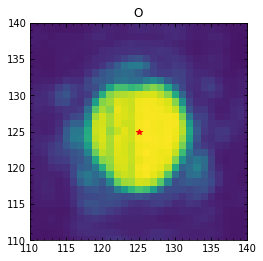

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07709.fits
bin_distcorr_lm_150104_07710.fits
8616.43750533523
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07710.fits: -0.9655959550612749, -0.3683270442846549


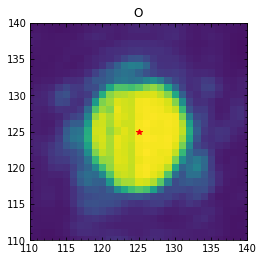

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07710.fits
bin_distcorr_lm_150104_07711.fits
8600.823762493557
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07711.fits: -0.9814259405502099, -0.3989512288960029


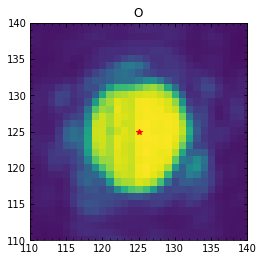

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07711.fits
bin_distcorr_lm_150104_07712.fits
8587.141683052841
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07712.fits: -0.9528201869326978, -0.37226397685015655


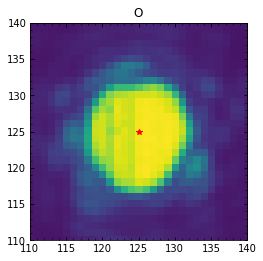

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07712.fits
bin_distcorr_lm_150104_07713.fits
8563.53800040258
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07713.fits: -0.9906118011623803, -0.37504932467432894


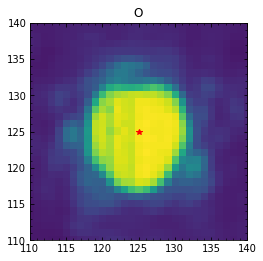

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07713.fits
bin_distcorr_lm_150104_07714.fits
8573.278214334432
STARTING  O
X: 206  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07714.fits: -0.07331608775548659, -0.39348314272041307


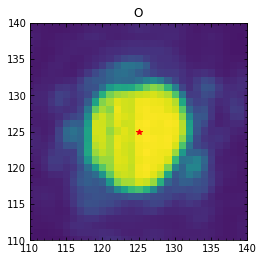

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07714.fits
bin_distcorr_lm_150104_07715.fits
8583.80427035049
STARTING  O
X: 206  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07715.fits: -0.0586054962627216, -0.4119146607736539


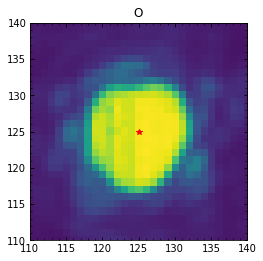

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07715.fits
bin_distcorr_lm_150104_07716.fits
8555.674114359748
STARTING  O
X: 206  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07716.fits: -0.13401161784859994, -0.4271374216851811


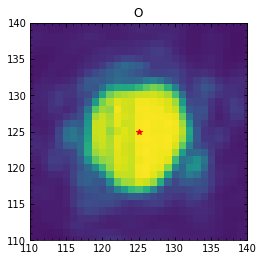

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07716.fits
bin_distcorr_lm_150104_07717.fits
8566.862057828292
STARTING  O
X: 206  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07717.fits: -0.07051597809213916, -0.4657415728648502


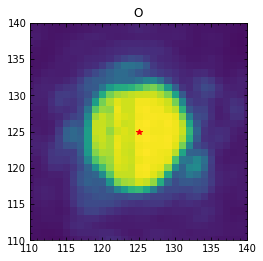

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07717.fits
bin_distcorr_lm_150104_07718.fits
8537.322970031108
STARTING  O
X: 206  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07718.fits: -0.07930676210927601, -0.36394348522490105


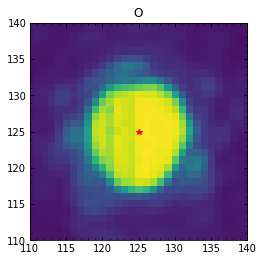

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07718.fits
bin_distcorr_lm_150104_07719.fits
8491.712968664422
STARTING  O
X: 206  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07719.fits: -0.12256569203763945, -0.3036393184038815


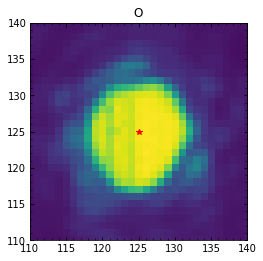

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07719.fits
bin_distcorr_lm_150104_07720.fits
8513.612269714791
STARTING  O
X: 206  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07720.fits: -0.04188653730513181, -0.3447835101375958


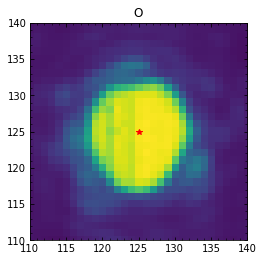

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07720.fits
bin_distcorr_lm_150104_07721.fits
8519.392745819408
STARTING  O
X: 206  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07721.fits: -0.02879207501369052, -0.2968625157139968


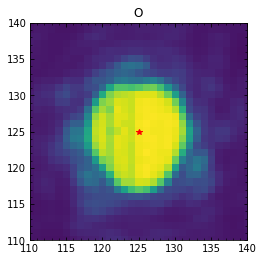

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07721.fits
bin_distcorr_lm_150104_07722.fits
8568.890342040124
STARTING  O
X: 206  Y: 323  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07722.fits: -0.05860350540806536, -0.3087985807686593


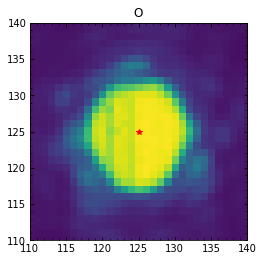

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07722.fits
bin_distcorr_lm_150104_07723.fits
8580.928572134757
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07723.fits: -1.0369540281036862, -0.36071170826497223


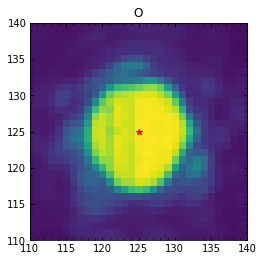

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07723.fits
bin_distcorr_lm_150104_07724.fits
8604.024639476149
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07724.fits: -1.0280201123895623, -0.3760683780651348


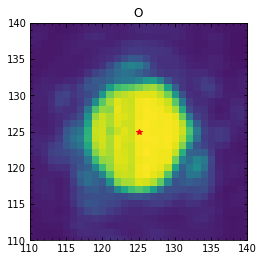

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07724.fits
bin_distcorr_lm_150104_07725.fits
8612.006822985262
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07725.fits: -0.964598692573901, -0.4119023045291783


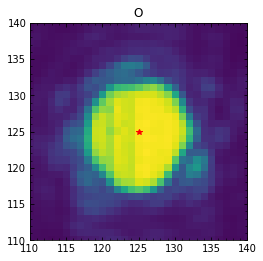

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07725.fits
bin_distcorr_lm_150104_07726.fits
8630.995827968212
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07726.fits: -0.9772021557789046, -0.643423546265673


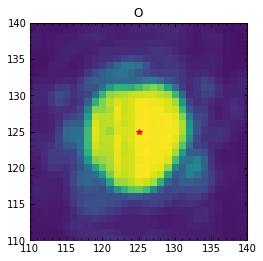

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07726.fits
bin_distcorr_lm_150104_07727.fits
8624.113388512975
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07727.fits: -0.9926742921163481, -0.43552348077390945


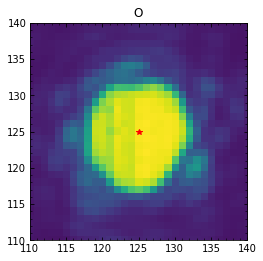

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07727.fits
bin_distcorr_lm_150104_07728.fits
8598.670226465763
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07728.fits: -0.9886637673370089, -0.6430079688154677


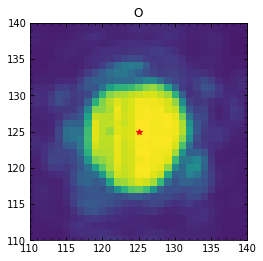

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07728.fits
bin_distcorr_lm_150104_07729.fits
8611.902411504285
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07729.fits: -0.985405247173091, -0.6401962996490269


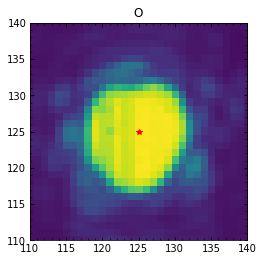

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07729.fits
bin_distcorr_lm_150104_07730.fits
8611.091308458765
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07730.fits: -0.9809512510422351, -0.6739709424632281


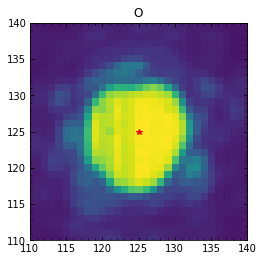

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07730.fits
bin_distcorr_lm_150104_07731.fits
8609.759645524247
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07731.fits: -0.9910296435020669, -0.6838442389892876


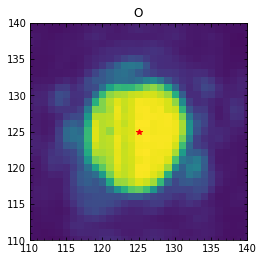

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07731.fits
bin_distcorr_lm_150104_07732.fits
8570.189835550134
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07732.fits: -1.01967126374565, -0.6609938561735618


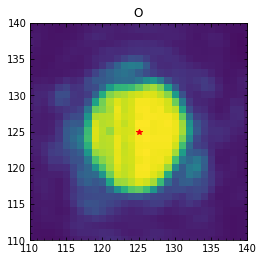

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07732.fits
bin_distcorr_lm_150104_07733.fits
8577.902108056212
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07733.fits: -1.0120146149705604, -0.658312181457255


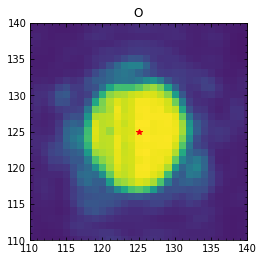

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07733.fits
bin_distcorr_lm_150104_07734.fits
8628.76078915005
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07734.fits: -0.9317666178146666, -0.6334862480654166


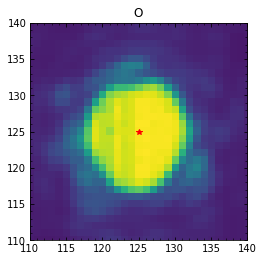

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07734.fits
bin_distcorr_lm_150104_07735.fits
8620.766338051817
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07735.fits: -0.9433296378235312, -0.6298242790793509


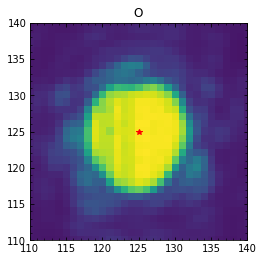

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07735.fits
bin_distcorr_lm_150104_07736.fits
8654.101748287612
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07736.fits: -0.9393566039234358, -0.6492157256252753


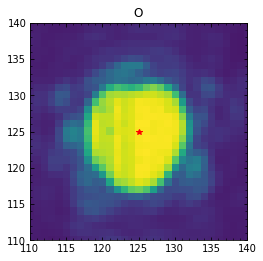

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07736.fits
bin_distcorr_lm_150104_07737.fits
8628.765935285688
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07737.fits: -0.9630624907140586, -0.651498485917422


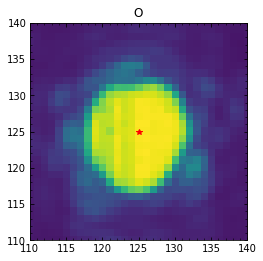

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07737.fits
bin_distcorr_lm_150104_07738.fits
8640.967784828024
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07738.fits: -0.9845962109187667, -0.4360642117085689


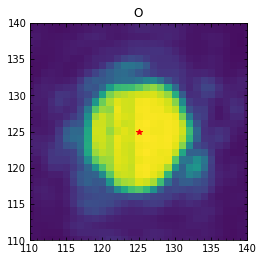

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07738.fits
bin_distcorr_lm_150104_07739.fits
8653.281055461306
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07739.fits: -0.9665027329216827, -0.4791431442410783


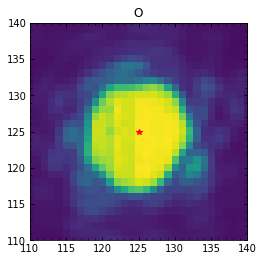

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07739.fits
bin_distcorr_lm_150104_07740.fits
8639.322986890276
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07740.fits: -0.9804381012899626, -0.6870009717518002


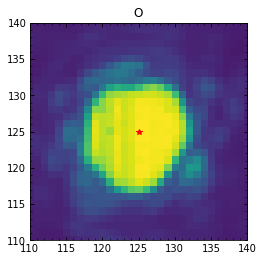

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07740.fits
bin_distcorr_lm_150104_07741.fits
8617.31835156504
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07741.fits: -0.9363301859824702, -0.6733010683621217


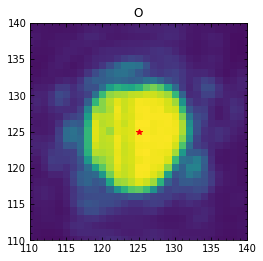

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07741.fits
bin_distcorr_lm_150104_07742.fits
8618.257685409253
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07742.fits: -0.9690169070218673, -0.6439433625933617


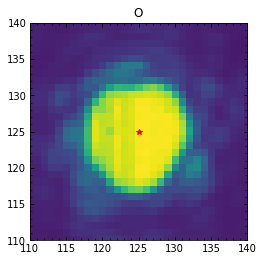

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07742.fits
bin_distcorr_lm_150104_07743.fits
8620.180620213045
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07743.fits: -0.968658941265808, -0.6575155560806394


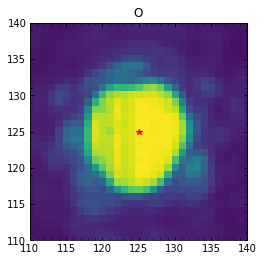

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07743.fits
bin_distcorr_lm_150104_07744.fits
8618.10416551899
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07744.fits: -0.9850791135928816, -0.6726766565050681


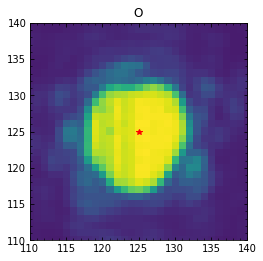

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07744.fits
bin_distcorr_lm_150104_07745.fits
8624.02419346149
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07745.fits: -0.9783322516219997, -0.45145407263304094


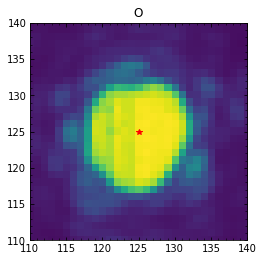

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07745.fits
bin_distcorr_lm_150104_07746.fits
8626.262638752954
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07746.fits: -0.9336949821784586, -0.6403729878363436


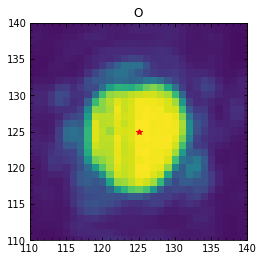

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07746.fits
bin_distcorr_lm_150104_07747.fits
8613.726616951042
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07747.fits: -0.9308198003788206, -0.6417475043362089


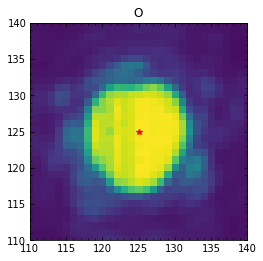

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07747.fits
bin_distcorr_lm_150104_07748.fits
8600.13693158818
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07748.fits: -0.9308100896057354, -0.639048114018145


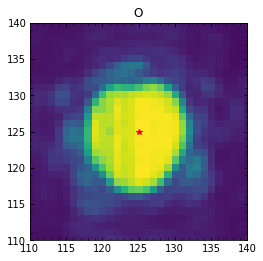

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07748.fits
bin_distcorr_lm_150104_07749.fits
8620.89318353527
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07749.fits: -0.9313782300240234, -0.6673605212248432


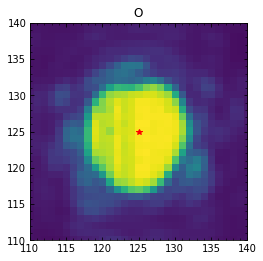

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07749.fits
bin_distcorr_lm_150104_07750.fits
8630.962879552937
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07750.fits: -0.9542403837014461, -0.6538740385569071


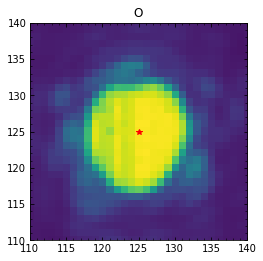

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07750.fits
bin_distcorr_lm_150104_07751.fits
8639.510671201957
STARTING  O
X: 206  Y: 322  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07751.fits: -0.9467344134640641, -0.6577623561385053


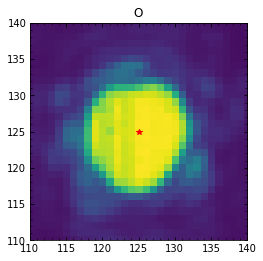

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07751.fits
bin_distcorr_lm_150104_07752.fits
8583.638117379774
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07752.fits: -0.7394422681586192, 0.18308722841105407


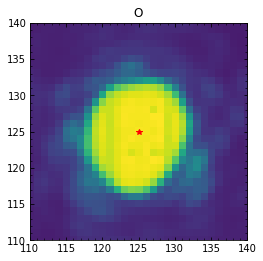

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07752.fits
bin_distcorr_lm_150104_07753.fits
8606.649459999155
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07753.fits: -0.7135735371466012, 0.17631426889839474


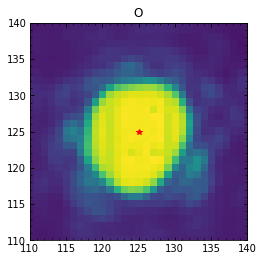

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07753.fits
bin_distcorr_lm_150104_07754.fits
8614.903279544083
STARTING  O
X: 210  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07754.fits: -0.7336871821809865, -0.7836371220603056


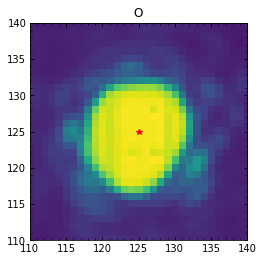

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07754.fits
bin_distcorr_lm_150104_07755.fits
8618.65775162575
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07755.fits: -0.7402962247649043, 0.17721176136377892


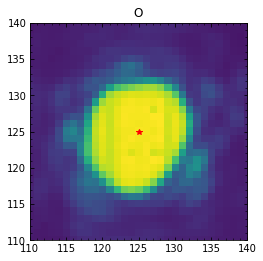

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07755.fits
bin_distcorr_lm_150104_07756.fits
8629.833214762717
STARTING  O
X: 210  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07756.fits: -0.7411822167154867, -0.7954001101095827


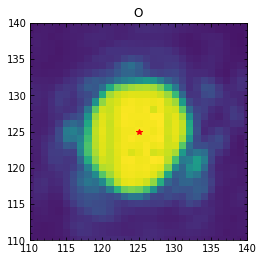

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07756.fits
bin_distcorr_lm_150104_07757.fits
8643.027914358801
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07757.fits: -0.7197356120211467, 0.15851539580060603


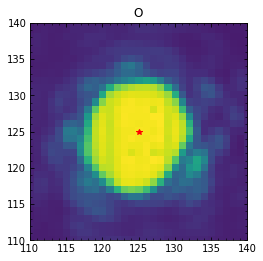

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07757.fits
bin_distcorr_lm_150104_07758.fits
8642.127149980073
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07758.fits: -0.7155953029119289, 0.16455173446037463


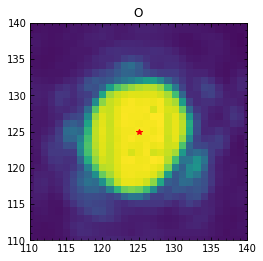

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07758.fits
bin_distcorr_lm_150104_07759.fits
8619.85864613131
STARTING  O
X: 210  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07759.fits: -0.6980339965952993, -0.7771749322165888


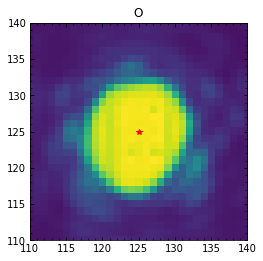

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07759.fits
bin_distcorr_lm_150104_07760.fits
8640.473455404823
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07760.fits: -0.7252576691734944, 0.16614551476125428


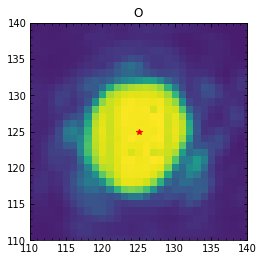

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07760.fits
bin_distcorr_lm_150104_07761.fits
8637.026029101427
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07761.fits: -0.6760520263049656, 0.1531553854213854


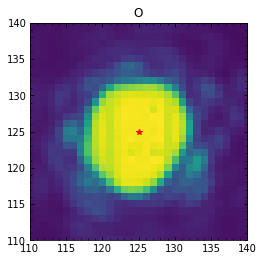

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07761.fits
bin_distcorr_lm_150104_07762.fits
8629.445842716417
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07762.fits: -0.6878844380886093, 0.15525522040915973


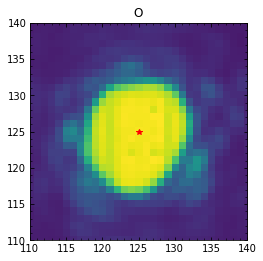

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07762.fits
bin_distcorr_lm_150104_07763.fits
8606.705818903625
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07763.fits: -0.7351646063643287, 0.1471310090432283


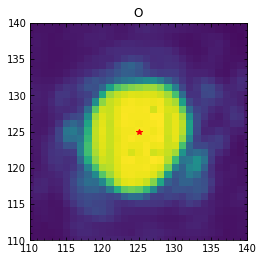

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07763.fits
bin_distcorr_lm_150104_07764.fits
8615.926306722735
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07764.fits: -0.7421455926960832, 0.17873914145788206


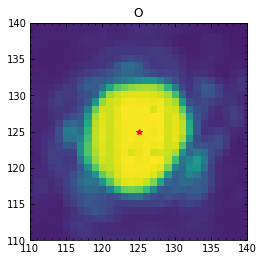

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07764.fits
bin_distcorr_lm_150104_07765.fits
8600.054282029609
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07765.fits: -0.7158733929191072, 0.18561884715617794


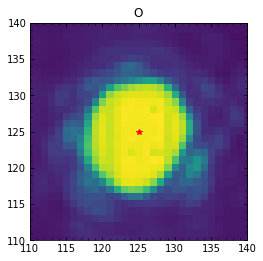

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07765.fits
bin_distcorr_lm_150104_07766.fits
8590.507092405434
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07766.fits: -0.7229198583911014, 0.21796382309344864


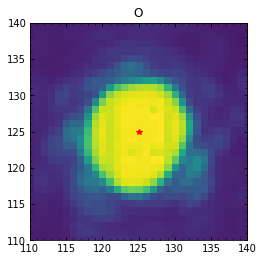

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07766.fits
bin_distcorr_lm_150104_07767.fits
8626.637446712111
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07767.fits: -0.6916884936885168, 0.1737851686692764


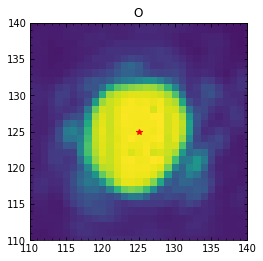

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07767.fits
bin_distcorr_lm_150104_07768.fits
8640.600593281677
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07768.fits: -0.6712327434982086, 0.17731174933080496


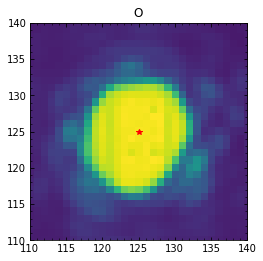

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07768.fits
bin_distcorr_lm_150104_07769.fits
8619.740890237883
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07769.fits: -0.67443913017798, 0.13648030287556878


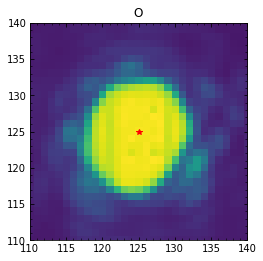

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07769.fits
bin_distcorr_lm_150104_07770.fits
8634.518644032985
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07770.fits: -0.6575076567685159, 0.14730995381107448


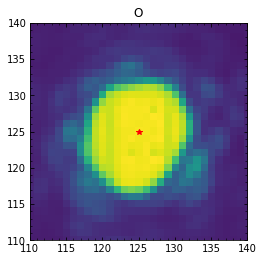

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07770.fits
bin_distcorr_lm_150104_07771.fits
8627.902890658377
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07771.fits: -0.6473222190141499, 0.14395228982154862


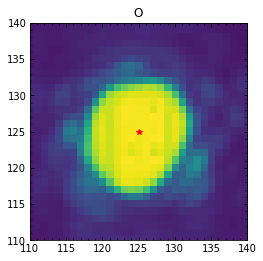

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07771.fits
bin_distcorr_lm_150104_07772.fits
8598.257095887504
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07772.fits: -0.6549211905259469, 0.1885552750569417


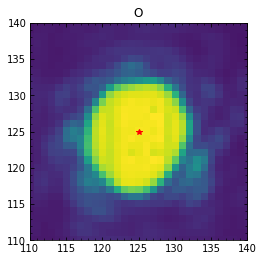

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07772.fits
bin_distcorr_lm_150104_07773.fits
8604.183078144139
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07773.fits: -0.6625200100316491, 0.19799001554410012


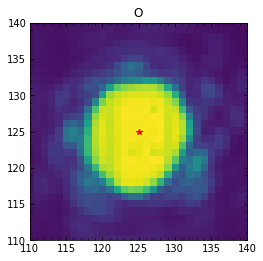

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07773.fits
bin_distcorr_lm_150104_07774.fits
8608.541243559715
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07774.fits: -0.6662572708215606, 0.16139394591297673


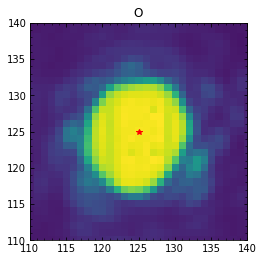

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07774.fits
bin_distcorr_lm_150104_07775.fits
8650.412347797439
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07775.fits: -0.7299621375339029, 0.15022503975597346


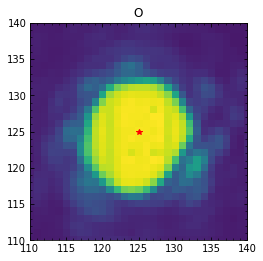

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07775.fits
bin_distcorr_lm_150104_07776.fits
8596.994196562076
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07776.fits: -0.6531461359218156, 0.17686688475248502


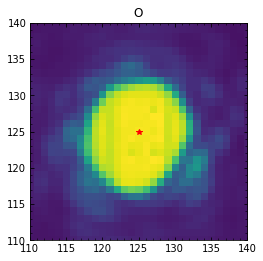

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07776.fits
bin_distcorr_lm_150104_07777.fits
8619.831121895337
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07777.fits: -0.6696646567460007, 0.1801931049943164


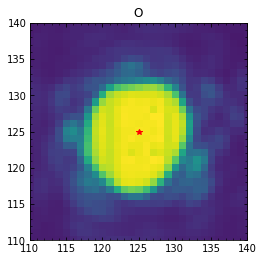

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07777.fits
bin_distcorr_lm_150104_07778.fits
8622.807507254201
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07778.fits: -0.6336597909732262, 0.12536809814181993


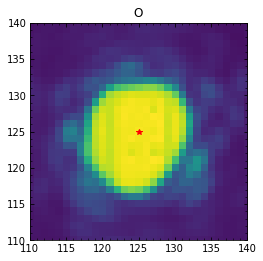

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07778.fits
bin_distcorr_lm_150104_07779.fits
8637.322540483816
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07779.fits: -0.669571900218429, 0.14911053916527806


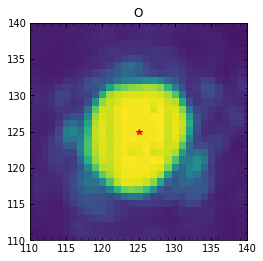

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07779.fits
bin_distcorr_lm_150104_07780.fits
8616.448470787203
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07780.fits: -0.6223696358228139, 0.09801953499271576


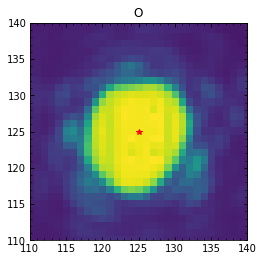

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07780.fits
bin_distcorr_lm_150104_07781.fits
8648.86122801158
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07781.fits: -0.670554853674858, 0.09101902225944514


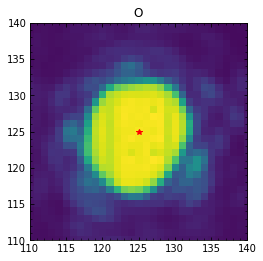

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07781.fits
bin_distcorr_lm_150104_07782.fits
8626.039084437321
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07782.fits: -0.6703531885133884, 0.13135707397267993


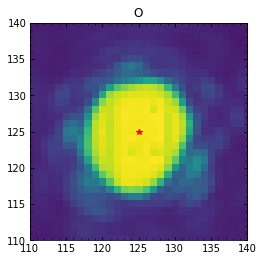

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07782.fits
bin_distcorr_lm_150104_07783.fits
8593.26603315627
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07783.fits: -0.6907129151963929, 0.14518999282584133


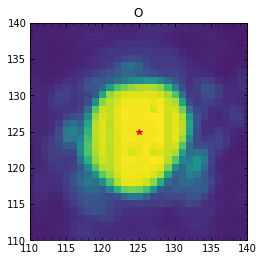

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07783.fits
bin_distcorr_lm_150104_07784.fits
8585.744194950585
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07784.fits: -0.6575352852890362, 0.11626497497494626


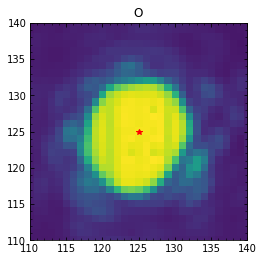

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07784.fits
bin_distcorr_lm_150104_07785.fits
8630.478344571598
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07785.fits: -0.6902883658802494, 0.15113378525826704


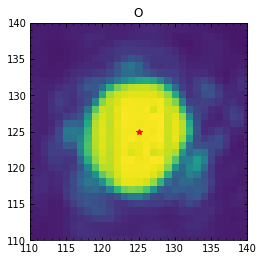

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07785.fits
bin_distcorr_lm_150104_07786.fits
8602.276165459069
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07786.fits: -0.6896145131680811, 0.1118513210203389


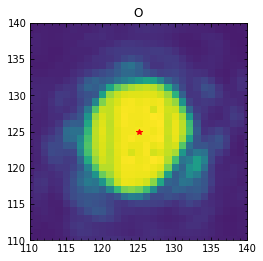

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07786.fits
bin_distcorr_lm_150104_07787.fits
8621.750675467032
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07787.fits: -0.6344131512502784, 0.15079317997170705


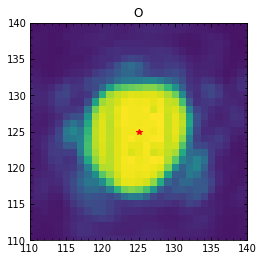

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07787.fits
bin_distcorr_lm_150104_07788.fits
8628.941868821028
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07788.fits: -0.6671506945321966, 0.10377122393897764


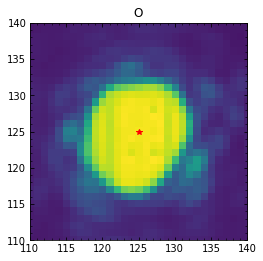

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07788.fits
bin_distcorr_lm_150104_07789.fits
8608.135794983873
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07789.fits: -0.6811122777748224, 0.12787638572364557


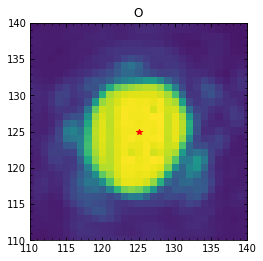

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07789.fits
bin_distcorr_lm_150104_07790.fits
8597.633021698442
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07790.fits: -0.673607538283818, 0.10892420004874026


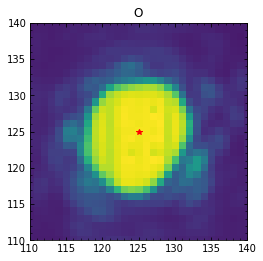

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07790.fits
bin_distcorr_lm_150104_07791.fits
8641.62037185511
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07791.fits: -0.6733198493711825, 0.09683091782385134


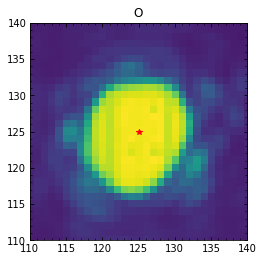

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07791.fits
bin_distcorr_lm_150104_07792.fits
8584.216816263044
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07792.fits: -0.6508019686871407, 0.08417308246442445


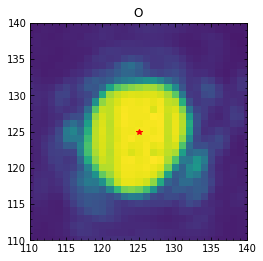

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07792.fits
bin_distcorr_lm_150104_07793.fits
8598.901937507142
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07793.fits: -0.6355470353957458, 0.05710073160984308


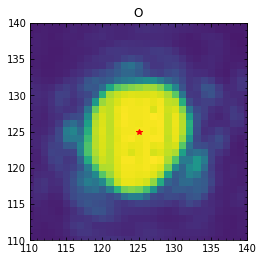

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07793.fits
bin_distcorr_lm_150104_07794.fits
8600.986091878789
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07794.fits: -0.6876664790814644, 0.06428287949749745


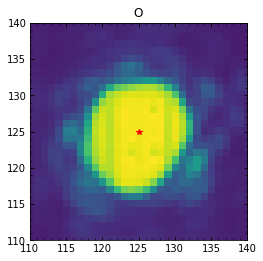

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07794.fits
bin_distcorr_lm_150104_07795.fits
8615.410539371529
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07795.fits: -0.707826769148916, 0.07060013853881486


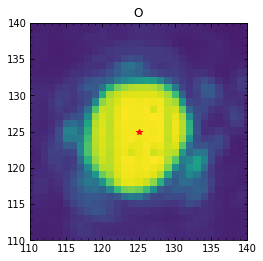

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07795.fits
bin_distcorr_lm_150104_07796.fits
8633.664995515488
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07796.fits: -0.7108449349308259, 0.05618425506973779


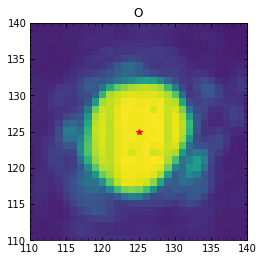

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07796.fits
bin_distcorr_lm_150104_07797.fits
8582.07263704994
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07797.fits: -0.6448981305801169, 0.0569447429101686


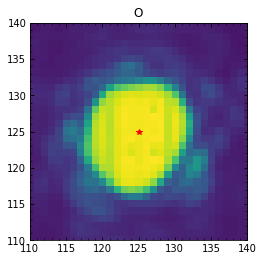

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07797.fits
bin_distcorr_lm_150104_07798.fits
8610.31652291006
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07798.fits: -0.6502519884868576, 0.08172808135221032


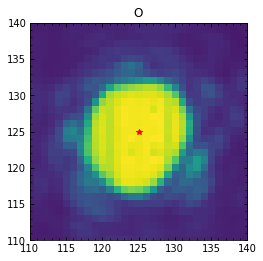

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07798.fits
bin_distcorr_lm_150104_07799.fits
8648.949782174635
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07799.fits: -0.6377310454873211, 0.0676723672902142


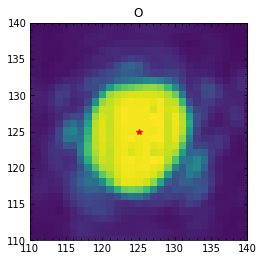

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07799.fits
bin_distcorr_lm_150104_07800.fits
8638.303565852664
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07800.fits: -0.6611688663491933, 0.09903023551463264


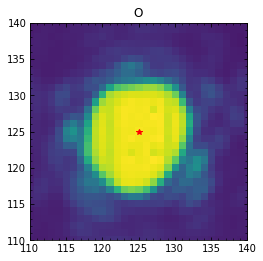

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07800.fits
bin_distcorr_lm_150104_07801.fits
8603.044205650905
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07801.fits: -0.686242045132353, 0.09271980742726527


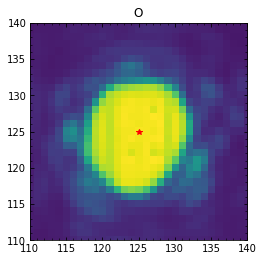

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07801.fits
bin_distcorr_lm_150104_07802.fits
8642.385519016518
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07802.fits: -0.6873587494570543, 0.05443493810607691


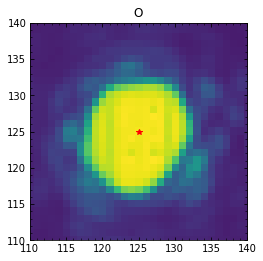

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07802.fits
bin_distcorr_lm_150104_07803.fits
8608.830705541905
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07803.fits: -0.6781242262434617, 0.07584268599362076


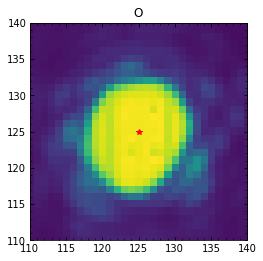

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07803.fits
bin_distcorr_lm_150104_07804.fits
8615.74525960391
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07804.fits: -0.6797852903023411, 0.07467848521415732


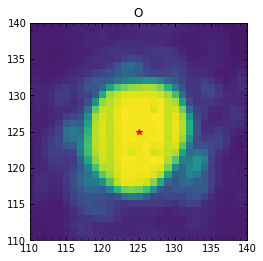

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07804.fits
bin_distcorr_lm_150104_07805.fits
8630.993211699519
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07805.fits: -0.6997550408086113, 0.04271658486237584


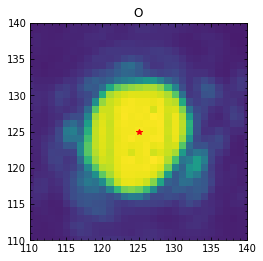

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07805.fits
bin_distcorr_lm_150104_07806.fits
8644.97374162581
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07806.fits: -0.7049684288722702, 0.05347116333700086


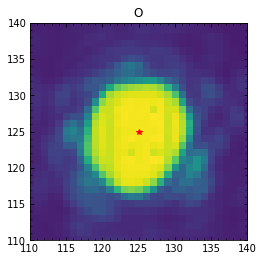

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07806.fits
bin_distcorr_lm_150104_07807.fits
8660.057558295637
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07807.fits: -0.644886855179692, 0.06794198100104865


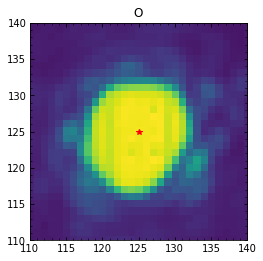

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07807.fits
bin_distcorr_lm_150104_07808.fits
8633.402760044874
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07808.fits: -0.6329779818864409, 0.08347631865700578


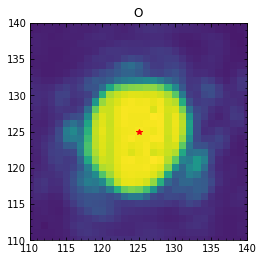

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07808.fits
bin_distcorr_lm_150104_07809.fits
8596.08193599829
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07809.fits: -0.6678566401250166, 0.06084921052813286


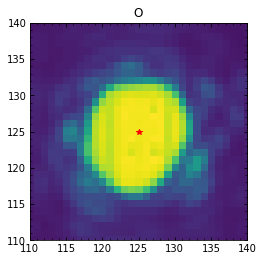

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07809.fits
bin_distcorr_lm_150104_07810.fits
8642.061338875763
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07810.fits: -0.6868524466034458, 0.023488185177924947


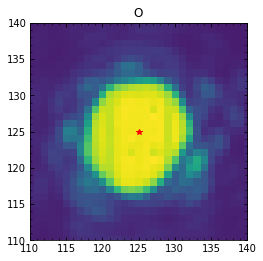

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07810.fits
bin_distcorr_lm_150104_07811.fits
8650.582745430955
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07811.fits: -0.6806415902269833, 0.07646540221814035


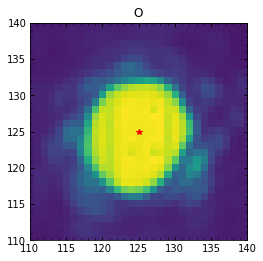

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07811.fits
bin_distcorr_lm_150104_07812.fits
8643.614437855449
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07812.fits: -0.6282306755877727, 0.07464304413502987


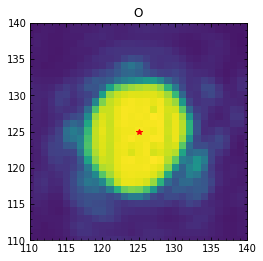

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07812.fits
bin_distcorr_lm_150104_07813.fits
8646.27056506669
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07813.fits: -0.6396248991611699, 0.07083294458426082


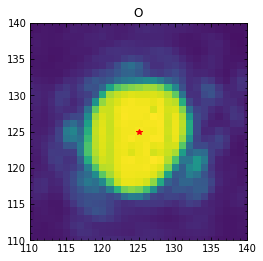

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07813.fits
bin_distcorr_lm_150104_07814.fits
8666.668094548877
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07814.fits: -0.6679483960837587, 0.056112170917543835


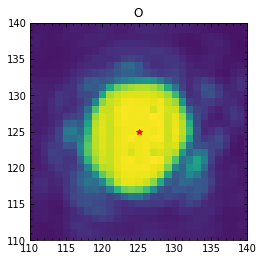

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07814.fits
bin_distcorr_lm_150104_07815.fits
8670.682126992611
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07815.fits: -0.6380628858408386, 0.0327247053376567


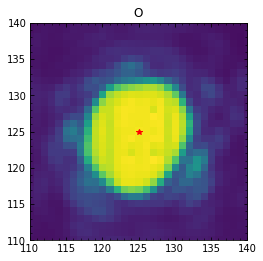

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07815.fits
bin_distcorr_lm_150104_07816.fits
8643.665893174006
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07816.fits: -0.6627402556875097, 0.06585089209359296


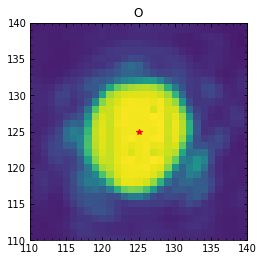

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07816.fits
bin_distcorr_lm_150104_07817.fits
8632.268729626512
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07817.fits: -0.6223305193594939, 0.043662653155017495


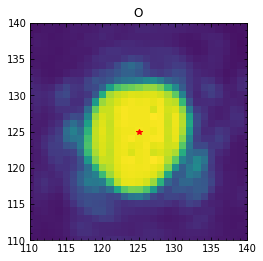

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07817.fits
bin_distcorr_lm_150104_07818.fits
8615.01068396514
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07818.fits: -0.6434130985476116, 0.07375199898356755


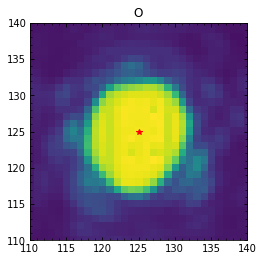

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07818.fits
bin_distcorr_lm_150104_07819.fits
8645.972850199256
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07819.fits: -0.6757313836128631, 0.08085697171357964


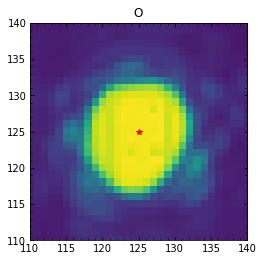

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07819.fits
bin_distcorr_lm_150104_07820.fits
8680.584905630469
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07820.fits: -0.7271631625672939, 0.02552552375914985


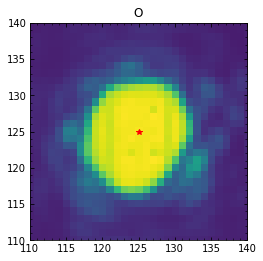

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07820.fits
bin_distcorr_lm_150104_07821.fits
8669.139818178563
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07821.fits: -0.7344110319783965, 0.0390720934276203


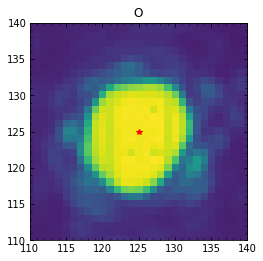

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07821.fits
bin_distcorr_lm_150104_07822.fits
8689.925754858019
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07822.fits: -0.7101985931474957, 0.06076676098514611


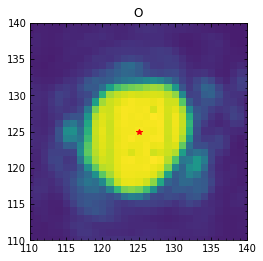

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07822.fits
bin_distcorr_lm_150104_07823.fits
8673.307327727705
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07823.fits: -0.7014369845165405, 0.03256814839807021


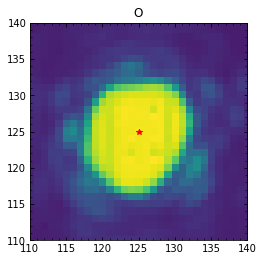

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07823.fits
bin_distcorr_lm_150104_07824.fits
8686.639115336173
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07824.fits: -0.7344976374338756, 0.012583473036620774


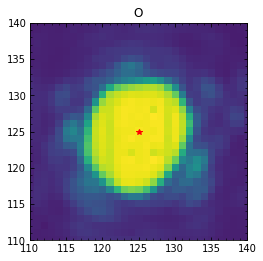

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07824.fits
bin_distcorr_lm_150104_07825.fits
8633.686468910084
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07825.fits: -0.7019229603857156, 0.02435960872598031


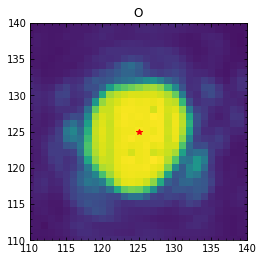

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07825.fits
bin_distcorr_lm_150104_07826.fits
8667.941028982175
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07826.fits: -0.6826652926725245, 0.002766736316090146


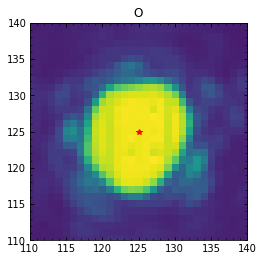

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07826.fits
bin_distcorr_lm_150104_07827.fits
8672.193050297843
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07827.fits: -0.7138612837718412, -0.007215886425520068


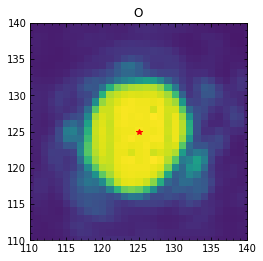

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07827.fits
bin_distcorr_lm_150104_07828.fits
8662.249350865783
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07828.fits: -0.6928149739595781, 0.028989255925552015


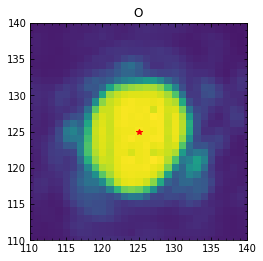

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07828.fits
bin_distcorr_lm_150104_07829.fits
8699.020030098553
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07829.fits: -0.7566674461569534, 0.060737258759168355


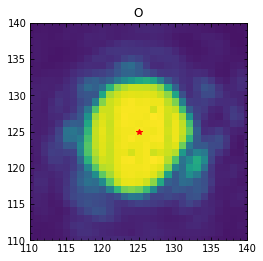

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07829.fits
bin_distcorr_lm_150104_07830.fits
8666.186029709672
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07830.fits: -0.7147202445443455, 0.015910180448798883


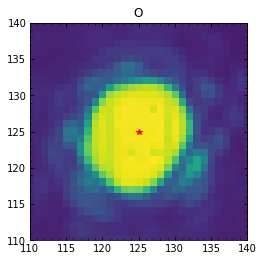

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07830.fits
bin_distcorr_lm_150104_07831.fits
8683.41410597019
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07831.fits: -0.7056382671173935, -0.013560498159208123


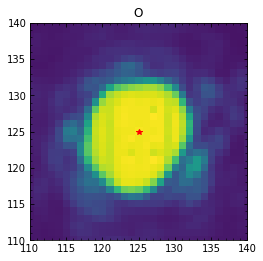

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07831.fits
bin_distcorr_lm_150104_07832.fits
8660.216816896338
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07832.fits: -0.6967913611554977, 0.008581777286721604


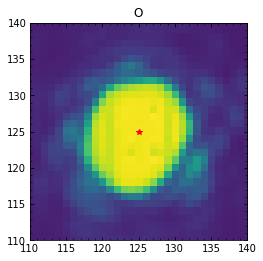

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07832.fits
bin_distcorr_lm_150104_07833.fits
8678.688916182173
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07833.fits: -0.7144873592875882, 0.039999080198604986


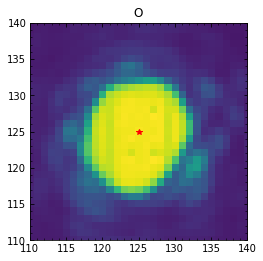

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07833.fits
bin_distcorr_lm_150104_07834.fits
8659.879760367005
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07834.fits: -0.6801139663933284, 0.04078860852548871


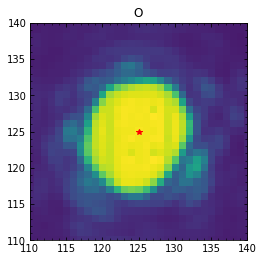

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07834.fits
bin_distcorr_lm_150104_07835.fits
8646.5308549009
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07835.fits: -0.6274531658853277, 0.057593219160580134


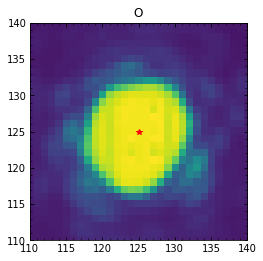

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07835.fits
bin_distcorr_lm_150104_07836.fits
8649.105019928627
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07836.fits: -0.6273666391626378, 0.07646939962787513


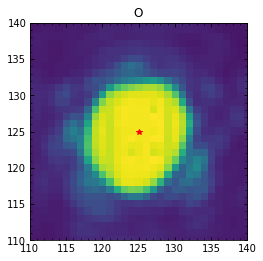

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07836.fits
bin_distcorr_lm_150104_07837.fits
8649.563525630496
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07837.fits: -0.670314044129924, 0.08874767727810706


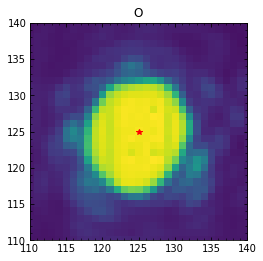

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07837.fits
bin_distcorr_lm_150104_07838.fits
8633.655711125864
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07838.fits: -0.6508661723724174, 0.09253736824424408


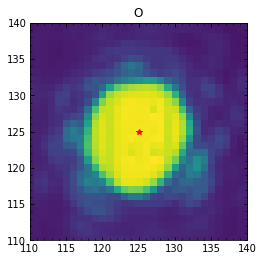

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07838.fits
bin_distcorr_lm_150104_07839.fits
8646.440394497786
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07839.fits: -0.6533458802501713, 0.10172696641721046


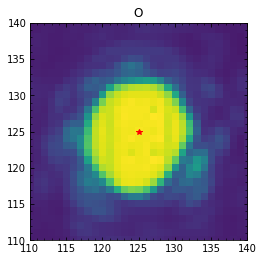

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07839.fits
bin_distcorr_lm_150104_07840.fits
8643.501723446312
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07840.fits: -0.6382228623961694, 0.09746341128912661


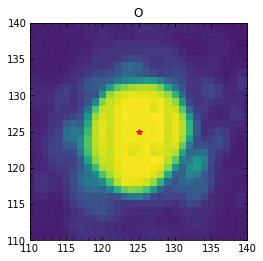

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07840.fits
bin_distcorr_lm_150104_07841.fits
8631.740803412524
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07841.fits: -0.6303555212856793, 0.08669169770659124


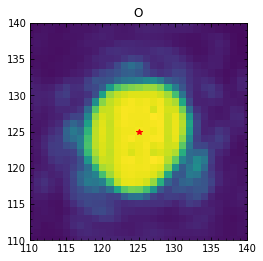

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07841.fits
bin_distcorr_lm_150104_07842.fits
8671.19192614169
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07842.fits: -0.6441999026951706, 0.06584866639668974


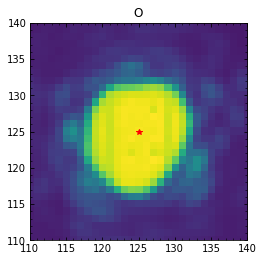

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07842.fits
bin_distcorr_lm_150104_07843.fits
8675.268644045165
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07843.fits: -0.6796490128237593, 0.03888618872112204


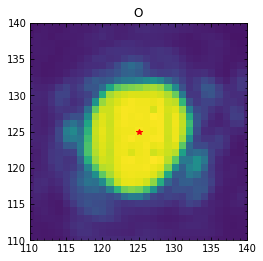

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07843.fits
bin_distcorr_lm_150104_07844.fits
8717.283586170819
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07844.fits: -0.67314601447071, 0.004243393137159046


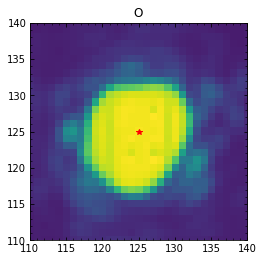

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07844.fits
bin_distcorr_lm_150104_07845.fits
8668.65338805856
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07845.fits: -0.7247166569039436, 0.003955841237164748


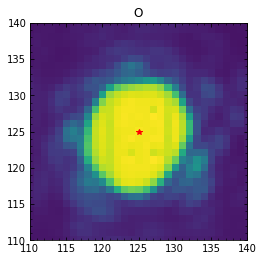

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07845.fits
bin_distcorr_lm_150104_07846.fits
8673.855747093352
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07846.fits: -0.7043982618420301, -0.026153250883943713


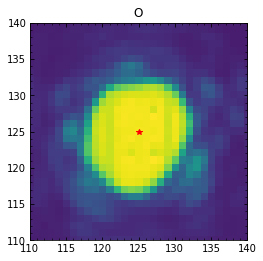

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07846.fits
bin_distcorr_lm_150104_07847.fits
8664.238978737114
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07847.fits: -0.704765931345996, -0.016905804934452817


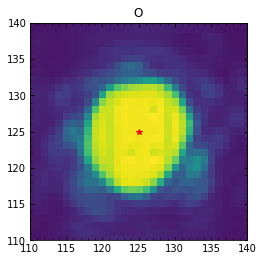

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07847.fits
bin_distcorr_lm_150104_07848.fits
8658.098860560427
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07848.fits: -0.692946361177647, -0.0020586213542017617


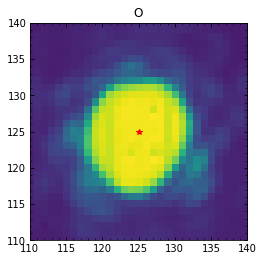

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07848.fits
bin_distcorr_lm_150104_07849.fits
8671.685016202251
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07849.fits: -0.7051904048666344, 0.00018980503979548757


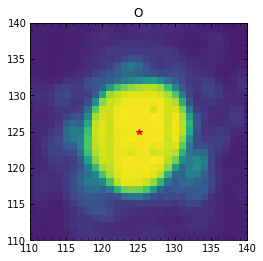

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07849.fits
bin_distcorr_lm_150104_07850.fits
8677.86283504021
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07850.fits: -0.694354641945317, 0.009171016016466638


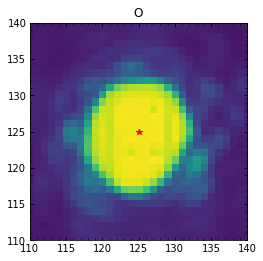

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07850.fits
bin_distcorr_lm_150104_07851.fits
8691.793340623552
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07851.fits: -0.7243124616193128, -0.03409024234798608


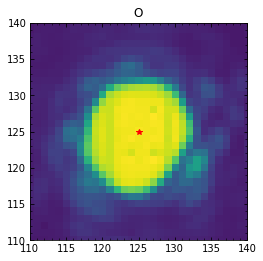

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07851.fits
bin_distcorr_lm_150104_07852.fits
8677.980062468827
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07852.fits: -0.6871912001422515, -0.049472112085176434


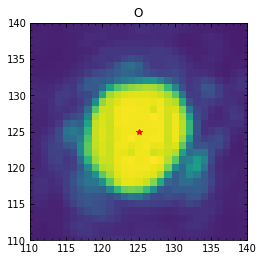

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07852.fits
bin_distcorr_lm_150104_07853.fits
8670.826490105335
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07853.fits: -0.666372756610599, -0.028861654379554125


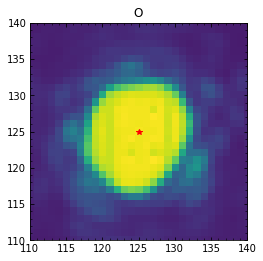

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07853.fits
bin_distcorr_lm_150104_07854.fits
8701.496056875203
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07854.fits: -0.6829970505521317, -0.029164755862481684


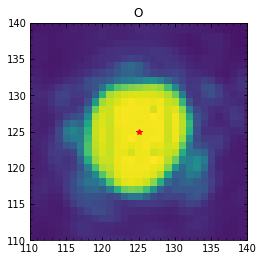

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07854.fits
bin_distcorr_lm_150104_07855.fits
8710.275609930039
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07855.fits: -0.6708288364323565, -0.05792576206722799


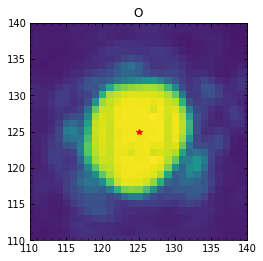

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07855.fits
bin_distcorr_lm_150104_07856.fits
8688.438765265988
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07856.fits: -0.65423324555546, -0.07664408011853396


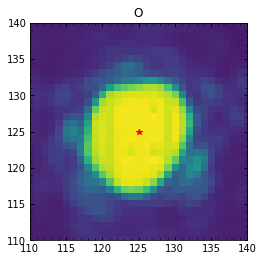

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07856.fits
bin_distcorr_lm_150104_07857.fits
8662.748539601294
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07857.fits: -0.64421917584027, 0.01203065868057962


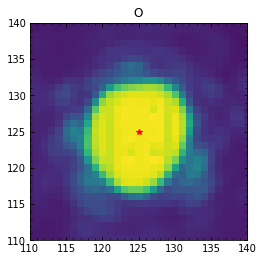

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07857.fits
bin_distcorr_lm_150104_07858.fits
8657.703661031968
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07858.fits: -0.6808166954034647, -0.02198512882926451


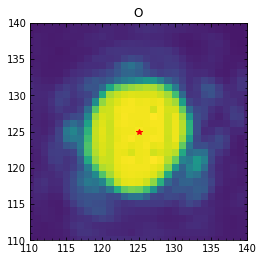

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07858.fits
bin_distcorr_lm_150104_07859.fits
8673.93917585491
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07859.fits: -0.6737831703904575, -0.01653153510029881


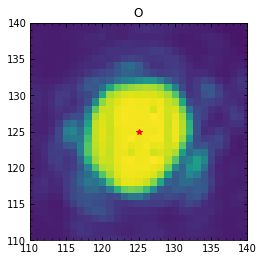

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07859.fits
bin_distcorr_lm_150104_07860.fits
8658.271236307208
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07860.fits: -0.6473559158013344, -0.011597228977663576


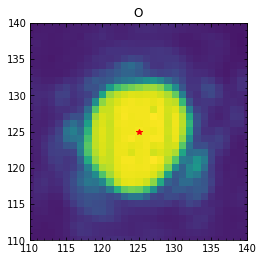

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07860.fits
bin_distcorr_lm_150104_07861.fits
8657.503253921685
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07861.fits: -0.6388473137642237, 0.029217501032810844


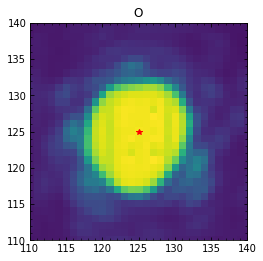

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07861.fits
bin_distcorr_lm_150104_07862.fits
8687.98034250808
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07862.fits: -0.7080494940746505, -0.05130154252297814


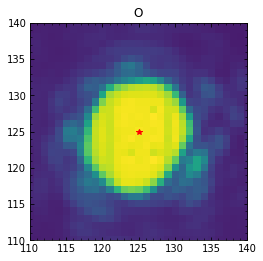

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07862.fits
bin_distcorr_lm_150104_07863.fits
8655.021409751225
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07863.fits: -0.7194708288634146, -0.027963843854685422


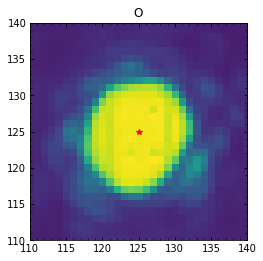

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07863.fits
bin_distcorr_lm_150104_07864.fits
8659.441219568369
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07864.fits: -0.6723725241570548, 0.0120545230577207


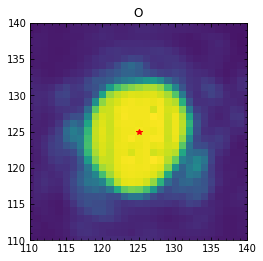

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07864.fits
bin_distcorr_lm_150104_07865.fits
8681.868394235413
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07865.fits: -0.6851180154683831, -0.04028962353734755


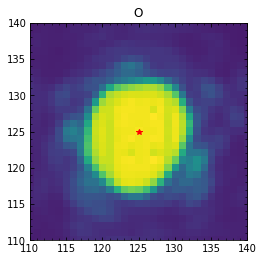

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07865.fits
bin_distcorr_lm_150104_07866.fits
8674.726855988723
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07866.fits: -0.702208619477318, -0.003907223066953236


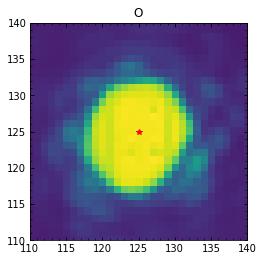

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07866.fits
bin_distcorr_lm_150104_07867.fits
8669.455627287824
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07867.fits: -0.6723825753038071, -0.06944784510152147


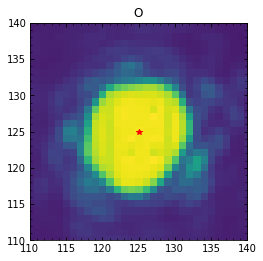

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07867.fits
bin_distcorr_lm_150104_07868.fits
8686.228607189489
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07868.fits: -0.6714698359743494, -0.07274615358226555


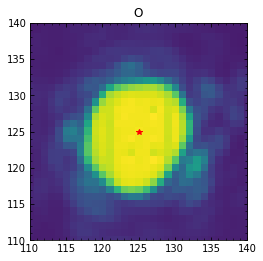

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07868.fits
bin_distcorr_lm_150104_07869.fits
8679.322901347441
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07869.fits: -0.6738662411697405, -0.044382581893593454


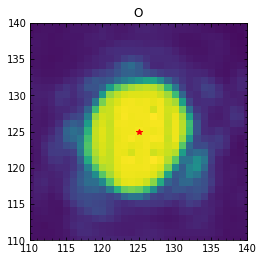

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07869.fits
bin_distcorr_lm_150104_07870.fits
8632.59041301717
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07870.fits: -0.6893261813657219, 0.01614108771703826


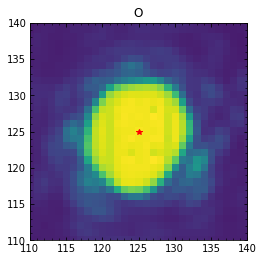

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07870.fits
bin_distcorr_lm_150104_07871.fits
8631.938452394083
STARTING  O
X: 211  Y: 133  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07871.fits: -0.6865959898964533, -0.022043207642596485


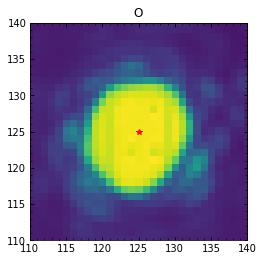

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07871.fits
bin_distcorr_lm_150104_07872.fits
8681.374891467043
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07872.fits: -0.3357261528768376, 0.11612086178995895


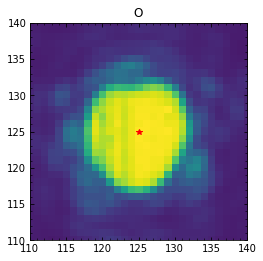

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07872.fits
bin_distcorr_lm_150104_07873.fits
8651.118697893846
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07873.fits: -0.34119581333459337, 0.1444269793280668


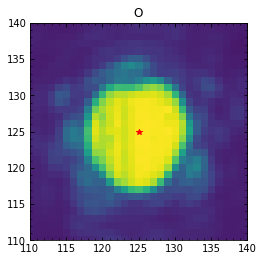

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07873.fits
bin_distcorr_lm_150104_07874.fits
8639.178384839443
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07874.fits: -0.3334095262036598, 0.0909727450395792


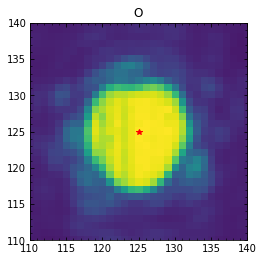

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07874.fits
bin_distcorr_lm_150104_07875.fits
8694.737200526451
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07875.fits: -0.3509030020141708, 0.11313862490639082


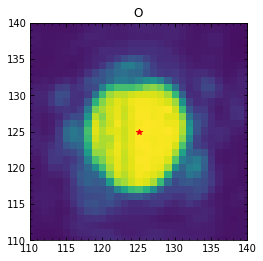

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07875.fits
bin_distcorr_lm_150104_07876.fits
8647.461576588614
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07876.fits: -0.3453091294135149, 0.10044975208538887


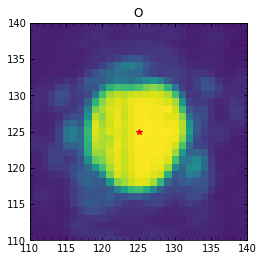

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07876.fits
bin_distcorr_lm_150104_07877.fits
8670.579091580214
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07877.fits: -0.3719686532960793, 0.0556462418355963


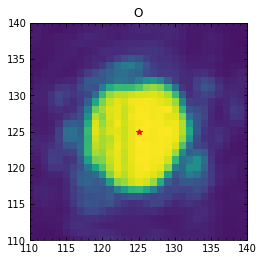

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07877.fits
bin_distcorr_lm_150104_07878.fits
8680.278987055239
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07878.fits: -0.3584674782461974, 0.07027083915650678


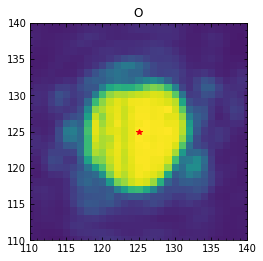

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07878.fits
bin_distcorr_lm_150104_07879.fits
8675.758368220631
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07879.fits: -0.3644166012358596, 0.0518381387522453


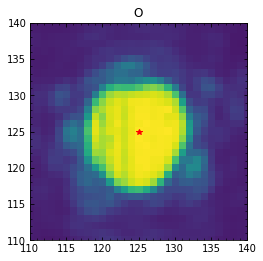

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07879.fits
bin_distcorr_lm_150104_07880.fits
8631.729745124883
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07880.fits: -0.37460946761726177, 0.06730260135942956


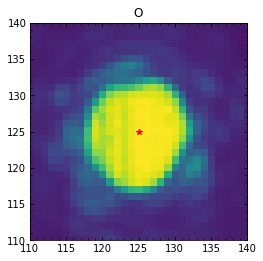

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07880.fits
bin_distcorr_lm_150104_07881.fits
8654.162792175828
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07881.fits: -0.3377295369418789, 0.04088240645452146


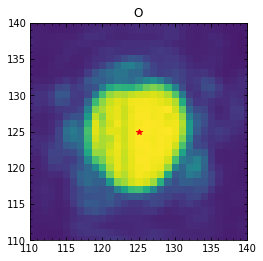

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07881.fits
bin_distcorr_lm_150104_07882.fits
8700.27726184496
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07882.fits: -0.3669127293226566, 0.03554747797065971


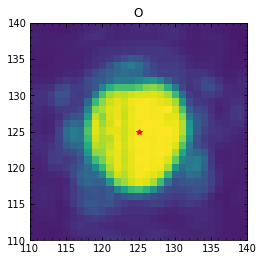

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07882.fits
bin_distcorr_lm_150104_07883.fits
8642.899675088978
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07883.fits: -0.389667627484684, 0.053691620653999905


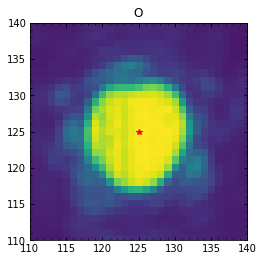

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07883.fits
bin_distcorr_lm_150104_07884.fits
8669.399303902945
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07884.fits: -0.36193028843083397, 0.08040149820600107


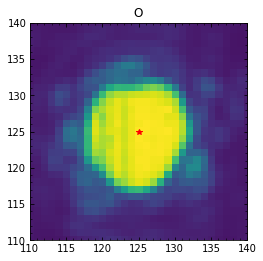

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07884.fits
bin_distcorr_lm_150104_07885.fits
8681.917524693305
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07885.fits: -0.3511061302673113, 0.07338109211749355


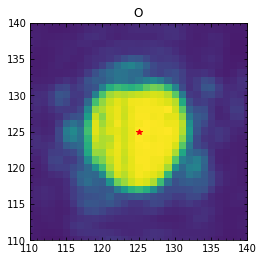

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07885.fits
bin_distcorr_lm_150104_07886.fits
8675.489581104386
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07886.fits: -0.34009701061771125, 0.052916791240193106


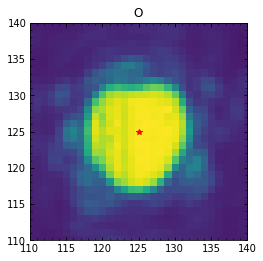

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07886.fits
bin_distcorr_lm_150104_07887.fits
8680.400607983707
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07887.fits: -0.3404189140228624, 0.07914656563083611


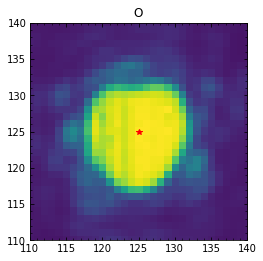

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07887.fits
bin_distcorr_lm_150104_07888.fits
8703.442850662745
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07888.fits: -0.3655776585962158, 0.03956147241625274


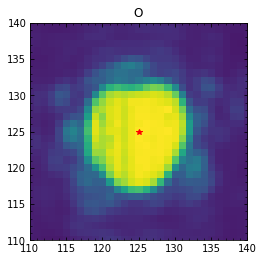

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07888.fits
bin_distcorr_lm_150104_07889.fits
8661.809632039387
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07889.fits: -0.4137089030759, 0.03366451525940306


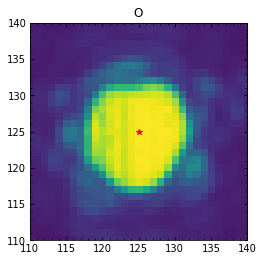

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07889.fits
bin_distcorr_lm_150104_07890.fits
8629.94327336801
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07890.fits: -0.4185665752445402, 0.040059783636550605


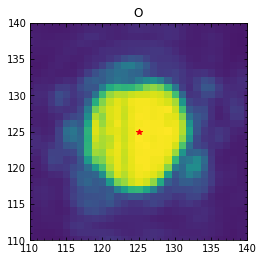

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07890.fits
bin_distcorr_lm_150104_07891.fits
8698.55052630424
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07891.fits: -0.331967610839321, 0.07159335431450131


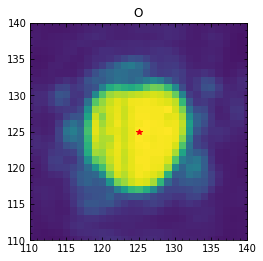

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07891.fits
bin_distcorr_lm_150104_07892.fits
8642.163789871935
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07892.fits: -0.35729387601610085, 0.06214243188220081


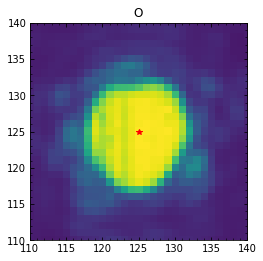

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07892.fits
bin_distcorr_lm_150104_07893.fits
8624.073245647865
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07893.fits: -0.36310910210504943, 0.048472738212488764


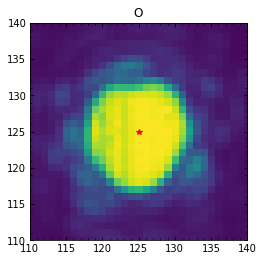

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07893.fits
bin_distcorr_lm_150104_07894.fits
8659.867050696432
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07894.fits: -0.38214342786766764, 0.05754914449639159


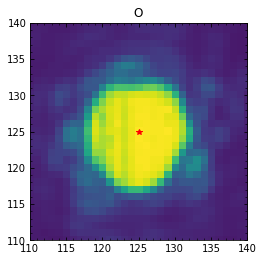

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07894.fits
bin_distcorr_lm_150104_07895.fits
8682.815683135217
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07895.fits: -0.43972687147866907, 0.04021932580562293


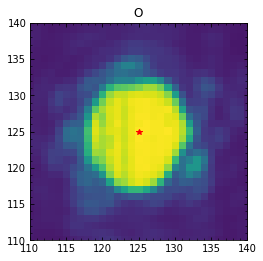

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07895.fits
bin_distcorr_lm_150104_07896.fits
8658.422281968857
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07896.fits: -0.39461100933955606, 0.035037549174354865


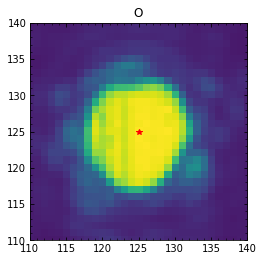

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07896.fits
bin_distcorr_lm_150104_07897.fits
8692.972265418917
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07897.fits: -0.39541444552883576, -0.014325270121489098


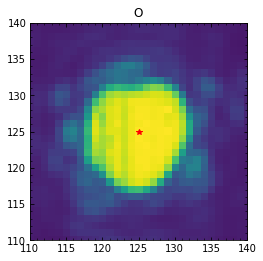

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07897.fits
bin_distcorr_lm_150104_07898.fits
8713.771063359285
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07898.fits: -0.39842632329155236, 0.010355668323548173


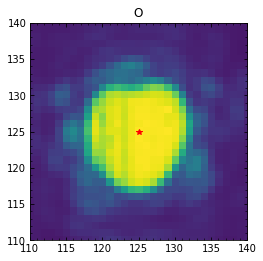

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07898.fits
bin_distcorr_lm_150104_07899.fits
8701.561941215701
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07899.fits: -0.37742210640988816, -0.028192031013496432


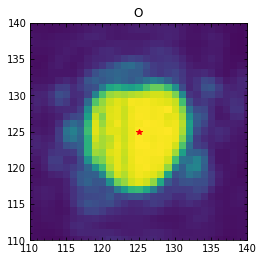

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07899.fits
bin_distcorr_lm_150104_07900.fits
8656.37093955564
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07900.fits: -0.3828060275430545, -0.020903953459715297


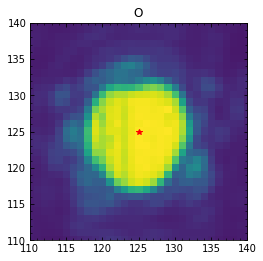

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07900.fits
bin_distcorr_lm_150104_07901.fits
8667.34456533016
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07901.fits: -0.40992073074644964, 0.018908214894032938


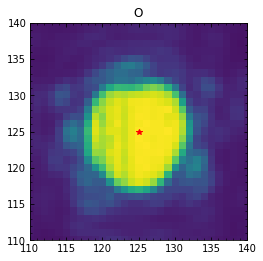

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07901.fits
bin_distcorr_lm_150104_07902.fits
8647.115972920628
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07902.fits: -0.4040149379310094, 0.020053391190138825


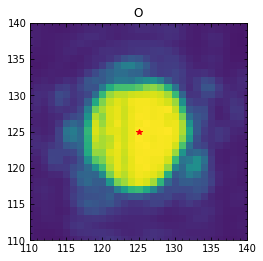

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07902.fits
bin_distcorr_lm_150104_07903.fits
8663.765798125565
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07903.fits: -0.4215293292881839, 0.014379828497794733


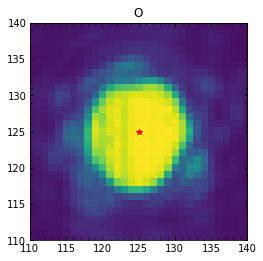

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07903.fits
bin_distcorr_lm_150104_07904.fits
8667.879875671943
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07904.fits: -0.41292672173155154, 0.003439869044036925


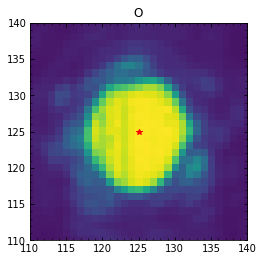

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07904.fits
bin_distcorr_lm_150104_07905.fits
8638.854795425039
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07905.fits: -0.36402111379759106, -0.05120056135133666


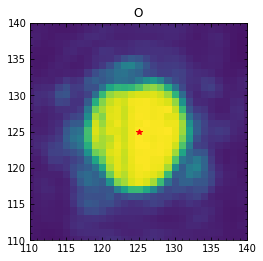

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07905.fits
bin_distcorr_lm_150104_07906.fits
8655.177138861696
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07906.fits: -0.33669178164434754, -0.043339903441463434


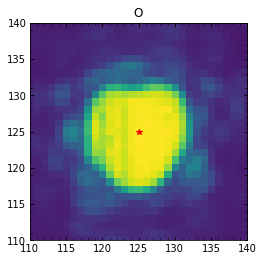

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07906.fits
bin_distcorr_lm_150104_07907.fits
8685.317054852721
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07907.fits: -0.36910964209619834, -0.06604513360960595


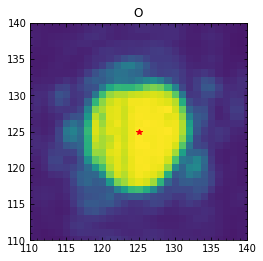

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07907.fits
bin_distcorr_lm_150104_07908.fits
8685.9171104593
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07908.fits: -0.37055832630189656, -0.015117619106923996


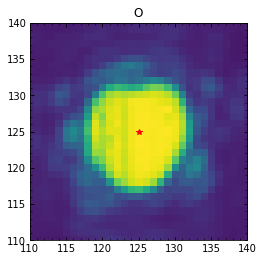

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07908.fits
bin_distcorr_lm_150104_07909.fits
8669.057742918569
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07909.fits: -0.3942714404607912, -0.011327980518878178


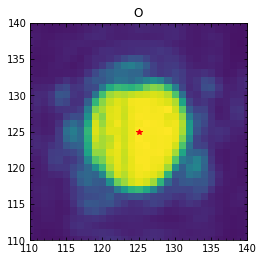

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07909.fits
bin_distcorr_lm_150104_07910.fits
8649.259032655713
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07910.fits: -0.42390442214217927, -0.0002969772025949169


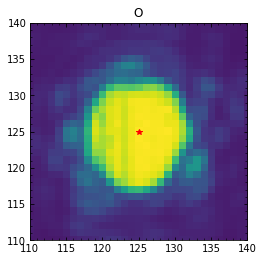

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07910.fits
bin_distcorr_lm_150104_07911.fits
8650.120818791383
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07911.fits: -0.419977564673367, -0.03549777008960575


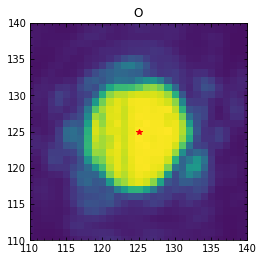

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07911.fits
bin_distcorr_lm_150104_07912.fits
8663.358546736912
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07912.fits: -0.37795623103770737, -0.018224643041314437


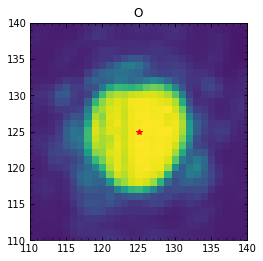

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07912.fits
bin_distcorr_lm_150104_07913.fits
8671.677135928034
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07913.fits: -0.35738745500299984, 0.012834256563266422


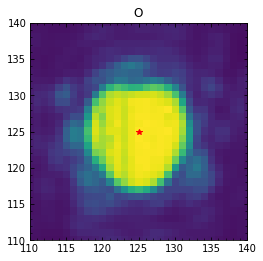

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07913.fits
bin_distcorr_lm_150104_07914.fits
8676.918859064703
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07914.fits: -0.3616822661150749, -0.004424539641519232


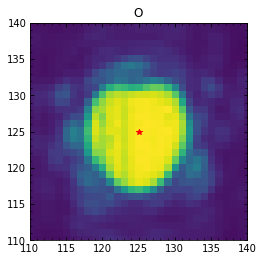

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07914.fits
bin_distcorr_lm_150104_07915.fits
8684.585500865873
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07915.fits: -0.3819188129682942, 0.01495513762419165


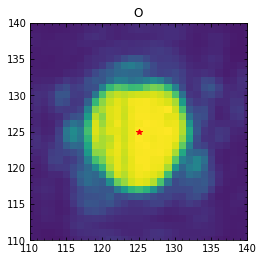

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07915.fits
bin_distcorr_lm_150104_07916.fits
8681.282726109113
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07916.fits: -0.3747250600003653, -0.02716872832868944


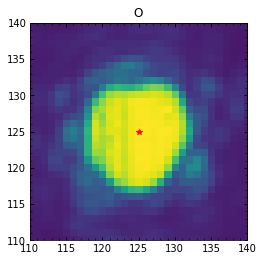

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07916.fits
bin_distcorr_lm_150104_07917.fits
8672.045750230847
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07917.fits: -0.36950772662766695, -0.031195145533793323


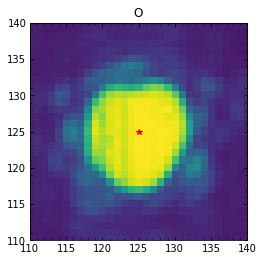

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07917.fits
bin_distcorr_lm_150104_07918.fits
8673.362709791878
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07918.fits: -0.3945167729464245, -0.04287430411163484


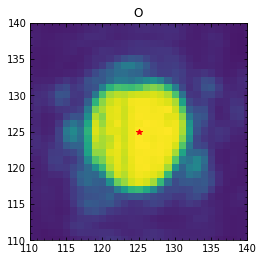

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07918.fits
bin_distcorr_lm_150104_07919.fits
8658.217849007971
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07919.fits: -0.3718322378087251, -0.05544425881772952


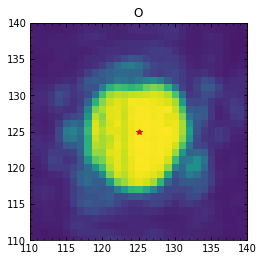

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07919.fits
bin_distcorr_lm_150104_07920.fits
8647.189362595456
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07920.fits: -0.38794613664980204, -0.05885617970570678


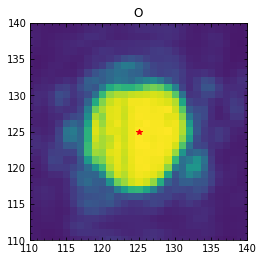

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07920.fits
bin_distcorr_lm_150104_07921.fits
8684.021679418871
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07921.fits: -0.3746749269715224, -0.03728738835214074


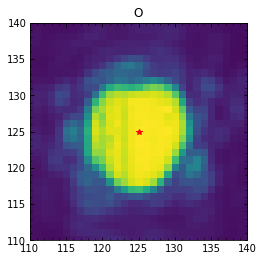

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07921.fits
bin_distcorr_lm_150104_07922.fits
8662.234130465451
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07922.fits: -0.3650756092461265, -0.044201564094557


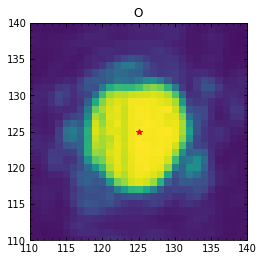

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07922.fits
bin_distcorr_lm_150104_07923.fits
8685.455235494734
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07923.fits: -0.40302227476772146, -0.026244398476620745


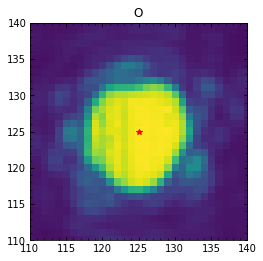

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07923.fits
bin_distcorr_lm_150104_07924.fits
8673.991278655372
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07924.fits: -0.3983245840606173, -0.0798606627918943


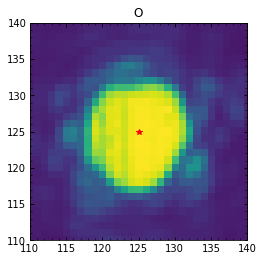

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07924.fits
bin_distcorr_lm_150104_07925.fits
8709.550717982322
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07925.fits: -0.37196497912231763, -0.09865620059635205


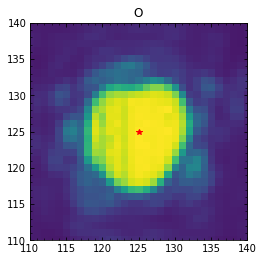

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07925.fits
bin_distcorr_lm_150104_07926.fits
8726.160748584565
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07926.fits: -0.3941868177516312, -0.04237307693509962


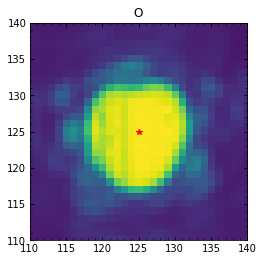

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07926.fits
bin_distcorr_lm_150104_07927.fits
8681.587482511606
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07927.fits: -0.38997221085316625, -0.0544746528468707


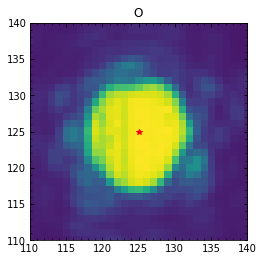

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07927.fits
bin_distcorr_lm_150104_07928.fits
8661.089867341485
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07928.fits: -0.39832483877088265, -0.04483374293470632


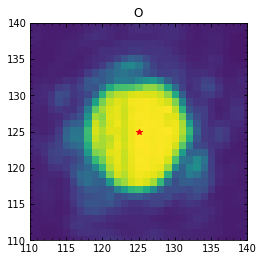

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07928.fits
bin_distcorr_lm_150104_07929.fits
8675.847940968943
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07929.fits: -0.380217518253275, -0.08291641066475819


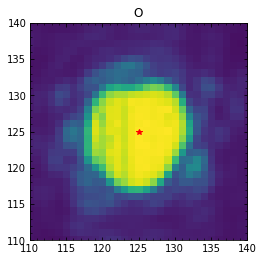

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07929.fits
bin_distcorr_lm_150104_07930.fits
8696.201612953797
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07930.fits: -0.4283327869249334, -0.059306356448772135


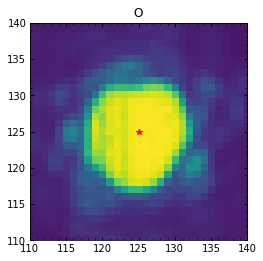

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07930.fits
bin_distcorr_lm_150104_07931.fits
8680.550606545155
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07931.fits: -0.43856488326446197, -0.07538672668597002


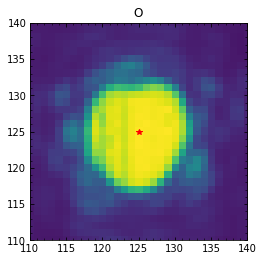

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07931.fits
bin_distcorr_lm_150104_07932.fits
8664.445391207484
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07932.fits: -0.37218607248068025, -0.092025547295421


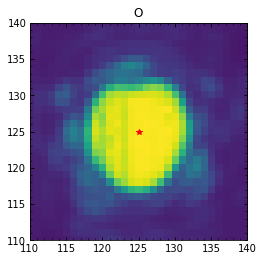

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07932.fits
bin_distcorr_lm_150104_07933.fits
8685.865389551442
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07933.fits: -0.38041339004041674, -0.11888905687484908


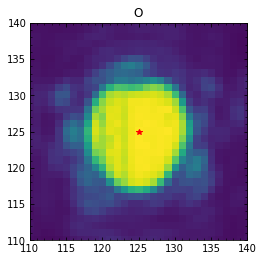

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07933.fits
bin_distcorr_lm_150104_07934.fits
8680.722479586422
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07934.fits: -0.3620134253970875, -0.1074515096326536


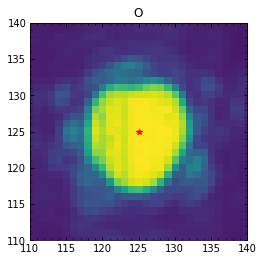

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07934.fits
bin_distcorr_lm_150104_07935.fits
8673.22960700004
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07935.fits: -0.3770931242721929, -0.10349920001436885


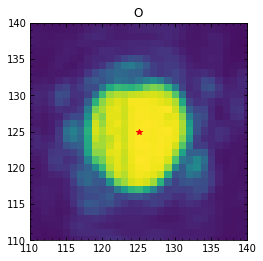

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07935.fits
bin_distcorr_lm_150104_07936.fits
8680.059001147276
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07936.fits: -0.3699120687597812, -0.09702797130179874


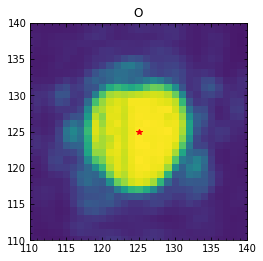

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07936.fits
bin_distcorr_lm_150104_07937.fits
8673.837078935343
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07937.fits: -0.33403003396654896, -0.09877369169340966


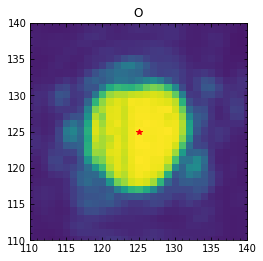

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07937.fits
bin_distcorr_lm_150104_07938.fits
8679.573142268862
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07938.fits: -0.35842643622692805, -0.1163307041785302


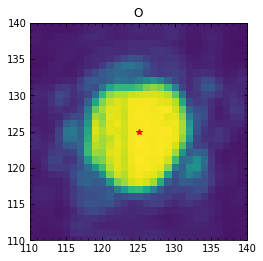

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07938.fits
bin_distcorr_lm_150104_07939.fits
8684.290313822274
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07939.fits: -0.3769590621217276, -0.07596594590408046


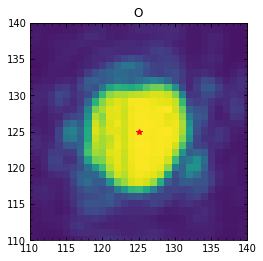

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07939.fits
bin_distcorr_lm_150104_07940.fits
8674.617263498823
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07940.fits: -0.3995274682828196, -0.13716246177511948


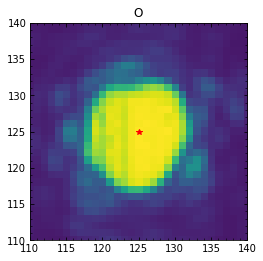

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07940.fits
bin_distcorr_lm_150104_07941.fits
8689.702522684316
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07941.fits: -0.3814371178995586, -0.10992685480541553


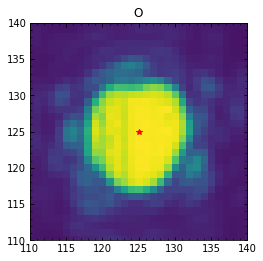

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07941.fits
bin_distcorr_lm_150104_07942.fits
8696.010162671253
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07942.fits: -0.37217303813518754, -0.09667520093953641


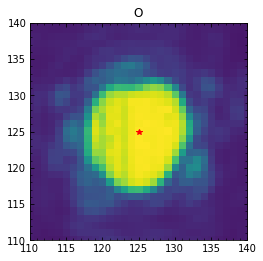

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07942.fits
bin_distcorr_lm_150104_07943.fits
8662.671106141548
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07943.fits: -0.3802581044350859, -0.1178349799521996


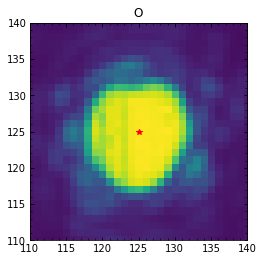

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07943.fits
bin_distcorr_lm_150104_07944.fits
8682.186491629385
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07944.fits: -0.3676845915815363, -0.11373620231474746


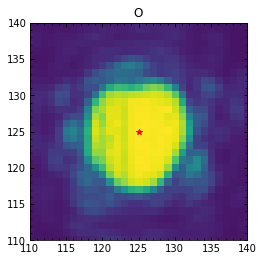

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07944.fits
bin_distcorr_lm_150104_07945.fits
8674.917971554243
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07945.fits: -0.41309836564051494, -0.11186944949781008


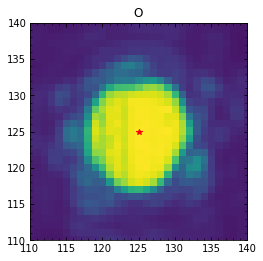

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07945.fits
bin_distcorr_lm_150104_07946.fits
8668.040770780673
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07946.fits: -0.3784723222842885, -0.1276073638176385


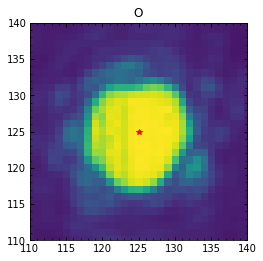

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07946.fits
bin_distcorr_lm_150104_07947.fits
8696.075099172109
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07947.fits: -0.40169278041868495, -0.17593119407829505


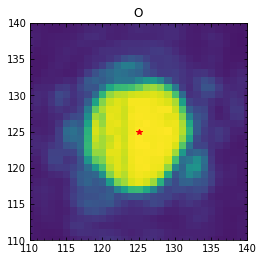

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07947.fits
bin_distcorr_lm_150104_07948.fits
8667.091192988737
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07948.fits: -0.3647826416236626, -0.12337925187905796


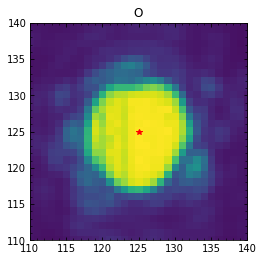

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07948.fits
bin_distcorr_lm_150104_07949.fits
8624.80794420352
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07949.fits: -0.3777301562330777, -0.13355229540306368


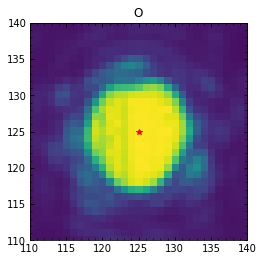

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07949.fits
bin_distcorr_lm_150104_07950.fits
8619.180592984265
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07950.fits: -0.39399640893566357, -0.08710707986283239


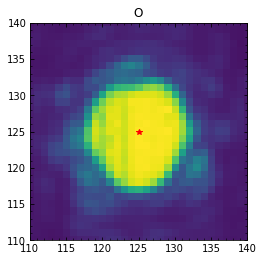

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07950.fits
bin_distcorr_lm_150104_07951.fits
8682.851723874535
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07951.fits: -0.38510299336871867, -0.05126813089415094


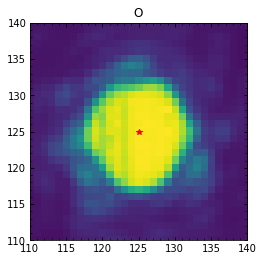

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07951.fits
bin_distcorr_lm_150104_07952.fits
8678.482192162703
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07952.fits: -0.35952396200860903, -0.09428415877780338


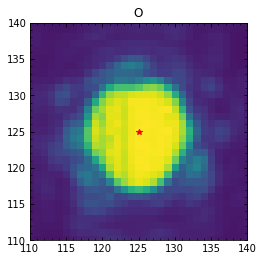

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07952.fits
bin_distcorr_lm_150104_07953.fits
8676.146298620313
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07953.fits: -0.40194754375717423, -0.13595007058986397


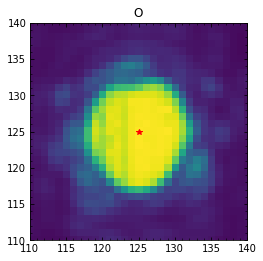

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07953.fits
bin_distcorr_lm_150104_07954.fits
8685.881735034407
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07954.fits: -0.3668644091772961, -0.11060613664751884


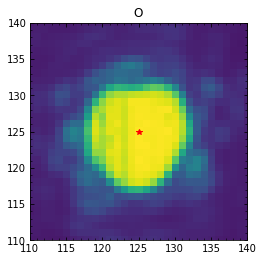

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07954.fits
bin_distcorr_lm_150104_07955.fits
8695.666005001303
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07955.fits: -0.33888682887013744, -0.13824308103944816


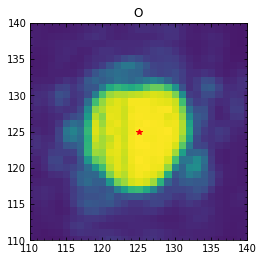

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07955.fits
bin_distcorr_lm_150104_07956.fits
8705.911768511154
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07956.fits: -0.35768274295698177, -0.1568874226567587


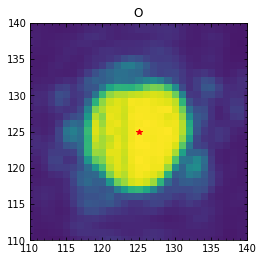

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07956.fits
bin_distcorr_lm_150104_07957.fits
8689.029186123396
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07957.fits: -0.3641379988407891, -0.1657988414558531


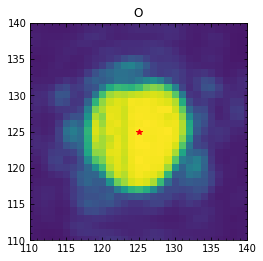

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07957.fits
bin_distcorr_lm_150104_07958.fits
8688.049252993476
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07958.fits: -0.38167850631938904, -0.14506709711758958


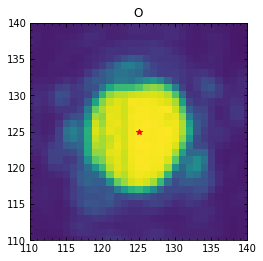

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07958.fits
bin_distcorr_lm_150104_07959.fits
8681.324129451135
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07959.fits: -0.3836442612674915, -0.17110378369893908


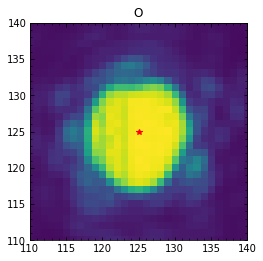

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07959.fits
bin_distcorr_lm_150104_07960.fits
8704.275936420454
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07960.fits: -0.3841118668275172, -0.1823407968840982


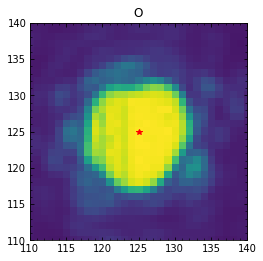

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07960.fits
bin_distcorr_lm_150104_07961.fits
8676.742651536531
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07961.fits: -0.3487187457270622, -0.15115654554784186


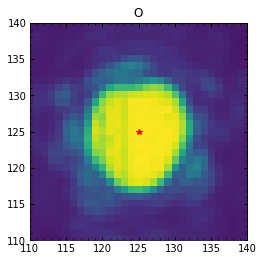

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07961.fits
bin_distcorr_lm_150104_07962.fits
8653.273490891805
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07962.fits: -0.3617868709989338, -0.12843520406104147


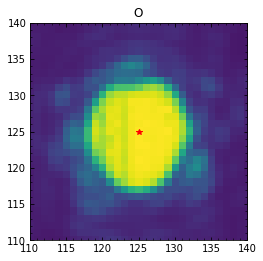

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07962.fits
bin_distcorr_lm_150104_07963.fits
8697.358439324664
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07963.fits: -0.37807570682016944, -0.17832959202850418


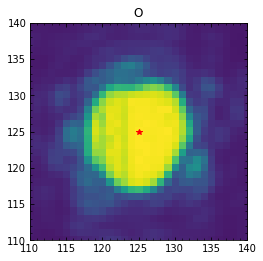

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07963.fits
bin_distcorr_lm_150104_07964.fits
8697.168909508155
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07964.fits: -0.34831034373688396, -0.15465465597288386


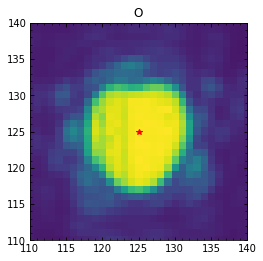

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07964.fits
bin_distcorr_lm_150104_07965.fits
8678.683570516543
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07965.fits: -0.37140157878685187, -0.08725689366775669


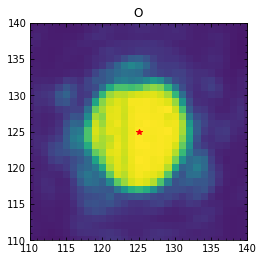

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07965.fits
bin_distcorr_lm_150104_07966.fits
8681.445361375796
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07966.fits: -0.3364715308501829, -0.1475564897589905


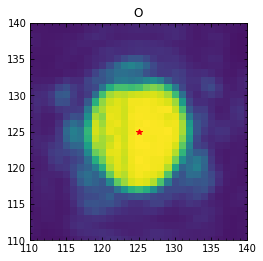

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07966.fits
bin_distcorr_lm_150104_07967.fits
8683.016108038413
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07967.fits: -0.34546266173029494, -0.14989583619655633


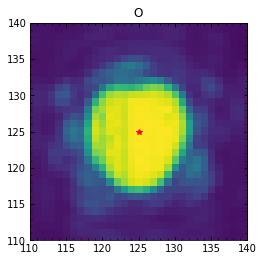

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07967.fits
bin_distcorr_lm_150104_07968.fits
8674.850460983449
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07968.fits: -0.3537625593929121, -0.15461982482698744


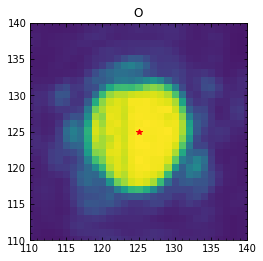

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07968.fits
bin_distcorr_lm_150104_07969.fits
8710.613224466066
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07969.fits: -0.3589912228054999, -0.1650099513460077


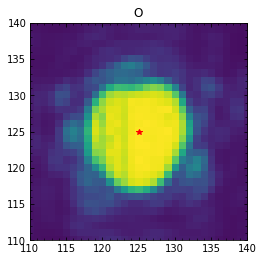

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07969.fits
bin_distcorr_lm_150104_07970.fits
8697.371907544895
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07970.fits: -0.3493864254307084, -0.19340107422668495


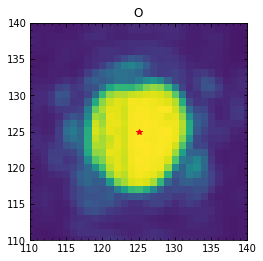

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07970.fits
bin_distcorr_lm_150104_07971.fits
8691.818823429985
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07971.fits: -0.3676174000280952, -0.19910290414130571


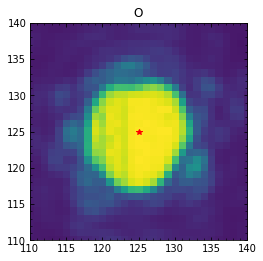

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07971.fits
bin_distcorr_lm_150104_07972.fits
8704.250176269183
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07972.fits: -0.4091605185584086, -0.1930872156781831


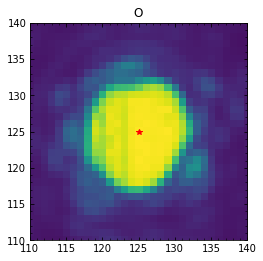

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07972.fits
bin_distcorr_lm_150104_07973.fits
8691.025301593214
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07973.fits: -0.4004349340567117, -0.21131647685026422


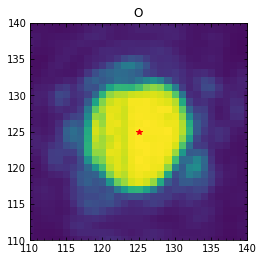

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07973.fits
bin_distcorr_lm_150104_07974.fits
8701.549666939567
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07974.fits: -0.3867895777185595, -0.19951196557514095


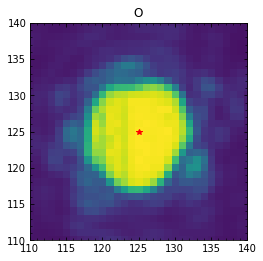

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07974.fits
bin_distcorr_lm_150104_07975.fits
8669.934938844073
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07975.fits: -0.386372962548748, -0.17410044053042384


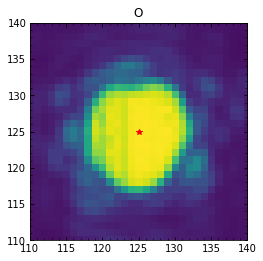

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07975.fits
bin_distcorr_lm_150104_07976.fits
8704.870825548056
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07976.fits: -0.3639317010483296, -0.19798761736525705


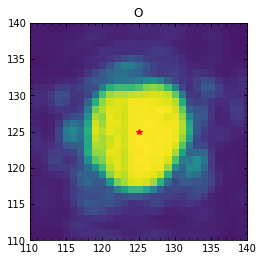

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07976.fits
bin_distcorr_lm_150104_07977.fits
8699.41617255345
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07977.fits: -0.3706975328976725, -0.2186927577550719


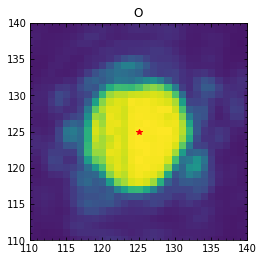

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07977.fits
bin_distcorr_lm_150104_07978.fits
8699.39491625339
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07978.fits: -0.41550581448378665, -0.23074443014792934


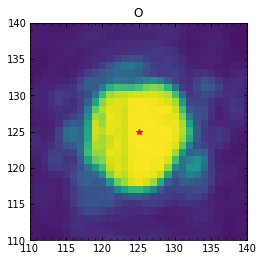

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07978.fits
bin_distcorr_lm_150104_07979.fits
8697.111336244716
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07979.fits: -0.42536006947387506, -0.2134682045431049


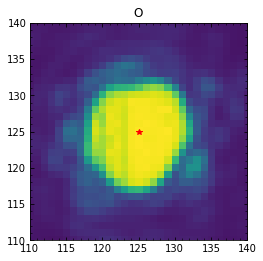

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07979.fits
bin_distcorr_lm_150104_07980.fits
8665.411855171606
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07980.fits: -0.4089689088848729, -0.24302887582232557


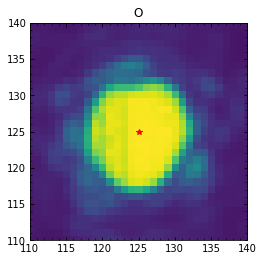

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07980.fits
bin_distcorr_lm_150104_07981.fits
8676.772898614334
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07981.fits: -0.40083739353001846, -0.13676627689509502


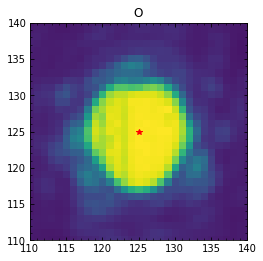

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07981.fits
bin_distcorr_lm_150104_07982.fits
8709.528871916622
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07982.fits: -0.38401157185855794, -0.15211561035492593


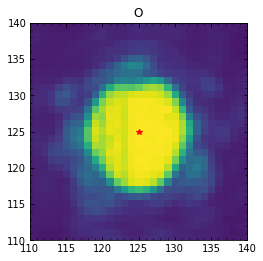

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07982.fits
bin_distcorr_lm_150104_07983.fits
8672.597731245827
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07983.fits: -0.42372562784292, -0.16818382005799748


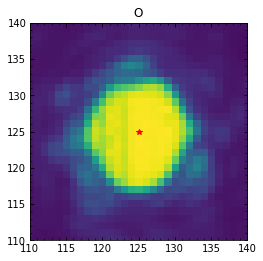

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07983.fits
bin_distcorr_lm_150104_07984.fits
8688.46064507553
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07984.fits: -0.4143695047649274, -0.2305481189882812


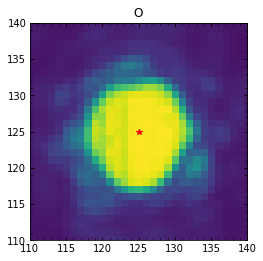

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07984.fits
bin_distcorr_lm_150104_07985.fits
8716.931309722479
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07985.fits: -0.40538610106913353, -0.2536561720957877


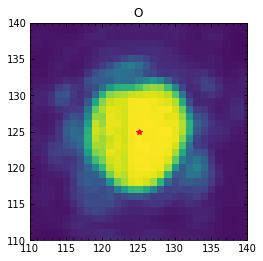

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07985.fits
bin_distcorr_lm_150104_07986.fits
8678.73854081671
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07986.fits: -0.38666417287440424, -0.23658155560249128


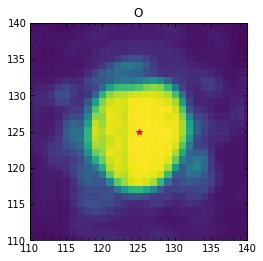

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07986.fits
bin_distcorr_lm_150104_07987.fits
8660.915964496857
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07987.fits: -0.35971768519359415, -0.2651676558242073


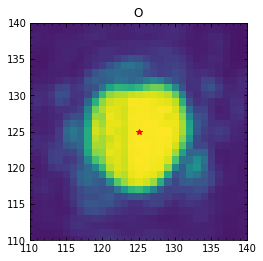

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07987.fits
bin_distcorr_lm_150104_07988.fits
8690.617264303439
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07988.fits: -0.4306671397414732, -0.2562528698689519


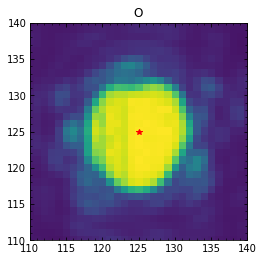

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07988.fits
bin_distcorr_lm_150104_07989.fits
8667.941893959582
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07989.fits: -0.455780791618011, -0.23119255124140636


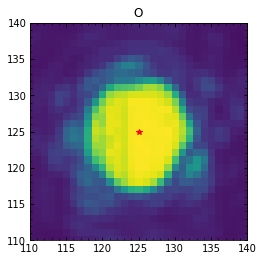

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07989.fits
bin_distcorr_lm_150104_07990.fits
8685.158200859809
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07990.fits: -0.4376167829334392, -0.2791406841696471


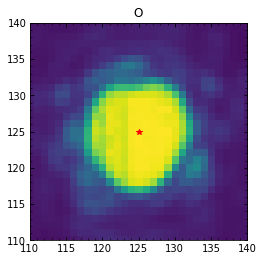

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07990.fits
bin_distcorr_lm_150104_07991.fits
8708.707917224663
STARTING  O
X: 207  Y: 324  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07991.fits: -0.40803559681526735, -0.26017086777201825


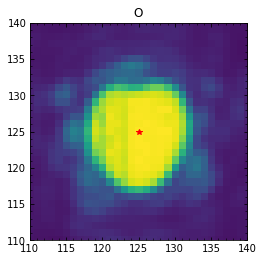

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07991.fits
bin_distcorr_lm_150104_07992.fits
8722.602956995139
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07992.fits: -0.8014673899475966, -0.41108409067119567


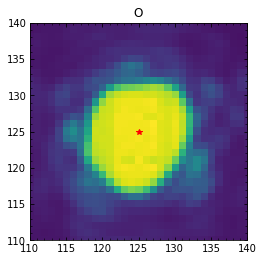

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07992.fits
bin_distcorr_lm_150104_07993.fits
8675.986955545835
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07993.fits: -0.790331986579794, -0.38731423543985954


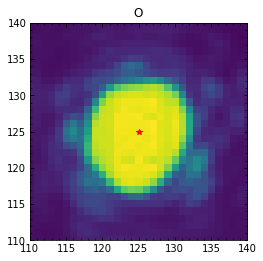

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07993.fits
bin_distcorr_lm_150104_07994.fits
8682.288464990812
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07994.fits: -0.8346313416979854, -0.43252006726377346


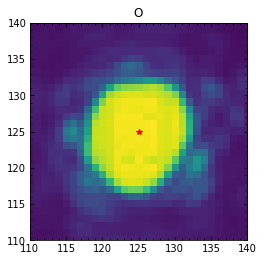

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07994.fits
bin_distcorr_lm_150104_07995.fits
8696.034247021204
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07995.fits: -0.7973114191305726, -0.39110159378527953


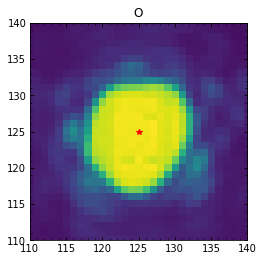

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07995.fits
bin_distcorr_lm_150104_07996.fits
8671.713006032865
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07996.fits: -0.8221179195563622, -0.361624378755927


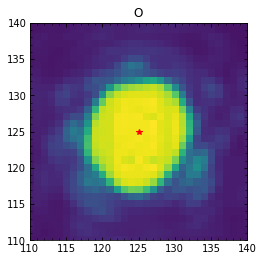

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07996.fits
bin_distcorr_lm_150104_07997.fits
8679.570365630638
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07997.fits: -0.8556986052464808, -0.338163601237099


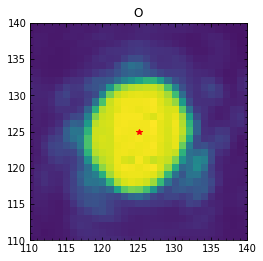

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07997.fits
bin_distcorr_lm_150104_07998.fits
8706.540388151127
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07998.fits: -0.8576281738404958, -0.40417398297608287


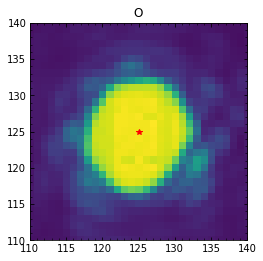

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07998.fits
bin_distcorr_lm_150104_07999.fits
8729.745177239467
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_07999.fits: -0.8161254158519284, -0.4442264196494392


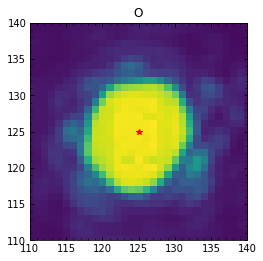

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_07999.fits
bin_distcorr_lm_150104_08000.fits
8705.199807244067
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08000.fits: -0.8394448140621336, -0.43854908439296736


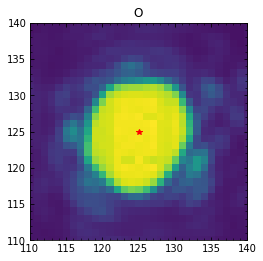

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08000.fits
bin_distcorr_lm_150104_08001.fits
8666.522183056268
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08001.fits: -0.8472445109886522, -0.6412355442965634


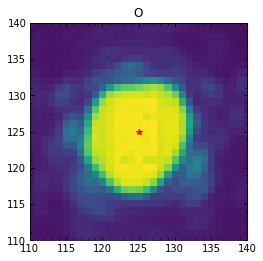

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08001.fits
bin_distcorr_lm_150104_08002.fits
8651.72671647014
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08002.fits: -0.8786798964041083, -0.6052829147737384


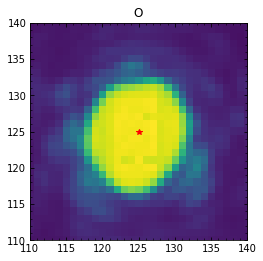

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08002.fits
bin_distcorr_lm_150104_08003.fits
8644.28929108077
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08003.fits: -0.8185792131852025, -0.3560339674353372


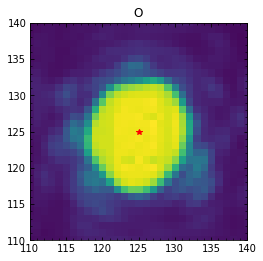

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08003.fits
bin_distcorr_lm_150104_08004.fits
8665.085572150738
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08004.fits: -0.7962835862726934, -0.35275990635403076


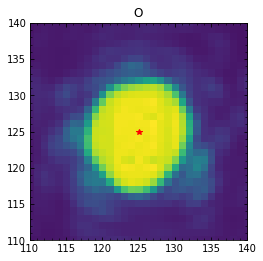

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08004.fits
bin_distcorr_lm_150104_08005.fits
8658.694636425935
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08005.fits: -0.8364495132828722, -0.37264895627220085


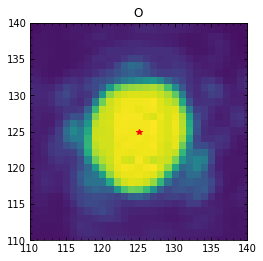

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08005.fits
bin_distcorr_lm_150104_08006.fits
8678.26479220005
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08006.fits: -0.8538711447024454, -0.45674410384576447


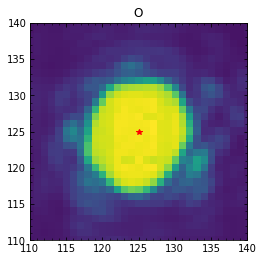

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08006.fits
bin_distcorr_lm_150104_08007.fits
8642.06398511707
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08007.fits: -0.8170733263286607, -0.41910446699324666


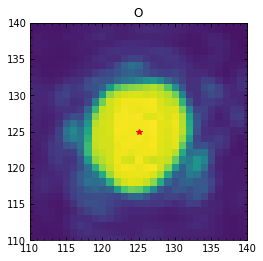

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08007.fits
bin_distcorr_lm_150104_08008.fits
8667.811091594007
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08008.fits: -0.8624921806892445, -0.6639705238718676


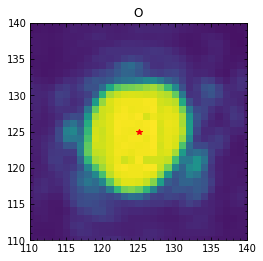

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08008.fits
bin_distcorr_lm_150104_08009.fits
8681.949642325118
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08009.fits: -0.8553165113857588, -0.6569677541446168


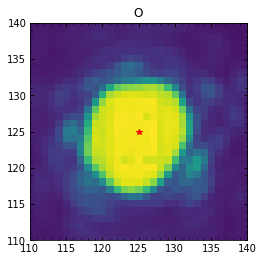

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08009.fits
bin_distcorr_lm_150104_08010.fits
8695.081149990081
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08010.fits: -0.8290445488382616, -0.4027446476984693


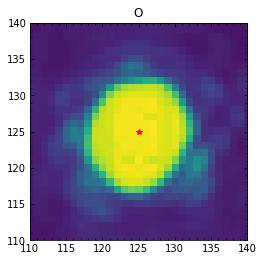

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08010.fits
bin_distcorr_lm_150104_08011.fits
8711.004421147027
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08011.fits: -0.8266234892889059, -0.41709315972109096


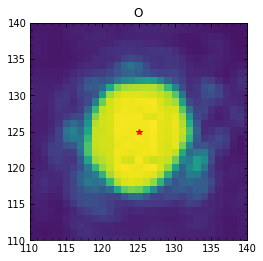

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08011.fits
bin_distcorr_lm_150104_08012.fits
8722.500720105312
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08012.fits: -0.828331160416873, -0.4136345856579453


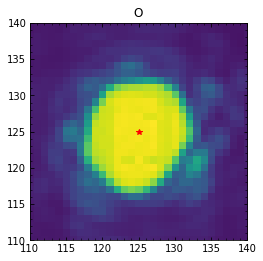

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08012.fits
bin_distcorr_lm_150104_08013.fits
8668.762254249948
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08013.fits: -0.7962901695873867, -0.4143980592115497


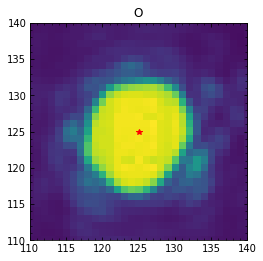

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08013.fits
bin_distcorr_lm_150104_08014.fits
8697.424875570254
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08014.fits: -0.7702477376900134, -0.4594629639643415


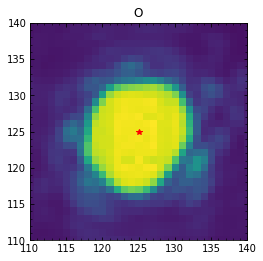

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08014.fits
bin_distcorr_lm_150104_08015.fits
8719.584594684797
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08015.fits: -0.8521416359884313, -0.47953713340106674


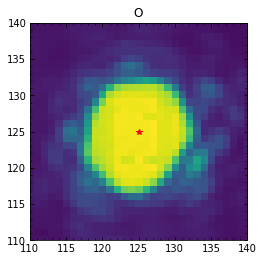

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08015.fits
bin_distcorr_lm_150104_08016.fits
8656.859503652957
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08016.fits: -0.8373881553750238, -0.42824792018700464


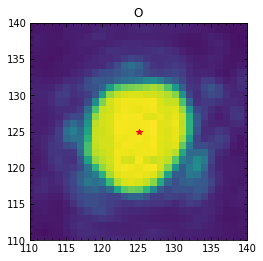

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08016.fits
bin_distcorr_lm_150104_08017.fits
8692.895815500304
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08017.fits: -0.8639519166130185, -0.6645303117829613


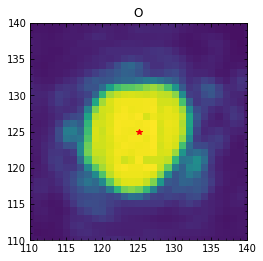

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08017.fits
bin_distcorr_lm_150104_08018.fits
8678.534506131056
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08018.fits: -0.8639672879836837, -0.6494469428418839


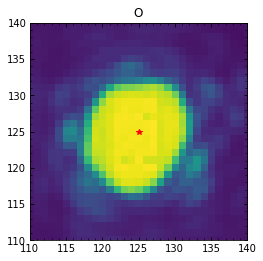

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08018.fits
bin_distcorr_lm_150104_08019.fits
8643.904203667145
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08019.fits: -0.8467487345001956, -0.6634546376655024


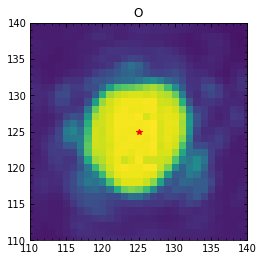

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08019.fits
bin_distcorr_lm_150104_08020.fits
8630.66716997595
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08020.fits: -0.8789881136541595, -0.6380023785100803


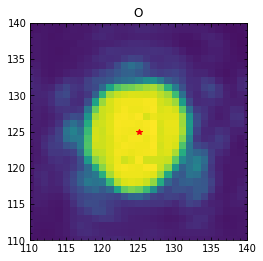

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08020.fits
bin_distcorr_lm_150104_08021.fits
8628.621662511325
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08021.fits: -0.8684665047986329, -0.6369832251035845


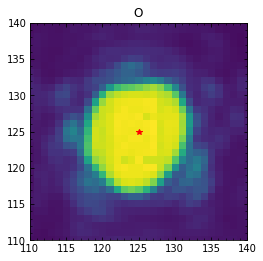

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08021.fits
bin_distcorr_lm_150104_08022.fits
8641.466656199626
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08022.fits: -0.829347172079423, -0.6273638893489064


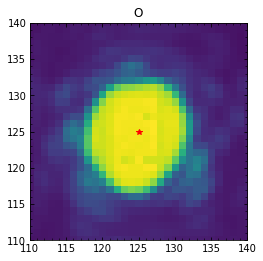

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08022.fits
bin_distcorr_lm_150104_08023.fits
8634.896832622937
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08023.fits: -0.8198777429074795, -0.6217235074206044


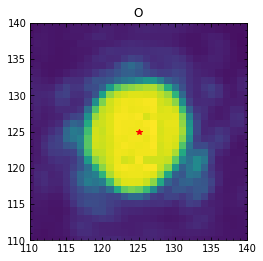

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08023.fits
bin_distcorr_lm_150104_08024.fits
8659.487005544817
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08024.fits: -0.7798929744707195, -0.6578916358061306


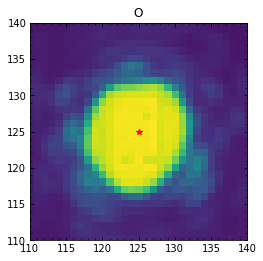

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08024.fits
bin_distcorr_lm_150104_08025.fits
8665.261346234793
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08025.fits: -0.7827449981103314, -0.6471588775184358


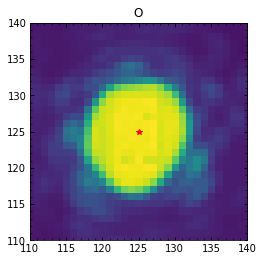

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08025.fits
bin_distcorr_lm_150104_08026.fits
8689.94457442358
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08026.fits: -0.7921499665800624, -0.6952330109807932


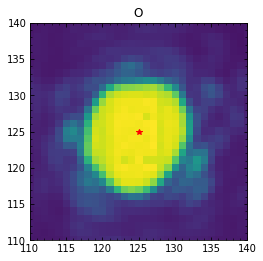

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08026.fits
bin_distcorr_lm_150104_08027.fits
8705.107528595516
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08027.fits: -0.8459092277735749, -0.7122821650823568


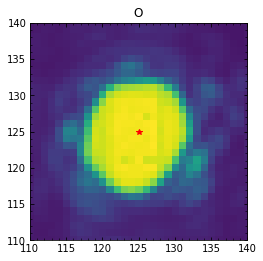

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08027.fits
bin_distcorr_lm_150104_08028.fits
8728.611006412295
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08028.fits: -0.8584680101376279, -0.7076445230590664


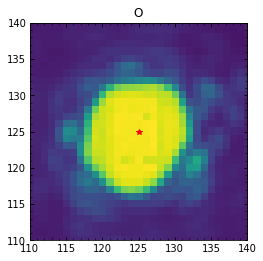

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08028.fits
bin_distcorr_lm_150104_08029.fits
8698.113542562036
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08029.fits: -0.7988356792971487, -0.4386813650341921


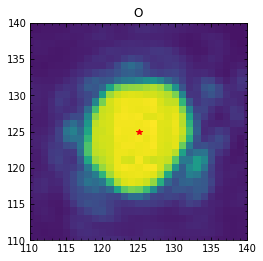

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08029.fits
bin_distcorr_lm_150104_08030.fits
8667.410139438076
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08030.fits: -0.8536476217065925, -0.6583416321597326


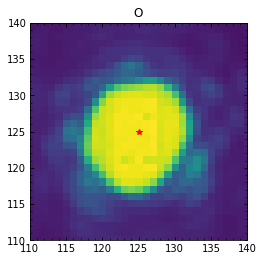

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08030.fits
bin_distcorr_lm_150104_08031.fits
8670.164732776968
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08031.fits: -0.8285056054334419, -0.6490349768974468


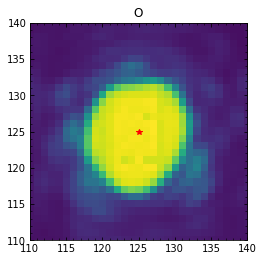

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08031.fits
bin_distcorr_lm_150104_08032.fits
8683.997219703411
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08032.fits: -0.8388703920474185, -0.7017546456367825


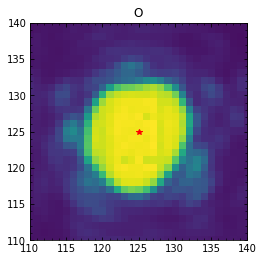

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08032.fits
bin_distcorr_lm_150104_08033.fits
8663.823958796656
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08033.fits: -0.86572470308937, -0.6910136108110834


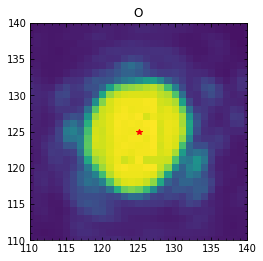

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08033.fits
bin_distcorr_lm_150104_08034.fits
8669.801864800522
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08034.fits: -0.8374505217323858, -0.6654652811531179


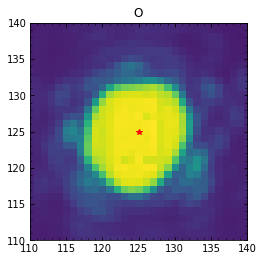

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08034.fits
bin_distcorr_lm_150104_08035.fits
8657.772406904543
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08035.fits: -0.8196800370452237, -0.6745637570564114


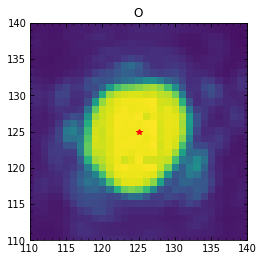

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08035.fits
bin_distcorr_lm_150104_08036.fits
8636.320990332883
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08036.fits: -0.8310104181169038, -0.6456405935850711


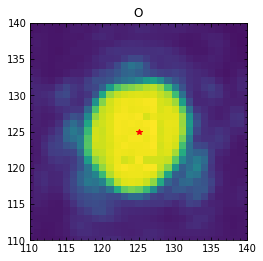

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08036.fits
bin_distcorr_lm_150104_08037.fits
8648.30617651881
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08037.fits: -0.8046689320154385, -0.6376233313773625


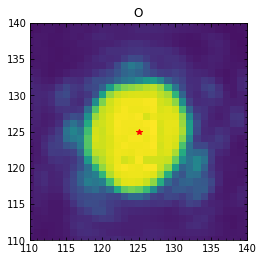

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08037.fits
bin_distcorr_lm_150104_08038.fits
8647.20914996814
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08038.fits: -0.8262921523364142, -0.6554689420869195


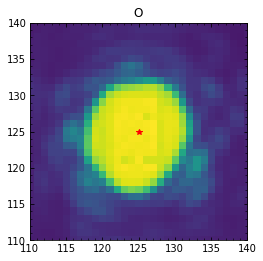

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08038.fits
bin_distcorr_lm_150104_08039.fits
8665.552387635442
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08039.fits: -0.8179468197287463, -0.698569987771215


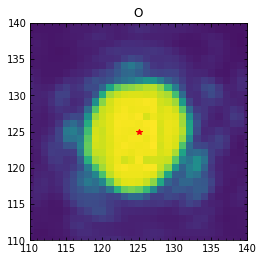

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08039.fits
bin_distcorr_lm_150104_08040.fits
8670.892485466113
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08040.fits: -0.8207237413446293, -0.6506256089235194


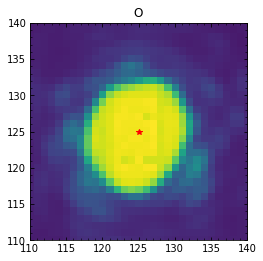

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08040.fits
bin_distcorr_lm_150104_08041.fits
8651.651876611519
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08041.fits: -0.789142738799903, -0.3995908482980681


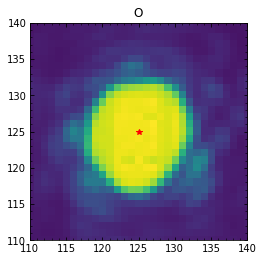

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08041.fits
bin_distcorr_lm_150104_08042.fits
8676.414435189028
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08042.fits: -0.839839567283164, -0.674910762178456


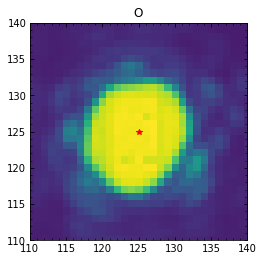

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08042.fits
bin_distcorr_lm_150104_08043.fits
8658.417944263758
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08043.fits: -0.7817317785045148, -0.6711930531355961


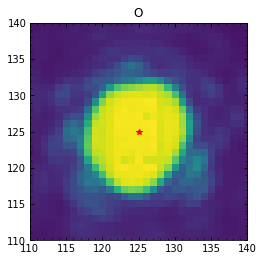

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08043.fits
bin_distcorr_lm_150104_08044.fits
8658.107246773143
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08044.fits: -0.7939390899393715, -0.6688452276282177


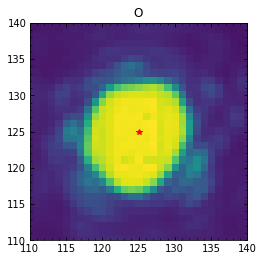

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08044.fits
bin_distcorr_lm_150104_08045.fits
8672.995770531175
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08045.fits: -0.8103714405845821, -0.6321850450078657


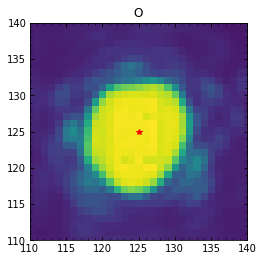

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08045.fits
bin_distcorr_lm_150104_08046.fits
8652.262605316002
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08046.fits: -0.7954137472245506, -0.6237386394523199


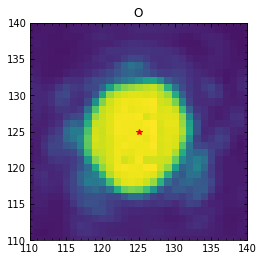

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08046.fits
bin_distcorr_lm_150104_08047.fits
8654.888499364115
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08047.fits: -0.7884004826284325, -0.6719003753503756


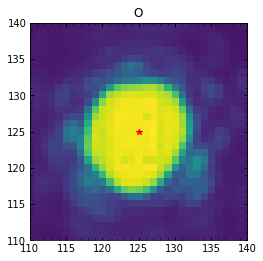

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08047.fits
bin_distcorr_lm_150104_08048.fits
8684.071358432035
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08048.fits: -0.7985385663203601, -0.7594634588286979


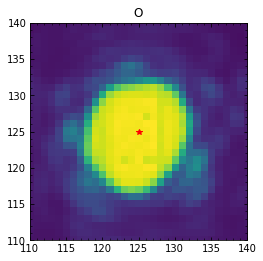

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08048.fits
bin_distcorr_lm_150104_08049.fits
8660.126078969957
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08049.fits: -0.8270407069897701, -0.7315907297567037


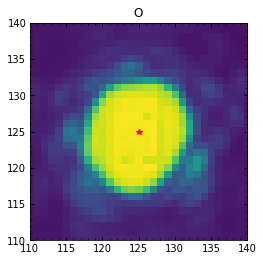

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08049.fits
bin_distcorr_lm_150104_08050.fits
8654.42163018246
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08050.fits: -0.8103185498402254, -0.7405096502011972


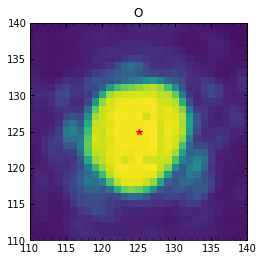

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08050.fits
bin_distcorr_lm_150104_08051.fits
8660.574797690828
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08051.fits: -0.8726663584632419, -0.724432778678576


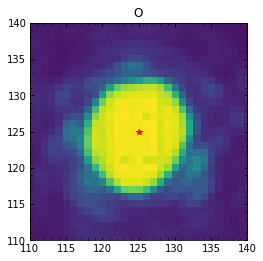

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08051.fits
bin_distcorr_lm_150104_08052.fits
8654.383794398667
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08052.fits: -0.8468305261791755, -0.7122532288747365


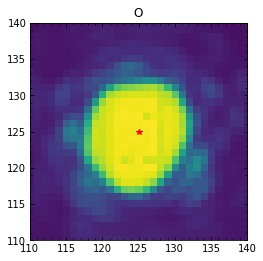

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08052.fits
bin_distcorr_lm_150104_08053.fits
8670.681655872651
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08053.fits: -0.815697280135872, -0.7181427422270446


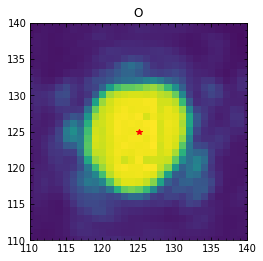

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08053.fits
bin_distcorr_lm_150104_08054.fits
8676.058328734303
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08054.fits: -0.8670091055103342, -0.7354006770440478


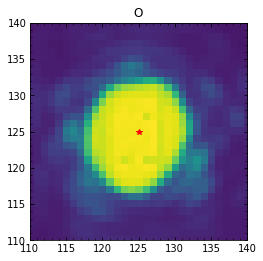

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08054.fits
bin_distcorr_lm_150104_08055.fits
8641.47989914637
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08055.fits: -0.9119063026015084, -0.7555996378774594


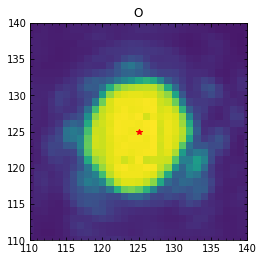

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08055.fits
bin_distcorr_lm_150104_08056.fits
8645.46459930068
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08056.fits: -0.9250311333843939, -0.7911155403020587


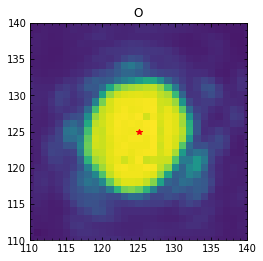

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08056.fits
bin_distcorr_lm_150104_08057.fits
8640.25021861871
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08057.fits: -0.8680626591148553, -0.7772717169870589


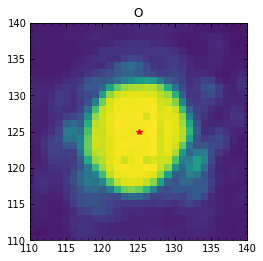

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08057.fits
bin_distcorr_lm_150104_08058.fits
8693.771560787176
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08058.fits: -0.8694307406150728, -0.7944029486153994


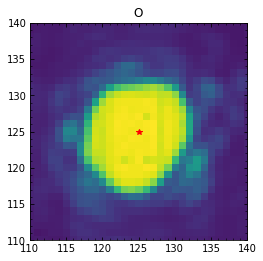

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08058.fits
bin_distcorr_lm_150104_08059.fits
8699.132332972786
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08059.fits: -0.8286197919621969, -0.7415479598900703


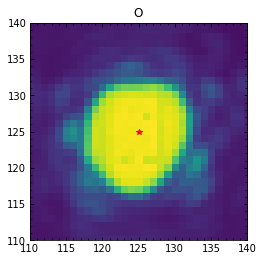

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08059.fits
bin_distcorr_lm_150104_08060.fits
8631.996887878815
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08060.fits: -0.8351029007271151, -0.7288878984687983


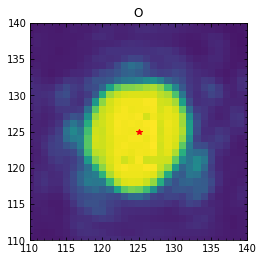

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08060.fits
bin_distcorr_lm_150104_08061.fits
8683.9958777791
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08061.fits: -0.8834605554659589, -0.7651345511238432


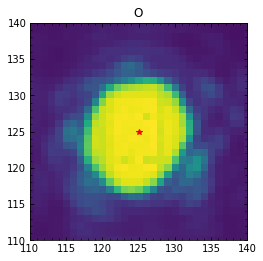

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08061.fits
bin_distcorr_lm_150104_08062.fits
8656.180341493226
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08062.fits: -0.8426773696620415, -0.7469045146978885


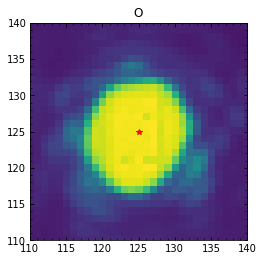

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08062.fits
bin_distcorr_lm_150104_08063.fits
8633.980083778246
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08063.fits: -0.824577707259877, -0.7489826525519376


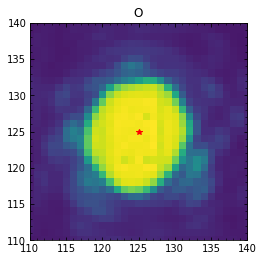

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08063.fits
bin_distcorr_lm_150104_08064.fits
8634.765620091632
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08064.fits: -0.8176344452667905, -0.7564713394565317


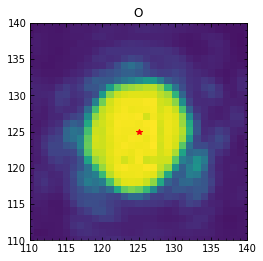

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08064.fits
bin_distcorr_lm_150104_08065.fits
8641.03231212181
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08065.fits: -0.8517995597595984, -0.7840084042982554


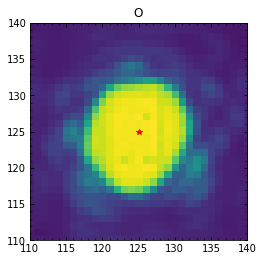

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08065.fits
bin_distcorr_lm_150104_08066.fits
8650.063962532418
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08066.fits: -0.8855685049042634, -0.74616286408353


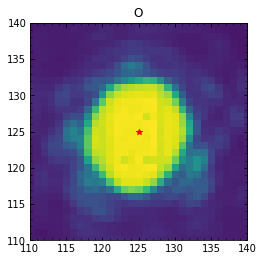

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08066.fits
bin_distcorr_lm_150104_08067.fits
8650.49245708348
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08067.fits: -0.8564477611280594, -0.7209424651095802


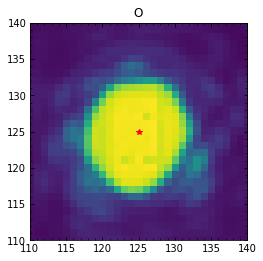

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08067.fits
bin_distcorr_lm_150104_08068.fits
8667.179408213713
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08068.fits: -0.8768476607633104, -0.7992914423176032


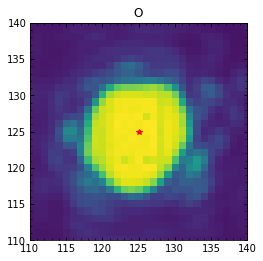

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08068.fits
bin_distcorr_lm_150104_08069.fits
8662.833883796999
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08069.fits: -0.8563286541729127, -0.7978493673310467


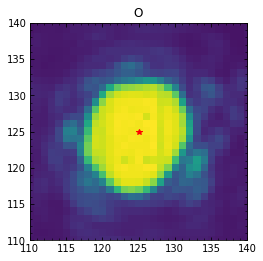

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08069.fits
bin_distcorr_lm_150104_08070.fits
8666.647757252045
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08070.fits: -0.8333807116960585, -0.7726964677842361


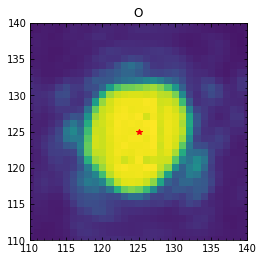

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08070.fits
bin_distcorr_lm_150104_08071.fits
8676.887935956498
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08071.fits: -0.8187474601694831, -0.7674201434151371


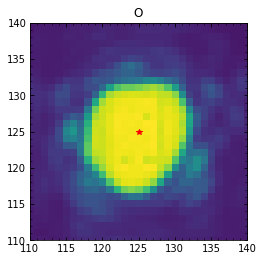

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08071.fits
bin_distcorr_lm_150104_08072.fits
8666.699358033671
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08072.fits: -0.85367914745094, -0.7817651586710426


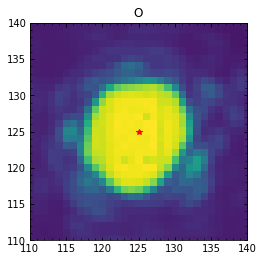

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08072.fits
bin_distcorr_lm_150104_08073.fits
8676.837317271395
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08073.fits: -0.8631554808118835, -0.7870202221104918


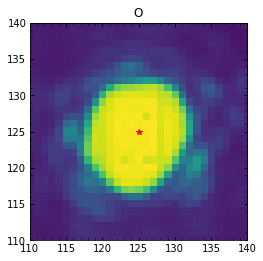

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08073.fits
bin_distcorr_lm_150104_08074.fits
8682.438747488632
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08074.fits: -0.8706558599347218, -0.8235810753975628


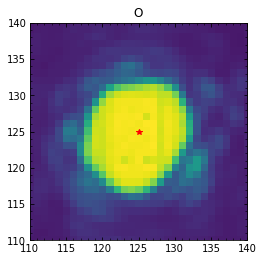

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08074.fits
bin_distcorr_lm_150104_08075.fits
8688.494492789785
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08075.fits: -0.8601054919143607, -0.772814445511095


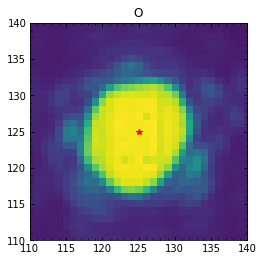

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08075.fits
bin_distcorr_lm_150104_08076.fits
8679.10895860409
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08076.fits: -0.8356027907483252, -0.7757502424932099


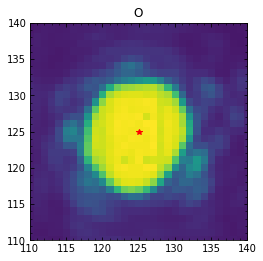

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08076.fits
bin_distcorr_lm_150104_08077.fits
8646.455957433429
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08077.fits: -0.8296412915456273, -0.7643162083645123


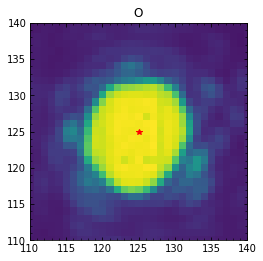

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08077.fits
bin_distcorr_lm_150104_08078.fits
8647.25391039976
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08078.fits: -0.8430428848550591, -0.7775733961629498


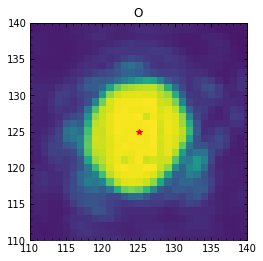

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08078.fits
bin_distcorr_lm_150104_08079.fits
8649.149957586422
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08079.fits: -0.8276851957291669, -0.7563921715715907


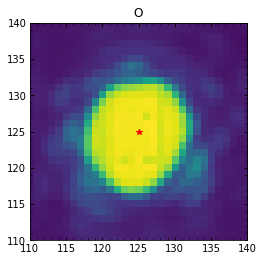

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08079.fits
bin_distcorr_lm_150104_08080.fits
8634.819715303693
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08080.fits: -0.8273442380455691, -0.7723638641643618


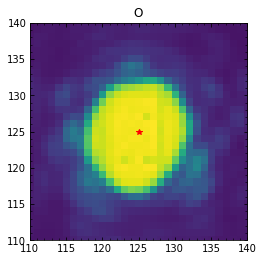

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08080.fits
bin_distcorr_lm_150104_08081.fits
8676.013812213612
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08081.fits: -0.81089839297168, -0.7766614845928999


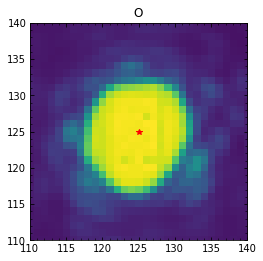

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08081.fits
bin_distcorr_lm_150104_08082.fits
8667.856382411244
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08082.fits: -0.8085734242759699, -0.8038921149396501


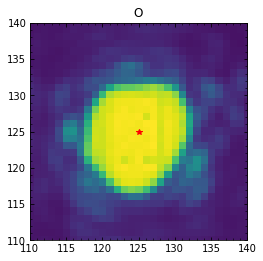

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08082.fits
bin_distcorr_lm_150104_08083.fits
8703.662535213545
STARTING  O
X: 212  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08083.fits: -0.8285862560288919, 0.1553821494469858


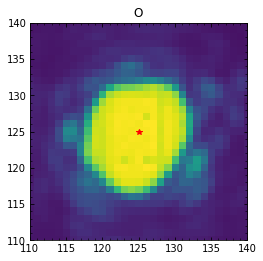

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08083.fits
bin_distcorr_lm_150104_08084.fits
8671.411899014853
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08084.fits: -0.853906938914939, -0.8159549295821336


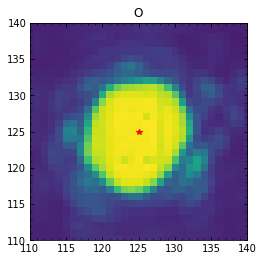

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08084.fits
bin_distcorr_lm_150104_08085.fits
8694.336862900362
STARTING  O
X: 212  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08085.fits: -0.8850738185739289, 0.14479851260334442


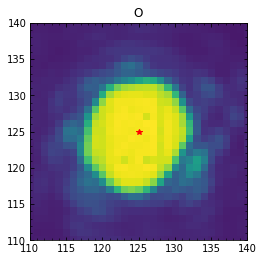

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08085.fits
bin_distcorr_lm_150104_08086.fits
8671.272532139186
STARTING  O
X: 212  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08086.fits: -0.8955908813019846, 0.1423197684674733


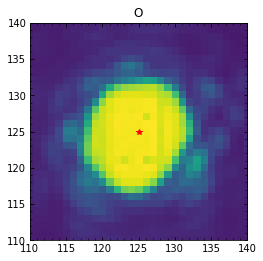

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08086.fits
bin_distcorr_lm_150104_08087.fits
8643.245198039765
STARTING  O
X: 211  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08087.fits: -0.8697382415862407, -0.8027619211613555


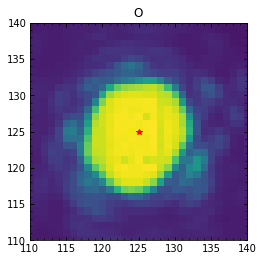

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08087.fits
bin_distcorr_lm_150104_08088.fits
8633.928097519962
STARTING  O
X: 212  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08088.fits: -0.8593743648964391, 0.1436060635817782


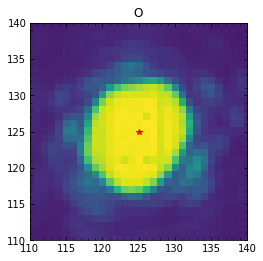

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08088.fits
bin_distcorr_lm_150104_08089.fits
8636.16291782579
STARTING  O
X: 212  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08089.fits: -0.805979482762119, 0.16163848229743394


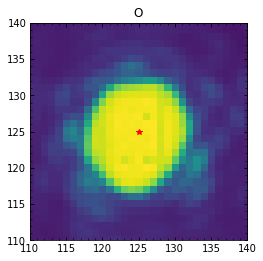

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08089.fits
bin_distcorr_lm_150104_08090.fits
8705.160786678991
STARTING  O
X: 212  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08090.fits: -0.8369866211211274, 0.09588896984659101


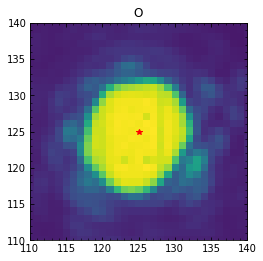

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08090.fits
bin_distcorr_lm_150104_08091.fits
8701.19227900417
STARTING  O
X: 212  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08091.fits: -0.8424268872688074, 0.11009060574533436


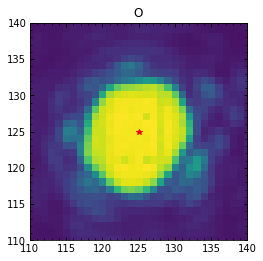

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08091.fits
bin_distcorr_lm_150104_08092.fits
8710.979545411119
STARTING  O
X: 212  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08092.fits: -0.8873419189252729, 0.12784480920406338


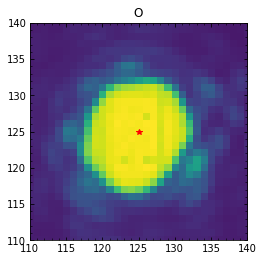

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08092.fits
bin_distcorr_lm_150104_08093.fits
8715.42084534675
STARTING  O
X: 212  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08093.fits: -0.8825219323813158, 0.11735083507716837


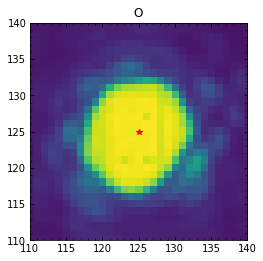

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08093.fits
bin_distcorr_lm_150104_08094.fits
8696.586748582142
STARTING  O
X: 212  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08094.fits: -0.8420886417780622, 0.13505208007648406


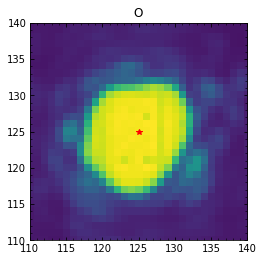

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08094.fits
bin_distcorr_lm_150104_08095.fits
8651.795839314404
STARTING  O
X: 212  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08095.fits: -0.8496661135187864, 0.1409505690284334


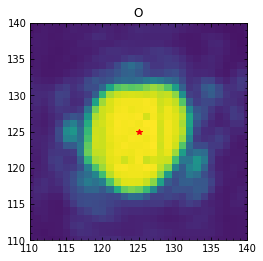

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08095.fits
bin_distcorr_lm_150104_08096.fits
8646.714088991963
STARTING  O
X: 212  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08096.fits: -0.9091102183914259, 0.10516942644437677


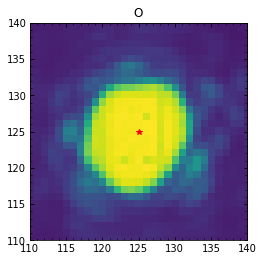

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08096.fits
bin_distcorr_lm_150104_08097.fits
8643.42005846315
STARTING  O
X: 212  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08097.fits: -0.8732427867144139, 0.11366146555180734


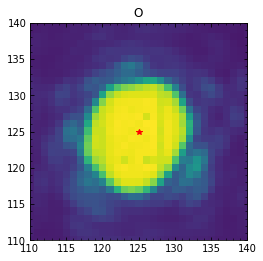

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08097.fits
bin_distcorr_lm_150104_08098.fits
8650.883863750278
STARTING  O
X: 212  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08098.fits: -0.8282699298312721, 0.168140101898409


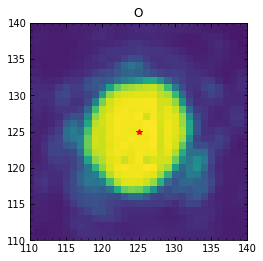

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08098.fits
bin_distcorr_lm_150104_08099.fits
8642.99703474973
STARTING  O
X: 212  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08099.fits: -0.8176409454774927, 0.1685398174666659


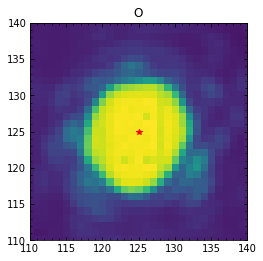

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08099.fits
bin_distcorr_lm_150104_08100.fits
8660.732924274902
STARTING  O
X: 212  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08100.fits: -0.849257466954171, 0.13027763310449814


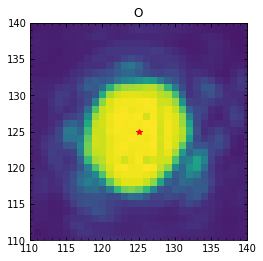

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08100.fits
bin_distcorr_lm_150104_08101.fits
8653.68089517873
STARTING  O
X: 212  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08101.fits: -0.8523179591882979, 0.16041146545732232


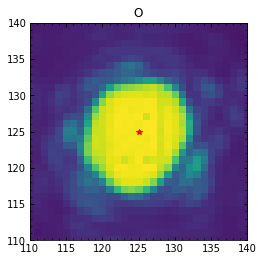

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08101.fits
bin_distcorr_lm_150104_08102.fits
8638.562156874415
STARTING  O
X: 212  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08102.fits: -0.8358585748694907, 0.16823966448394856


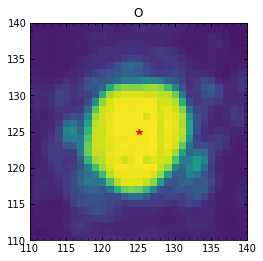

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08102.fits
bin_distcorr_lm_150104_08103.fits
8651.058954444905
STARTING  O
X: 212  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08103.fits: -0.8483019922238313, 0.16736417905254797


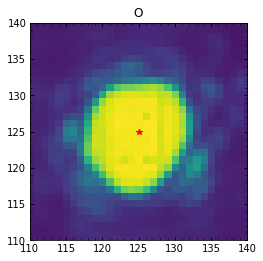

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08103.fits
bin_distcorr_lm_150104_08104.fits
8706.134072122546
STARTING  O
X: 212  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08104.fits: -0.8306202443657753, 0.11642769666072894


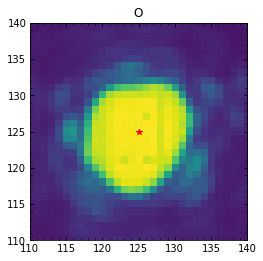

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08104.fits
bin_distcorr_lm_150104_08105.fits
8674.303354488413
STARTING  O
X: 212  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08105.fits: -0.8546402029084632, 0.08835501230677778


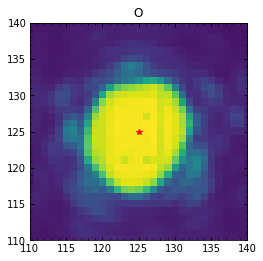

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08105.fits
bin_distcorr_lm_150104_08106.fits
8629.067804727929
STARTING  O
X: 212  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08106.fits: -0.7857810759474262, 0.15936122178598566


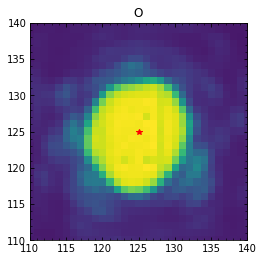

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08106.fits
bin_distcorr_lm_150104_08107.fits
8638.875595470425
STARTING  O
X: 212  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08107.fits: -0.7936167078283134, 0.15812442206627964


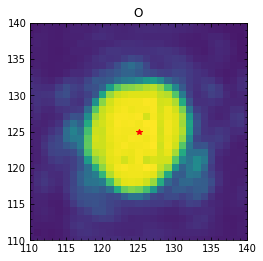

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08107.fits
bin_distcorr_lm_150104_08108.fits
8652.899182137362
STARTING  O
X: 212  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08108.fits: -0.8151445064832501, 0.18020501917466447


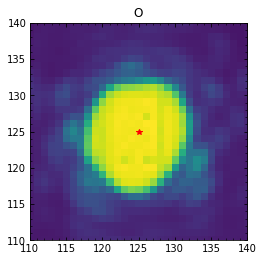

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08108.fits
bin_distcorr_lm_150104_08109.fits
8616.390694922022
STARTING  O
X: 212  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08109.fits: -0.8091933420557567, 0.18378114496334774


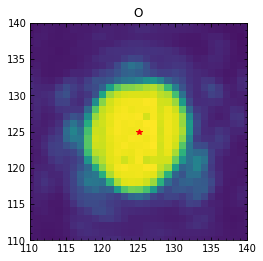

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08109.fits
bin_distcorr_lm_150104_08110.fits
8635.960950360588
STARTING  O
X: 212  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08110.fits: -0.8128120131831409, 0.18265520075471642


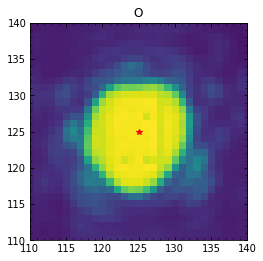

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08110.fits
bin_distcorr_lm_150104_08111.fits
8633.770265163514
STARTING  O
X: 212  Y: 134  R: 125  pix: 0.022
dimensions of Data: (250, 250)
X-shift, Y-shift for bin_distcorr_lm_150104_08111.fits: -0.8587783704902776, 0.17189670462096274


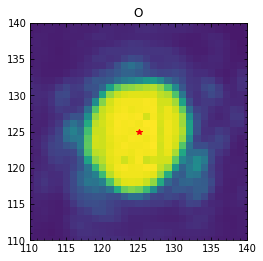

/Volumes/ARCTURUS/LMIRCam_Jan15/6aligned2X2/HIP24447/Kshort/single_V2/Final_lm_150104_08111.fits


In [12]:
# RUN CROSS-CORRELATION

two_eye = False # Change to True if L band data. 

# loop through files 
for index, image in enumerate(fils):         
    name = os.path.basename(image)
    print(name)
    TARGET = image.split('/')[-3]
    data = fits.getdata(image)
    hdr = fits.getheader(image)
    
    if two_eye:
        # get star from each eye
        data_L = data[:,0:300] - np.median(data[:,0:300])
        data_R = data[:,200::] - np.median(data[:,200::])

        # smooth the data in order to find the brightest pixel on each side
        sm_L = gaussian_filter(data_L, sigma=5)
        sm_R = gaussian_filter(data_R, sigma=5)
    
        
        # find the "center" of these frames. this approximate guess will help when we crop and
        # make the cross-correlation easier
        yind_cen = {}
        xind_cen = {}
        if np.max(sm_L) > 20000:
            Lind = np.where(sm_L==np.max(sm_L))
            yind_cen['L'] = int(Lind[0][0])
            xind_cen['L'] = int(Lind[1][0])

        if np.max(sm_R) > 20000:
            Rind = np.where(sm_R==np.max(sm_R))
            yind_cen['R'] = int(Rind[0][0])
            xind_cen['R'] = int(Rind[1][0]+200)
            
    else:
        # one eye
        data = data - np.median(data)
        sm = gaussian_filter(data, sigma=5)
        
        # smooth and find the approximate center. 
        yind_cen = {}
        xind_cen = {}
        print(np.max(sm))
        if np.max(sm) > 6000:
            ind = np.where(sm == np.max(sm))
            yind_cen['O'] = int(ind[0][0])
            xind_cen['O'] = int(ind[1][0])
        
    # loop through the centers and crop image and run cross-correlation
    for key, val in xind_cen.items():
        print('STARTING ', key)
        xind, yind = xind_cen[key], yind_cen[key]
        # crop to 5.5" box
        pix_to_arcsec = hdr['PIXSCALE']
        box_size = int(5.5 // pix_to_arcsec)
        radius_size = int(box_size // 2)
        print('X:', xind, ' Y:', yind, ' R:', radius_size, ' pix:', pix_to_arcsec)

        if xind < radius_size:
            xind = radius_size+1
        if yind < radius_size:
            yind = radius_size+1

        Data = data[yind-radius_size:yind+radius_size, xind-radius_size:xind+radius_size]
        print('dimensions of Data:', Data.shape)
        
        # run cross correlation
        Data[np.isinf(Data) | np.isnan(Data)] = np.nanmedian(Data)
        xshift, yshift = cross_image(ref, Data, 125, 125, boxsize=50)
        print(f'X-shift, Y-shift for {name}: {xshift}, {yshift}')
        output_im = shift_image(Data, xshift, yshift)
        
        # check that the star is in the center. 
        plt.figure()
        plt.imshow(output_im)
        plt.plot(125, 125, 'r*')
        plt.title(key)
        plt.xlim(110,140)
        plt.ylim(110,140)
        plt.show()
        
        sep_name = (name.split('.')[0]).split('distcorr')[-1]
        
        if two_eye:
            fin_name = 'Final' + sep_name  + '+' + key + '.fits'
        else:
            fin_name = 'Final' + sep_name  + '.fits'
        
        fin_path = datadir + f'6aligned2X2/{TARGET}/{filt}/single_CC/'
        if not os.path.exists(fin_path):
            os.mkdir(fin_path)
        print(fin_path + fin_name)
        fits.writeto(fin_path + fin_name, output_im, hdr, overwrite=True)



# MASK GHOSTS 
 mask the location of the ghosts in the PSF frames. 



In [13]:
def makeMask(xs, ys, radius, cenx, ceny):
    shape = (xs, ys)
    fin_mask = np.zeros(shape)
    for i in np.arange(len(cenx)):
  
        center = PixCoord(cenx[i], ceny[i])
        circle = CirclePixelRegion(center, radius[i]-1)
        mask = circle.to_mask()
        newmask = mask.to_image(shape)
        fin_mask += newmask
    fin_mask[fin_mask >1] =1
    return fin_mask

In [14]:
fils_hip1 = np.sort(glob.glob(datadir + f'/6aligned2x2/HIP22138/Kshort/single_CC/Final*.fits'))
fils_hip2 = np.sort(glob.glob(datadir + f'/6aligned2x2/HIP24447/Kshort/single_CC/Final*.fits'))

def mask(fils):
    for i in np.arange(len(fils)):
        F = fils[i]
        name = os.path.basename(F)
        path = os.path.dirname(F)
        dat = fits.open(F, memmap=False)[0]
        data = dat.data
        hdr = dat.header

        xs, ys = np.shape(data)[1], np.shape(data)[0]
        
        med_box = np.nanmedian(data[0:60,0:60])
        offset = med_box - np.nanmedian(data[190:250, 130:170])
        data[:, 130:170] += offset

        cenx = [183,123]
        ceny = [39,230]
        radius = [20,13]

        mask = makeMask(xs, ys, radius, cenx, ceny)

        data[mask==1] = np.nan
        
        if not os.path.exists(path + '_masked'):
            os.mkdir(path + '_masked')
    
        print(f'done: {i+1}/{len(fils)}', end='\r')
        fits.writeto(path + '_masked/Final_masked_' + name, data, header=hdr, overwrite=True)
            

mask(fils_hip1)
mask(fils_hip2)